<a href="https://colab.research.google.com/github/romqn1999/Predict-price-after-pattern/blob/main/Find_price_patterns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Find price patterns

## Install packages

In [1]:
#optional installations: 
!pip install yfinance --upgrade --no-cache-dir
!pip3 install pandas_datareader

     |████████████████████████████████| 6.3MB 8.3MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.59-py2.py3-none-any.whl size=23442 sha256=85aba21ffbf78ce226904138468f34916060a7f9bbdbae7b6f88aab4dfd01061
  Stored in directory: /tmp/pip-ephem-wheel-cache-hc2q5lec/wheels/f8/2a/0f/4b5a86e1d52e451757eb6bc17fd899629f0925c777741b6d04
Successfully built yfinance
  Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


## Import packages

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

# ___library_import_statements___
import pandas as pd

# for pandas_datareader, otherwise it might have issues, sometimes there is some version mismatch
pd.core.common.is_list_like = pd.api.types.is_list_like
import pandas_datareader.data as web
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import argrelextrema
import datetime
import time

#newest yahoo API 
import yfinance as yahoo_finance

from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel, RBF, ConstantKernel as C

#optional 
#yahoo_finance.pdr_override()

%matplotlib inline

## Get data

In [3]:
#@title Set symbol and time for get data
ticker = "All" #@param ["AA", "AAA", "AAAU", "AABB", "AAC", "AACG", "AACQ", "AADAX", "AADEX", "AADR", "AADTX", "AAEEF", "AAGC", "AAGH", "AAIC", "AAIGF", "AAIIQ", "AAIRF", "AAL", "AAMC", "AAME", "AAMMF", "AAN", "AAOI", "AAP", "AAPL", "AAPT", "AAQC", "AASP", "AASZF", "AAT", "AATGF", "AATRL", "AATV", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBRF", "ABBV", "ABC", "ABCB", "ABCL", "ABCM", "ABEO", "ABEV", "ABG", "ABGI", "ABGSF", "ABIO", "ABKB", "ABLZF", "ABM", "ABMBF", "ABMC", "ABMD", "ABML", "ABMT", "ABNAF", "ABNB", "ABQQ", "ABR", "ABRRP", "ABST", "ABT", "ABTI", "ABTX", "ABVC", "ABVG", "ABWN", "ABXXF", "ABZPF", "ABZPY", "ABZT", "ABZUF", "ACA", "ACAC", "ACAD", "ACB", "ACBA", "ACBAU", "ACBI", "ACC", "ACCD", "ACDSF", "ACDVF", "ACER", "ACES", "ACET", "ACEV", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACGLP", "ACH", "ACHC", "ACHL", "ACHV", "ACI", "ACIC", "ACIU", "ACIW", "ACKAY", "ACKIU", "ACKIW", "ACKRF", "ACLLF", "ACLS", "ACM", "ACMC", "ACMR", "ACN", "ACNB", "ACND", "ACNNF", "ACNV", "ACP", "ACPRF", "ACR", "ACRDF", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTC", "ACTG", "ACV", "ACVA", "ACVF", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADBRF", "ADC", "ADCOF", "ADCT", "ADDC", "ADDDF", "ADDXF", "ADDYY", "ADES", "ADFI", "ADFS", "ADGCF", "ADGO", "ADHC", "ADI", "ADIL", "ADKT", "ADM", "ADMA", "ADMP", "ADN", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADTX", "ADV", "ADVM", "ADWPF", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEAC", "AEAU", "AEB", "AEBZY", "AEE", "AEEX", "AEF", "AEFC", "AEG", "AEGY", "AEHDX", "AEHL", "AEHR", "AEI", "AEIS", "AEL", "AELTF", "AEM", "AEMD", "AENG", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AESE", "AESO", "AETUF", "AEVA", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "BTC", "BTC-USD", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM", "ZOM"] {allow-input: true}
tickers = ["AA", "AAAU", "AACG", "AADAX", "AADEX", "AADR", "AADTX", "AAIC", "AAIGF", "AAIIQ", "AAL", "AAMC", "AAN", "AAOI", "AAP", "AAPL", "AASZF", "AAT", "AATRL", "AAVVF", "AAVXF", "AAWW", "AAXJ", "ABB", "ABBV", "ABC", "ABCB", "ABCL", "ABCM", "ABEO", "ABEV", "ABG", "ABIO", "ABLZF", "ABM", "ABMD", "ABMT", "ABNAF", "ABQQ", "ABR", "ABST", "ABT", "ABTI", "ABTX", "ABVC", "ABWN", "ACA", "ACAC", "ACAD", "ACB", "ACBI", "ACC", "ACCD", "ACDVF", "ACER", "ACES", "ACET", "ACEV", "ACFL", "ACFN", "ACGBY", "ACGL", "ACGLO", "ACGLP", "ACH", "ACHC", "ACHL", "ACHV", "ACI", "ACIU", "ACIW", "ACKAY", "ACLLF", "ACLS", "ACM", "ACMC", "ACMR", "ACN", "ACNB", "ACP", "ACR", "ACRE", "ACRHF", "ACRS", "ACRX", "ACST", "ACTG", "ACV", "ACVF", "ACWI", "ACWV", "ACWX", "ACXIF", "ACY", "ADAP", "ADBE", "ADC", "ADCT", "ADDC", "ADDDF", "ADDYY", "ADES", "ADHC", "ADI", "ADIL", "ADKT", "ADM", "ADMA", "ADMP", "ADN", "ADNT", "ADP", "ADPT", "ADRNY", "ADS", "ADSK", "ADT", "ADTM", "ADTN", "ADVM", "ADX", "ADXN", "ADXS", "ADYEY", "ADYX", "ADYYF", "AE", "AEAU", "AEB", "AEE", "AEF", "AEFC", "AEG", "AEGY", "AEHL", "AEHR", "AEIS", "AEL", "AEM", "AEMD", "AENZ", "AEP", "AEPPL", "AEPT", "AER", "AES", "AESC", "AETUF", "AEXAY", "AEXE", "AEY", "AEYE", "AEZS", "AMC", "AMD", "AMZN", "BA", "BABA", "BB", "BTC-USD", "DAX", "ETH-USD", "F", "FB", "GME", "GOOG", "IBM", "KO", "NFLX", "NOK", "NVDA", "PLUG", "QCOM", "QQQ", "QYLD", "R", "RIDE", "RIOT", "SNP", "SPCE", "SPY", "T", "TSLA", "V", "VIAC", "VICI", "VXRT", "VZ", "W", "WFC", "WMT", "X", "XOM", "XPEV", "Y", "Z", "ZM"]
start_time = "2000-01-01" #@param {type:"date"}
start_time = datetime.datetime.strptime(start_time, "%Y-%m-%d")
# end_time = datetime.datetime.now().date().isoformat()         # today
end_time = datetime.datetime.now().date().strftime("%Y-%m-%d") #@param {type:"date"}
price_name = "Close" #@param ["Open", "High", "Low", "Close", "Adj Close"]

In [4]:
def get_data_yahoo(ticker, start_time, end_time, max_try=5):
    # yahoo gives only daily historical data
    connected = False
    tried = 0
    while not connected and tried < max_try:
        tried += 1
        try:
            ticker_df = web.get_data_yahoo(ticker, start=start_time, end=end_time)
            connected = True
            print('connected to yahoo')
        except Exception as e:
            print("Error: " + str(e))
            time.sleep(5)
            pass

    if tried >= max_try:
        return None

    # use numerical integer index instead of date    
    ticker_df = ticker_df.reset_index()
    # print(ticker_df.head(5))
    return ticker_df

def get_data_multiple_tickers(tickers, start_time, end_time, max_try=5):
    ticker_dfs = {}
    for ticker in tickers:
        ticker_df = get_data_yahoo(ticker, start_time, end_time)
        ticker_dfs[ticker] = ticker_df
    return ticker_dfs

In [5]:
ticker_df = get_data_yahoo(ticker, start_time, end_time)
print(ticker_df)

if ticker is 'All':
    ticker_dfs = get_data_multiple_tickers(tickers, start_time, end_time)
    print(ticker_dfs)

connected to yahoo
           Date        High         Low  ...       Close     Volume   Adj Close
0    2000-01-03   24.187500   23.250000  ...   23.500000  2993100.0   14.065693
1    2000-01-04   23.750000   22.687500  ...   22.750000  3186700.0   13.616785
2    2000-01-05   23.937500   23.000000  ...   23.750000  3290200.0   14.215322
3    2000-01-06   24.125000   23.125000  ...   23.625000  2760400.0   14.140509
4    2000-01-07   24.812500   23.250000  ...   24.500000  3140400.0   14.664229
...         ...         ...         ...  ...         ...        ...         ...
5381 2021-05-24  138.320007  136.949997  ...  137.240005  1499200.0  137.240005
5382 2021-05-25  137.350006  134.910004  ...  135.149994  1492600.0  135.149994
5383 2021-05-26  140.000000  135.000000  ...  135.570007  3187200.0  135.570007
5384 2021-05-27  136.600006  134.330002  ...  136.300003  3993900.0  136.300003
5385 2021-05-28  137.610001  135.699997  ...  136.610001  2095500.0  136.610001

[5386 rows x 7 colum

## Find pattern

### Helper

In [6]:
#@title Check if data is nearly formed a line
#@markdown ### Delta price distance from data point to trend line
trend_delta = 0.05 #@param {type:"number"}

def is_trend(x_data, y_data):
    assert len(x_data) == len(y_data)
    if len(x_data) < 2:
        return False
    # print(x_data)
    # print(y_data)
    # Find the line from the first to the last point
    # y = a * x + b
    x1, y1 = x_data[0], y_data[0]
    x2, y2 = x_data[-1], y_data[-1]
    a = (y1 - y2) / (x1 - x2)  # slope
    b = y1 - a * x1  # intercept
    b_is_trend = True
    for i in range(len(x_data)):
        y_val = a * x_data[i] + b
        err = abs(y_val - y_data[i])
        if (err > trend_delta * y_val):
            b_is_trend = False
            break
    return b_is_trend
    # p, res, _, _, _ = np.polyfit(x_data, y_data, 1, full=True)
    # err = res[0] if res.size > 0 else 0
    # if err <= len(x_data) * trend_delta:
    #     return True
    # return False

In [7]:
#@markdown ### Delta price distance between 2 tops/bottoms
y_delta =  0.5#@param {type:"number"}
min_height = 0.5 #@param {type:"number"}

### Patterns detection func

In [8]:
#@title Double top detection

def find_double_top(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max
    # print(key_points)

    suspected_double_tops = list()
    n = len(x_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 3):
        for j in range(i + 2, len(key_points) - 1):
            l = key_points[i]
            r = key_points[j]
            # if l == 301 and r == 307:
            #     print(y_data[l], y_data[r], max(y_data[key_points[i + 1: j]]))
            if (abs(y_data[l] - y_data[r]) <= y_delta) \
               and r - l > 1 \
               and min(y_data[l], y_data[r]) >= max(y_data[key_points[i + 1: j]]):
                k_bottom = np.argmin(y_data[l + 1: r]) + l + 1
                if min(y_data[l], y_data[r]) < y_data[k_bottom] + min_height:
                    continue
                (ilows,) = np.where(y_data[:l] <= y_data[k_bottom])
                istart = None
                if ilows.size > 0:
                    istart = ilows[-1]
                (ilows,) = np.where(y_data[r:] <= y_data[k_bottom])
                iend = None
                if ilows.size > 0:
                    iend = ilows[0] + r
                # print(istart, l, k_bottom, r, iend)
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    suspected_double_tops.append((istart, l, k_bottom, r, iend))
    return suspected_double_tops

In [9]:
#@title Double bottom detection

def find_double_bottom(x_data, y_data, key_points=None):
    assert len(x_data) == len(y_data)
    if key_points is None:        
        #           ___ detection of local minimums and maximums ___
        min_max = np.diff(np.sign(np.diff(y_data))).nonzero()[0] + 1          # local min & max
        l_min = (np.diff(np.sign(np.diff(y_data))) > 0).nonzero()[0] + 1      # local min
        l_max = (np.diff(np.sign(np.diff(y_data))) < 0).nonzero()[0] + 1      # local max
        # +1 due to the fact that diff reduces the original index number
        key_points = min_max

    suspected_double_bottoms = list()
    n = len(x_data)
    # for i in range(1, n - 3):
    #     for j in range(i + 2, n - 1):
    for i in range(1, len(key_points) - 3):
        for j in range(i + 2, len(key_points) - 1):
            l = key_points[i]
            r = key_points[j]
            if (abs(y_data[l] - y_data[r]) <= y_delta) \
               and r - l > 1 \
               and max(y_data[l], y_data[r]) <= min(y_data[key_points[i + 1: j]]):
                k_top = np.argmax(y_data[l + 1: r]) + l + 1
                if max(y_data[l], y_data[r]) + min_height > y_data[k_top]:
                    continue
                (ihights,) = np.where(y_data[:l] >= y_data[k_top])
                istart = None
                if ihights.size > 0:
                    istart = ihights[-1]
                (ihights,) = np.where(y_data[r:] >= y_data[k_top])
                iend = None
                if ihights.size > 0:
                    iend = ihights[0] + r
                if istart and iend \
                   and is_trend(x_data[istart: l + 1], y_data[istart:l + 1]) \
                   and is_trend(x_data[r: iend + 1], y_data[r: iend + 1]):                    
                    suspected_double_bottoms.append((istart, l, k_top, r, iend))
    return suspected_double_bottoms

### Final visualization

In [10]:
def visualize_res(x_data, y_data, suspected_double_tops, suspected_double_bottoms):
    # ___ plotting ___
    plt.figure(figsize=(20, 10), dpi= 120, facecolor='w', edgecolor='k')
    # plot stock data
    plt.plot(x_data, y_data, 'o', markersize=1.5, color='magenta', alpha=0.7)

    for istart, top1, bottom, top2, iend in suspected_double_tops:
        plt.plot(x_data[istart], y_data[istart], "o", color='r')
        plt.plot(x_data[top1], y_data[top1], "o", color='b')
        plt.plot(x_data[bottom], y_data[bottom], "o", color='g')
        plt.plot(x_data[top2], y_data[top2], "o", color='b')
        plt.plot(x_data[iend], y_data[iend], "o", color='r')
        plt.plot(np.array(x_data)[[istart, top1, bottom, top2, iend]], np.array(y_data)[[istart, top1, bottom, top2, iend]], "-", color='g')

    for istart, bot1, top, bot2, iend in suspected_double_bottoms:
        plt.plot(np.array(x_data)[[istart, bot1, top, bot2, iend]], np.array(y_data)[[istart, bot1, top, bot2, iend]], "-", color='b')

    plt.show()

In [11]:
#@title Get data at patterns
pre_time_steps = 30 #@param {type:"integer"}

def save_data_price_patterns(x_data, y_data, suspected_patterns, filename):
    price_patterns_df = pd.DataFrame()
    last = -1
    for pattern in suspected_patterns:
        # if 2 patterns have same end point then only use 1 skip other
        if last == pattern[-1]:
            continue
        last = pattern[-1]
        if last < pre_time_steps or last + 1 >= len(x_data):
            continue
        prices = np.array(y_data).reshape(-1, 1)[last - pre_time_steps + 1 : last + 2]
        price_patterns_df = price_patterns_df.append(pd.DataFrame(prices).T)

    price_patterns_df.to_csv(filename, index=False, header=False)

[(56, 58, 59, 60, 62), (121, 122, 124, 126, 128), (138, 139, 142, 143, 145), (150, 151, 154, 158, 160), (213, 215, 219, 221, 222), (246, 247, 249, 250, 251), (253, 254, 255, 256, 257), (272, 276, 277, 279, 280), (309, 310, 311, 313, 315), (330, 331, 336, 337, 339), (329, 331, 339, 341, 342), (329, 337, 339, 341, 342), (443, 444, 446, 447, 449), (473, 474, 477, 479, 480), (513, 517, 519, 520, 522), (534, 536, 537, 538, 555), (540, 541, 542, 543, 545), (546, 547, 548, 550, 553), (556, 561, 563, 564, 570), (782, 783, 785, 786, 787), (822, 823, 824, 826, 829), (832, 837, 839, 841, 843), (856, 857, 860, 863, 870), (906, 912, 916, 919, 935), (916, 919, 922, 924, 925), (960, 961, 962, 963, 969), (960, 967, 969, 971, 976), (984, 985, 986, 987, 988), (1000, 1001, 1004, 1005, 1009), (1004, 1005, 1007, 1008, 1009), (1102, 1103, 1104, 1106, 1109), (1120, 1127, 1130, 1138, 1141), (1130, 1131, 1134, 1138, 1140), (1190, 1192, 1194, 1195, 1197), (1286, 1298, 1302, 1308, 1311), (1304, 1305, 1306, 1308,

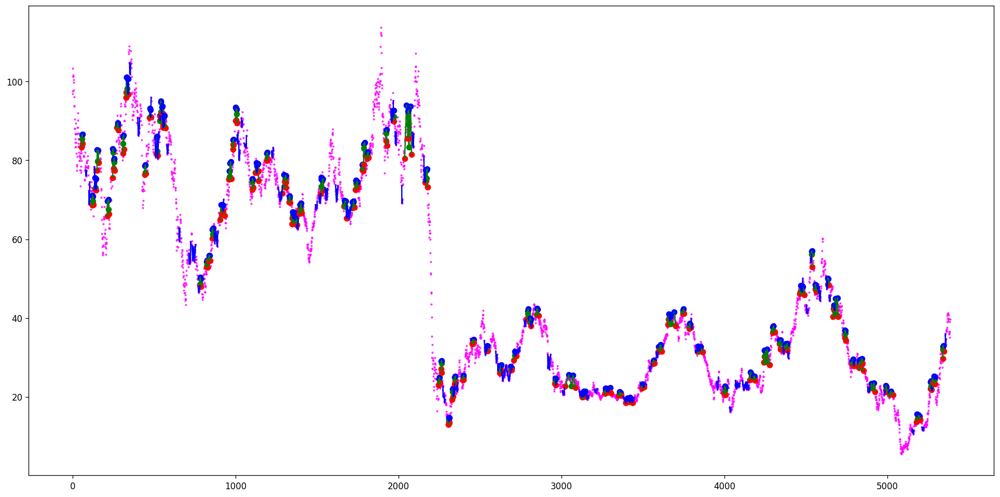

[(376, 382, 386, 390, 395), (376, 384, 386, 390, 395), (376, 385, 386, 390, 395), (532, 542, 556, 562, 563), (532, 550, 556, 562, 563)]
[(527, 532, 542, 556, 561), (636, 643, 650, 659, 665)]
Ticker AAAU found 5 double top patterns, 2 double bottom patterns


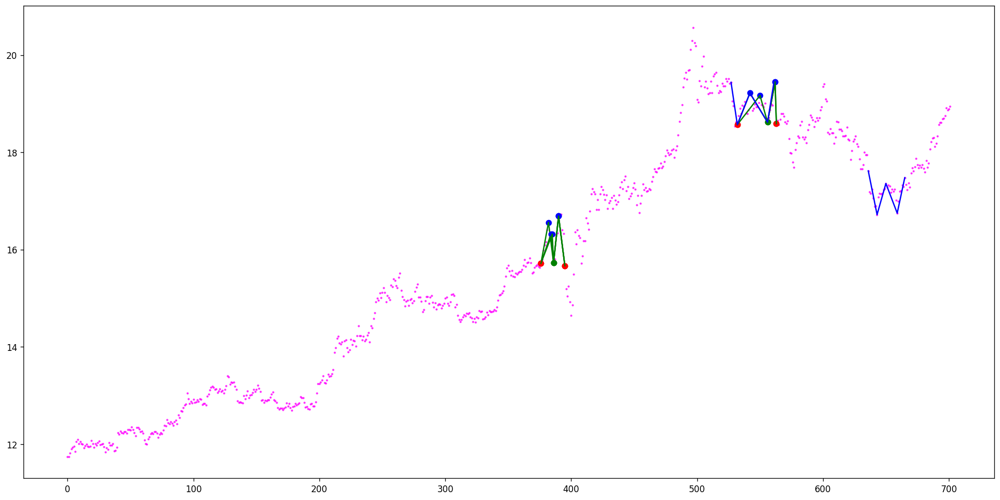

[(120, 121, 123, 131, 134), (146, 147, 148, 150, 152), (178, 179, 182, 185, 187), (866, 867, 873, 875, 877), (866, 869, 873, 875, 877), (905, 911, 916, 918, 921), (947, 954, 963, 964, 976)]
[(144, 146, 147, 148, 150), (287, 288, 296, 313, 316), (1060, 1067, 1071, 1072, 1073), (1407, 1409, 1418, 1420, 1433)]
Ticker AACG found 7 double top patterns, 4 double bottom patterns


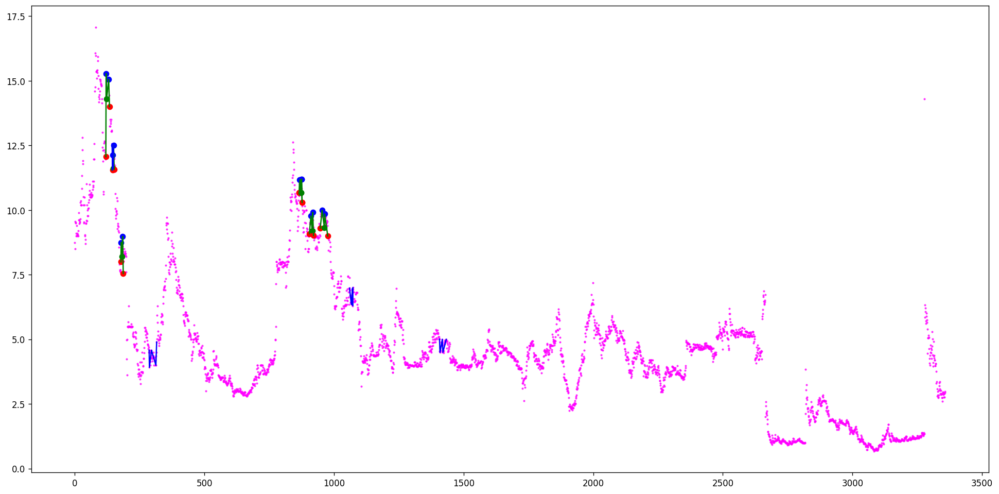

[(633, 661, 667, 693, 712), (633, 661, 667, 696, 712), (633, 661, 667, 702, 712), (760, 776, 782, 800, 813), (856, 866, 873, 881, 886), (856, 868, 873, 881, 886), (936, 944, 947, 961, 967), (1149, 1153, 1154, 1159, 1170), (1730, 1762, 1794, 1808, 1828), (1730, 1762, 1794, 1819, 1828), (2463, 2604, 2633, 2753, 2846), (2463, 2604, 2633, 2757, 2846), (2463, 2604, 2633, 2763, 2846), (2633, 2661, 2688, 2753, 2845), (2633, 2661, 2688, 2757, 2845), (2633, 2662, 2688, 2753, 2845), (2633, 2662, 2688, 2757, 2845), (2633, 2668, 2688, 2715, 2845), (2633, 2668, 2688, 2717, 2845), (2633, 2668, 2688, 2719, 2845), (2633, 2668, 2688, 2722, 2845), (2633, 2668, 2688, 2740, 2845), (2633, 2668, 2688, 2749, 2845), (2633, 2668, 2688, 2750, 2845), (2633, 2668, 2688, 2753, 2845), (3362, 3461, 3467, 3582, 3637), (3362, 3461, 3467, 3591, 3637), (3362, 3461, 3467, 3592, 3637), (3362, 3461, 3467, 3602, 3637), (3362, 3461, 3467, 3605, 3637), (3362, 3461, 3467, 3607, 3637), (3467, 3478, 3497, 3571, 3637), (3467, 347

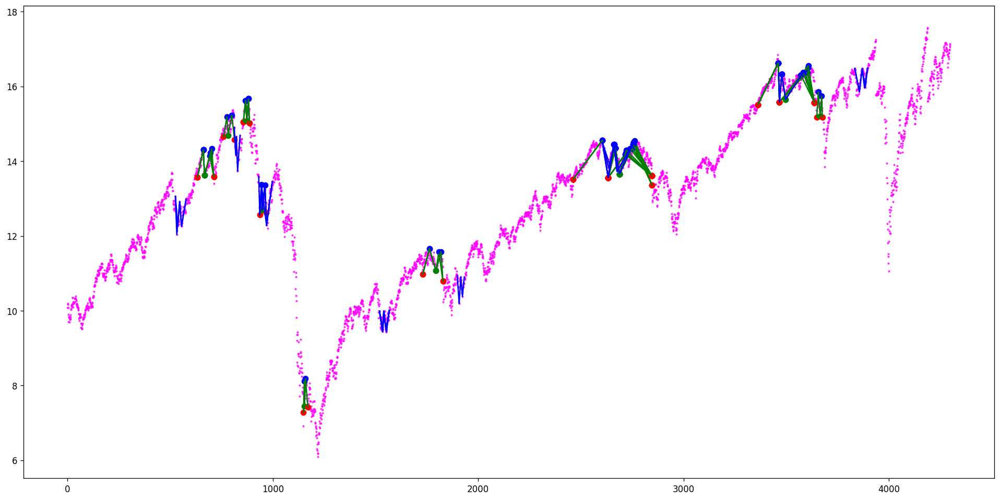

[(265, 280, 288, 297, 301), (265, 283, 288, 297, 301), (461, 492, 493, 502, 508), (540, 552, 580, 598, 604), (540, 572, 580, 598, 604), (540, 574, 580, 591, 604), (540, 574, 580, 594, 604), (540, 574, 580, 598, 604), (719, 731, 749, 754, 767), (719, 731, 749, 757, 767), (719, 731, 749, 760, 767), (719, 741, 749, 754, 767), (1004, 1047, 1060, 1068, 1092), (1004, 1047, 1060, 1069, 1092), (1275, 1304, 1314, 1321, 1327), (1554, 1599, 1606, 1612, 1615), (1720, 1751, 1761, 1780, 1799), (1720, 1751, 1761, 1783, 1799), (1720, 1751, 1761, 1789, 1799), (1720, 1751, 1761, 1790, 1799), (1720, 1751, 1761, 1791, 1799), (1847, 1863, 1866, 1872, 1879), (1847, 1863, 1866, 1874, 1879), (1847, 1863, 1879, 1891, 1900), (1847, 1874, 1879, 1884, 1900), (1847, 1874, 1879, 1885, 1900), (1847, 1874, 1879, 1887, 1900), (1847, 1874, 1879, 1891, 1900), (1847, 1876, 1879, 1884, 1900), (1810, 1891, 1914, 1952, 1983), (1810, 1895, 1914, 1950, 1983), (1810, 1895, 1914, 1952, 1983), (1810, 1897, 1914, 1950, 1983), (19

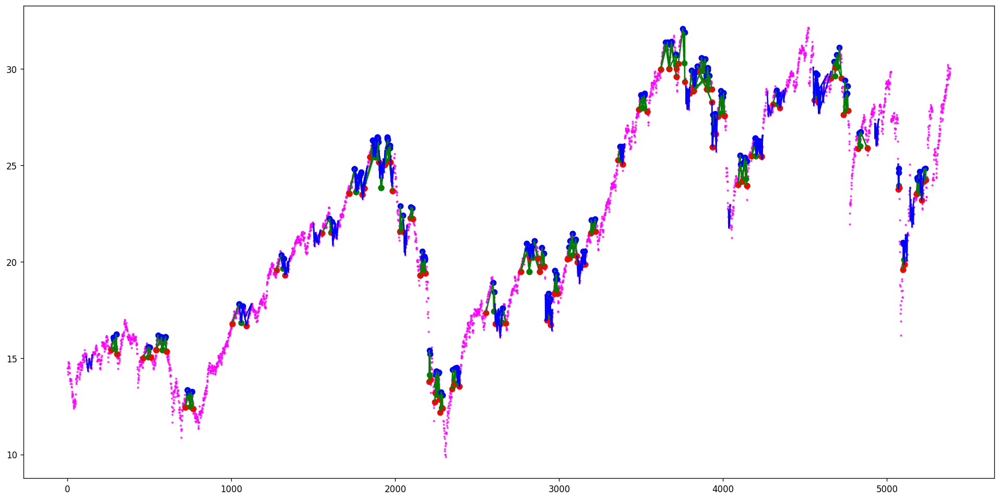

[(6, 14, 16, 20, 24), (64, 66, 70, 75, 81), (63, 75, 84, 87, 88), (109, 125, 127, 131, 164), (134, 148, 151, 153, 163), (134, 148, 151, 156, 163), (134, 148, 151, 158, 163), (174, 180, 188, 190, 229), (174, 182, 188, 190, 229), (174, 186, 188, 190, 229), (188, 197, 212, 217, 228), (188, 197, 212, 218, 228), (188, 200, 206, 210, 212), (188, 201, 206, 210, 212), (188, 205, 206, 210, 212), (188, 210, 212, 217, 228), (234, 243, 250, 255, 261), (234, 247, 250, 255, 261), (386, 405, 410, 418, 454), (386, 405, 410, 419, 454), (386, 405, 410, 421, 454), (386, 407, 410, 418, 454), (386, 408, 410, 418, 454), (420, 425, 427, 430, 434), (410, 439, 443, 450, 452), (410, 441, 443, 450, 452), (537, 550, 551, 553, 582), (537, 550, 551, 554, 582), (537, 550, 551, 555, 582), (552, 555, 561, 576, 582), (552, 555, 561, 579, 582), (655, 664, 673, 678, 681), (655, 664, 673, 680, 681), (655, 666, 673, 678, 681), (655, 668, 673, 678, 681), (748, 750, 757, 764, 781), (748, 751, 757, 764, 781), (748, 755, 757, 

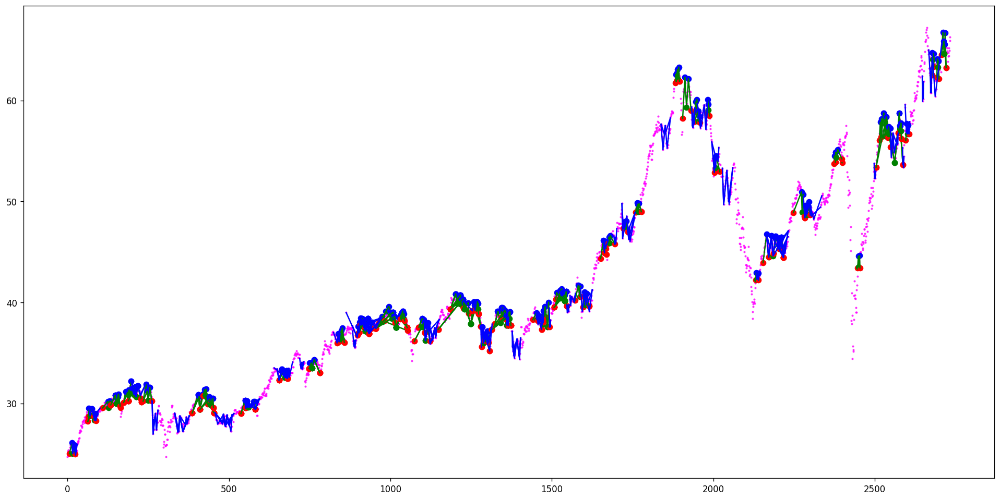

[(151, 192, 205, 213, 232), (151, 192, 205, 215, 232), (2669, 2768, 2774, 2889, 2953), (2669, 2768, 2774, 2912, 2953), (2669, 2768, 2774, 2914, 2953), (2669, 2768, 2774, 2930, 2953), (2774, 2785, 2804, 2889, 2953), (3392, 3420, 3434, 3447, 3461)]
[(238, 243, 251, 276, 305), (1134, 1137, 1154, 1169, 1191), (1134, 1139, 1154, 1169, 1191), (2769, 2774, 2785, 2804, 2888), (2769, 2774, 2785, 2809, 2888), (3420, 3434, 3447, 3461, 3465), (3420, 3435, 3447, 3459, 3465), (3420, 3435, 3447, 3461, 3465)]
Ticker AADTX found 8 double top patterns, 8 double bottom patterns


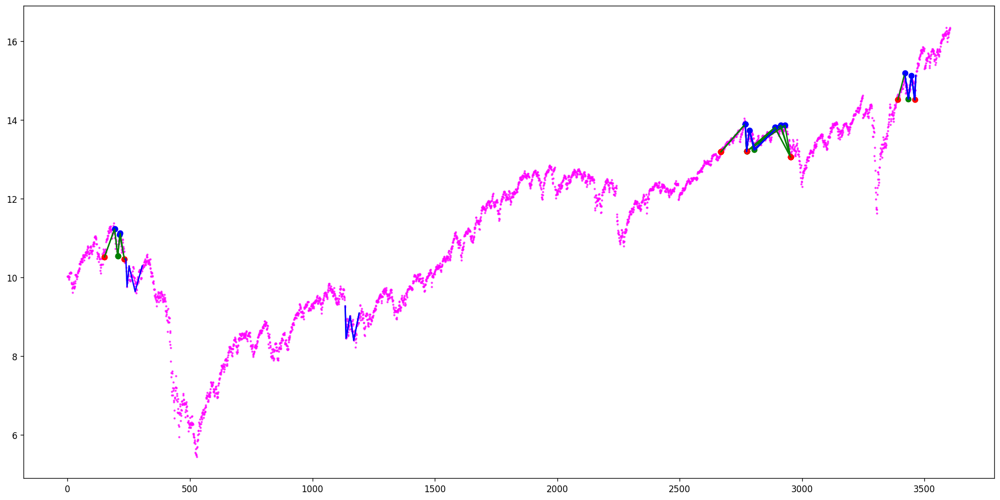

[(89, 90, 91, 92, 96), (89, 90, 91, 95, 96), (162, 163, 166, 167, 168), (162, 164, 166, 167, 168), (201, 202, 204, 205, 206), (201, 203, 204, 205, 206), (209, 210, 213, 215, 218), (233, 234, 236, 238, 245), (301, 302, 303, 304, 305), (333, 334, 336, 337, 338), (348, 349, 350, 351, 352), (375, 376, 380, 391, 400), (380, 385, 386, 387, 400), (380, 385, 386, 389, 400), (386, 387, 388, 389, 390), (390, 391, 392, 393, 394), (410, 411, 412, 413, 414), (410, 411, 414, 415, 416), (410, 413, 414, 415, 416), (417, 419, 420, 421, 422), (431, 432, 433, 435, 437), (431, 432, 437, 438, 440), (443, 444, 446, 447, 448), (458, 459, 460, 462, 463), (590, 592, 594, 598, 607), (648, 649, 650, 651, 654), (666, 667, 668, 671, 672), (817, 818, 819, 820, 821), (861, 867, 870, 873, 875), (1036, 1038, 1039, 1040, 1042), (1233, 1236, 1242, 1249, 1255), (1442, 1443, 1444, 1445, 1446), (1453, 1455, 1456, 1460, 1461), (1495, 1496, 1497, 1498, 1499), (1579, 1580, 1581, 1582, 1585), (1682, 1683, 1684, 1685, 1686), (1

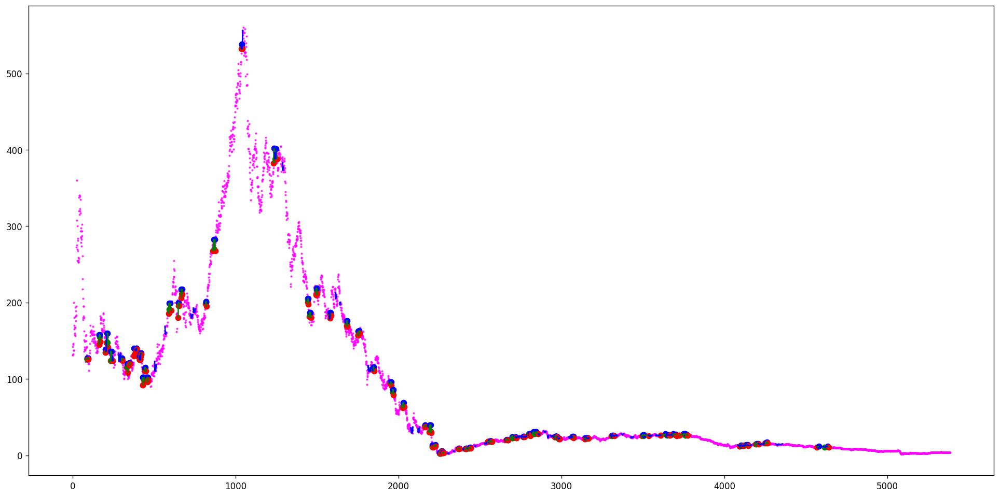

[(1727, 1737, 1745, 1771, 1789), (1848, 1859, 1863, 1869, 1878), (1973, 1995, 1996, 2007, 2014), (2455, 2463, 2468, 2471, 2472), (2542, 2543, 2544, 2548, 2549), (2593, 2598, 2602, 2604, 2607)]
[(1166, 1168, 1185, 1193, 1199), (1995, 1996, 2007, 2014, 2018), (2106, 2119, 2123, 2126, 2128), (2316, 2317, 2318, 2320, 2323), (2394, 2417, 2422, 2425, 2428), (2598, 2602, 2604, 2607, 2610)]
Ticker AAIGF found 6 double top patterns, 6 double bottom patterns


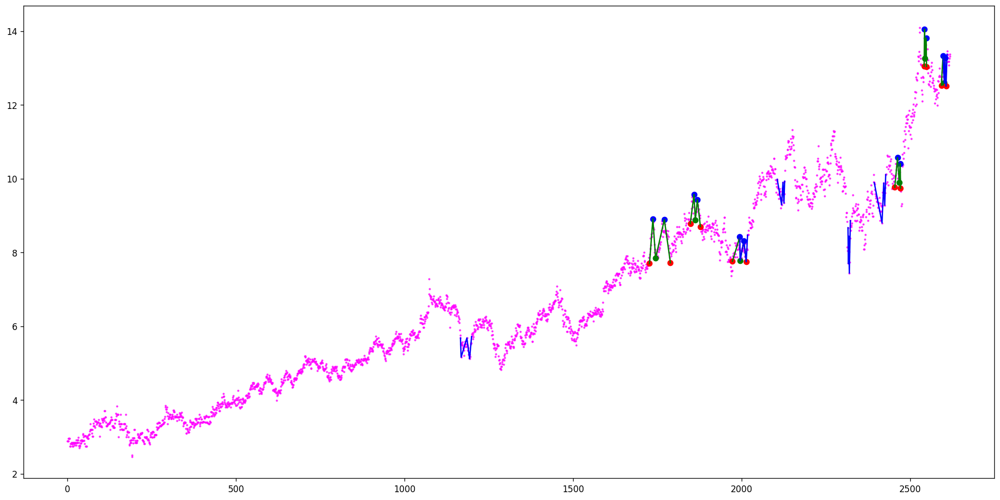

[(10, 11, 13, 16, 17), (19, 20, 21, 23, 24), (60, 61, 62, 63, 64), (87, 88, 90, 91, 93), (102, 108, 124, 137, 143), (124, 126, 131, 137, 138), (211, 212, 213, 216, 218), (215, 216, 218, 220, 221), (222, 223, 226, 232, 233), (270, 274, 277, 284, 287), (307, 308, 311, 317, 319), (307, 308, 311, 318, 319), (372, 375, 380, 384, 395), (372, 375, 380, 386, 395), (432, 435, 452, 461, 464), (468, 471, 478, 479, 485), (594, 595, 596, 597, 600), (594, 597, 600, 602, 605), (639, 641, 642, 645, 648), (790, 793, 794, 797, 798), (822, 825, 827, 829, 832), (822, 825, 827, 831, 832), (861, 870, 877, 880, 897), (861, 870, 877, 881, 897), (900, 901, 902, 903, 904), (922, 923, 928, 929, 932), (922, 926, 928, 929, 932), (965, 969, 971, 985, 986), (972, 975, 976, 977, 983), (976, 977, 978, 980, 983), (971, 980, 984, 985, 986), (971, 981, 984, 985, 986), (996, 998, 1000, 1003, 1006), (996, 999, 1000, 1003, 1006), (1022, 1023, 1026, 1028, 1031), (1057, 1058, 1059, 1062, 1064), (1057, 1058, 1059, 1063, 1064),

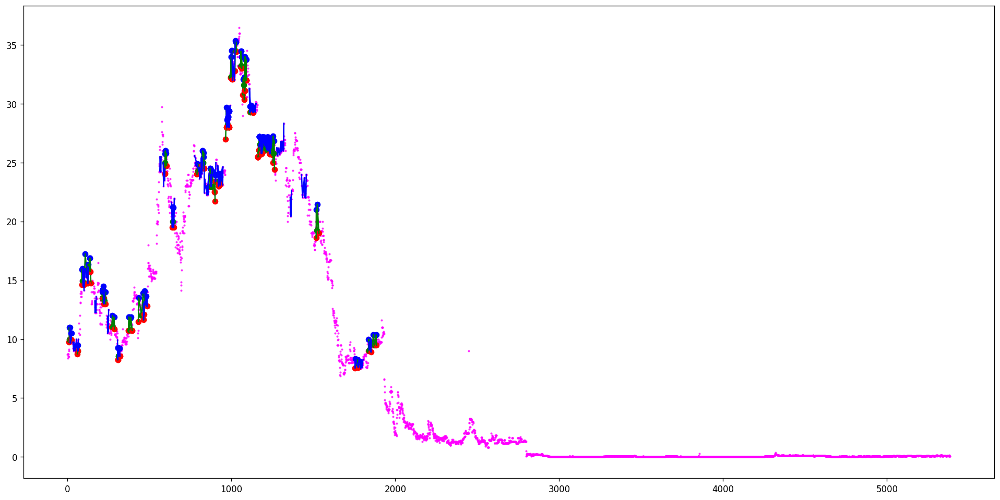

[(4, 7, 12, 13, 15), (4, 9, 12, 13, 15), (120, 121, 127, 128, 138), (127, 128, 130, 132, 134), (166, 167, 168, 169, 172), (193, 194, 195, 196, 197), (201, 203, 205, 208, 209), (255, 258, 260, 261, 264), (342, 343, 344, 346, 347), (379, 380, 381, 383, 384), (444, 446, 447, 454, 460), (447, 449, 450, 452, 460), (477, 478, 479, 480, 482), (520, 522, 525, 526, 528), (545, 546, 547, 548, 549), (1413, 1415, 1417, 1421, 1425), (1890, 1896, 1898, 1900, 1903), (2032, 2033, 2035, 2037, 2038), (2196, 2197, 2199, 2201, 2203), (2208, 2213, 2215, 2219, 2221), (2215, 2216, 2218, 2219, 2220), (2234, 2239, 2246, 2247, 2249), (2256, 2257, 2258, 2259, 2260), (2312, 2314, 2316, 2318, 2321), (2312, 2314, 2316, 2320, 2321), (2317, 2318, 2319, 2320, 2321), (2329, 2332, 2335, 2336, 2337), (2461, 2463, 2468, 2471, 2472), (2536, 2537, 2539, 2543, 2544), (2594, 2597, 2598, 2600, 2601), (2716, 2719, 2722, 2723, 2730), (2722, 2723, 2724, 2725, 2728), (2818, 2821, 2822, 2829, 2834), (2817, 2821, 2838, 2852, 2854), 

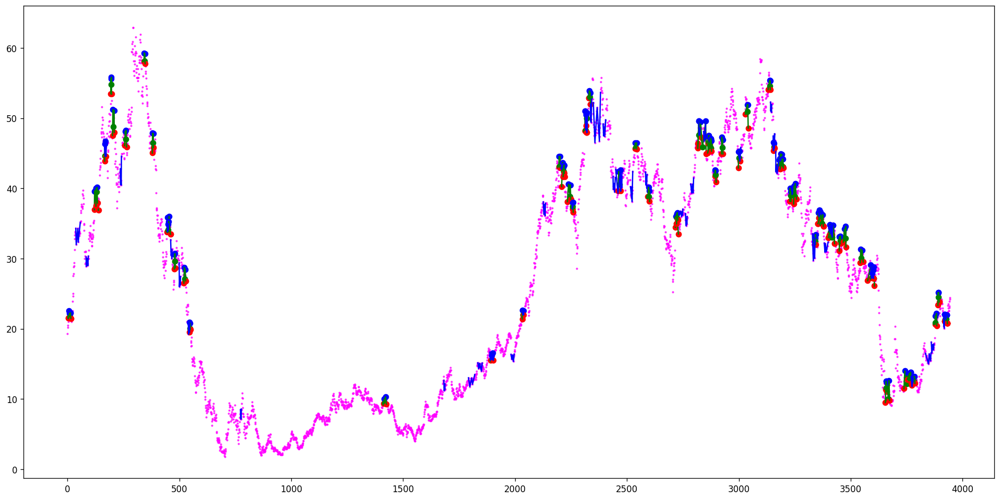

[(221, 222, 223, 224, 225), (290, 291, 292, 293, 296), (290, 291, 292, 295, 296), (292, 293, 294, 295, 296), (317, 318, 319, 320, 321), (691, 692, 693, 694, 695), (977, 981, 983, 986, 987), (1040, 1041, 1042, 1044, 1046), (1118, 1119, 1121, 1124, 1126), (1128, 1129, 1130, 1132, 1133), (1137, 1138, 1139, 1140, 1141), (1146, 1148, 1151, 1153, 1166), (1192, 1193, 1194, 1196, 1197), (1217, 1222, 1223, 1224, 1225), (1272, 1275, 1276, 1278, 1280), (1272, 1275, 1276, 1279, 1280), (1285, 1287, 1292, 1297, 1298), (1372, 1382, 1384, 1385, 1403), (1372, 1382, 1384, 1386, 1403), (1488, 1489, 1490, 1491, 1493), (1502, 1503, 1504, 1505, 1507), (1502, 1503, 1504, 1506, 1507), (1685, 1687, 1689, 1692, 1695), (1755, 1757, 1759, 1760, 1768), (1773, 1777, 1785, 1794, 1796), (1773, 1777, 1785, 1795, 1796), (1838, 1839, 1841, 1843, 1845), (1961, 1963, 1965, 1970, 1971), (1974, 1975, 1977, 1978, 1981), (1994, 1996, 1997, 2008, 2018), (2018, 2019, 2020, 2024, 2032), (2086, 2088, 2091, 2097, 2100), (2119, 212

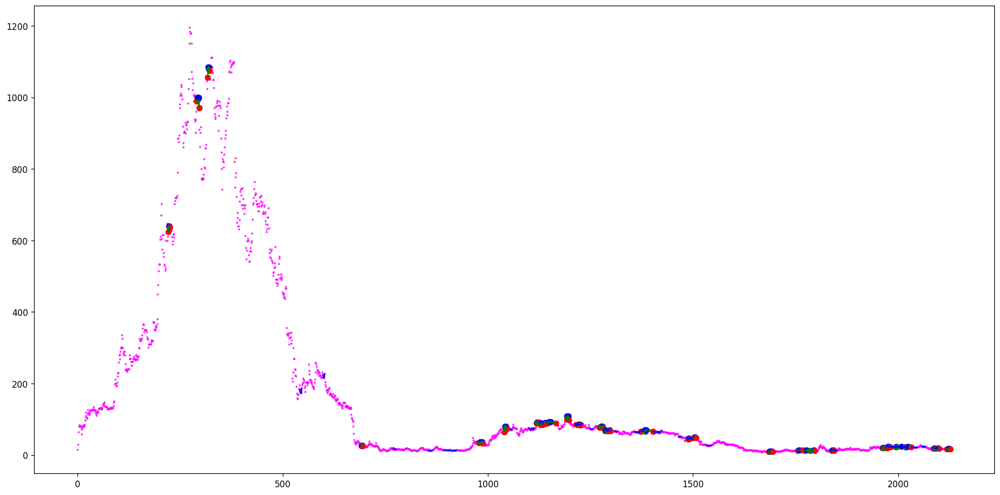

[]
[(88, 93, 97, 98, 101), (97, 98, 99, 100, 101)]
Ticker AAN found 0 double top patterns, 2 double bottom patterns


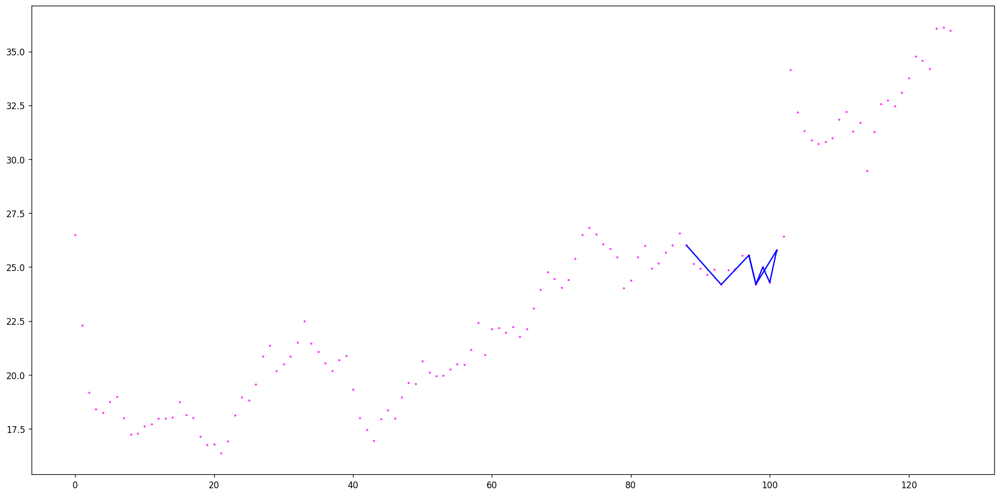

[(22, 23, 24, 29, 35), (50, 53, 55, 56, 67), (181, 186, 188, 191, 194), (181, 186, 194, 198, 202), (369, 374, 377, 378, 383), (377, 378, 383, 385, 387), (377, 382, 383, 385, 387), (416, 417, 427, 438, 441), (427, 431, 437, 438, 441), (427, 434, 437, 438, 441), (586, 589, 591, 593, 595), (746, 750, 751, 752, 753), (805, 807, 811, 814, 822), (910, 911, 912, 913, 914), (910, 913, 914, 915, 916), (926, 929, 930, 931, 932), (1039, 1040, 1042, 1043, 1046), (1085, 1086, 1087, 1088, 1089), (1094, 1095, 1097, 1098, 1099), (1176, 1177, 1178, 1180, 1181), (1205, 1206, 1207, 1208, 1209), (1235, 1237, 1238, 1239, 1241), (1270, 1271, 1272, 1273, 1276), (1289, 1290, 1292, 1306, 1309), (1292, 1295, 1298, 1306, 1309), (1537, 1539, 1540, 1542, 1547), (1853, 1855, 1856, 1859, 1863)]
[(18, 22, 29, 37, 45), (130, 132, 134, 136, 140), (186, 188, 191, 194, 198), (325, 328, 335, 339, 343), (374, 377, 378, 388, 390), (379, 383, 385, 388, 390), (418, 421, 423, 424, 431), (423, 424, 425, 427, 428), (417, 427, 43

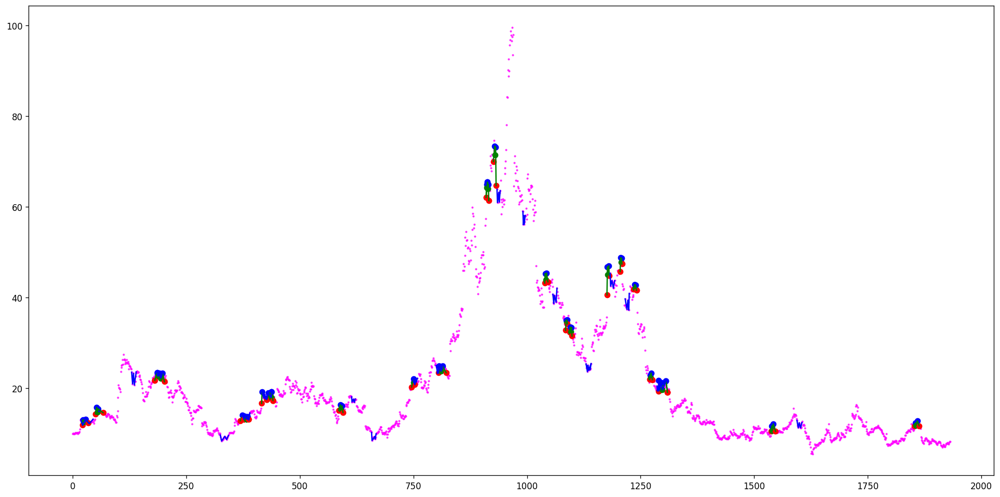

[(107, 108, 112, 114, 122), (175, 184, 191, 196, 205), (175, 184, 191, 200, 205), (366, 377, 382, 383, 391), (366, 377, 382, 388, 391), (528, 529, 531, 534, 537), (528, 534, 537, 539, 542), (528, 536, 537, 539, 542), (601, 602, 604, 605, 607), (600, 605, 610, 611, 612), (600, 609, 610, 611, 612), (661, 663, 668, 670, 673), (742, 745, 750, 753, 755), (742, 748, 750, 753, 755), (741, 753, 755, 757, 770), (741, 753, 755, 765, 770), (741, 753, 755, 767, 770), (809, 810, 812, 818, 826), (1002, 1005, 1006, 1010, 1020), (1009, 1012, 1013, 1015, 1016), (1002, 1015, 1021, 1032, 1042), (1001, 1035, 1043, 1059, 1063), (1045, 1046, 1048, 1049, 1051), (1063, 1074, 1076, 1086, 1093), (1077, 1079, 1083, 1086, 1093), (1106, 1110, 1113, 1117, 1123), (1142, 1143, 1146, 1149, 1151), (1225, 1228, 1229, 1231, 1240), (1230, 1234, 1235, 1236, 1239), (1262, 1270, 1271, 1274, 1283), (1293, 1295, 1299, 1300, 1310), (1291, 1306, 1310, 1311, 1320), (1310, 1311, 1313, 1317, 1318), (1354, 1358, 1365, 1368, 1399), (

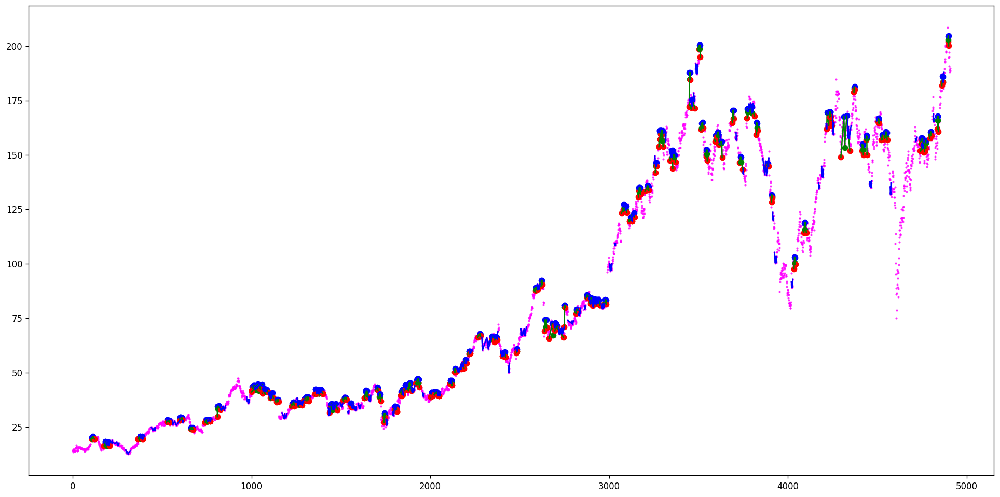

[(2711, 2714, 2723, 2727, 2736), (2785, 2798, 2801, 2809, 2817), (2840, 2855, 2865, 2869, 2874), (3144, 3148, 3151, 3156, 3160), (3422, 3427, 3436, 3441, 3443), (3497, 3503, 3513, 3515, 3522), (3497, 3505, 3513, 3515, 3522), (3677, 3688, 3693, 3696, 3705), (3677, 3688, 3693, 3700, 3705), (3677, 3688, 3693, 3703, 3705), (3676, 3703, 3705, 3706, 3719), (3676, 3703, 3705, 3708, 3719), (3676, 3703, 3705, 3715, 3719), (3705, 3706, 3713, 3715, 3718), (3705, 3708, 3713, 3715, 3718), (3845, 3851, 3858, 3870, 3895), (3845, 3855, 3858, 3860, 3895), (3845, 3855, 3858, 3864, 3895), (3845, 3855, 3858, 3866, 3895), (3865, 3870, 3871, 3872, 3878), (3940, 3941, 3943, 3944, 3959), (3975, 3977, 3979, 3981, 3992), (3973, 3987, 3992, 3997, 4013), (3994, 3997, 4005, 4006, 4011), (3994, 3999, 4005, 4006, 4011), (3994, 4002, 4005, 4006, 4011), (4029, 4031, 4032, 4033, 4034), (4042, 4043, 4045, 4047, 4048), (4083, 4087, 4090, 4095, 4097), (4083, 4089, 4090, 4095, 4097), (4173, 4186, 4191, 4196, 4197), (4201, 

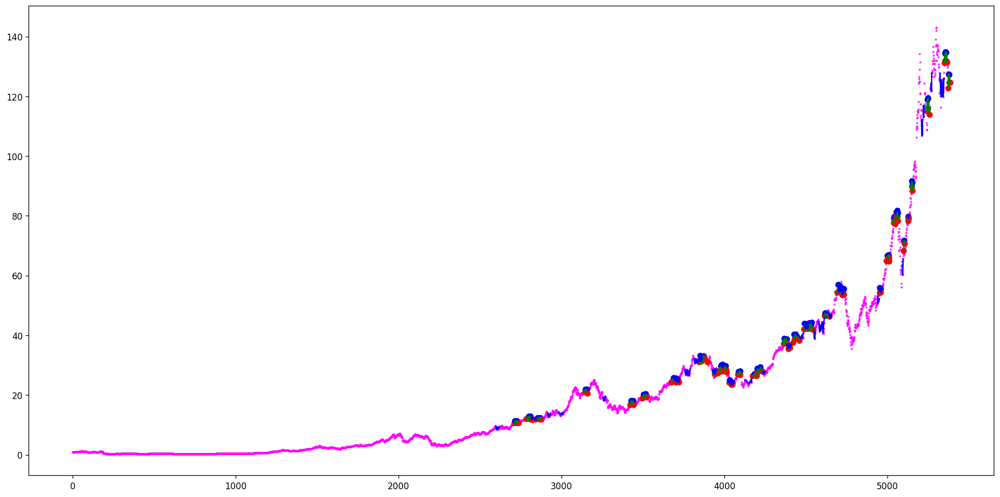

[(528, 529, 532, 539, 541), (693, 699, 701, 702, 710), (712, 713, 714, 719, 725)]
[(709, 712, 713, 714, 719), (755, 756, 759, 763, 771)]
Ticker AASZF found 3 double top patterns, 2 double bottom patterns


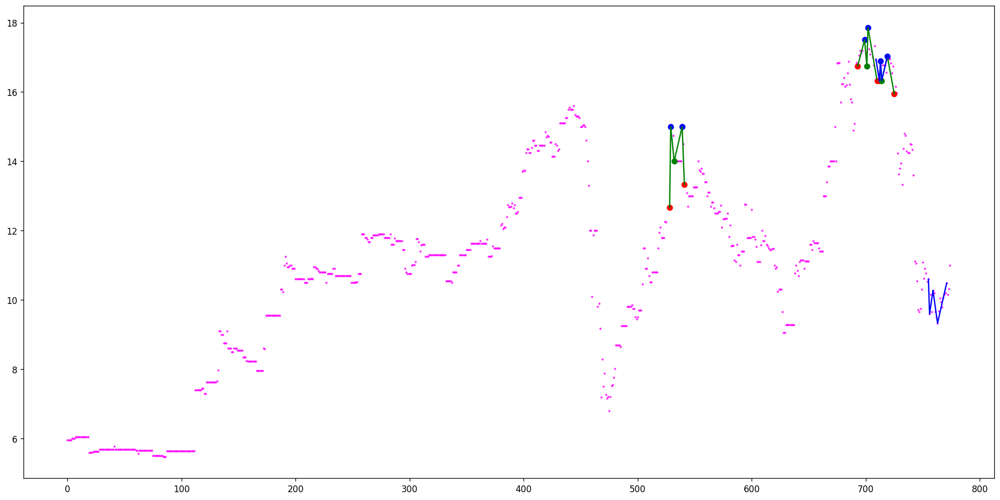

[(52, 57, 61, 74, 89), (107, 123, 125, 126, 138), (146, 149, 151, 159, 174), (156, 159, 161, 163, 165), (152, 163, 166, 170, 173), (219, 222, 228, 234, 248), (219, 222, 228, 237, 248), (259, 268, 273, 275, 283), (259, 268, 273, 277, 283), (293, 306, 311, 324, 348), (293, 309, 311, 324, 348), (320, 336, 339, 345, 347), (414, 415, 419, 422, 425), (402, 422, 429, 436, 462), (402, 422, 429, 443, 462), (432, 448, 451, 457, 458), (429, 457, 458, 460, 462), (555, 558, 561, 563, 564), (712, 714, 718, 719, 722), (775, 779, 785, 787, 790), (774, 779, 793, 797, 815), (774, 779, 793, 800, 815), (774, 787, 793, 797, 815), (795, 800, 803, 808, 814), (825, 829, 831, 833, 838), (843, 852, 857, 862, 921), (843, 852, 857, 865, 921), (843, 852, 857, 871, 921), (843, 852, 857, 876, 921), (843, 852, 857, 878, 921), (859, 888, 894, 901, 921), (859, 888, 894, 903, 921), (859, 888, 894, 914, 921), (859, 888, 894, 917, 921), (897, 901, 902, 903, 919), (902, 903, 910, 914, 919), (961, 965, 971, 975, 987), (961,

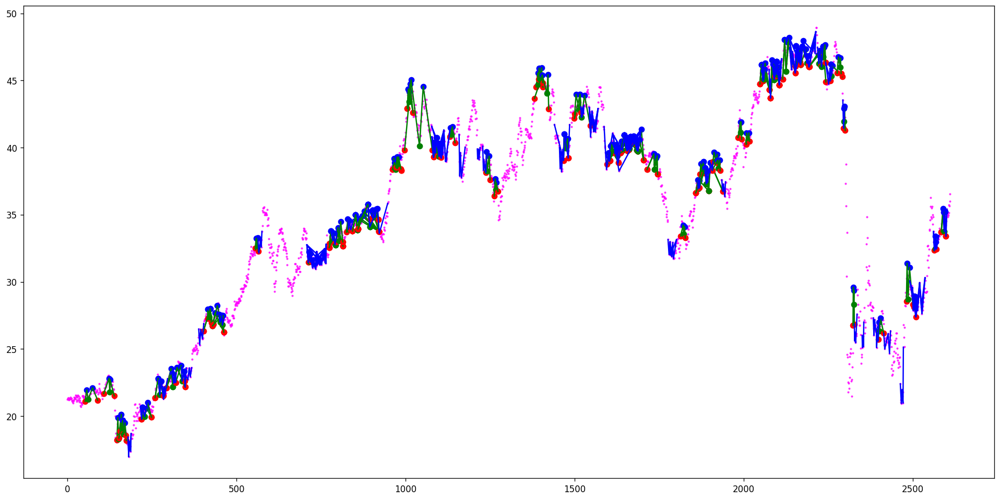

[(5, 15, 16, 24, 28), (5, 15, 16, 27, 28), (141, 152, 153, 157, 158), (324, 330, 338, 340, 352), (402, 403, 404, 405, 406), (438, 444, 445, 450, 454), (438, 444, 445, 451, 454), (438, 444, 454, 456, 502), (438, 450, 454, 456, 502), (438, 451, 454, 456, 502), (438, 452, 454, 456, 502), (438, 453, 454, 456, 502), (455, 456, 457, 459, 461), (455, 459, 463, 471, 502), (465, 471, 474, 476, 502), (465, 472, 474, 476, 502), (478, 480, 484, 485, 502), (484, 485, 486, 487, 489), (484, 485, 486, 488, 489), (484, 490, 494, 498, 501), (484, 490, 494, 499, 501), (514, 531, 543, 546, 568), (514, 531, 543, 548, 568), (514, 541, 543, 544, 568), (514, 541, 543, 545, 568), (543, 548, 552, 553, 554), (543, 553, 565, 567, 568), (555, 557, 559, 560, 565), (555, 557, 559, 561, 565), (555, 557, 559, 562, 565), (555, 558, 559, 560, 565), (555, 558, 559, 561, 565), (555, 558, 559, 562, 565), (569, 571, 573, 577, 584), (569, 572, 573, 577, 584), (584, 587, 589, 590, 604), (584, 587, 589, 591, 604), (584, 587, 5

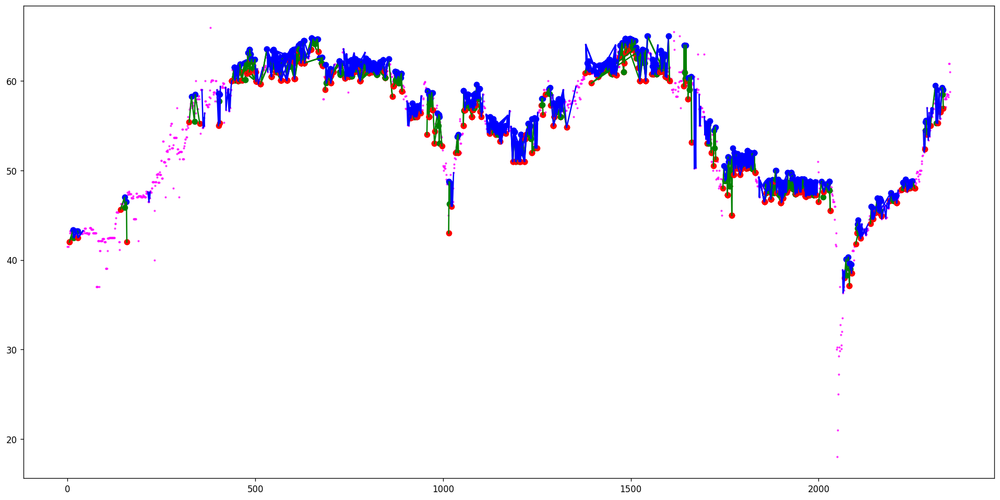

[(146, 168, 177, 183, 224), (146, 168, 177, 185, 224), (146, 168, 177, 187, 224), (146, 168, 177, 190, 224), (146, 168, 177, 191, 224), (178, 191, 195, 199, 222), (369, 372, 375, 377, 381), (575, 576, 581, 584, 613), (582, 584, 585, 589, 595), (944, 946, 951, 953, 956), (1037, 1044, 1051, 1056, 1072), (1037, 1044, 1051, 1061, 1072), (1037, 1046, 1051, 1056, 1072), (1373, 1379, 1382, 1385, 1387), (1905, 1910, 1912, 1914, 1926), (2794, 2797, 2801, 2834, 2843)]
[(390, 394, 396, 405, 415), (479, 488, 493, 496, 514), (494, 496, 501, 505, 514), (494, 496, 501, 509, 514), (571, 574, 576, 581, 583), (729, 744, 751, 754, 765), (1092, 1098, 1101, 1103, 1105), (1379, 1382, 1385, 1387, 1391), (2860, 2869, 2874, 2894, 2897)]
Ticker AAVVF found 16 double top patterns, 9 double bottom patterns


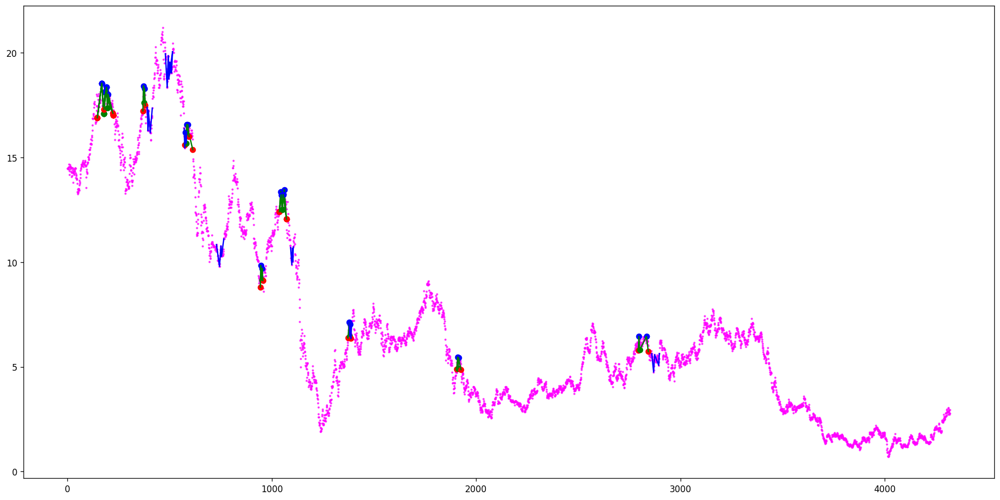

[(195, 199, 201, 208, 209), (309, 310, 315, 316, 317)]
[(165, 167, 168, 173, 174), (174, 185, 189, 191, 192), (308, 309, 310, 315, 316), (308, 309, 316, 317, 332), (870, 871, 872, 880, 881)]
Ticker AAVXF found 2 double top patterns, 5 double bottom patterns


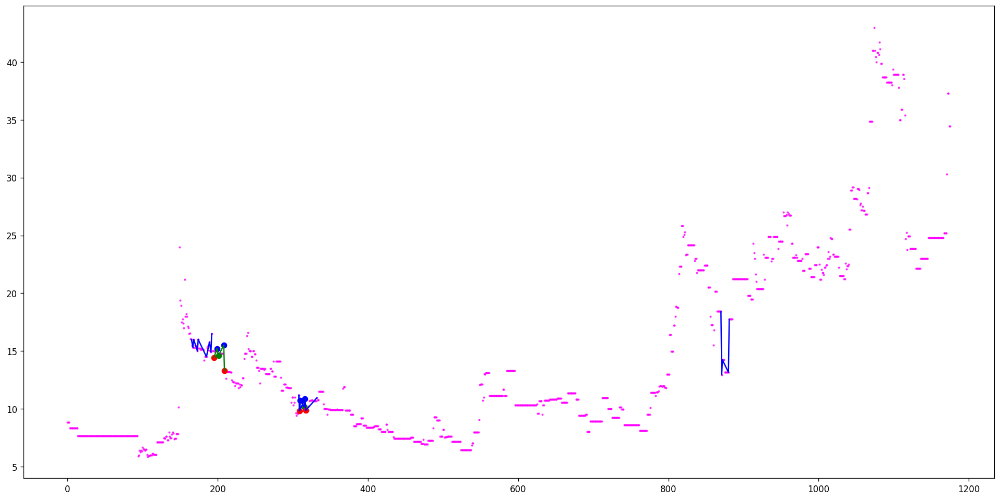

[(32, 34, 36, 37, 38), (32, 35, 36, 37, 38), (54, 56, 58, 62, 66), (54, 56, 58, 65, 66), (54, 65, 73, 76, 80), (84, 88, 90, 92, 93), (82, 88, 93, 96, 98), (82, 92, 93, 96, 98), (117, 118, 119, 121, 131), (117, 118, 119, 122, 131), (122, 123, 127, 128, 129), (122, 126, 127, 128, 129), (147, 159, 160, 161, 162), (356, 357, 359, 361, 367), (355, 361, 368, 373, 393), (355, 365, 368, 373, 393), (370, 376, 378, 379, 385), (370, 376, 378, 383, 385), (378, 379, 380, 383, 384), (368, 383, 385, 387, 393), (410, 414, 416, 419, 424), (417, 419, 420, 422, 424), (483, 502, 503, 506, 509), (545, 546, 547, 548, 549), (543, 552, 557, 559, 569), (584, 585, 586, 587, 588), (690, 691, 693, 695, 698), (911, 912, 914, 915, 916), (953, 954, 955, 956, 958), (1043, 1044, 1045, 1051, 1055), (1109, 1113, 1116, 1119, 1126), (1109, 1113, 1116, 1120, 1126), (1223, 1224, 1225, 1227, 1230), (1243, 1244, 1245, 1249, 1251), (1488, 1491, 1492, 1493, 1496), (1492, 1493, 1494, 1495, 1496), (1505, 1507, 1509, 1510, 1511), 

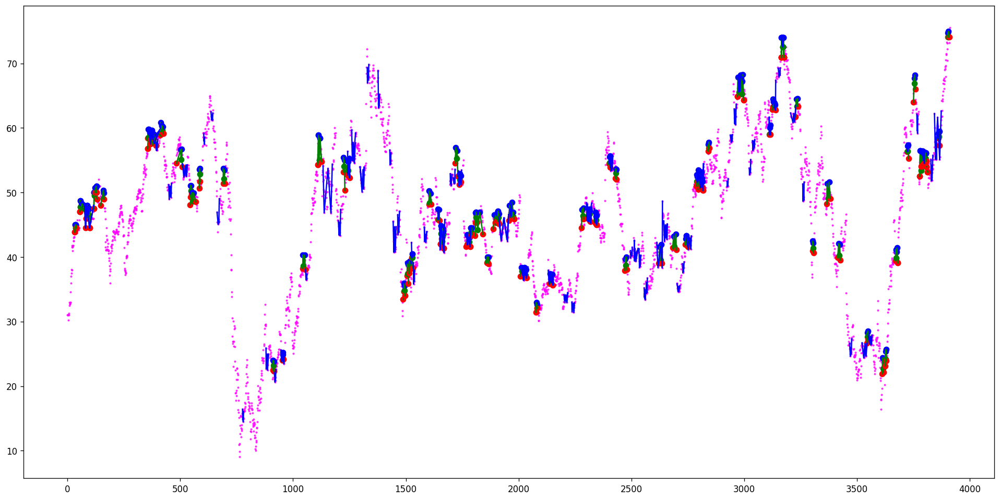

[(58, 60, 62, 63, 66), (162, 167, 169, 173, 174), (169, 170, 171, 173, 174), (178, 179, 180, 181, 182), (196, 198, 203, 206, 208), (215, 218, 219, 220, 221), (231, 232, 234, 242, 252), (239, 246, 248, 250, 252), (272, 273, 276, 277, 279), (271, 277, 281, 283, 284), (292, 293, 295, 296, 302), (347, 353, 357, 358, 359), (409, 411, 416, 417, 419), (409, 414, 416, 417, 419), (447, 448, 450, 452, 454), (459, 464, 467, 468, 470), (535, 564, 577, 601, 627), (578, 579, 583, 587, 588), (577, 617, 618, 623, 626), (660, 663, 673, 676, 691), (660, 664, 673, 676, 691), (660, 665, 673, 676, 691), (659, 690, 693, 694, 697), (722, 728, 731, 741, 748), (737, 741, 742, 745, 746), (764, 767, 769, 771, 773), (873, 874, 876, 878, 879), (872, 878, 879, 884, 895), (871, 892, 895, 900, 919), (896, 906, 907, 909, 912), (895, 909, 912, 914, 918), (864, 914, 919, 921, 940), (864, 914, 919, 935, 940), (920, 921, 923, 924, 928), (919, 921, 928, 935, 939), (919, 924, 928, 931, 939), (919, 924, 928, 935, 939), (919,

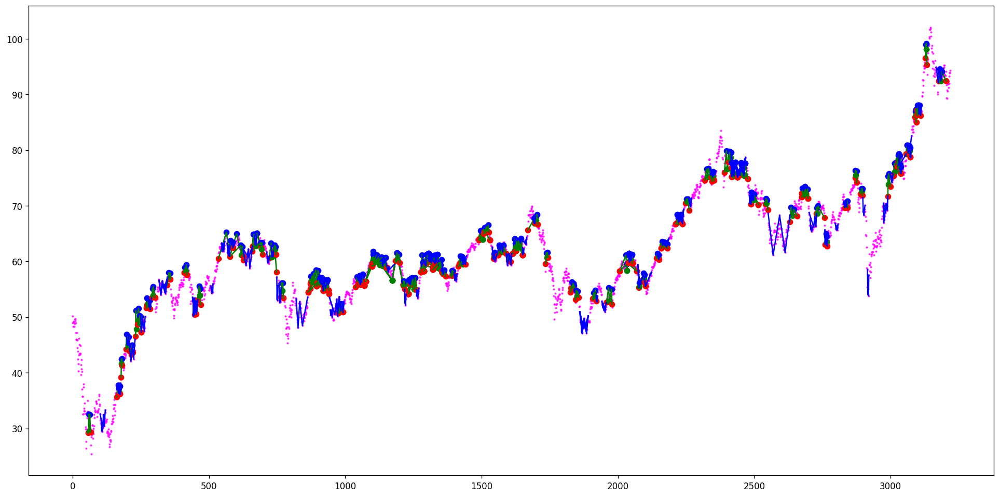

[(13, 20, 25, 30, 44), (222, 227, 229, 232, 236), (1570, 1572, 1576, 1577, 1580), (1583, 1584, 1588, 1591, 1592), (1583, 1587, 1588, 1591, 1592), (1602, 1604, 1605, 1606, 1612), (1635, 1638, 1639, 1641, 1642), (1670, 1671, 1673, 1675, 1680), (1728, 1730, 1738, 1741, 1743), (1784, 1787, 1789, 1790, 1798), (1784, 1793, 1798, 1799, 1800), (1931, 1935, 1938, 1945, 1951), (1998, 1999, 2000, 2002, 2003), (2010, 2017, 2018, 2020, 2024), (2089, 2091, 2097, 2099, 2101), (2117, 2122, 2123, 2126, 2129), (2154, 2164, 2168, 2172, 2173), (2210, 2213, 2215, 2217, 2219), (2292, 2293, 2296, 2297, 2303), (2323, 2326, 2327, 2330, 2331), (2461, 2466, 2476, 2480, 2497), (2461, 2466, 2476, 2482, 2497), (2461, 2466, 2476, 2487, 2497), (2461, 2469, 2476, 2478, 2497), (2461, 2469, 2476, 2479, 2497), (2461, 2469, 2476, 2480, 2497), (2477, 2482, 2484, 2487, 2495), (2534, 2537, 2540, 2544, 2546), (2534, 2539, 2540, 2544, 2546), (2599, 2600, 2601, 2604, 2607), (2745, 2753, 2756, 2758, 2761), (2745, 2753, 2761, 276

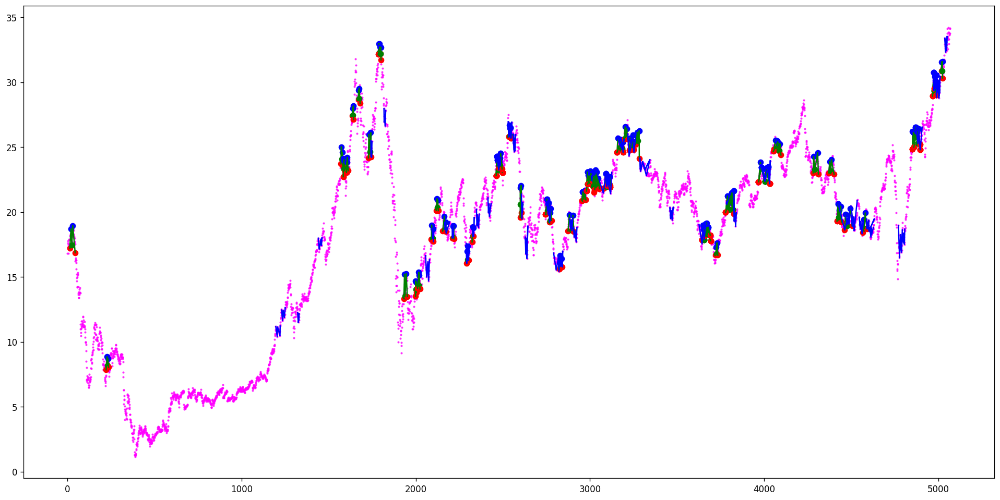

[(11, 12, 13, 14, 25), (13, 18, 20, 22, 25), (78, 79, 80, 81, 83), (93, 94, 95, 97, 99), (103, 105, 106, 108, 111), (103, 108, 111, 115, 117), (131, 132, 134, 138, 140), (129, 132, 140, 143, 156), (129, 138, 140, 143, 156), (292, 305, 311, 315, 317), (349, 362, 363, 364, 369), (349, 362, 363, 367, 369), (425, 430, 434, 437, 440), (434, 435, 436, 437, 439), (423, 437, 441, 442, 444), (479, 483, 484, 486, 489), (580, 581, 582, 583, 585), (619, 621, 623, 625, 626), (617, 625, 626, 638, 664), (617, 625, 626, 639, 664), (617, 625, 626, 640, 664), (633, 640, 644, 646, 663), (644, 655, 656, 657, 663), (644, 655, 656, 660, 663), (713, 714, 715, 716, 720), (715, 716, 717, 718, 720), (794, 795, 796, 799, 800), (794, 799, 800, 801, 807), (830, 832, 835, 839, 849), (826, 848, 851, 858, 877), (868, 870, 873, 875, 876), (899, 901, 904, 907, 918), (899, 901, 904, 911, 918), (955, 958, 959, 961, 964), (992, 998, 1001, 1004, 1014), (992, 999, 1001, 1004, 1014), (1053, 1057, 1061, 1065, 1069), (1125, 11

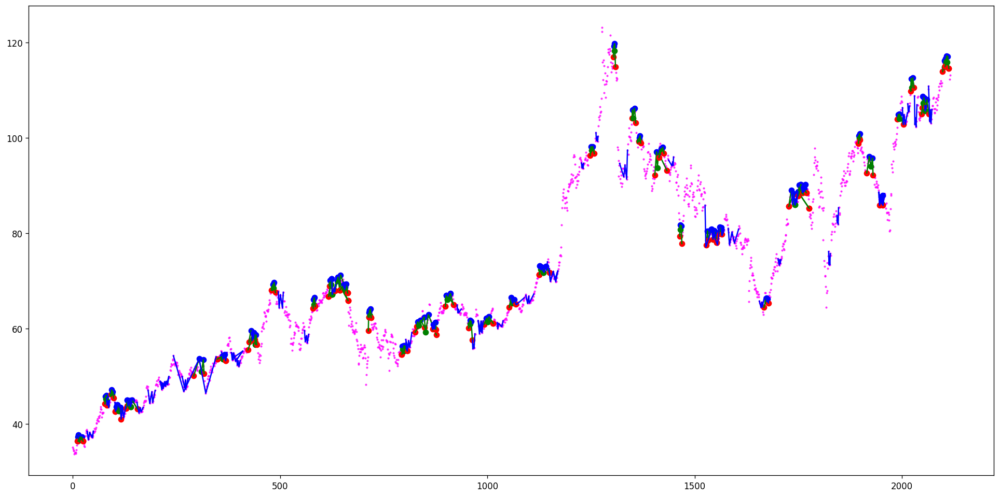

[(147, 150, 157, 160, 163), (283, 290, 291, 294, 299), (354, 357, 363, 370, 376), (431, 435, 445, 447, 455), (431, 435, 445, 451, 455), (431, 440, 445, 447, 455), (607, 609, 611, 616, 619), (660, 661, 662, 666, 668), (660, 666, 668, 677, 678), (692, 693, 695, 697, 701), (692, 697, 701, 703, 713), (750, 754, 764, 770, 782), (864, 869, 871, 877, 889), (968, 975, 977, 983, 989), (1551, 1572, 1576, 1582, 1586), (1588, 1600, 1603, 1607, 1609), (1693, 1712, 1724, 1729, 1754), (1693, 1717, 1724, 1729, 1754), (1724, 1729, 1735, 1740, 1754), (1724, 1729, 1735, 1747, 1754), (1839, 1846, 1848, 1849, 1850), (1850, 1854, 1857, 1859, 1872), (1986, 1989, 1991, 1994, 1998), (2014, 2017, 2019, 2020, 2024), (2013, 2017, 2026, 2028, 2037), (2013, 2020, 2026, 2028, 2037), (2061, 2065, 2080, 2096, 2132), (2088, 2091, 2092, 2096, 2120), (2092, 2096, 2107, 2117, 2119), (2150, 2151, 2153, 2159, 2173), (2150, 2151, 2153, 2162, 2173), (2206, 2207, 2209, 2213, 2217), (2217, 2218, 2219, 2222, 2229), (2277, 2280, 

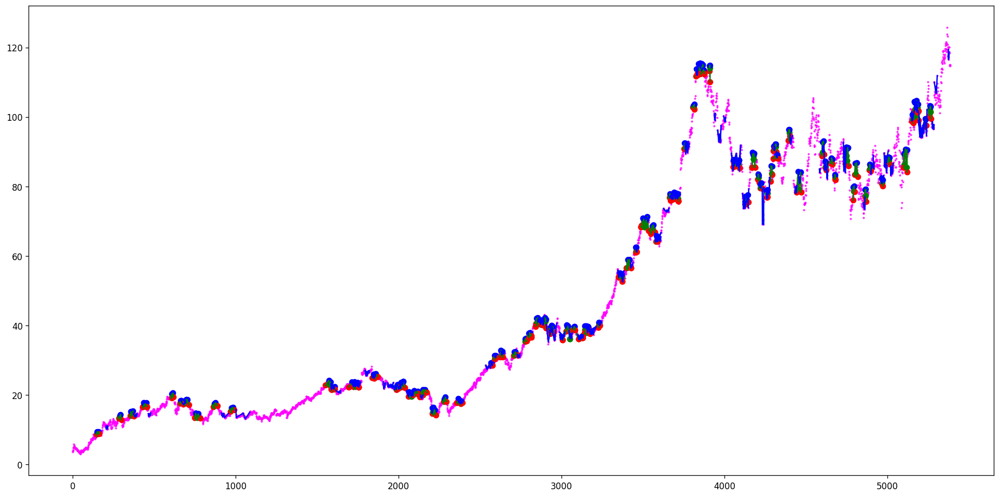

[(162, 163, 171, 188, 194), (209, 210, 223, 228, 230), (490, 503, 505, 506, 526), (490, 503, 505, 508, 526), (641, 644, 648, 650, 651), (909, 912, 915, 920, 936), (974, 978, 989, 990, 992), (974, 982, 989, 990, 992), (974, 987, 989, 990, 992), (974, 990, 992, 993, 1003), (1027, 1032, 1033, 1046, 1058), (1079, 1083, 1092, 1094, 1097), (1212, 1215, 1218, 1223, 1232), (1212, 1223, 1232, 1235, 1240), (1212, 1223, 1240, 1250, 1256), (1212, 1235, 1240, 1250, 1256), (1240, 1244, 1246, 1250, 1256), (1247, 1250, 1251, 1252, 1255), (1292, 1299, 1301, 1305, 1311), (1327, 1329, 1330, 1332, 1337), (1327, 1329, 1337, 1342, 1360), (1337, 1342, 1347, 1350, 1359), (1337, 1345, 1347, 1348, 1359), (1337, 1345, 1347, 1350, 1359), (1385, 1387, 1391, 1393, 1405), (1385, 1387, 1391, 1395, 1405), (1385, 1387, 1391, 1400, 1405), (1391, 1393, 1394, 1395, 1405), (1437, 1441, 1442, 1444, 1447), (1538, 1545, 1553, 1581, 1597), (1553, 1560, 1561, 1563, 1566), (1553, 1560, 1566, 1569, 1576), (1602, 1608, 1610, 1612,

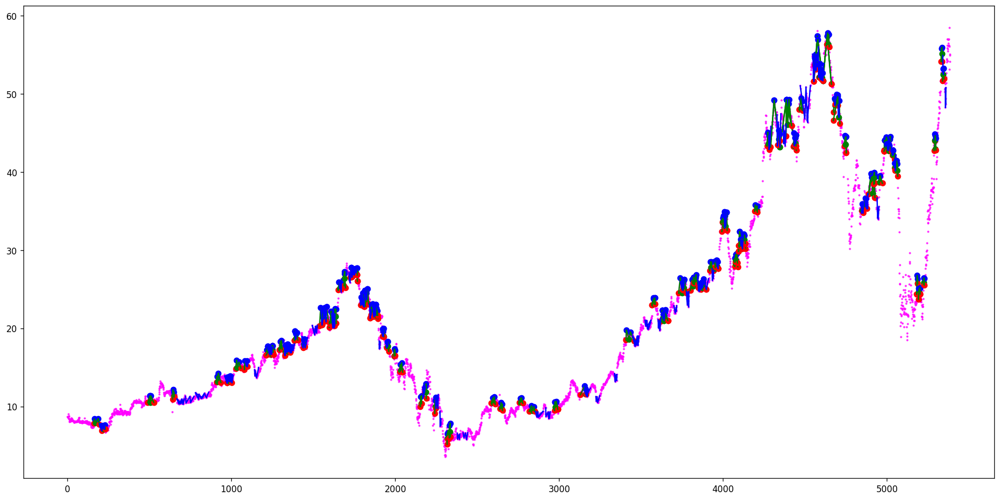

[]
[(79, 81, 85, 87, 91)]
Ticker ABCL found 0 double top patterns, 1 double bottom patterns


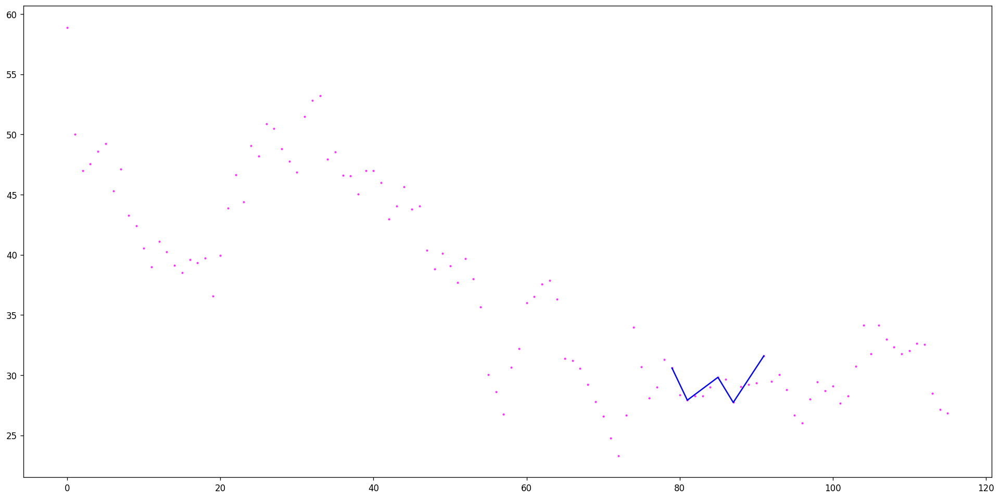

[(54, 56, 58, 63, 64), (71, 80, 84, 86, 89)]
[(12, 19, 21, 22, 27), (63, 64, 66, 68, 77), (63, 64, 66, 70, 77), (89, 92, 95, 109, 131)]
Ticker ABCM found 2 double top patterns, 4 double bottom patterns


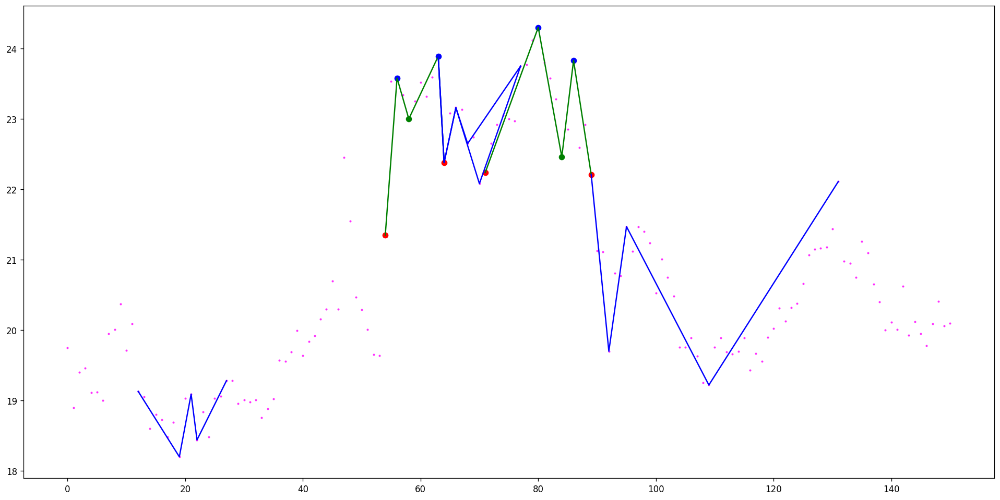

[(148, 149, 151, 152, 154), (148, 150, 151, 152, 154), (642, 643, 644, 645, 646), (660, 661, 662, 664, 670), (660, 661, 662, 666, 670), (660, 661, 670, 673, 675), (660, 664, 670, 673, 675), (660, 666, 670, 673, 675), (710, 711, 715, 716, 718), (710, 713, 715, 716, 718), (769, 770, 771, 772, 773), (785, 786, 789, 790, 791), (823, 825, 826, 827, 828), (887, 888, 890, 895, 897), (1201, 1202, 1204, 1205, 1208), (1201, 1202, 1204, 1206, 1208), (1357, 1358, 1359, 1360, 1361), (1521, 1522, 1524, 1525, 1526), (1640, 1652, 1654, 1655, 1656), (1669, 1670, 1671, 1679, 1684), (1669, 1670, 1671, 1680, 1684), (1672, 1674, 1678, 1679, 1684), (1672, 1674, 1678, 1680, 1684), (1758, 1760, 1764, 1765, 1767), (1758, 1762, 1764, 1765, 1767), (1810, 1811, 1815, 1818, 1829), (1850, 1851, 1852, 1853, 1854), (1862, 1864, 1865, 1866, 1867), (1862, 1864, 1867, 1869, 1876), (1862, 1864, 1867, 1870, 1876), (1862, 1866, 1867, 1869, 1876), (1862, 1866, 1867, 1870, 1876), (2097, 2098, 2099, 2100, 2101), (2146, 2147, 

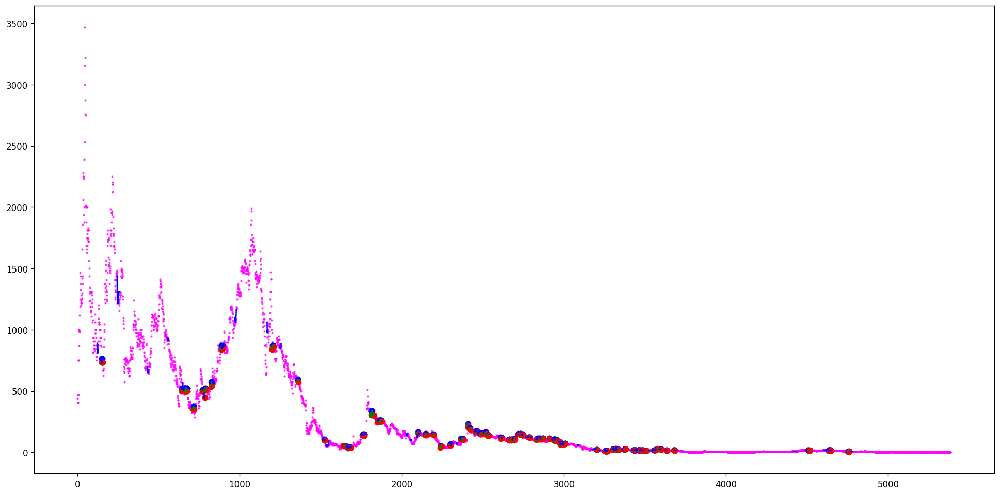

[(3063, 3076, 3078, 3094, 3104), (3570, 3600, 3635, 3658, 3666), (3725, 3731, 3741, 3746, 3752)]
[(3371, 3386, 3416, 3432, 3448), (3718, 3725, 3731, 3741, 3746)]
Ticker ABEV found 3 double top patterns, 2 double bottom patterns


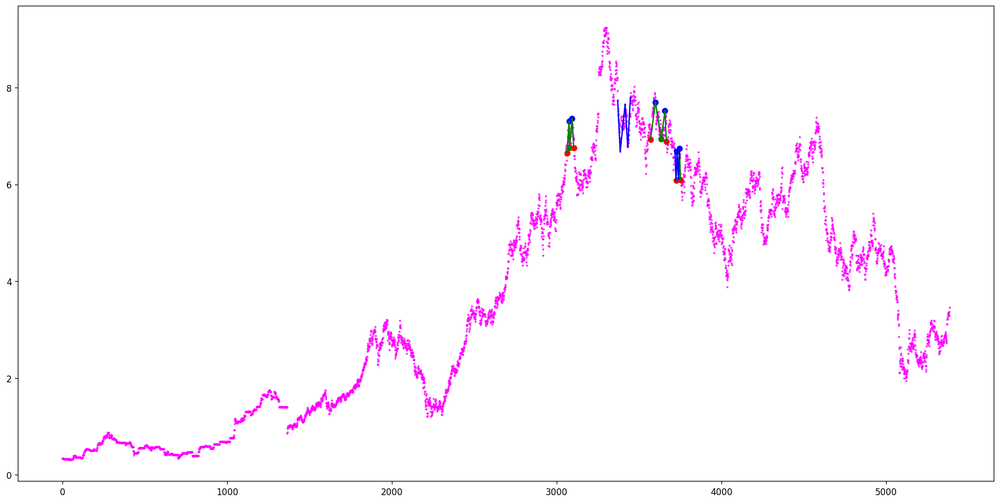

[(32, 34, 36, 37, 39), (103, 105, 108, 110, 111), (112, 113, 118, 120, 123), (156, 157, 158, 161, 163), (360, 369, 371, 374, 375), (360, 369, 375, 378, 382), (360, 374, 375, 378, 382), (443, 447, 449, 451, 453), (474, 477, 479, 480, 481), (506, 515, 517, 518, 519), (505, 518, 519, 521, 531), (505, 518, 519, 523, 531), (505, 518, 519, 526, 531), (520, 523, 524, 526, 530), (590, 592, 596, 597, 599), (609, 610, 617, 624, 632), (617, 624, 626, 628, 631), (655, 669, 670, 680, 684), (837, 862, 872, 876, 883), (884, 886, 902, 907, 909), (884, 889, 902, 907, 909), (932, 933, 934, 941, 943), (985, 989, 992, 1000, 1017), (985, 989, 992, 1004, 1017), (1001, 1004, 1007, 1008, 1015), (1055, 1059, 1066, 1067, 1069), (1052, 1067, 1076, 1083, 1086), (1100, 1102, 1107, 1110, 1115), (1117, 1124, 1126, 1129, 1132), (1157, 1162, 1164, 1165, 1166), (1253, 1257, 1263, 1267, 1268), (1298, 1301, 1304, 1308, 1311), (1356, 1363, 1379, 1384, 1387), (1419, 1426, 1429, 1430, 1431), (1481, 1485, 1490, 1493, 1496), 

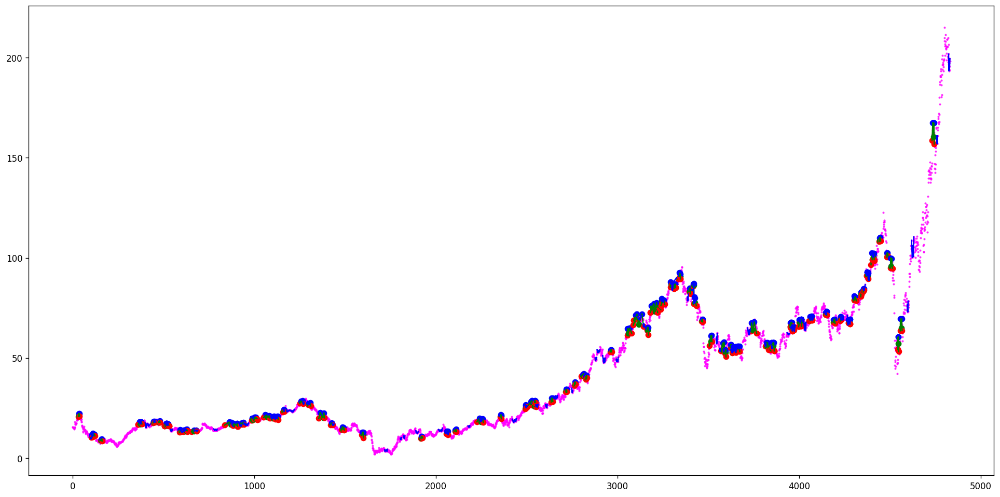

[(179, 180, 182, 184, 186), (248, 249, 250, 252, 254), (248, 249, 250, 253, 254), (719, 720, 722, 724, 725), (719, 721, 722, 724, 725), (799, 800, 802, 803, 806), (904, 905, 908, 910, 916), (904, 905, 908, 911, 916), (904, 907, 908, 910, 916), (904, 907, 908, 911, 916), (2003, 2004, 2005, 2006, 2007), (2043, 2044, 2045, 2049, 2050), (2078, 2079, 2080, 2081, 2082), (2147, 2148, 2149, 2150, 2151), (2206, 2207, 2210, 2213, 2217), (2241, 2242, 2244, 2245, 2246), (2241, 2243, 2244, 2245, 2246), (2255, 2257, 2259, 2264, 2271), (2255, 2258, 2259, 2264, 2271), (2262, 2265, 2271, 2273, 2274), (2496, 2497, 2498, 2501, 2502), (2542, 2543, 2544, 2553, 2559), (2542, 2543, 2544, 2554, 2559), (2681, 2682, 2683, 2686, 2688), (2681, 2682, 2683, 2687, 2688), (2768, 2769, 2770, 2771, 2777), (2768, 2769, 2770, 2772, 2777), (2782, 2784, 2785, 2786, 2787), (2864, 2865, 2866, 2867, 2868), (2958, 2963, 2966, 2972, 2977), (2996, 2997, 2998, 3000, 3001), (3029, 3030, 3031, 3032, 3033), (3021, 3035, 3038, 3044, 

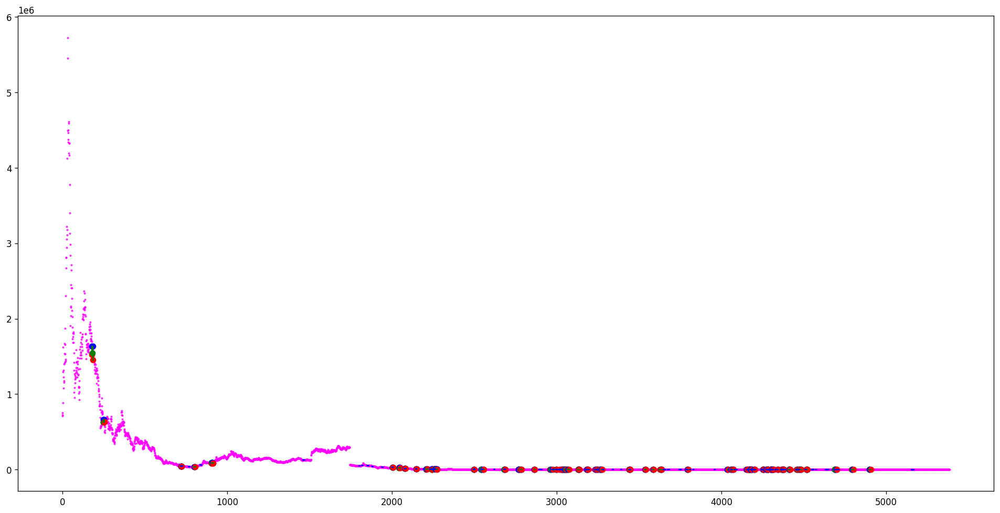

[(2460, 2461, 2464, 2468, 2481), (2460, 2463, 2464, 2468, 2481), (3079, 3083, 3090, 3097, 3101), (3079, 3086, 3090, 3092, 3101), (3079, 3086, 3090, 3097, 3101), (3090, 3097, 3101, 3105, 3108), (3090, 3097, 3101, 3106, 3108), (3079, 3106, 3108, 3111, 3114), (3141, 3142, 3143, 3145, 3147), (3150, 3155, 3156, 3157, 3158), (3150, 3155, 3156, 3164, 3177), (3149, 3170, 3183, 3206, 3207), (3187, 3190, 3193, 3195, 3196), (3184, 3195, 3199, 3206, 3207), (3214, 3216, 3221, 3222, 3232), (3214, 3216, 3221, 3226, 3232), (3214, 3219, 3221, 3222, 3232), (3214, 3219, 3221, 3226, 3232), (3248, 3250, 3252, 3265, 3273), (3452, 3455, 3456, 3470, 3476), (3452, 3455, 3456, 3471, 3476), (3508, 3510, 3517, 3518, 3522), (3508, 3516, 3517, 3518, 3522), (3568, 3569, 3579, 3583, 3617), (3704, 3713, 3726, 3737, 3743), (3704, 3713, 3726, 3741, 3743), (3704, 3715, 3726, 3737, 3743), (3704, 3717, 3726, 3737, 3743), (3959, 3962, 3964, 3967, 4021), (3959, 3962, 3964, 3978, 4021), (3977, 3992, 3996, 3997, 4009), (3977, 

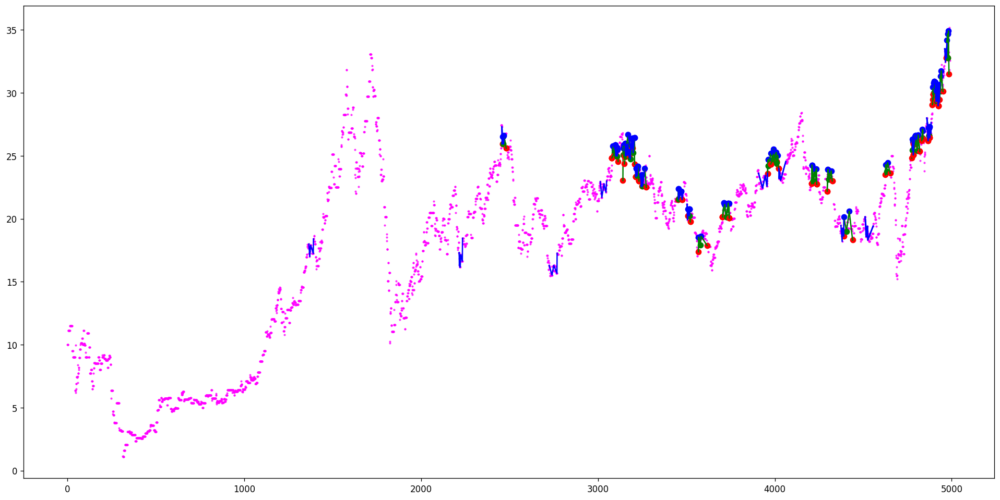

[(132, 136, 141, 145, 146), (132, 138, 141, 145, 146), (163, 167, 176, 180, 199), (163, 167, 176, 184, 199), (236, 247, 252, 259, 273), (236, 247, 252, 261, 273), (236, 247, 252, 266, 273), (233, 247, 274, 287, 307), (375, 376, 383, 387, 394), (396, 398, 404, 407, 412), (477, 484, 487, 497, 510), (489, 490, 493, 497, 500), (564, 567, 569, 571, 587), (569, 571, 579, 584, 587), (620, 622, 624, 625, 630), (620, 622, 624, 627, 630), (655, 661, 662, 663, 664), (724, 727, 728, 733, 740), (744, 746, 751, 757, 764), (744, 746, 751, 758, 764), (798, 810, 812, 815, 827), (875, 885, 891, 896, 901), (875, 888, 891, 894, 901), (875, 888, 891, 895, 901), (875, 888, 891, 896, 901), (906, 912, 914, 920, 925), (906, 912, 914, 923, 925), (1006, 1019, 1026, 1028, 1038), (1038, 1046, 1051, 1052, 1057), (1062, 1072, 1075, 1080, 1091), (1093, 1112, 1115, 1124, 1144), (1093, 1112, 1115, 1126, 1144), (1180, 1181, 1188, 1193, 1199), (1180, 1184, 1188, 1193, 1199), (1220, 1222, 1227, 1230, 1238), (1299, 1301, 1

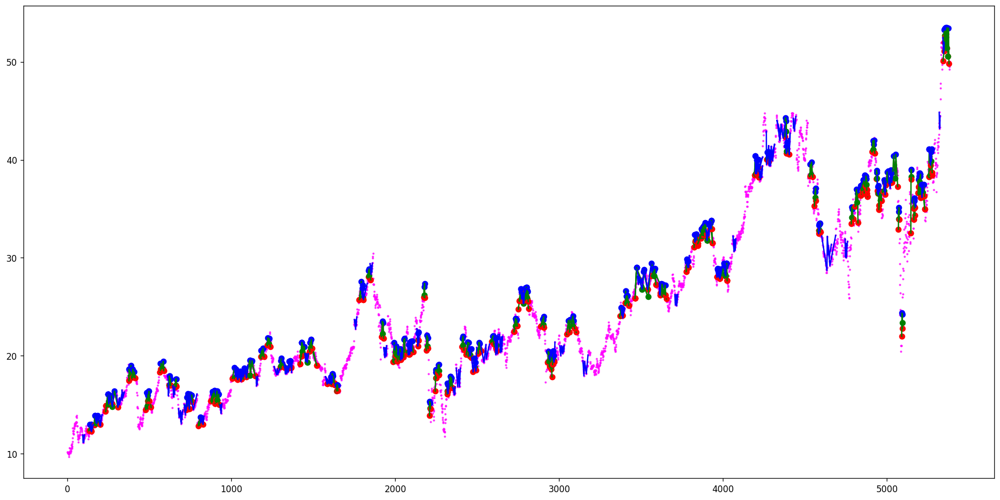

[(94, 95, 98, 100, 102), (104, 106, 109, 110, 112), (131, 135, 140, 142, 144), (274, 276, 279, 286, 288), (279, 280, 281, 282, 284), (386, 387, 388, 390, 391), (512, 514, 517, 521, 522), (551, 552, 554, 560, 562), (1147, 1148, 1154, 1155, 1157), (1570, 1573, 1577, 1580, 1587), (1568, 1582, 1591, 1594, 1597), (1810, 1812, 1826, 1834, 1839), (2060, 2062, 2065, 2068, 2070), (2087, 2088, 2092, 2094, 2097), (2086, 2094, 2097, 2100, 2102), (2190, 2191, 2192, 2195, 2197), (2205, 2208, 2209, 2212, 2214), (2220, 2223, 2229, 2230, 2231), (2245, 2246, 2249, 2252, 2257), (2249, 2250, 2251, 2252, 2256), (2487, 2489, 2492, 2497, 2501), (2550, 2558, 2567, 2574, 2576), (2550, 2560, 2567, 2574, 2576), (2586, 2590, 2593, 2595, 2599), (2586, 2590, 2593, 2597, 2599), (2891, 2894, 2898, 2903, 2909), (2979, 2982, 2983, 2985, 2990), (2984, 2985, 2986, 2987, 2990), (3012, 3013, 3027, 3030, 3032), (3096, 3101, 3106, 3108, 3114), (3096, 3101, 3114, 3115, 3116), (3106, 3108, 3110, 3111, 3114), (3125, 3128, 3131,

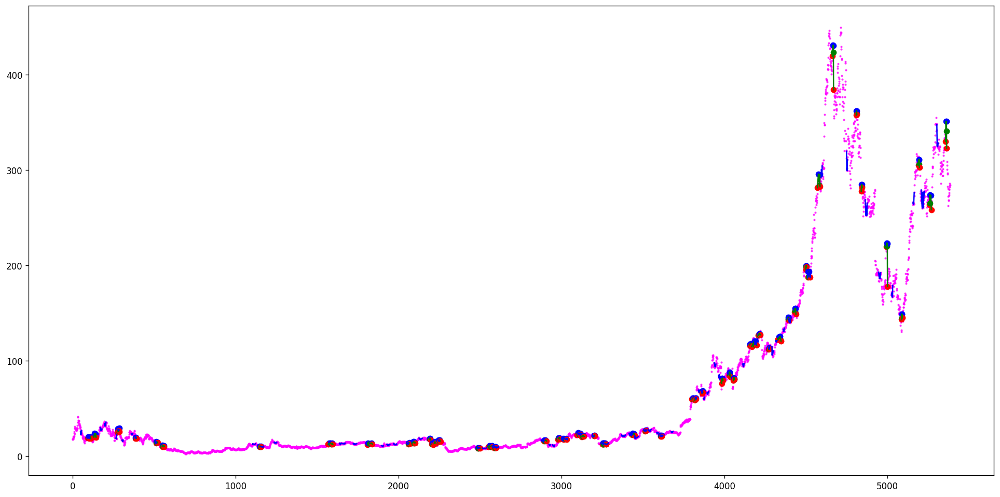

[]
[(540, 541, 542, 557, 558)]
Ticker ABMT found 0 double top patterns, 1 double bottom patterns


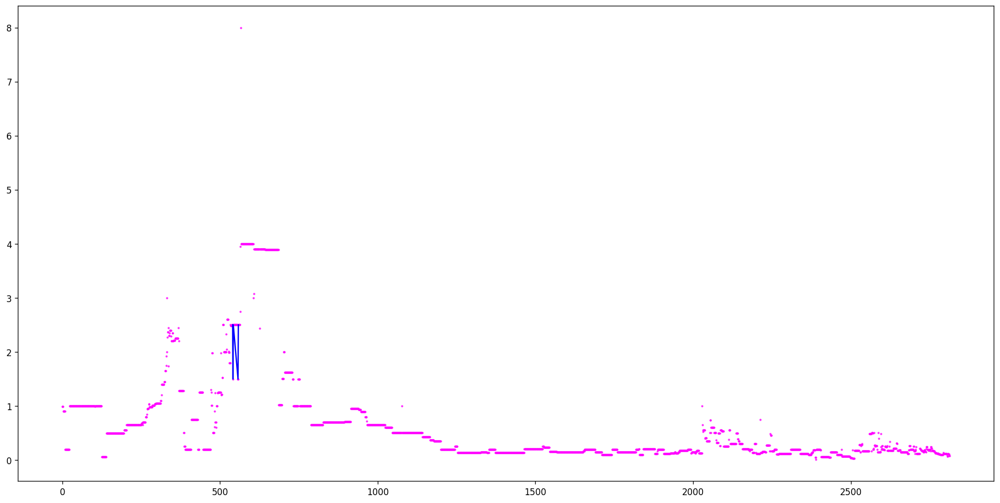

[(1487, 1488, 1489, 1491, 1496), (1704, 1705, 1706, 1708, 1711), (1752, 1753, 1754, 1756, 1758), (1823, 1824, 1826, 1827, 1828), (2149, 2150, 2162, 2174, 2175), (2282, 2285, 2287, 2289, 2290), (2282, 2286, 2287, 2289, 2290), (2340, 2342, 2352, 2355, 2356), (2385, 2386, 2388, 2389, 2391), (2409, 2410, 2412, 2414, 2415), (2413, 2414, 2415, 2417, 2418), (2524, 2526, 2527, 2533, 2534), (2529, 2530, 2531, 2533, 2534), (2591, 2593, 2596, 2598, 2599), (2603, 2604, 2605, 2609, 2611), (2617, 2620, 2621, 2622, 2631), (2617, 2620, 2621, 2623, 2631), (2617, 2620, 2631, 2639, 2642), (2617, 2620, 2631, 2640, 2642)]
[(1477, 1478, 1479, 1481, 1482), (1498, 1499, 1500, 1501, 1503), (1629, 1631, 1632, 1633, 1634), (1790, 1792, 1793, 1798, 1807), (1877, 1878, 1881, 1882, 1883), (1973, 1974, 1975, 1977, 1978), (2014, 2015, 2017, 2019, 2020), (2304, 2305, 2306, 2309, 2310), (2347, 2348, 2349, 2352, 2355), (2358, 2359, 2362, 2363, 2364), (2408, 2409, 2410, 2413, 2414), (2526, 2527, 2530, 2531, 2533), (2620,

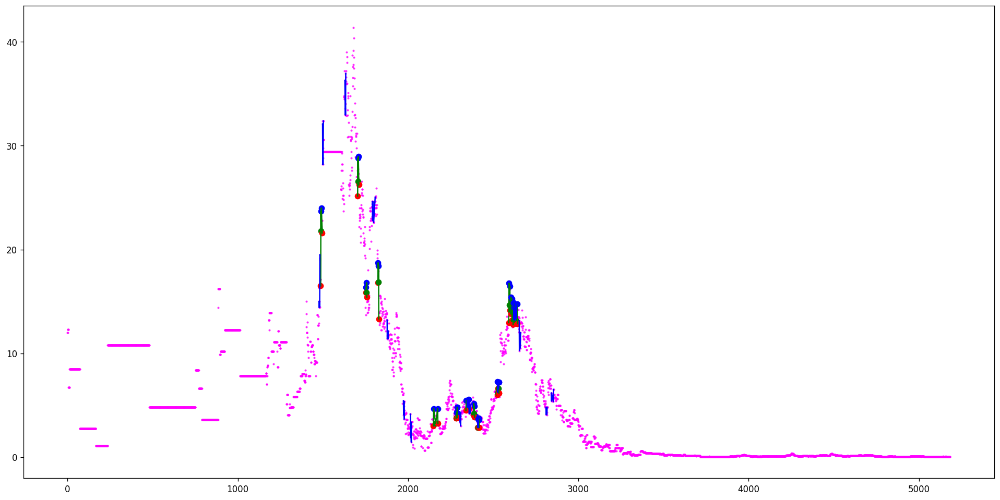

[]
[(751, 752, 753, 756, 757)]
Ticker ABQQ found 0 double top patterns, 1 double bottom patterns


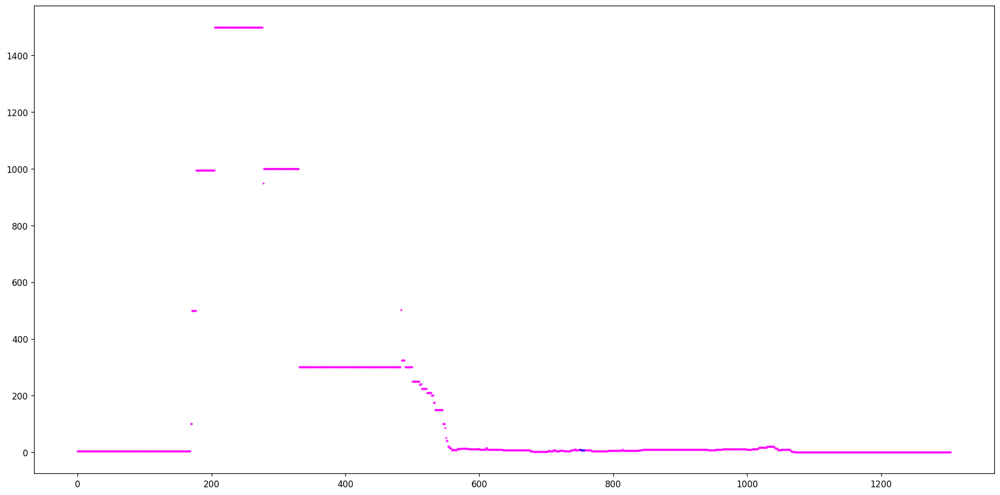

[(175, 184, 197, 200, 203), (351, 361, 374, 376, 381), (351, 361, 374, 379, 381), (351, 365, 374, 376, 381), (351, 373, 374, 376, 381), (402, 403, 405, 406, 414), (466, 469, 476, 477, 504), (466, 471, 476, 477, 504), (466, 473, 476, 477, 504), (476, 477, 481, 483, 504), (476, 477, 481, 488, 504), (476, 477, 481, 493, 504), (571, 574, 579, 582, 589), (571, 574, 579, 584, 589), (571, 578, 579, 582, 589), (579, 584, 585, 586, 588), (655, 660, 663, 664, 679), (663, 664, 667, 670, 679), (711, 712, 714, 717, 725), (739, 745, 747, 749, 752), (834, 835, 838, 839, 841), (845, 850, 853, 857, 861), (890, 891, 893, 896, 899), (890, 891, 893, 898, 899), (1011, 1014, 1016, 1018, 1027), (1081, 1084, 1088, 1093, 1097), (1720, 1723, 1732, 1735, 1741), (3764, 3793, 3797, 3801, 3806), (4041, 4042, 4044, 4049, 4051), (4245, 4249, 4250, 4252, 4255), (4245, 4249, 4256, 4262, 4271), (4245, 4252, 4256, 4262, 4271), (4289, 4298, 4299, 4300, 4303)]
[(1, 9, 20, 23, 45), (1, 18, 20, 23, 45), (70, 76, 77, 83, 85),

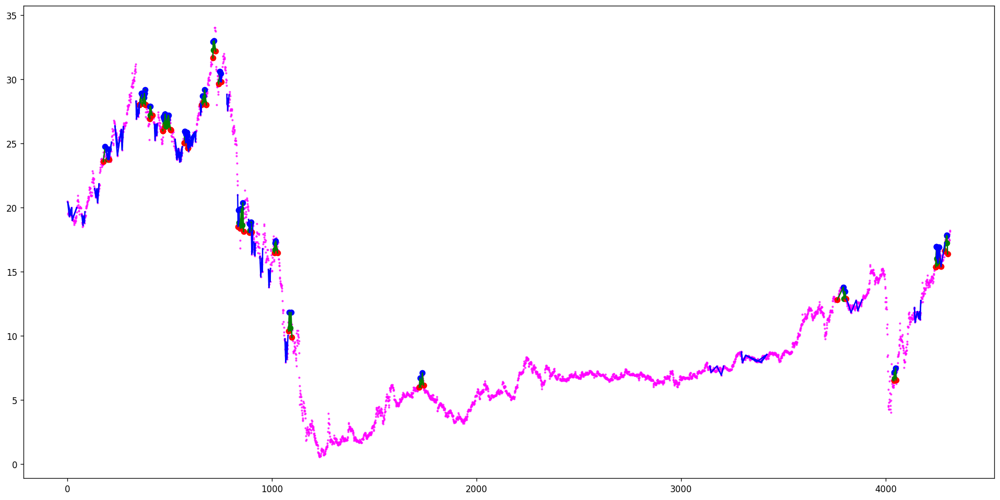

[(1338, 1364, 1378, 1388, 1422), (1540, 1546, 1553, 1565, 1575), (2371, 2401, 2430, 2438, 2444), (2884, 2889, 2897, 2908, 2910)]
[(1073, 1107, 1131, 1147, 1167), (1073, 1107, 1131, 1149, 1167), (1073, 1108, 1131, 1147, 1167), (1073, 1109, 1131, 1147, 1167), (2999, 3001, 3003, 3008, 3014), (2999, 3001, 3003, 3010, 3014), (3045, 3050, 3058, 3060, 3069)]
Ticker ABST found 4 double top patterns, 7 double bottom patterns


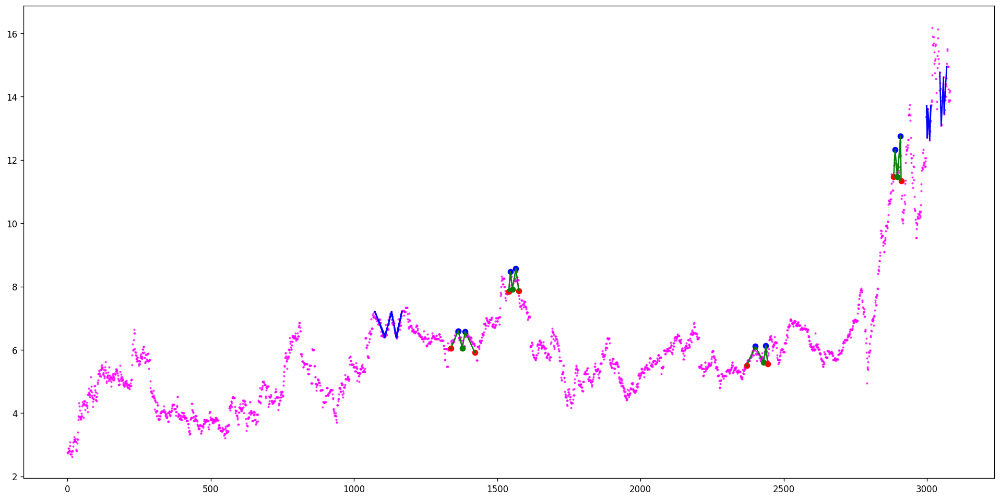

[(24, 26, 28, 30, 33), (72, 77, 85, 88, 91), (72, 79, 85, 88, 91), (72, 80, 85, 88, 91), (124, 127, 130, 132, 134), (276, 280, 282, 286, 296), (284, 286, 290, 292, 295), (395, 397, 404, 408, 417), (434, 437, 442, 443, 444), (449, 454, 458, 460, 468), (491, 496, 505, 513, 544), (509, 513, 518, 520, 524), (506, 520, 526, 531, 542), (506, 520, 526, 533, 542), (506, 520, 526, 535, 542), (506, 523, 526, 531, 542), (553, 555, 558, 561, 564), (566, 574, 580, 582, 585), (566, 576, 580, 582, 585), (612, 615, 618, 620, 629), (612, 615, 618, 622, 629), (612, 617, 618, 620, 629), (641, 645, 648, 661, 670), (649, 651, 659, 661, 668), (649, 653, 659, 661, 668), (712, 716, 719, 721, 731), (712, 716, 719, 724, 731), (852, 869, 876, 879, 882), (852, 873, 876, 879, 882), (1074, 1087, 1102, 1112, 1138), (1074, 1090, 1102, 1112, 1138), (1244, 1246, 1258, 1261, 1273), (1244, 1254, 1258, 1261, 1273), (1283, 1286, 1290, 1299, 1306), (1319, 1327, 1330, 1387, 1389), (1334, 1340, 1357, 1374, 1388), (1334, 1348,

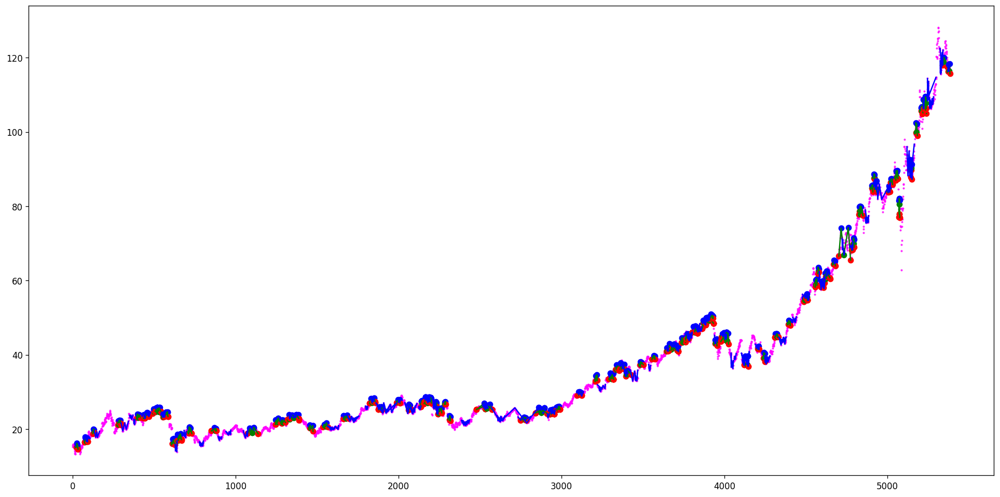

[]
[(1111, 1113, 1115, 1148, 1150)]
Ticker ABTI found 0 double top patterns, 1 double bottom patterns


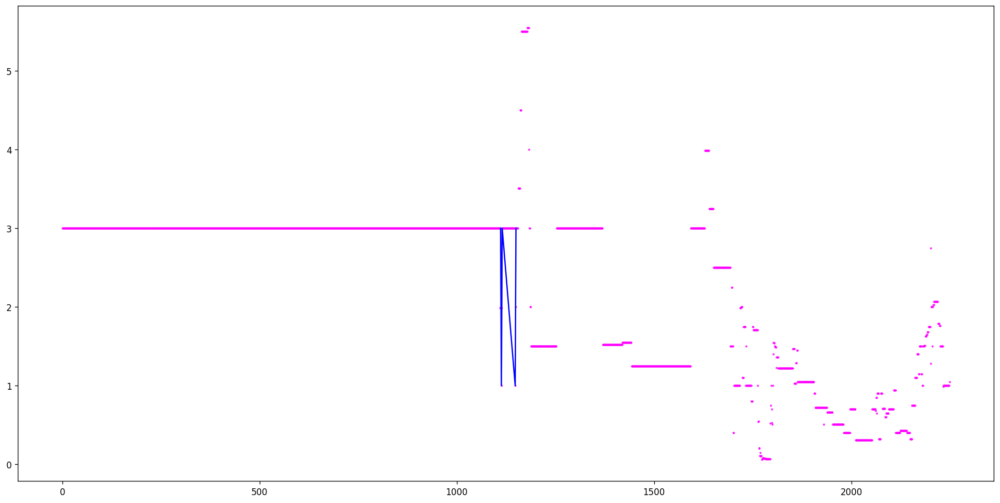

[(14, 15, 16, 21, 22), (14, 21, 22, 24, 27), (50, 52, 55, 57, 59), (50, 57, 59, 60, 62), (172, 175, 177, 178, 180), (187, 194, 197, 202, 204), (218, 239, 243, 263, 269), (246, 253, 257, 258, 265), (246, 253, 257, 263, 265), (246, 255, 257, 258, 265), (257, 258, 261, 263, 265), (387, 390, 407, 421, 428), (387, 397, 407, 421, 428), (435, 437, 438, 440, 441), (435, 440, 441, 442, 451), (435, 440, 441, 447, 451), (435, 440, 441, 448, 451), (504, 520, 521, 522, 524), (565, 586, 588, 589, 590), (565, 586, 590, 592, 601), (565, 586, 590, 594, 601), (565, 586, 590, 596, 601), (591, 594, 595, 596, 597), (591, 596, 597, 599, 601), (604, 606, 607, 609, 617), (697, 701, 706, 717, 735), (697, 701, 706, 723, 735), (697, 704, 706, 707, 735), (697, 704, 706, 709, 735), (697, 704, 706, 717, 735), (706, 709, 711, 713, 735), (706, 709, 711, 714, 735), (706, 709, 711, 717, 735), (715, 717, 721, 723, 725), (697, 723, 735, 736, 737), (688, 723, 740, 743, 745), (697, 731, 735, 736, 737), (697, 734, 735, 736,

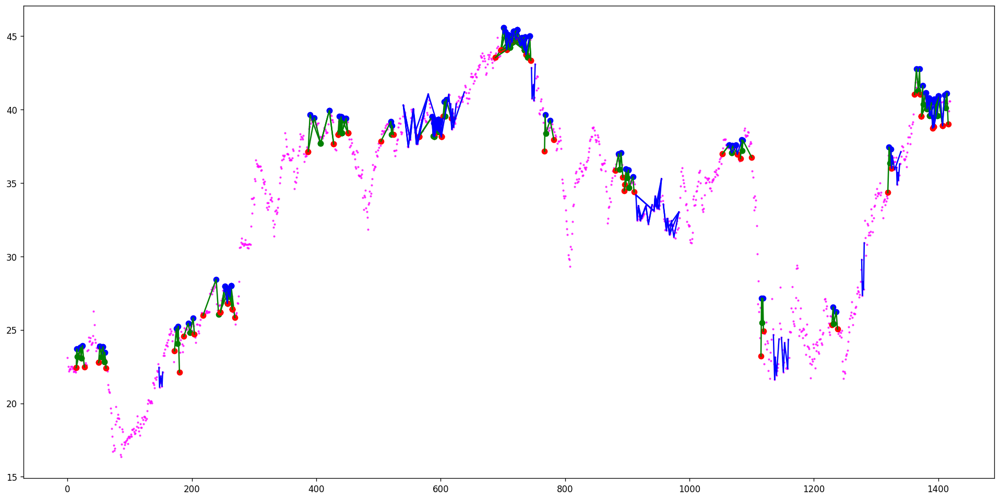

[(370, 371, 373, 592, 593), (623, 624, 629, 651, 652), (1125, 1126, 1487, 1568, 1569), (1761, 1762, 1763, 1769, 1770)]
[(592, 593, 624, 636, 637)]
Ticker ABVC found 4 double top patterns, 1 double bottom patterns


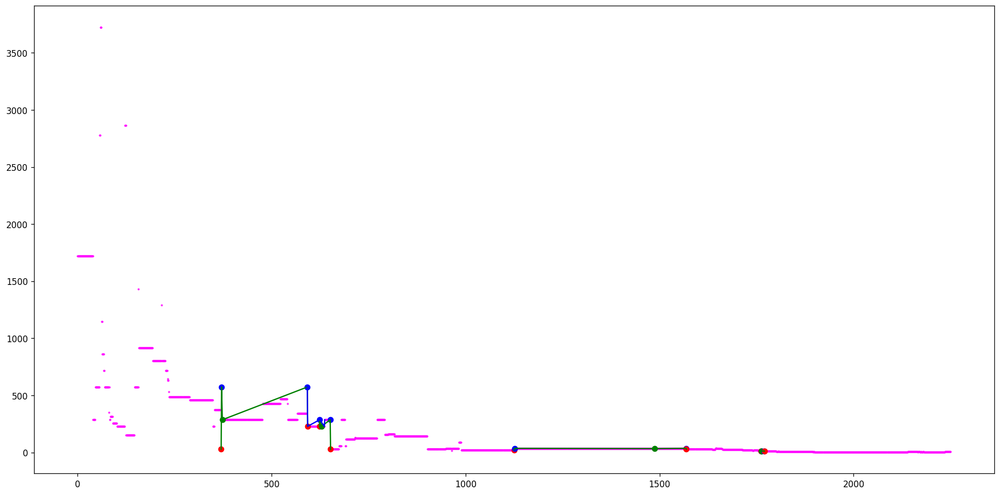

[(396, 399, 405, 408, 414), (710, 711, 714, 716, 717)]
[(238, 240, 242, 243, 245), (238, 240, 242, 244, 245), (708, 710, 711, 714, 715)]
Ticker ABWN found 2 double top patterns, 3 double bottom patterns


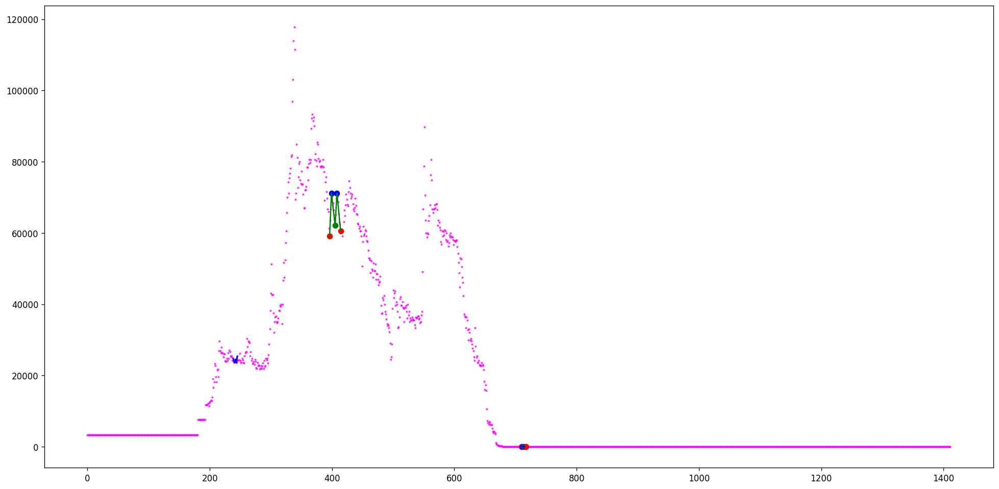

[(152, 163, 171, 183, 185), (152, 166, 171, 178, 185), (171, 178, 181, 183, 185), (207, 220, 221, 222, 226), (280, 282, 289, 290, 306), (289, 290, 293, 295, 305), (280, 304, 306, 307, 310), (327, 330, 331, 332, 334), (338, 339, 340, 341, 342), (356, 358, 362, 363, 365), (423, 425, 427, 428, 431), (485, 486, 488, 494, 496), (535, 539, 540, 542, 543), (619, 620, 622, 623, 624)]
[(42, 44, 50, 52, 66), (50, 52, 54, 55, 58), (103, 112, 119, 121, 122), (103, 116, 119, 121, 122), (125, 128, 131, 133, 134), (136, 139, 140, 141, 143), (150, 152, 156, 158, 160), (150, 154, 156, 158, 160), (163, 164, 166, 168, 178), (167, 171, 174, 176, 177), (163, 171, 178, 181, 183), (163, 176, 178, 181, 183), (189, 194, 198, 202, 208), (220, 221, 222, 227, 240), (229, 234, 238, 239, 240), (251, 263, 266, 270, 273), (341, 342, 344, 345, 346), (375, 377, 379, 382, 384), (429, 433, 434, 435, 439), (443, 445, 449, 450, 452), (443, 448, 449, 450, 452), (463, 466, 469, 471, 483), (517, 523, 527, 530, 539), (539, 540

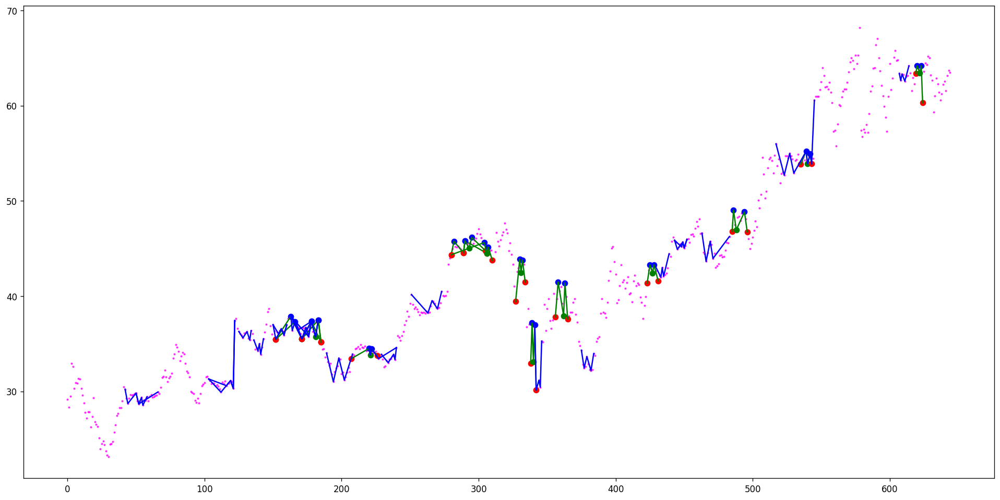

[(15, 20, 24, 28, 31)]
[]
Ticker ACAC found 1 double top patterns, 0 double bottom patterns


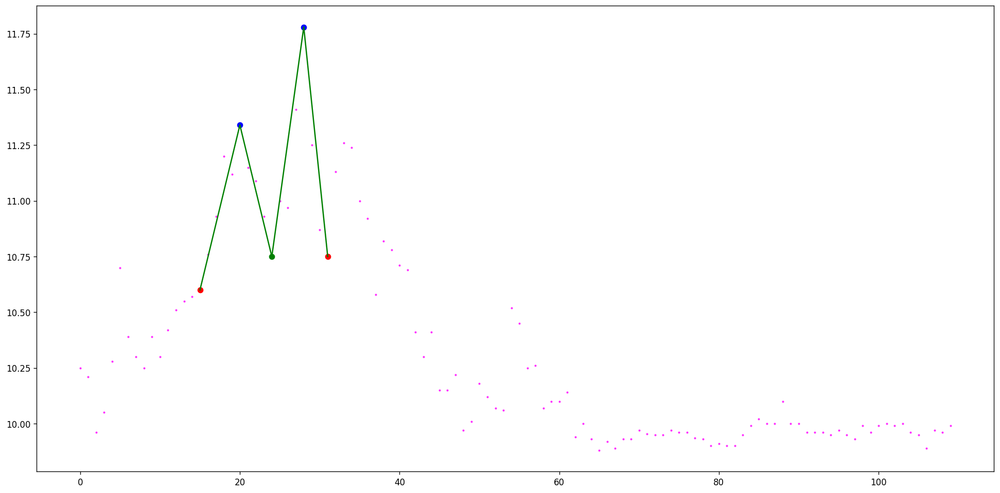

[(248, 249, 259, 265, 275), (564, 566, 567, 570, 572), (710, 711, 712, 713, 714), (715, 716, 717, 719, 720), (821, 828, 831, 847, 852), (831, 834, 840, 841, 842), (831, 834, 844, 847, 852), (831, 841, 844, 847, 852), (882, 888, 891, 899, 903), (891, 892, 895, 899, 903), (2272, 2273, 2275, 2277, 2283), (2323, 2327, 2328, 2330, 2331), (2352, 2353, 2354, 2355, 2356), (2451, 2454, 2456, 2457, 2459), (2460, 2461, 2462, 2463, 2464), (2495, 2497, 2499, 2500, 2501), (2523, 2531, 2538, 2542, 2544), (2586, 2587, 2588, 2591, 2592), (2622, 2625, 2629, 2630, 2636), (2622, 2625, 2629, 2632, 2636), (2622, 2627, 2629, 2630, 2636), (2629, 2632, 2634, 2635, 2636), (2738, 2739, 2740, 2742, 2746), (2768, 2772, 2773, 2774, 2775), (2800, 2803, 2805, 2806, 2808), (2809, 2810, 2812, 2813, 2815), (2949, 2950, 2951, 2953, 2954), (3044, 3045, 3046, 3049, 3053), (3048, 3049, 3050, 3051, 3052), (3060, 3065, 3066, 3067, 3068), (3098, 3102, 3104, 3105, 3106), (3098, 3103, 3104, 3105, 3106), (3135, 3137, 3140, 3143, 

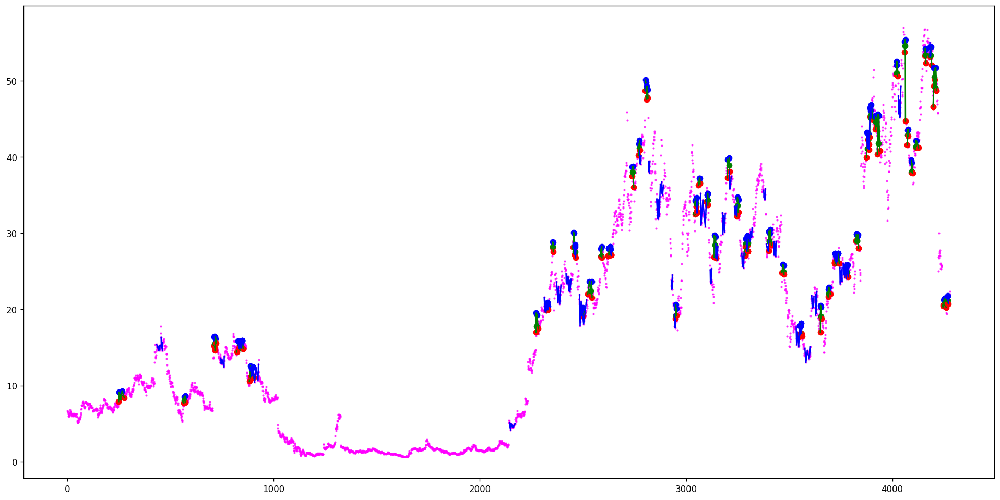

[(570, 571, 572, 573, 580), (572, 575, 577, 578, 580), (631, 632, 634, 636, 638), (801, 803, 804, 806, 810), (813, 814, 815, 816, 817), (954, 955, 956, 960, 961), (954, 955, 961, 964, 967), (954, 960, 961, 964, 967), (1124, 1125, 1126, 1128, 1129), (1184, 1186, 1188, 1190, 1192), (1328, 1331, 1336, 1338, 1340), (1328, 1331, 1336, 1341, 1343), (1360, 1361, 1363, 1365, 1367), (1605, 1607, 1608, 1610, 1617)]
[(710, 711, 712, 713, 719), (769, 771, 774, 776, 779), (821, 822, 823, 824, 826), (821, 824, 826, 830, 831), (861, 862, 863, 865, 869), (863, 865, 866, 867, 869), (973, 974, 976, 978, 980), (983, 984, 986, 987, 990), (1155, 1157, 1158, 1160, 1161), (1325, 1328, 1331, 1336, 1341), (1325, 1328, 1331, 1340, 1341), (1331, 1336, 1338, 1340, 1341), (1352, 1353, 1354, 1360, 1361), (1392, 1393, 1394, 1397, 1398)]
Ticker ACB found 14 double top patterns, 14 double bottom patterns


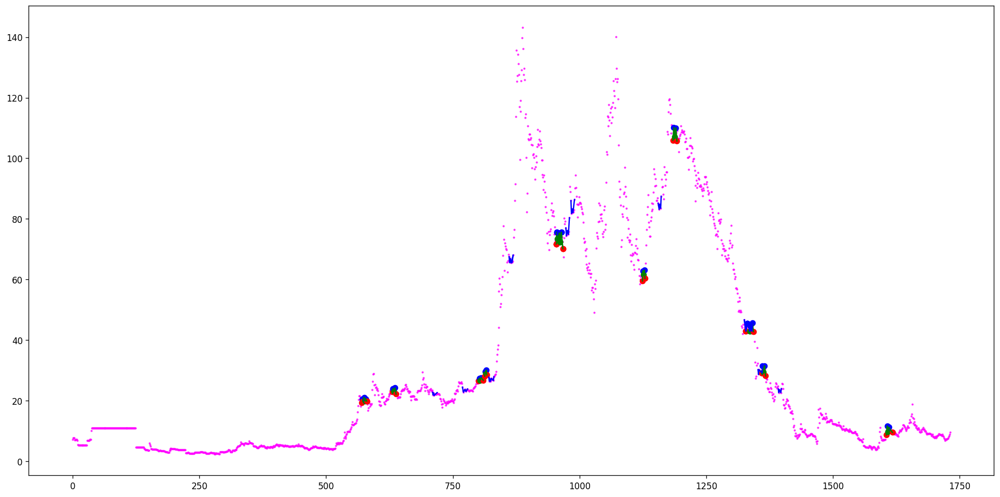

[(4, 9, 29, 31, 46), (4, 9, 29, 36, 46), (4, 11, 29, 31, 46), (4, 11, 29, 36, 46), (119, 130, 135, 150, 162), (168, 175, 180, 191, 253), (182, 219, 226, 249, 253), (296, 300, 303, 309, 312), (364, 374, 376, 378, 401), (364, 374, 376, 386, 401), (364, 374, 376, 391, 401), (376, 378, 384, 386, 400), (376, 380, 384, 386, 400), (384, 386, 387, 391, 394), (401, 405, 411, 417, 430), (401, 405, 411, 419, 430), (401, 405, 411, 420, 430), (401, 405, 411, 422, 430), (401, 405, 411, 439, 447), (401, 406, 411, 417, 430), (401, 406, 411, 419, 430), (401, 407, 411, 417, 430), (401, 407, 411, 419, 430), (411, 422, 430, 439, 447), (640, 653, 654, 661, 665), (854, 866, 871, 873, 875), (854, 869, 871, 873, 875), (1002, 1023, 1028, 1035, 1045), (1002, 1025, 1028, 1035, 1045), (1263, 1265, 1267, 1275, 1278), (1357, 1358, 1359, 1364, 1374), (1357, 1358, 1359, 1370, 1374), (1357, 1358, 1359, 1372, 1374)]
[(1, 3, 9, 29, 36), (219, 226, 249, 254, 258), (219, 229, 249, 254, 258), (329, 332, 335, 342, 354), (32

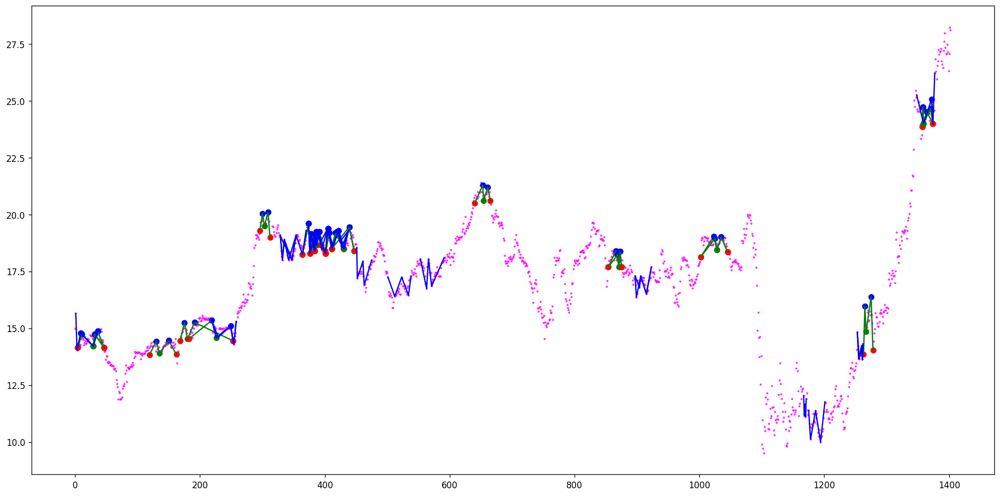

[(81, 83, 86, 91, 99), (81, 84, 86, 91, 99), (101, 102, 105, 108, 112), (117, 121, 135, 148, 152), (117, 125, 135, 141, 152), (117, 125, 135, 145, 152), (117, 125, 135, 148, 152), (175, 179, 190, 194, 196), (307, 316, 325, 328, 340), (325, 328, 332, 334, 339), (377, 380, 382, 386, 389), (487, 492, 502, 516, 521), (487, 498, 502, 509, 521), (487, 498, 502, 516, 521), (618, 625, 627, 628, 636), (627, 628, 629, 632, 636), (645, 646, 647, 649, 651), (645, 649, 651, 654, 657), (643, 654, 659, 675, 681), (643, 654, 659, 679, 681), (669, 671, 673, 675, 681), (694, 706, 720, 727, 738), (694, 706, 720, 728, 738), (700, 708, 712, 713, 716), (700, 708, 712, 715, 716), (694, 708, 720, 727, 738), (780, 787, 790, 793, 799), (864, 868, 870, 874, 880), (864, 868, 870, 876, 880), (885, 888, 890, 892, 895), (902, 903, 905, 908, 910), (927, 931, 938, 941, 949), (927, 931, 938, 946, 949), (938, 941, 943, 946, 949), (1003, 1004, 1006, 1008, 1009), (1085, 1087, 1088, 1089, 1090), (1136, 1137, 1138, 1139, 11

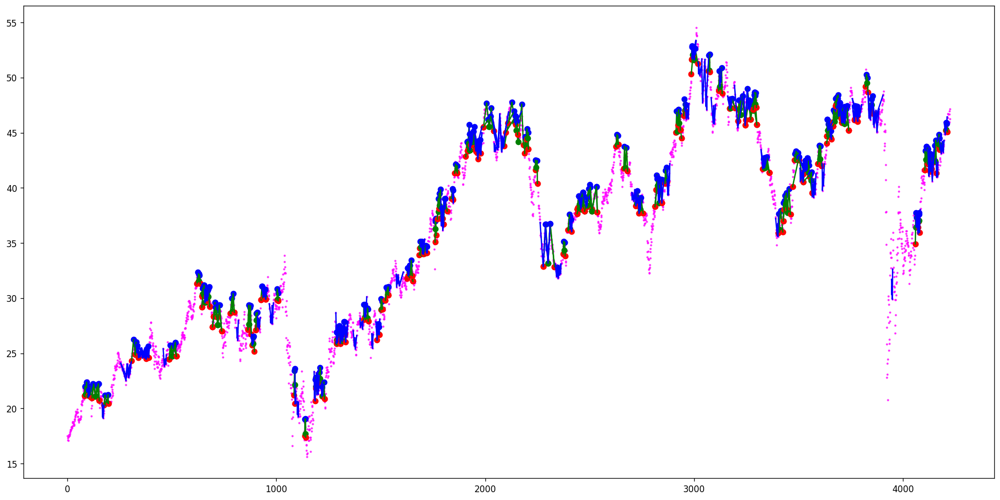

[(16, 17, 18, 19, 21), (47, 49, 50, 52, 54), (203, 205, 206, 209, 210)]
[(82, 83, 85, 86, 89), (115, 116, 118, 120, 121), (168, 169, 170, 171, 172)]
Ticker ACCD found 3 double top patterns, 3 double bottom patterns


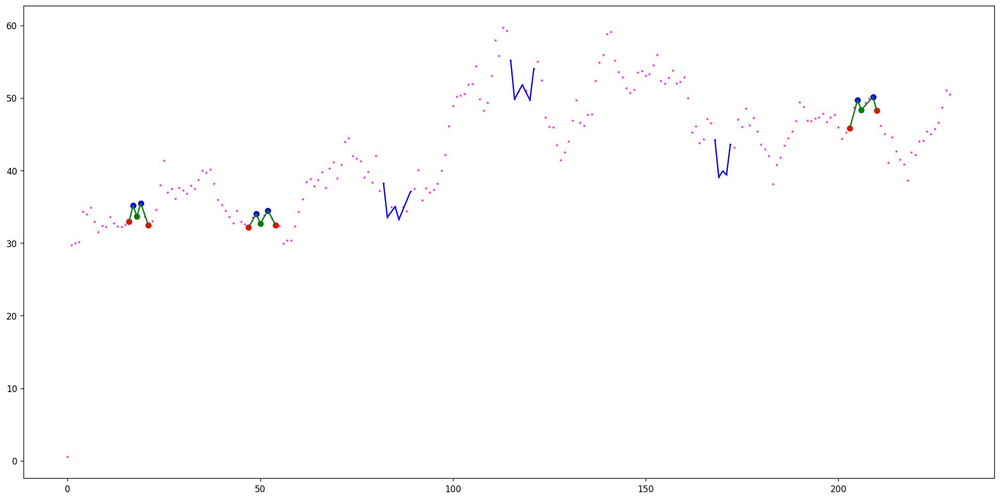

[(11, 16, 25, 41, 54), (135, 139, 151, 153, 158), (196, 215, 221, 249, 261), (223, 231, 241, 249, 261), (367, 369, 382, 394, 401), (517, 523, 537, 545, 551), (517, 523, 564, 570, 571), (698, 700, 709, 710, 711), (718, 721, 722, 734, 744), (805, 811, 813, 815, 817), (913, 915, 917, 919, 921), (933, 934, 937, 941, 943), (1133, 1135, 1136, 1137, 1145), (1136, 1137, 1139, 1142, 1145), (1189, 1190, 1191, 1192, 1196), (1198, 1201, 1206, 1208, 1218), (1206, 1208, 1209, 1212, 1214), (1259, 1264, 1267, 1270, 1278), (1259, 1270, 1278, 1283, 1289), (1259, 1274, 1278, 1279, 1289), (1258, 1283, 1289, 1290, 1295), (1258, 1283, 1289, 1293, 1295), (1258, 1287, 1289, 1290, 1295), (1289, 1290, 1292, 1293, 1294), (1314, 1316, 1319, 1320, 1326), (1461, 1464, 1468, 1472, 1474), (1485, 1487, 1492, 1498, 1501), (1546, 1549, 1551, 1552, 1558), (1622, 1623, 1627, 1628, 1630)]
[(17, 25, 41, 54, 58), (61, 62, 65, 80, 91), (61, 62, 65, 83, 91), (93, 96, 113, 119, 124), (93, 98, 113, 119, 124), (422, 433, 458, 463

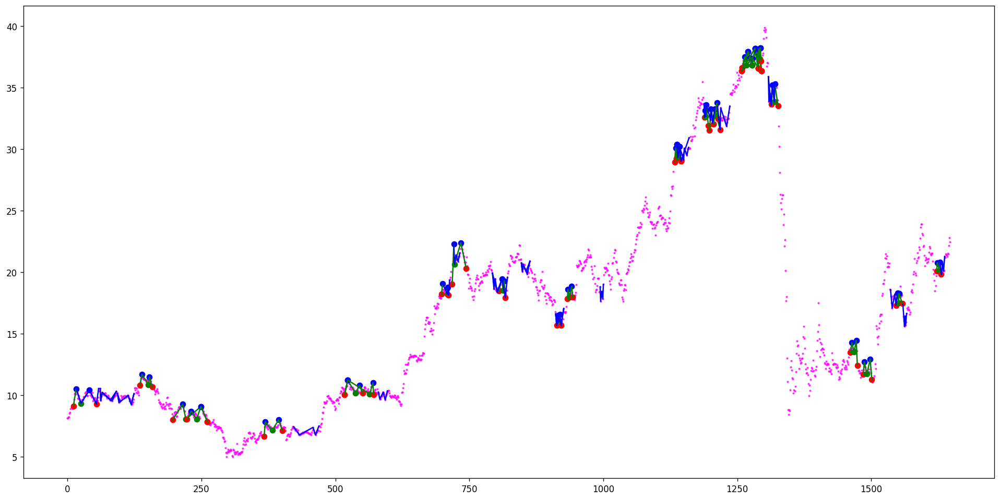

[(124, 125, 129, 130, 131), (266, 270, 273, 274, 275), (266, 272, 273, 274, 275), (286, 287, 288, 292, 293), (471, 472, 473, 474, 475), (488, 490, 495, 498, 502), (488, 491, 495, 498, 502), (764, 765, 766, 767, 768), (1152, 1153, 1154, 1155, 1156), (1168, 1169, 1170, 1171, 1172), (1172, 1173, 1174, 1175, 1176), (1242, 1243, 1244, 1246, 1247), (1344, 1345, 1346, 1348, 1349), (1485, 1486, 1487, 1488, 1489), (1668, 1670, 1672, 1673, 1674), (1668, 1671, 1672, 1673, 1674), (1714, 1715, 1716, 1717, 1718), (1944, 1945, 1946, 1947, 1949), (1944, 1945, 1946, 1948, 1949), (2021, 2022, 2024, 2026, 2028), (2021, 2023, 2024, 2026, 2028), (2172, 2173, 2174, 2176, 2177), (2201, 2202, 2203, 2204, 2205), (2318, 2319, 2320, 2322, 2324), (2335, 2336, 2338, 2339, 2340), (2465, 2466, 2468, 2469, 2470), (2527, 2528, 2529, 2531, 2532), (2583, 2584, 2587, 2588, 2592), (2583, 2584, 2587, 2589, 2592), (2708, 2709, 2711, 2713, 2714), (2728, 2729, 2730, 2731, 2733), (2728, 2729, 2730, 2732, 2733), (2779, 2780, 27

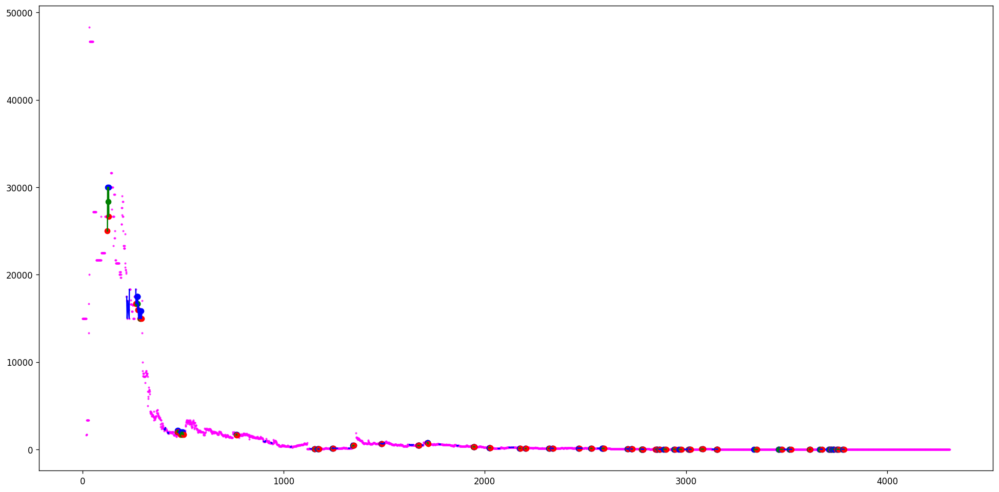

[(20, 28, 32, 37, 67), (34, 40, 48, 58, 61), (34, 42, 48, 58, 61), (34, 44, 48, 52, 61), (34, 44, 48, 58, 61), (85, 92, 100, 104, 117), (85, 93, 96, 98, 100), (85, 93, 100, 104, 117), (85, 98, 100, 104, 117), (190, 213, 217, 220, 222), (190, 216, 217, 220, 222), (275, 278, 283, 307, 316), (446, 449, 450, 452, 454), (491, 493, 494, 498, 499), (514, 518, 520, 521, 522), (571, 572, 573, 574, 579), (643, 645, 646, 647, 648), (677, 678, 679, 680, 681), (691, 693, 694, 695, 696)]
[(8, 16, 19, 20, 23), (70, 72, 76, 81, 89), (70, 72, 76, 84, 89), (93, 96, 98, 100, 103), (214, 217, 220, 222, 236), (278, 283, 285, 289, 305), (278, 283, 285, 295, 305), (430, 431, 433, 434, 435), (489, 490, 493, 501, 503), (493, 494, 498, 499, 503), (519, 520, 521, 522, 526), (685, 687, 689, 690, 691)]
Ticker ACES found 19 double top patterns, 12 double bottom patterns


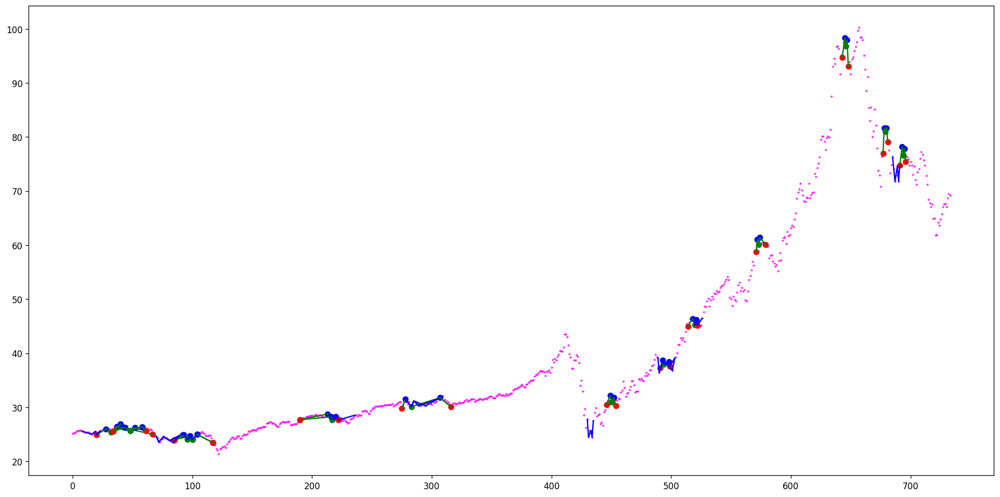

[(86, 87, 88, 89, 91), (230, 234, 235, 237, 240), (366, 367, 368, 369, 371), (459, 461, 467, 470, 475), (584, 585, 586, 587, 589), (612, 613, 614, 617, 618), (705, 706, 707, 708, 709), (727, 729, 731, 732, 736), (726, 729, 748, 753, 755), (815, 816, 818, 820, 823)]
[(137, 139, 143, 146, 148), (263, 264, 266, 267, 272), (263, 264, 266, 268, 272), (263, 264, 266, 270, 272), (314, 316, 318, 321, 322), (325, 326, 327, 328, 329), (330, 332, 333, 334, 335), (385, 387, 388, 389, 390), (596, 597, 599, 603, 604), (595, 597, 605, 611, 613), (613, 614, 617, 619, 621), (613, 616, 617, 619, 621), (631, 632, 634, 637, 638), (647, 649, 650, 652, 653), (669, 670, 671, 672, 673)]
Ticker ACET found 10 double top patterns, 15 double bottom patterns


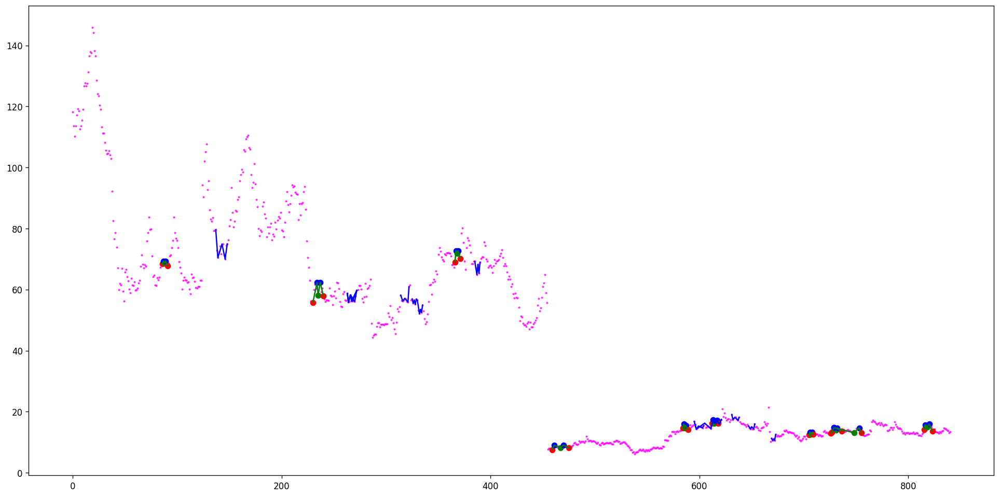

[(73, 75, 81, 83, 87)]
[(83, 89, 92, 97, 99)]
Ticker ACEV found 1 double top patterns, 1 double bottom patterns


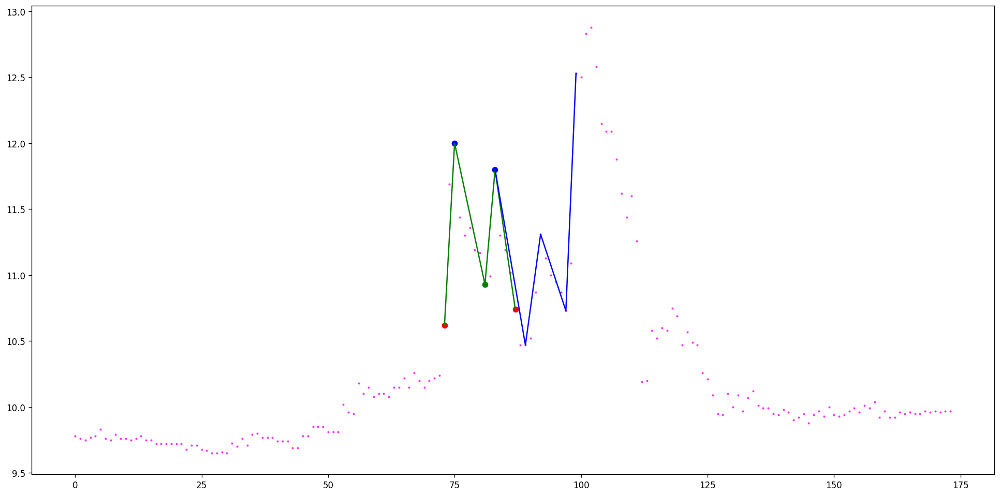

[(688, 689, 699, 702, 703), (688, 689, 699, 709, 710), (699, 700, 703, 709, 710)]
[(687, 688, 689, 699, 700), (687, 688, 689, 707, 708), (698, 699, 700, 707, 708), (3215, 3216, 3217, 3220, 3221)]
Ticker ACFL found 3 double top patterns, 4 double bottom patterns


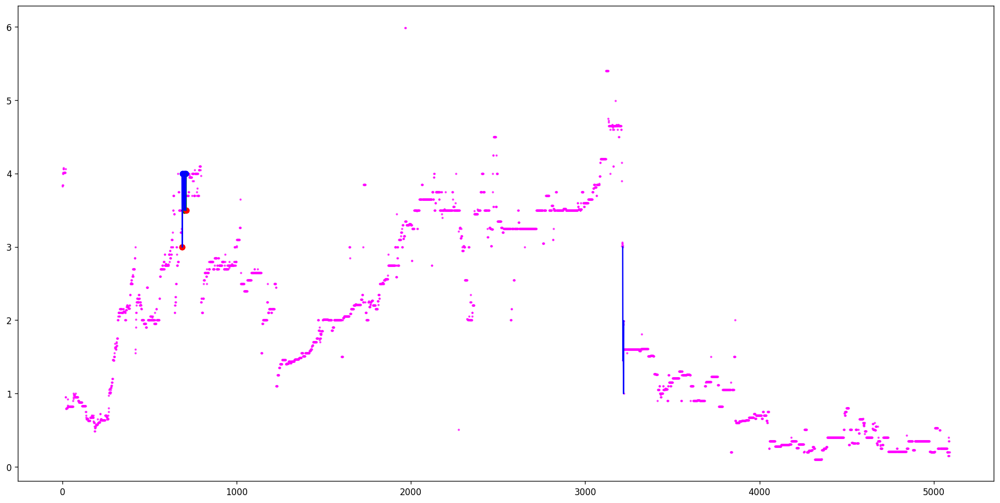

[(39, 40, 44, 47, 50)]
[(2521, 2528, 2531, 2538, 2540), (3135, 3142, 3146, 3154, 3155), (3207, 3216, 3219, 3223, 3228), (3482, 3484, 3497, 3508, 3518)]
Ticker ACFN found 1 double top patterns, 4 double bottom patterns


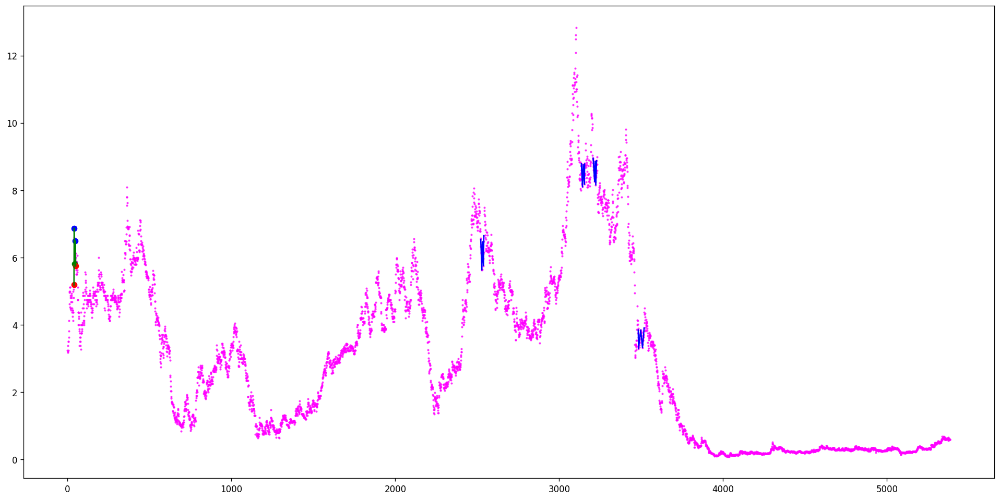

[(54, 61, 66, 79, 85), (205, 209, 211, 212, 214), (214, 218, 222, 227, 230), (299, 302, 307, 314, 321), (299, 304, 307, 314, 321), (449, 458, 462, 467, 471), (788, 802, 809, 831, 877), (788, 804, 809, 831, 877), (788, 806, 809, 831, 877), (1008, 1012, 1013, 1020, 1025), (1111, 1118, 1127, 1136, 1177), (1111, 1119, 1127, 1136, 1177), (1111, 1121, 1127, 1136, 1177), (1474, 1476, 1491, 1495, 1517), (1575, 1593, 1597, 1609, 1622), (1752, 1756, 1761, 1765, 1768), (1834, 1837, 1854, 1862, 1868), (1833, 1837, 1873, 1878, 1887), (1834, 1841, 1854, 1862, 1868), (1904, 1911, 1914, 1924, 1931), (1904, 1911, 1914, 1928, 1931), (2409, 2417, 2424, 2428, 2443)]
[(43, 54, 61, 64, 78), (43, 54, 61, 66, 78), (43, 54, 61, 67, 78), (171, 181, 182, 184, 192), (866, 888, 909, 913, 918), (1105, 1111, 1118, 1123, 1133), (1105, 1111, 1118, 1127, 1133), (1100, 1111, 1145, 1179, 1185), (1408, 1417, 1429, 1436, 1471), (1408, 1417, 1429, 1441, 1471), (1476, 1491, 1495, 1518, 1536), (1549, 1574, 1593, 1597, 1608), 

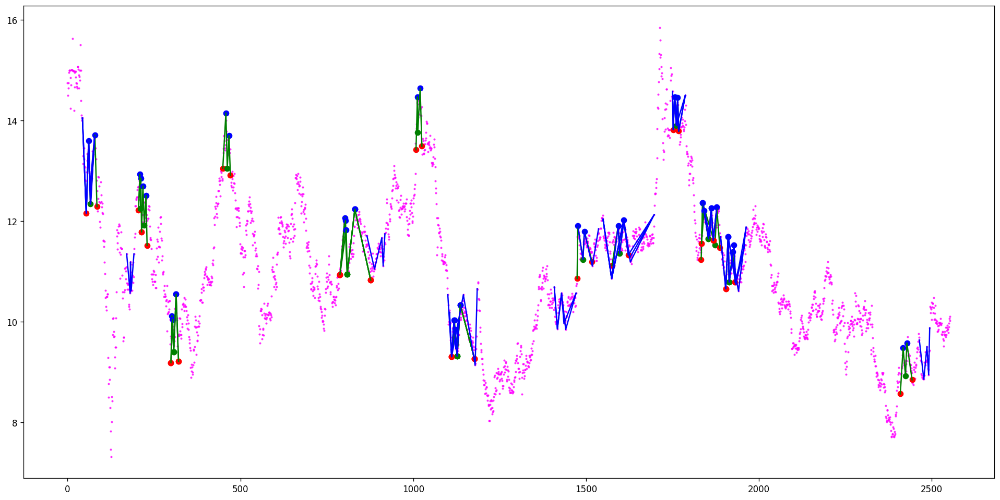

[(1824, 1838, 1850, 1883, 1906), (2919, 2922, 2930, 2932, 2948), (2919, 2924, 2930, 2932, 2948), (2968, 2974, 2977, 2982, 2993), (2968, 2974, 2977, 2985, 2993), (3314, 3328, 3339, 3346, 3387), (3314, 3329, 3339, 3346, 3387), (3314, 3338, 3339, 3346, 3387), (3339, 3363, 3375, 3384, 3386), (3339, 3367, 3375, 3384, 3386), (3469, 3495, 3511, 3520, 3522), (3469, 3498, 3511, 3520, 3522), (3469, 3501, 3511, 3517, 3522), (3469, 3501, 3511, 3520, 3522), (3469, 3505, 3511, 3517, 3522), (3469, 3505, 3511, 3520, 3522), (3561, 3574, 3586, 3598, 3656), (3561, 3574, 3586, 3627, 3656), (3561, 3581, 3586, 3598, 3656), (3589, 3598, 3613, 3627, 3656), (3666, 3687, 3698, 3711, 3719), (3666, 3687, 3698, 3714, 3719), (3763, 3767, 3774, 3786, 3792), (3763, 3767, 3774, 3789, 3792), (4081, 4086, 4092, 4097, 4100), (4081, 4086, 4100, 4114, 4138), (4081, 4086, 4100, 4117, 4138), (4081, 4086, 4100, 4127, 4138), (4081, 4097, 4100, 4104, 4138), (4081, 4097, 4100, 4114, 4138), (4070, 4133, 4138, 4144, 4146), (4190, 

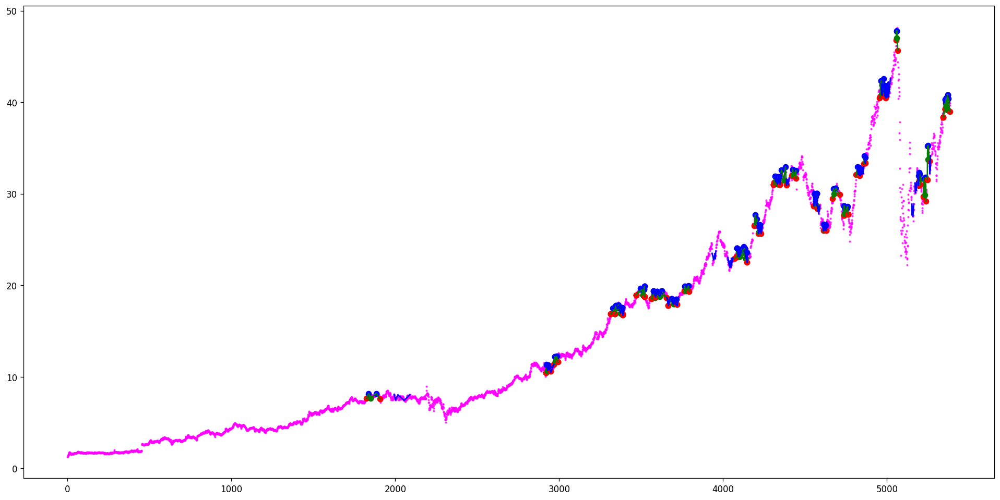

[(3, 77, 93, 104, 110), (3, 80, 93, 100, 110), (3, 80, 93, 104, 110), (124, 139, 172, 199, 270), (124, 143, 172, 196, 270), (124, 143, 172, 197, 270), (124, 143, 172, 199, 270), (124, 144, 172, 196, 270), (124, 145, 172, 196, 270), (124, 152, 172, 196, 270), (124, 161, 172, 196, 270), (124, 164, 172, 196, 270), (194, 199, 205, 220, 264), (493, 504, 510, 514, 582), (493, 504, 510, 517, 582), (493, 504, 510, 540, 582), (510, 517, 519, 531, 582), (510, 517, 519, 536, 582), (510, 517, 519, 537, 582), (510, 517, 519, 540, 582), (493, 542, 582, 601, 634), (493, 544, 582, 595, 634), (493, 544, 582, 596, 634), (493, 544, 582, 601, 634), (493, 549, 582, 595, 634), (493, 552, 582, 595, 634), (493, 554, 582, 595, 634), (493, 563, 582, 595, 634), (493, 564, 582, 595, 634), (667, 678, 682, 685, 687), (783, 794, 804, 808, 883), (783, 801, 804, 806, 883), (783, 801, 804, 808, 883), (804, 839, 850, 861, 877), (804, 845, 850, 861, 877)]
[(109, 123, 139, 170, 198), (109, 123, 139, 172, 198), (109, 127, 

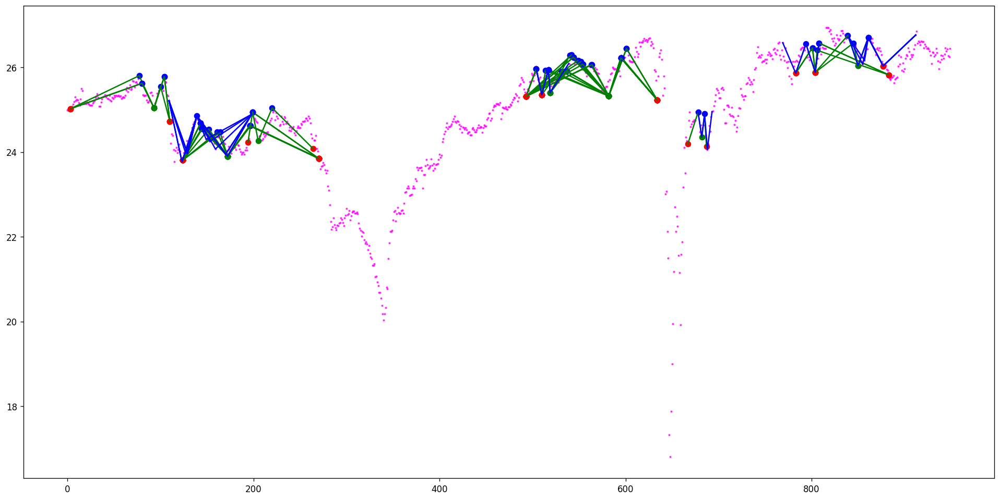

[(133, 333, 351, 426, 508), (360, 367, 404, 426, 496), (361, 381, 387, 395, 404), (360, 381, 404, 426, 496), (360, 395, 404, 426, 496), (748, 776, 802, 823, 862), (748, 777, 802, 814, 862), (748, 777, 802, 823, 862), (748, 783, 802, 814, 862), (802, 854, 862, 865, 868), (889, 891, 892, 894, 915), (889, 891, 892, 895, 915), (889, 891, 892, 897, 915), (1007, 1028, 1032, 1037, 1111), (1007, 1028, 1032, 1044, 1111), (1032, 1075, 1083, 1090, 1110), (1032, 1077, 1083, 1090, 1110)]
[(33, 36, 42, 50, 72), (33, 36, 42, 57, 72), (335, 357, 367, 387, 426), (335, 357, 367, 404, 426), (383, 387, 395, 404, 425), (1075, 1083, 1090, 1112, 1140)]
Ticker ACGLP found 17 double top patterns, 6 double bottom patterns


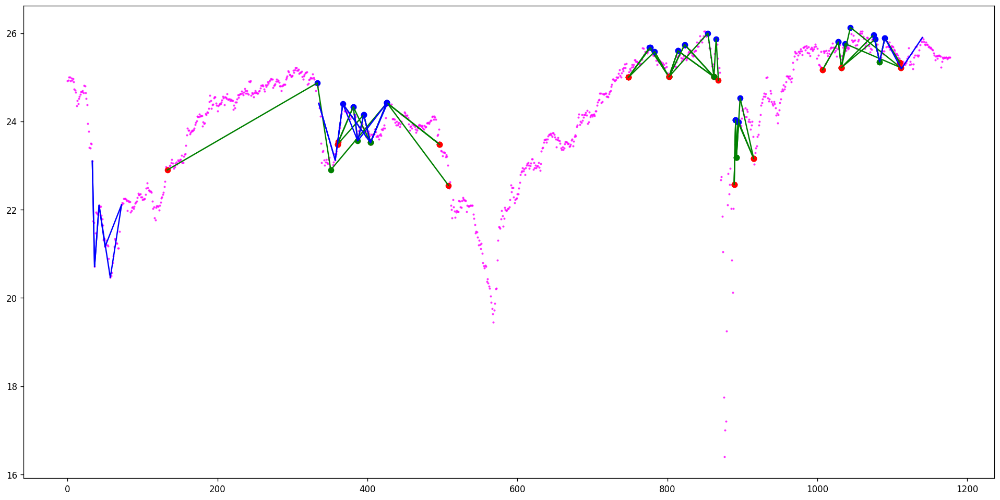

[(471, 473, 476, 477, 480), (511, 514, 516, 518, 520), (510, 514, 520, 521, 524), (565, 569, 572, 573, 576), (614, 619, 623, 625, 629), (735, 737, 741, 745, 752), (906, 908, 911, 924, 931), (1007, 1009, 1012, 1014, 1028), (1007, 1009, 1012, 1017, 1028), (1007, 1009, 1012, 1022, 1028), (1055, 1056, 1057, 1058, 1059), (1055, 1058, 1060, 1062, 1065), (1075, 1087, 1092, 1094, 1098), (1101, 1103, 1105, 1110, 1112), (1118, 1119, 1120, 1122, 1125), (1264, 1266, 1268, 1269, 1271), (1301, 1302, 1304, 1306, 1309), (1339, 1341, 1342, 1345, 1346), (1463, 1464, 1465, 1467, 1468), (1537, 1538, 1541, 1542, 1543), (1537, 1540, 1541, 1542, 1543), (1595, 1596, 1597, 1599, 1600), (1878, 1879, 1881, 1883, 1884), (1969, 1971, 1973, 1974, 1982), (1973, 1974, 1976, 1977, 1981), (1989, 1992, 1995, 1997, 2000), (1987, 1997, 2001, 2009, 2012), (2001, 2004, 2006, 2009, 2012), (1986, 2009, 2012, 2017, 2020), (2053, 2056, 2057, 2058, 2061), (2070, 2072, 2077, 2079, 2085), (2070, 2074, 2077, 2079, 2085), (2070, 207

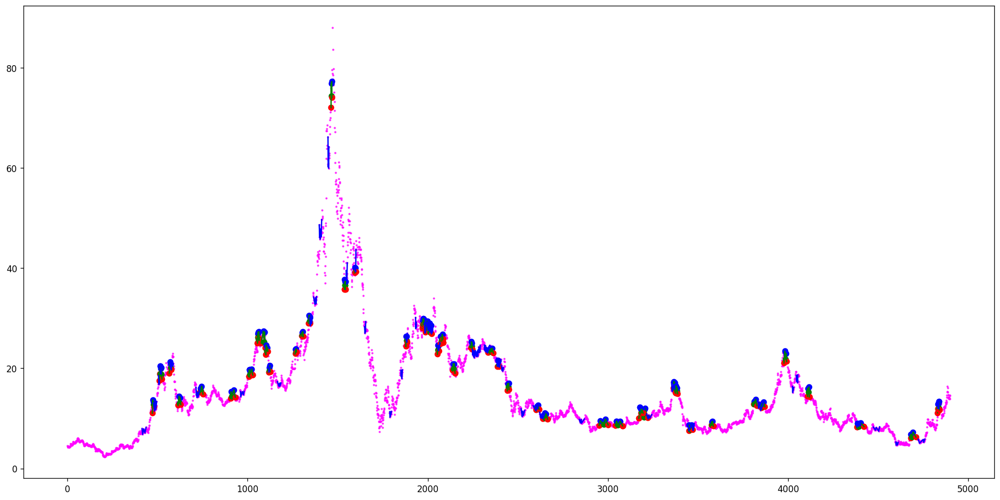

[(1565, 1571, 1599, 1603, 1616), (1755, 1758, 1759, 1761, 1764), (1790, 1793, 1796, 1797, 1800), (1827, 1828, 1844, 1861, 1874), (1966, 1968, 1974, 2009, 2011), (1974, 1978, 1997, 2009, 2011), (2816, 2817, 2818, 2823, 2829), (2819, 2827, 2829, 2830, 2835), (2882, 2884, 2886, 2889, 2895), (2940, 2942, 2943, 2946, 2954), (3068, 3070, 3075, 3079, 3084), (3117, 3119, 3121, 3123, 3124), (3175, 3176, 3177, 3179, 3184), (3239, 3241, 3246, 3248, 3250), (3358, 3361, 3362, 3363, 3364), (3376, 3378, 3382, 3384, 3390), (3370, 3391, 3392, 3393, 3395), (3414, 3419, 3425, 3432, 3433), (3414, 3423, 3425, 3432, 3433), (3443, 3447, 3454, 3458, 3462), (3443, 3451, 3454, 3455, 3462), (3477, 3479, 3480, 3482, 3483), (3526, 3527, 3528, 3530, 3538), (3522, 3534, 3545, 3552, 3564), (3555, 3556, 3557, 3559, 3560), (3634, 3639, 3644, 3646, 3649), (3683, 3685, 3687, 3688, 3689), (3677, 3688, 3698, 3701, 3708), (3699, 3701, 3703, 3704, 3706), (3741, 3743, 3746, 3747, 3751), (3730, 3757, 3762, 3764, 3774), (3776, 

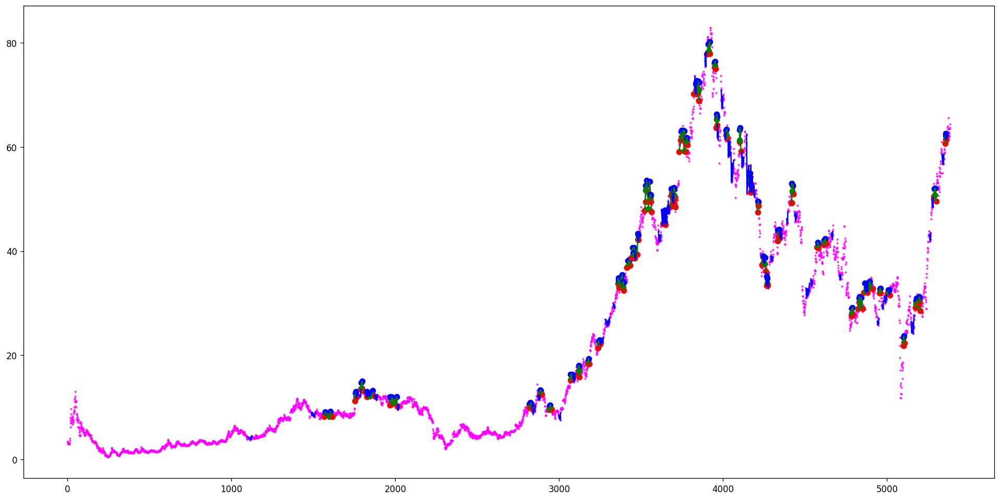

[(30, 32, 33, 36, 40)]
[(28, 30, 32, 33, 36)]
Ticker ACHL found 1 double top patterns, 1 double bottom patterns


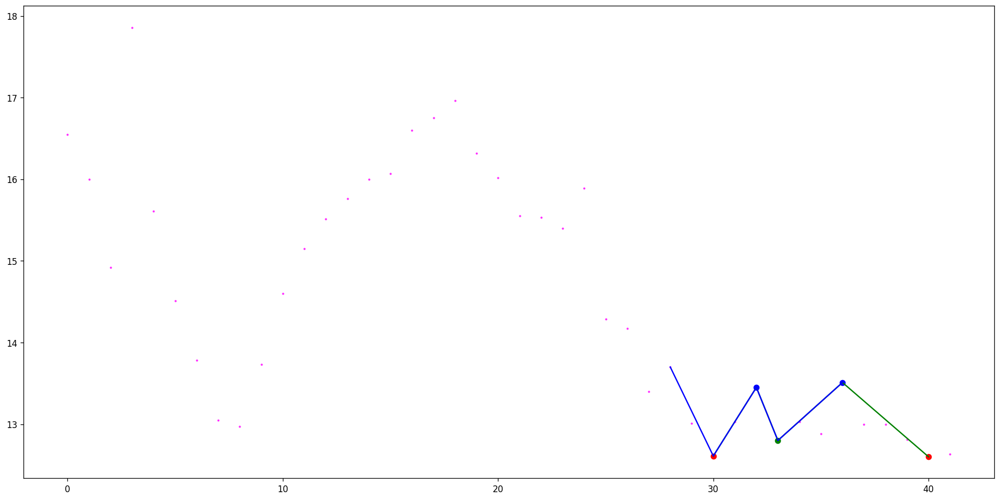

[(50, 51, 53, 55, 56), (50, 52, 53, 55, 56), (60, 61, 62, 63, 65), (60, 61, 62, 64, 65), (73, 74, 75, 76, 78), (249, 250, 251, 252, 253), (358, 359, 362, 363, 364), (694, 695, 696, 697, 698), (902, 904, 905, 906, 908), (902, 904, 905, 907, 908), (1443, 1444, 1445, 1446, 1447), (1455, 1457, 1459, 1460, 1461), (1659, 1666, 1675, 1682, 1694), (1718, 1720, 1723, 1725, 1727), (1977, 1978, 1979, 1980, 1981), (2007, 2008, 2009, 2010, 2011), (2007, 2008, 2009, 2012, 2013), (2009, 2010, 2011, 2012, 2013), (2061, 2062, 2063, 2064, 2065), (2061, 2062, 2063, 2066, 2070), (2061, 2062, 2063, 2067, 2070), (2063, 2064, 2065, 2066, 2070), (2063, 2064, 2065, 2067, 2070), (2084, 2085, 2086, 2087, 2092), (2084, 2085, 2086, 2088, 2092), (2107, 2108, 2109, 2110, 2111), (2160, 2163, 2164, 2166, 2167), (2167, 2168, 2169, 2170, 2171), (3056, 3057, 3058, 3059, 3060), (3098, 3104, 3105, 3108, 3110), (3380, 3382, 3383, 3384, 3385), (3672, 3673, 3674, 3676, 3681), (3672, 3673, 3674, 3677, 3681), (3720, 3721, 3722,

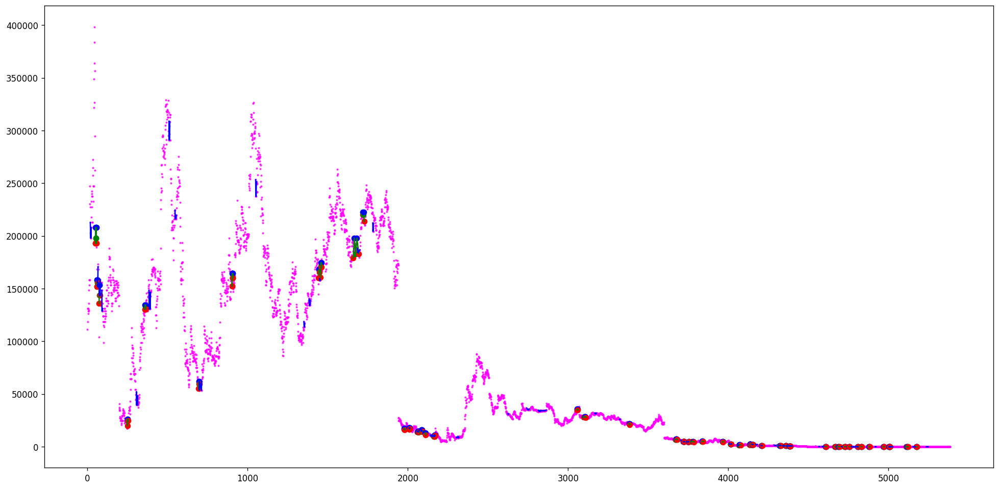

[(183, 185, 186, 189, 192)]
[(44, 50, 53, 56, 73), (53, 58, 60, 62, 69), (205, 209, 211, 212, 218), (205, 209, 211, 214, 218), (205, 214, 219, 220, 223)]
Ticker ACI found 1 double top patterns, 5 double bottom patterns


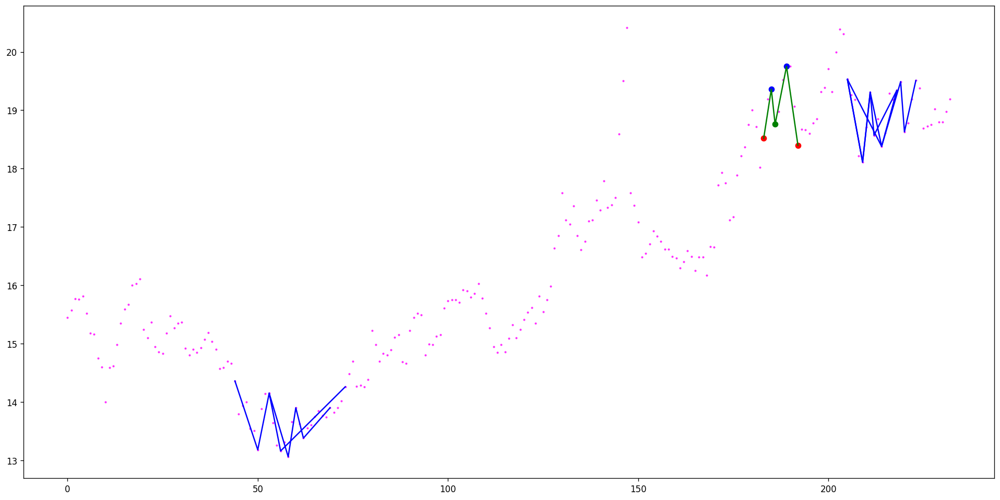

[(19, 20, 21, 23, 24), (53, 54, 55, 60, 62), (95, 98, 105, 110, 112), (112, 116, 117, 119, 121), (217, 220, 222, 229, 234), (364, 366, 370, 374, 376), (825, 827, 829, 832, 834)]
[(61, 63, 65, 67, 70), (79, 95, 98, 105, 110), (111, 112, 116, 117, 118), (383, 385, 388, 391, 393), (400, 403, 404, 405, 421), (462, 463, 466, 468, 469), (1108, 1110, 1111, 1116, 1122)]
Ticker ACIU found 7 double top patterns, 7 double bottom patterns


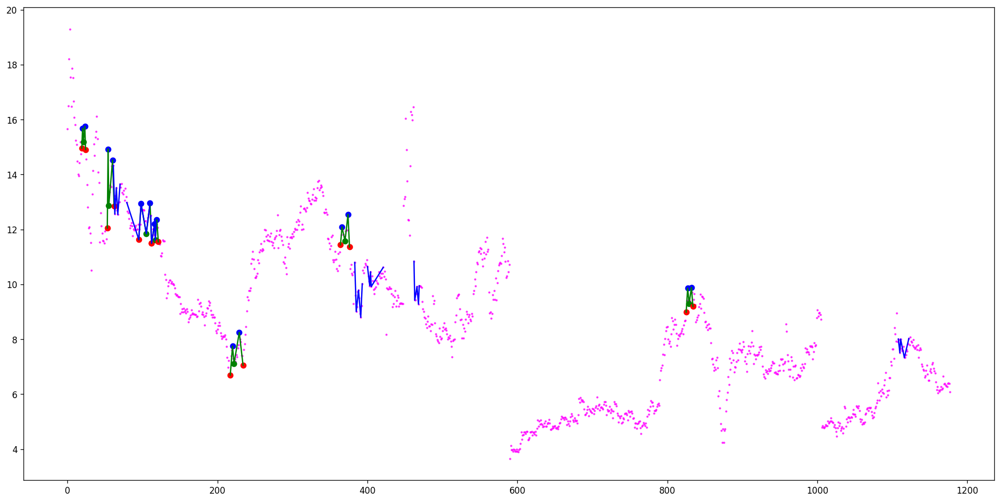

[(1175, 1177, 1187, 1192, 1197), (1232, 1236, 1241, 1245, 1257), (1724, 1727, 1728, 1730, 1750), (2235, 2240, 2241, 2242, 2244), (2477, 2483, 2495, 2510, 2533), (2819, 2827, 2841, 2848, 2851), (2819, 2829, 2841, 2848, 2851), (2819, 2832, 2841, 2848, 2851), (3064, 3082, 3086, 3092, 3095), (3063, 3082, 3096, 3109, 3122), (3063, 3082, 3096, 3117, 3122), (3096, 3103, 3107, 3109, 3122), (3107, 3109, 3114, 3117, 3122), (3143, 3146, 3149, 3152, 3157), (3165, 3169, 3187, 3191, 3199), (3165, 3177, 3187, 3188, 3199), (3165, 3177, 3187, 3191, 3199), (3487, 3498, 3508, 3520, 3536), (3509, 3520, 3528, 3534, 3536), (3509, 3522, 3528, 3534, 3536), (3509, 3524, 3528, 3534, 3536), (3558, 3568, 3579, 3583, 3586), (3627, 3633, 3642, 3645, 3654), (3683, 3688, 3693, 3695, 3699), (3881, 3884, 3885, 3888, 3895), (3975, 3980, 3986, 3987, 3997), (3975, 3980, 3986, 3990, 3997), (3975, 3985, 3986, 3987, 3997), (4063, 4068, 4071, 4074, 4080), (4082, 4086, 4092, 4099, 4110), (4082, 4086, 4092, 4101, 4110), (4126, 

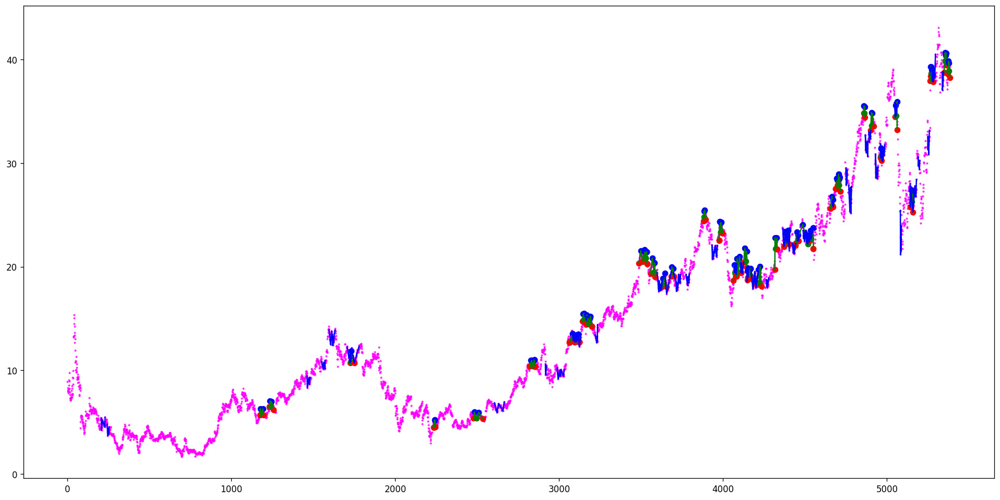

[(708, 711, 718, 736, 752), (724, 737, 740, 743, 750), (724, 737, 740, 744, 750), (724, 739, 740, 743, 750), (724, 739, 740, 744, 750), (781, 786, 791, 796, 799), (781, 786, 791, 798, 799), (781, 788, 791, 796, 799), (781, 789, 791, 796, 799), (800, 801, 802, 819, 832), (1217, 1218, 1225, 1233, 1236), (1337, 1339, 1342, 1373, 1384), (1337, 1341, 1342, 1357, 1384), (1337, 1341, 1342, 1373, 1384), (1511, 1512, 1513, 1516, 1527), (1606, 1607, 1608, 1612, 1615), (1606, 1607, 1608, 1614, 1615), (1641, 1642, 1647, 1649, 1650), (1641, 1645, 1647, 1649, 1650), (1696, 1699, 1706, 1707, 1708), (1714, 1715, 1719, 1720, 1721), (1714, 1717, 1719, 1720, 1721), (1758, 1767, 1768, 1769, 1770), (1796, 1804, 1807, 1809, 1813), (1957, 1963, 1965, 1968, 1973), (1957, 1963, 1965, 1970, 1973), (2054, 2058, 2060, 2069, 2079), (2119, 2138, 2140, 2141, 2145), (2119, 2138, 2140, 2144, 2145)]
[(772, 773, 774, 779, 782), (772, 773, 774, 781, 782), (798, 800, 801, 802, 820), (798, 800, 801, 804, 820), (979, 982, 9

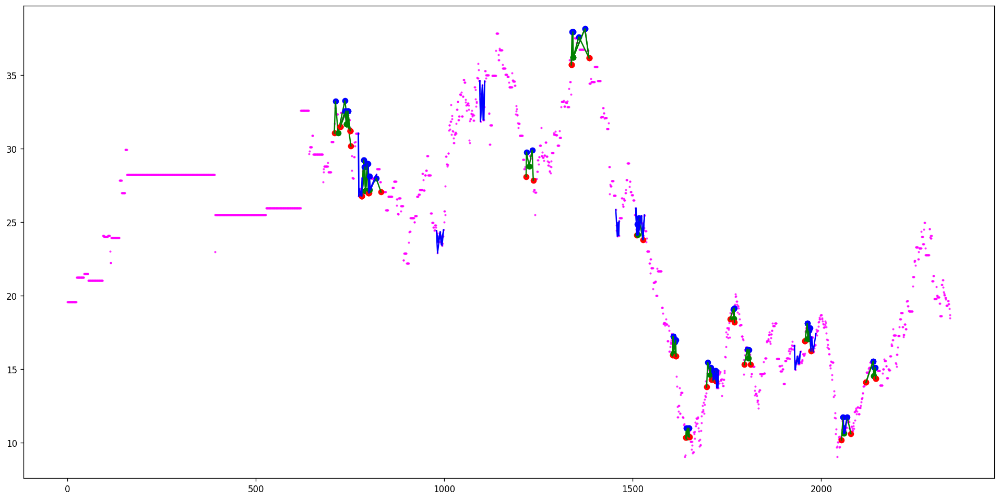

[(966, 967, 968, 981, 986), (966, 967, 968, 985, 986), (1207, 1208, 1215, 1230, 1272), (1207, 1214, 1215, 1230, 1272), (2326, 2333, 2336, 2337, 2350), (2326, 2333, 2336, 2349, 2350), (2315, 2349, 2350, 2371, 2399), (2354, 2371, 2378, 2389, 2399), (2354, 2374, 2378, 2389, 2399), (2354, 2377, 2378, 2389, 2399), (2446, 2450, 2452, 2455, 2465), (2481, 2552, 2554, 2557, 2560), (2646, 2650, 2656, 2660, 2690), (2646, 2652, 2656, 2660, 2690), (2646, 2653, 2656, 2660, 2690), (2740, 2743, 2747, 2749, 2757), (2740, 2744, 2747, 2749, 2757), (2740, 2746, 2747, 2749, 2757)]
[(1177, 1207, 1208, 1215, 1230), (1177, 1207, 1208, 1226, 1230), (2092, 2093, 2097, 2105, 2153), (2092, 2094, 2097, 2105, 2153), (2349, 2350, 2371, 2399, 2421), (2349, 2351, 2371, 2399, 2421), (2349, 2354, 2371, 2378, 2421), (2349, 2354, 2371, 2379, 2421), (2349, 2354, 2371, 2399, 2421), (2349, 2355, 2371, 2378, 2421), (2349, 2356, 2371, 2378, 2421), (2349, 2357, 2371, 2378, 2421), (2349, 2359, 2371, 2378, 2421), (2349, 2365, 237

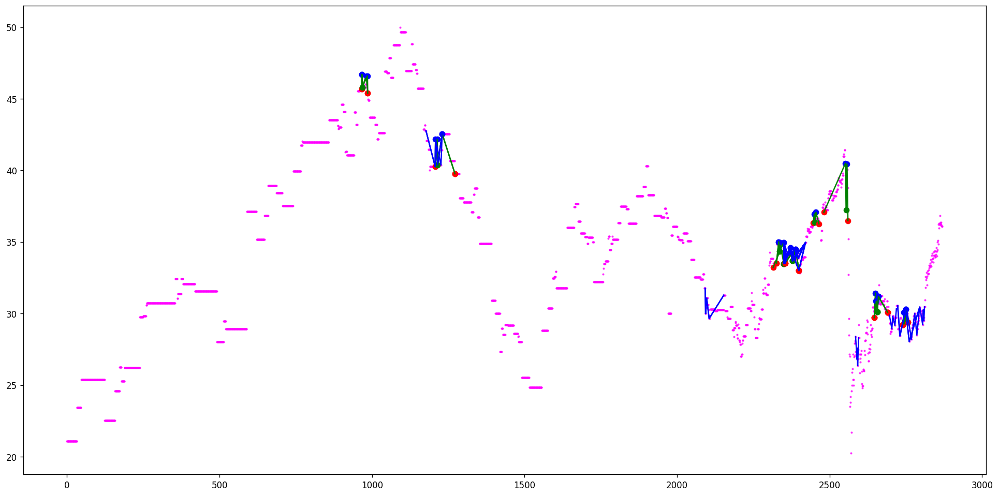

[(54, 55, 56, 57, 58), (92, 93, 95, 96, 98), (138, 141, 147, 153, 155), (163, 164, 165, 166, 171), (274, 275, 276, 278, 279), (395, 396, 397, 398, 400), (442, 443, 446, 447, 448), (481, 483, 487, 491, 494), (552, 553, 555, 557, 559), (572, 573, 574, 575, 577), (650, 652, 653, 654, 657), (694, 697, 699, 701, 708), (723, 727, 729, 736, 739), (784, 785, 786, 788, 789), (831, 832, 834, 835, 837), (847, 848, 849, 851, 852), (909, 910, 911, 912, 913), (919, 921, 922, 924, 927), (935, 937, 940, 941, 944), (945, 946, 947, 948, 951), (945, 946, 947, 950, 951), (972, 973, 975, 976, 977), (1114, 1115, 1116, 1117, 1120), (1114, 1117, 1120, 1121, 1125), (1131, 1132, 1133, 1135, 1137), (1160, 1161, 1163, 1164, 1167), (1253, 1256, 1260, 1262, 1268), (1260, 1262, 1263, 1264, 1268), (1277, 1280, 1281, 1284, 1287), (1335, 1337, 1338, 1339, 1343), (1387, 1388, 1390, 1391, 1395), (1499, 1500, 1506, 1507, 1509), (1594, 1597, 1599, 1600, 1604), (1594, 1597, 1599, 1603, 1604), (1656, 1657, 1661, 1663, 1665),

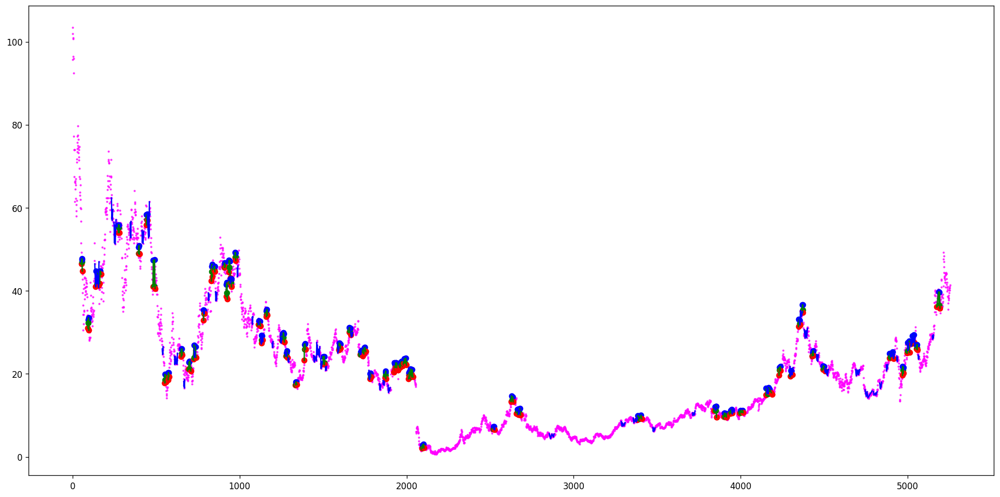

[(43, 44, 47, 48, 49), (58, 59, 60, 62, 63), (105, 109, 110, 111, 112), (143, 148, 153, 159, 164), (143, 148, 153, 161, 164), (157, 159, 160, 161, 163), (265, 266, 269, 270, 272), (285, 286, 287, 288, 289), (314, 319, 326, 330, 332), (314, 323, 326, 330, 332), (314, 325, 326, 330, 332), (336, 337, 338, 339, 340), (404, 406, 409, 412, 414), (424, 426, 427, 428, 429), (462, 464, 465, 466, 469), (476, 479, 482, 483, 489), (501, 503, 506, 509, 512), (501, 503, 506, 510, 512), (513, 519, 524, 526, 528), (584, 587, 592, 594, 596), (742, 743, 747, 748, 751), (767, 768, 770, 772, 774), (841, 848, 850, 853, 857), (933, 936, 938, 940, 943), (932, 936, 946, 952, 954), (933, 940, 944, 945, 946), (932, 940, 946, 952, 954), (932, 945, 946, 952, 954), (955, 958, 960, 961, 963), (971, 973, 978, 981, 988), (1004, 1008, 1018, 1022, 1036), (1004, 1010, 1018, 1022, 1036), (994, 1022, 1041, 1048, 1053), (1018, 1024, 1030, 1032, 1036), (1125, 1127, 1130, 1132, 1136), (1123, 1127, 1147, 1151, 1159), (1186, 1

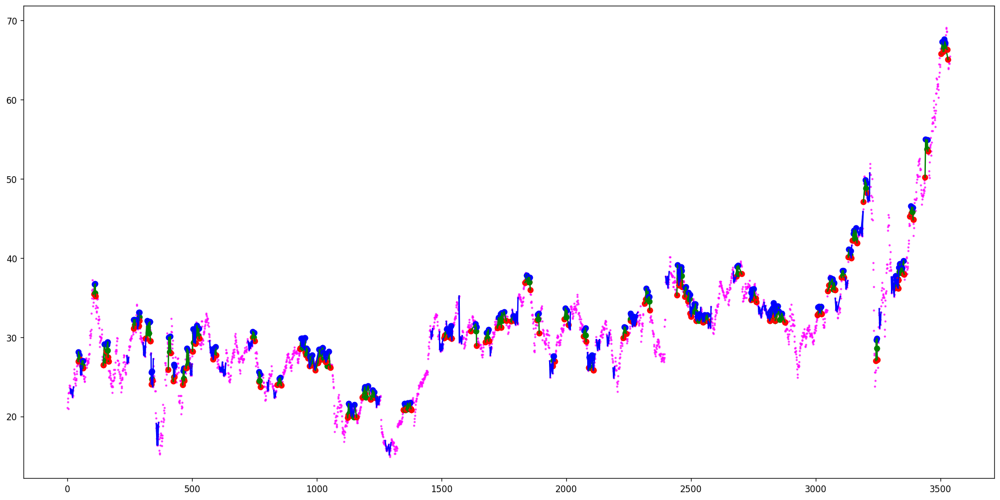

[(108, 124, 128, 162, 163), (108, 127, 128, 162, 163)]
[(91, 92, 124, 142, 143), (1017, 1018, 1054, 1079, 1080)]
Ticker ACMC found 2 double top patterns, 2 double bottom patterns


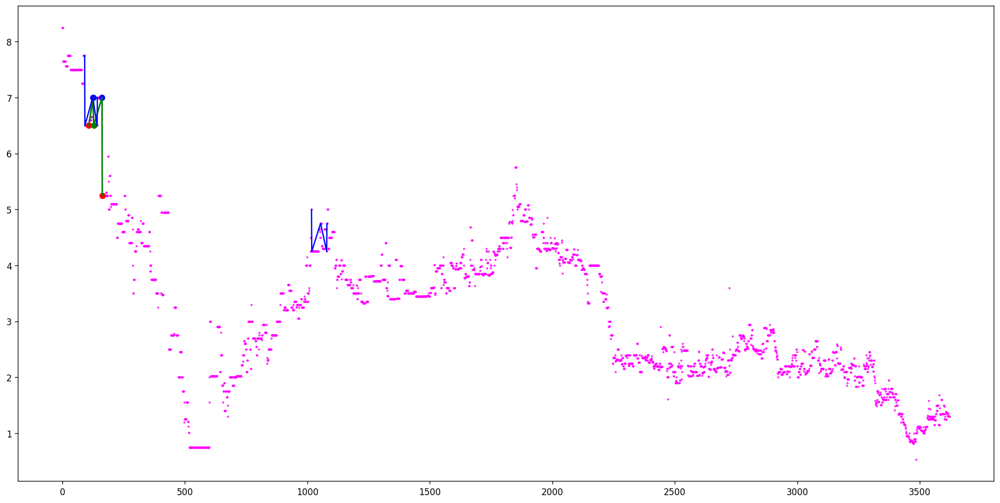

[(92, 93, 94, 96, 104), (125, 126, 127, 130, 134), (141, 144, 149, 154, 158), (185, 188, 190, 193, 195), (390, 394, 397, 400, 403), (390, 396, 397, 400, 403), (441, 442, 443, 445, 446), (600, 601, 602, 603, 605), (771, 772, 773, 774, 775), (783, 784, 786, 788, 789)]
[(90, 92, 93, 105, 109), (93, 94, 96, 105, 109), (385, 386, 387, 388, 391), (482, 492, 498, 501, 503), (482, 495, 498, 501, 503), (509, 514, 515, 517, 525), (610, 611, 613, 614, 615), (725, 726, 728, 729, 730), (884, 885, 887, 890, 891)]
Ticker ACMR found 10 double top patterns, 9 double bottom patterns


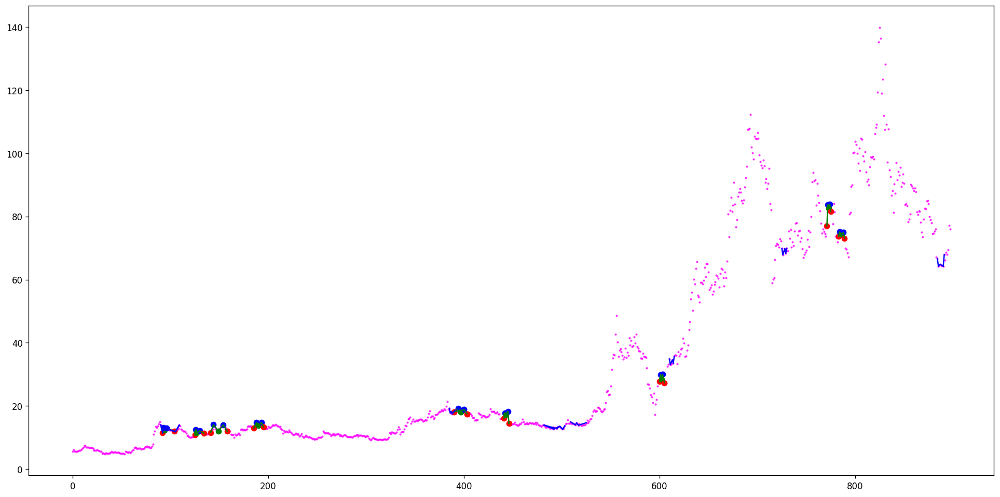

[(8, 9, 14, 15, 18), (8, 13, 14, 15, 18), (102, 104, 106, 110, 112), (112, 113, 114, 117, 119), (131, 132, 135, 137, 138), (155, 157, 160, 162, 163), (181, 183, 184, 185, 189), (196, 198, 199, 203, 204), (392, 394, 401, 406, 409), (392, 395, 398, 399, 401), (392, 395, 401, 406, 409), (412, 418, 424, 425, 429), (495, 496, 498, 499, 500), (500, 502, 508, 509, 512), (500, 504, 508, 509, 512), (529, 532, 537, 540, 544), (577, 578, 580, 581, 583), (626, 628, 629, 630, 631), (678, 679, 681, 683, 687), (675, 683, 687, 688, 691), (728, 730, 732, 733, 745), (844, 846, 851, 855, 868), (844, 847, 851, 855, 868), (844, 848, 851, 855, 868), (966, 977, 980, 985, 987), (966, 985, 990, 994, 995), (1035, 1039, 1042, 1045, 1052), (1096, 1099, 1103, 1107, 1110), (1096, 1101, 1103, 1107, 1110), (1141, 1144, 1145, 1150, 1163), (1241, 1244, 1249, 1250, 1272), (1241, 1244, 1249, 1252, 1272), (1241, 1244, 1249, 1255, 1272), (1249, 1255, 1257, 1259, 1272), (1249, 1255, 1257, 1263, 1272), (1260, 1263, 1264, 126

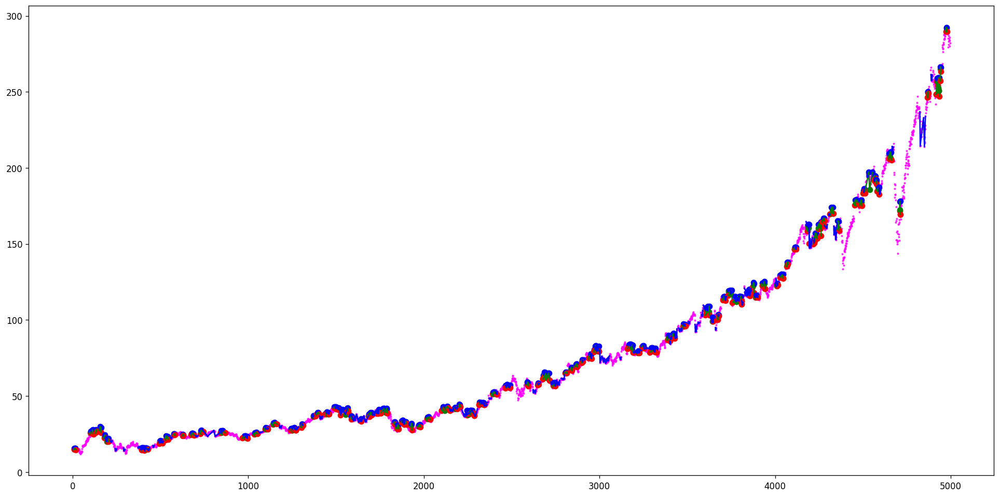

[(48, 49, 50, 51, 53), (71, 74, 76, 87, 93), (259, 265, 276, 293, 294), (259, 269, 276, 293, 294), (259, 272, 276, 293, 294), (396, 400, 403, 419, 425), (396, 400, 403, 421, 425), (396, 402, 403, 415, 417), (396, 402, 403, 419, 425), (396, 402, 403, 421, 425), (405, 415, 417, 419, 425), (438, 446, 452, 487, 532), (438, 447, 452, 487, 532), (485, 487, 489, 517, 532), (428, 526, 532, 533, 534), (428, 527, 532, 533, 534), (428, 528, 532, 533, 534), (428, 531, 532, 533, 534), (537, 538, 540, 543, 551), (537, 539, 540, 543, 551), (542, 543, 549, 550, 551), (542, 548, 549, 550, 551), (587, 589, 595, 636, 641), (587, 589, 595, 638, 641), (604, 605, 607, 636, 640), (604, 605, 607, 638, 640), (604, 606, 607, 611, 622), (604, 606, 607, 617, 622), (604, 606, 607, 619, 622), (604, 606, 607, 623, 624), (604, 606, 607, 631, 640), (604, 606, 607, 632, 640), (604, 606, 607, 636, 640), (604, 606, 607, 638, 640), (610, 611, 622, 623, 624), (610, 611, 622, 631, 640), (610, 617, 622, 623, 624), (610, 617,

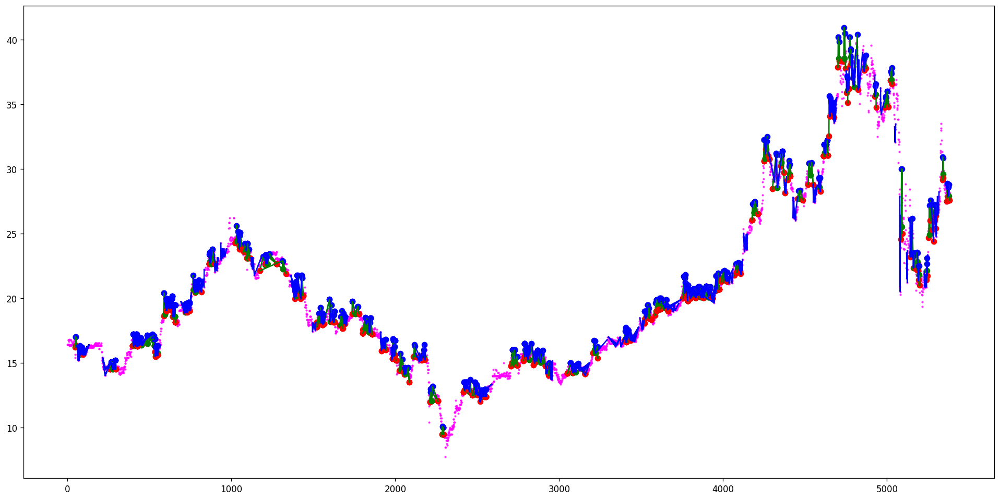

[(61, 91, 103, 109, 124), (61, 91, 103, 115, 124), (61, 98, 103, 109, 124), (177, 181, 183, 184, 205), (248, 268, 269, 272, 291), (248, 268, 269, 282, 291), (269, 272, 278, 282, 291), (269, 275, 278, 282, 291), (512, 518, 521, 531, 578), (524, 531, 534, 543, 559), (524, 531, 534, 545, 559), (524, 531, 534, 548, 559), (524, 531, 534, 552, 559), (524, 557, 559, 570, 575), (728, 733, 757, 773, 887), (728, 733, 757, 777, 887), (728, 733, 757, 780, 887), (1389, 1412, 1417, 1430, 1453), (1628, 1642, 1645, 1679, 1709), (1628, 1643, 1645, 1679, 1709), (2099, 2130, 2161, 2175, 2187), (2546, 2587, 2589, 2593, 2599)]
[(30, 60, 91, 97, 109), (30, 60, 91, 103, 109), (203, 212, 218, 222, 237), (203, 212, 218, 226, 237), (268, 269, 272, 274, 281), (268, 269, 272, 278, 281), (289, 297, 324, 330, 403), (289, 302, 324, 330, 403), (289, 304, 324, 330, 403), (289, 305, 324, 330, 403), (289, 307, 324, 330, 403), (592, 605, 609, 612, 627), (592, 605, 609, 613, 627), (587, 613, 630, 643, 732), (587, 613, 630

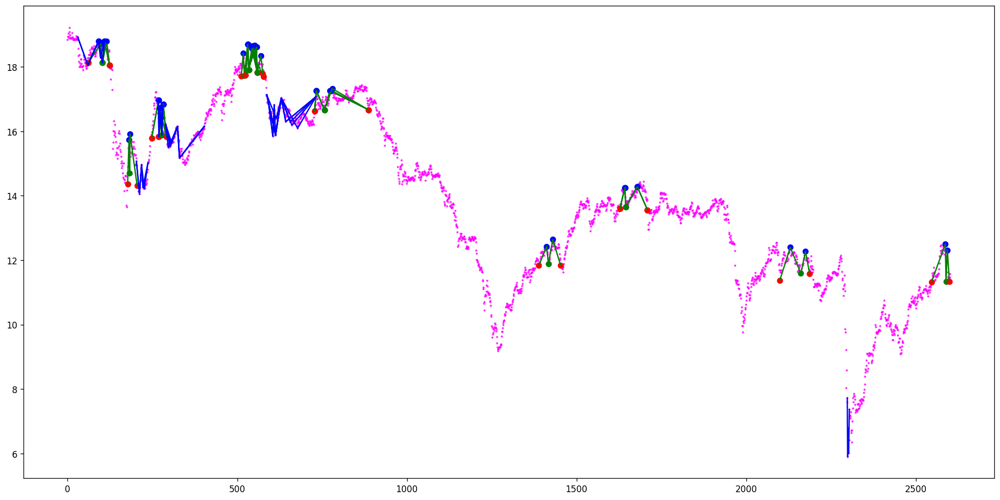

[(4, 5, 6, 7, 10), (4, 5, 6, 9, 10), (11, 18, 19, 24, 36), (11, 18, 19, 28, 36), (21, 24, 25, 26, 30), (21, 24, 25, 27, 30), (21, 24, 25, 28, 30), (46, 53, 55, 60, 66), (59, 60, 62, 63, 64), (90, 91, 92, 94, 109), (300, 302, 303, 304, 305), (429, 430, 432, 433, 434), (485, 486, 487, 488, 489), (642, 647, 649, 650, 651), (800, 801, 804, 805, 806), (861, 862, 863, 864, 866), (861, 862, 863, 865, 866), (943, 948, 954, 958, 963), (974, 979, 980, 981, 982), (1045, 1046, 1048, 1049, 1050), (1069, 1070, 1071, 1072, 1074), (1097, 1099, 1101, 1103, 1104), (1160, 1167, 1171, 1178, 1189), (1250, 1252, 1254, 1257, 1264), (1250, 1261, 1264, 1266, 1269), (1271, 1273, 1275, 1279, 1280), (1286, 1288, 1290, 1291, 1292), (1319, 1323, 1327, 1329, 1348), (1319, 1325, 1327, 1329, 1348), (1334, 1340, 1341, 1342, 1345), (1313, 1340, 1350, 1353, 1357), (1313, 1340, 1350, 1356, 1357), (1327, 1342, 1345, 1347, 1348), (1313, 1342, 1350, 1353, 1357), (1313, 1347, 1350, 1353, 1357), (1411, 1414, 1417, 1419, 1421),

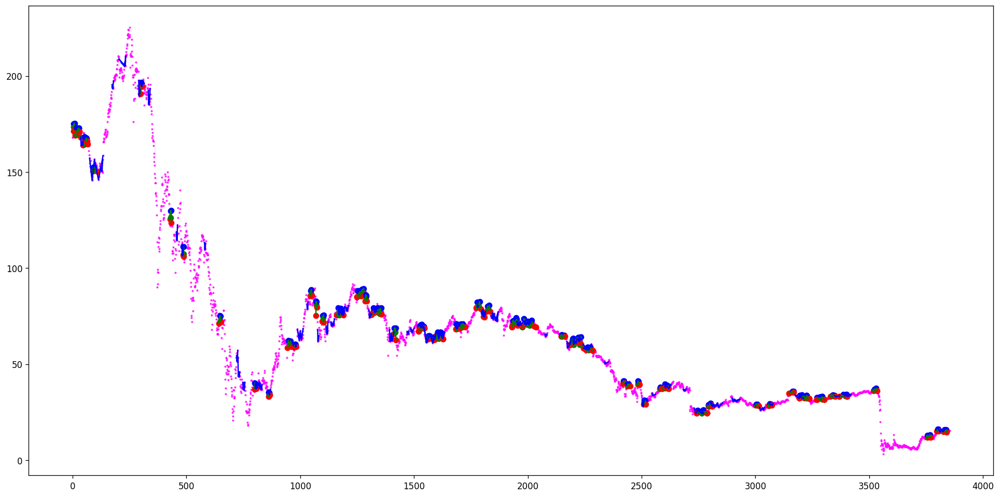

[(175, 181, 187, 192, 199), (175, 183, 187, 192, 199), (169, 192, 208, 217, 233), (169, 201, 208, 217, 233), (383, 390, 407, 450, 500), (383, 390, 407, 464, 500), (819, 830, 835, 838, 841), (813, 838, 846, 853, 860), (800, 838, 860, 900, 913), (800, 838, 860, 902, 913), (1143, 1163, 1167, 1172, 1222), (1143, 1163, 1167, 1173, 1222), (1143, 1163, 1167, 1179, 1222), (1168, 1188, 1203, 1221, 1222), (1226, 1259, 1271, 1292, 1307), (1324, 1375, 1384, 1420, 1429), (1324, 1380, 1384, 1404, 1429), (1324, 1380, 1384, 1405, 1429), (1324, 1380, 1384, 1408, 1429), (1324, 1380, 1384, 1420, 1429)]
[(7, 14, 16, 17, 27), (7, 14, 16, 24, 27), (136, 146, 150, 159, 162), (287, 289, 295, 297, 314), (287, 292, 295, 297, 314), (319, 334, 344, 355, 384), (319, 334, 344, 364, 384), (839, 846, 853, 860, 873), (839, 848, 853, 860, 873), (1008, 1019, 1020, 1021, 1023), (1076, 1104, 1108, 1116, 1128), (1076, 1104, 1108, 1119, 1128), (1188, 1203, 1221, 1223, 1249), (1448, 1457, 1465, 1505, 1512), (1448, 1457, 1465

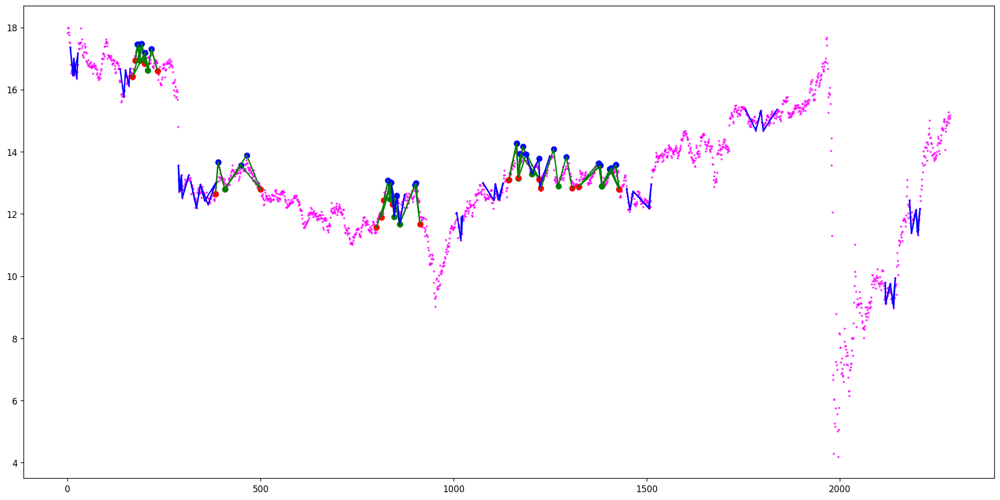

[]
[(20, 23, 24, 26, 33)]
Ticker ACRHF found 0 double top patterns, 1 double bottom patterns


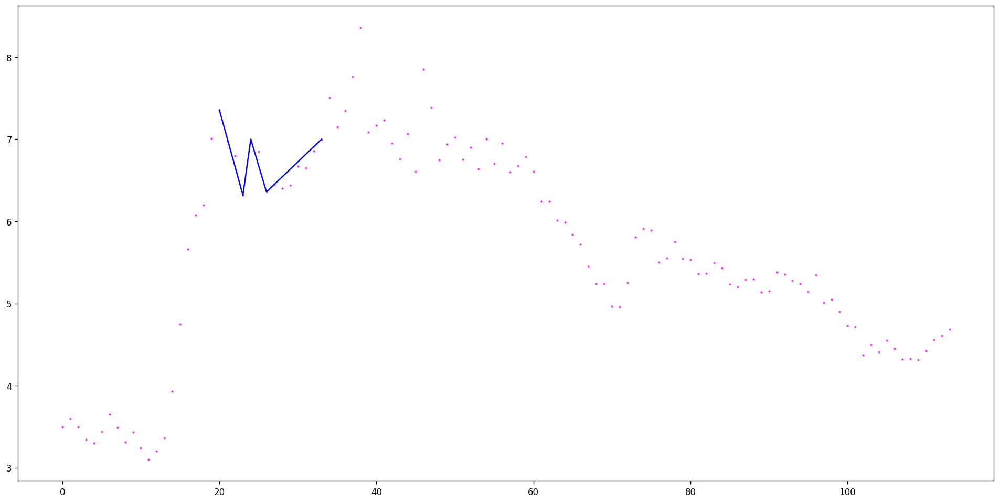

[(6, 7, 8, 10, 12), (59, 60, 61, 62, 63), (75, 76, 77, 79, 85), (121, 122, 124, 125, 129), (121, 123, 124, 125, 129), (289, 290, 292, 295, 297), (400, 401, 402, 403, 404), (400, 403, 404, 405, 406), (482, 485, 487, 488, 490), (479, 485, 492, 506, 519), (561, 562, 565, 569, 582), (565, 571, 573, 578, 582), (728, 729, 731, 732, 751), (728, 729, 731, 734, 751), (731, 732, 733, 734, 735), (890, 894, 898, 901, 903), (1260, 1262, 1266, 1269, 1275)]
[(469, 472, 475, 477, 480), (469, 473, 475, 477, 480), (526, 527, 528, 529, 530), (587, 588, 589, 591, 595), (615, 622, 623, 625, 654), (725, 726, 727, 728, 729), (1374, 1375, 1376, 1378, 1380)]
Ticker ACRS found 17 double top patterns, 7 double bottom patterns


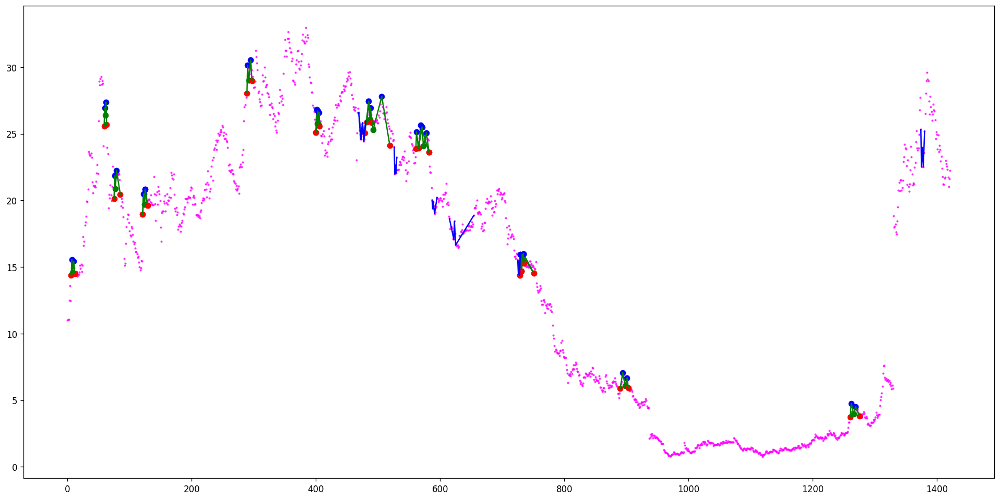

[(485, 487, 499, 503, 512), (582, 584, 586, 588, 591), (604, 605, 609, 612, 617), (654, 656, 660, 662, 664), (838, 841, 846, 852, 860)]
[(682, 683, 685, 689, 690), (737, 742, 745, 749, 755), (788, 791, 793, 797, 801), (986, 992, 994, 999, 1003)]
Ticker ACRX found 5 double top patterns, 4 double bottom patterns


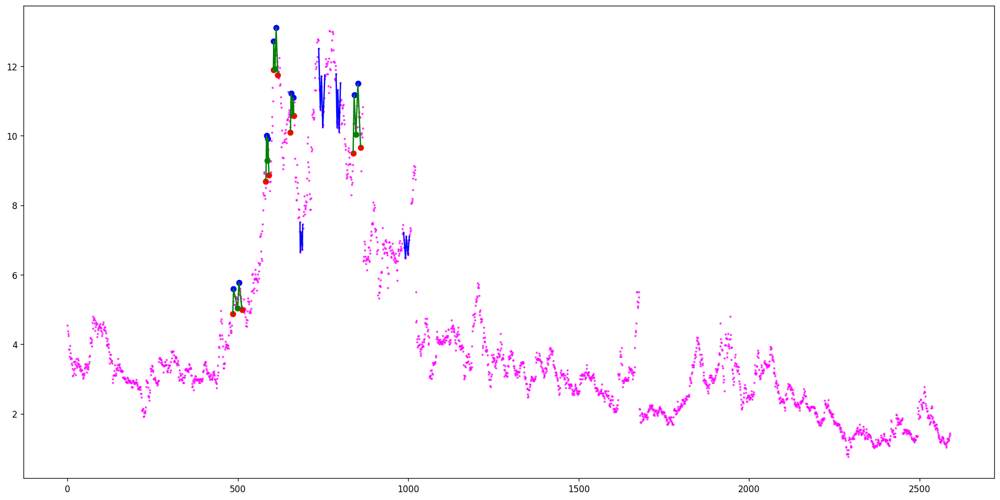

[(118, 121, 134, 143, 144), (228, 229, 232, 233, 237), (242, 243, 244, 245, 251), (242, 243, 244, 246, 251), (242, 243, 244, 248, 251), (259, 261, 262, 264, 273), (262, 264, 266, 270, 273), (262, 264, 266, 272, 273), (317, 318, 319, 322, 323), (448, 449, 450, 451, 452), (481, 482, 486, 487, 492)]
[(235, 239, 241, 242, 243), (258, 259, 261, 262, 264), (258, 259, 272, 273, 275), (426, 427, 428, 429, 430), (434, 435, 439, 441, 443), (495, 496, 498, 501, 502), (492, 501, 502, 507, 512), (492, 501, 502, 510, 512), (600, 601, 603, 606, 607), (600, 602, 603, 606, 607), (627, 632, 638, 640, 647), (627, 634, 638, 640, 647), (627, 636, 638, 640, 647)]
Ticker ACST found 11 double top patterns, 13 double bottom patterns


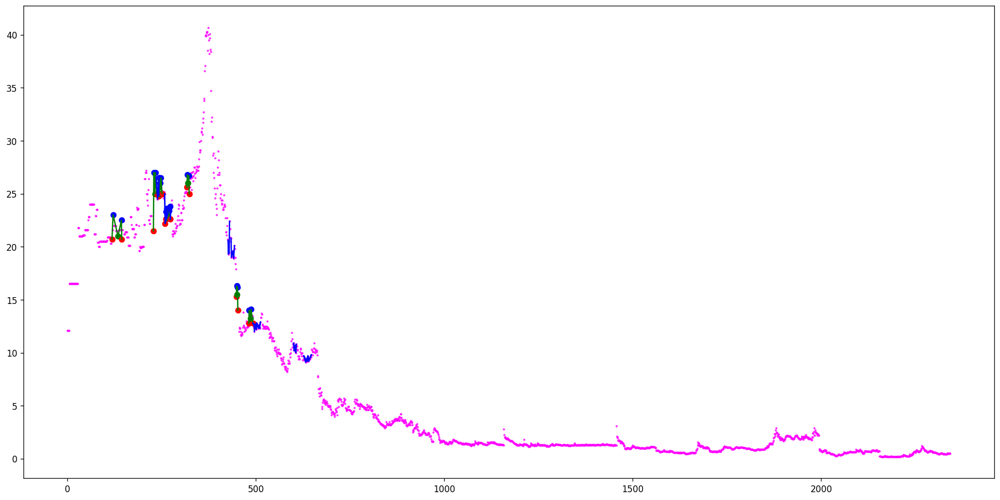

[(312, 315, 319, 328, 343), (312, 316, 319, 325, 343), (312, 316, 319, 328, 343), (984, 987, 989, 992, 994), (1068, 1071, 1076, 1082, 1090), (1138, 1145, 1147, 1149, 1158), (1208, 1216, 1222, 1224, 1232), (1677, 1686, 1711, 1719, 1731), (1860, 1864, 1869, 1878, 1880), (1873, 1874, 1876, 1878, 1879), (1885, 1890, 1893, 1895, 1896), (2019, 2020, 2021, 2024, 2027), (2045, 2046, 2047, 2048, 2056), (2047, 2050, 2052, 2054, 2056), (2125, 2126, 2127, 2128, 2129), (2157, 2158, 2159, 2160, 2161), (2219, 2221, 2225, 2226, 2227), (2273, 2274, 2276, 2278, 2279), (2322, 2335, 2355, 2361, 2369), (2346, 2347, 2349, 2351, 2352), (2345, 2351, 2352, 2353, 2355), (2402, 2405, 2408, 2415, 2416), (2471, 2474, 2481, 2486, 2492), (2583, 2586, 2589, 2597, 2598), (2589, 2590, 2594, 2595, 2598), (2589, 2590, 2594, 2597, 2598), (2603, 2605, 2610, 2612, 2626), (2611, 2612, 2613, 2615, 2622), (2611, 2612, 2622, 2623, 2625), (2611, 2615, 2622, 2623, 2625), (2627, 2632, 2633, 2635, 2645), (2627, 2632, 2633, 2637, 26

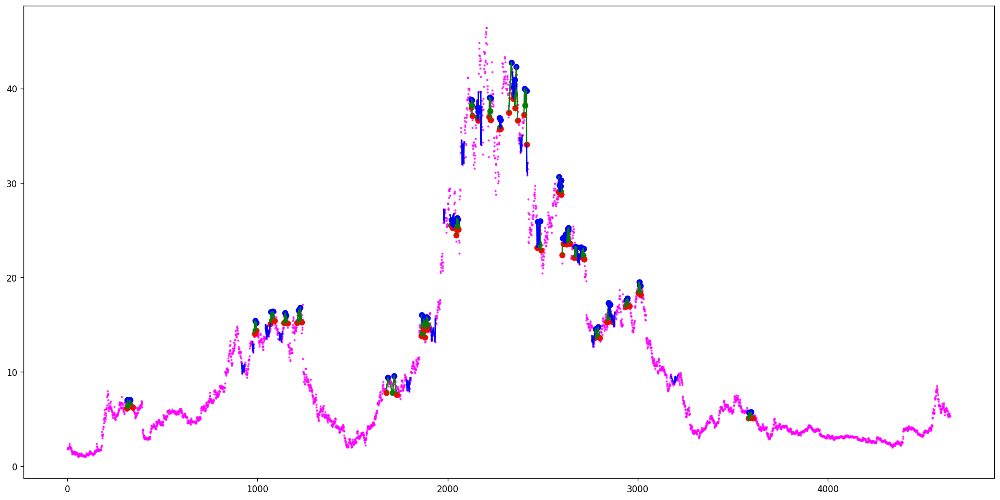

[(41, 47, 50, 51, 56), (67, 69, 71, 72, 78), (66, 69, 79, 83, 86), (66, 72, 79, 83, 86), (205, 235, 253, 259, 277), (205, 235, 253, 261, 277), (205, 235, 253, 264, 277), (205, 238, 253, 259, 277), (205, 242, 253, 259, 277), (295, 326, 332, 344, 351), (599, 622, 628, 636, 644), (599, 622, 628, 638, 644), (663, 666, 670, 674, 678), (663, 666, 670, 676, 678), (703, 713, 715, 716, 718), (813, 834, 838, 845, 851), (813, 834, 838, 848, 851), (972, 976, 979, 987, 1010), (984, 998, 1000, 1003, 1008), (1024, 1027, 1030, 1035, 1058), (1019, 1039, 1058, 1064, 1099), (1019, 1050, 1058, 1064, 1099), (1019, 1052, 1058, 1064, 1099), (1019, 1053, 1058, 1064, 1099), (1019, 1054, 1058, 1064, 1099), (1062, 1064, 1066, 1070, 1075), (1219, 1220, 1221, 1223, 1224), (1334, 1335, 1337, 1340, 1345), (1403, 1405, 1407, 1410, 1415), (1480, 1485, 1488, 1492, 1498)]
[(69, 71, 72, 76, 83), (69, 71, 72, 79, 83), (162, 167, 175, 183, 196), (622, 628, 638, 644, 663), (622, 630, 638, 644, 663), (622, 632, 638, 641, 663

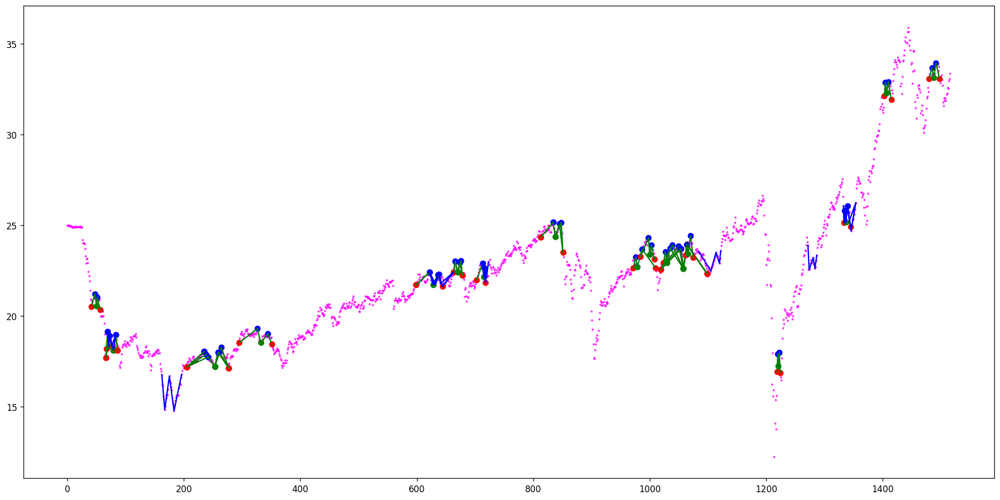

[(65, 79, 81, 82, 85)]
[(79, 81, 82, 85, 89)]
Ticker ACVF found 1 double top patterns, 1 double bottom patterns


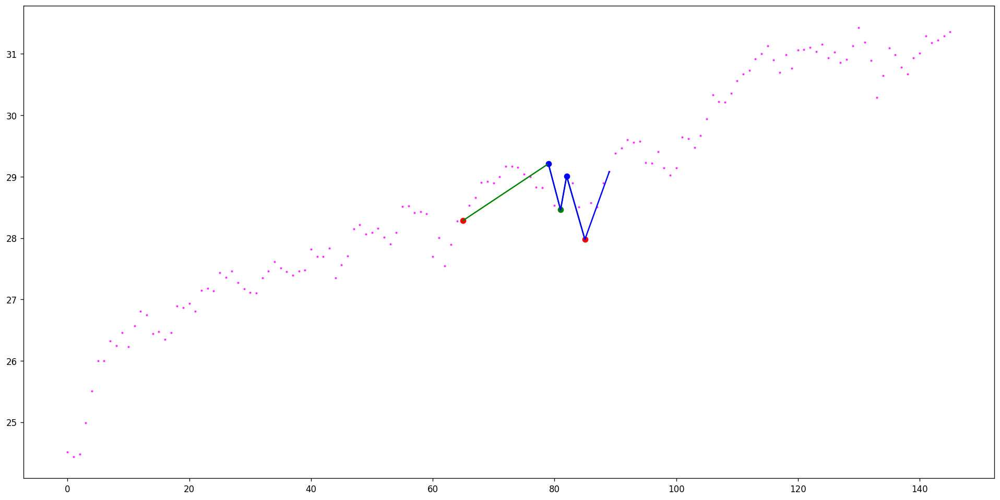

[(19, 21, 22, 23, 49), (30, 39, 40, 43, 47), (22, 43, 47, 48, 49), (75, 86, 89, 91, 99), (89, 91, 92, 94, 96), (100, 103, 104, 107, 110), (178, 183, 188, 194, 201), (208, 211, 214, 219, 224), (247, 248, 249, 251, 253), (295, 297, 298, 304, 306), (339, 340, 346, 348, 350), (339, 344, 346, 348, 350), (412, 416, 418, 419, 422), (412, 416, 418, 421, 422), (408, 416, 422, 425, 436), (408, 421, 422, 425, 436), (423, 427, 430, 433, 436), (449, 451, 452, 456, 457), (494, 496, 502, 505, 529), (494, 500, 502, 505, 529), (510, 515, 518, 522, 524), (503, 526, 527, 528, 529), (545, 546, 548, 549, 551), (573, 579, 580, 582, 583), (638, 645, 646, 647, 674), (638, 645, 646, 650, 674), (704, 708, 710, 715, 716), (704, 715, 716, 718, 747), (717, 731, 733, 736, 744), (717, 731, 733, 739, 744), (734, 736, 737, 739, 744), (756, 763, 771, 774, 795), (756, 765, 771, 774, 795), (756, 786, 795, 800, 806), (772, 788, 790, 793, 795), (756, 788, 795, 800, 806), (819, 826, 833, 837, 843), (850, 853, 857, 865, 879)

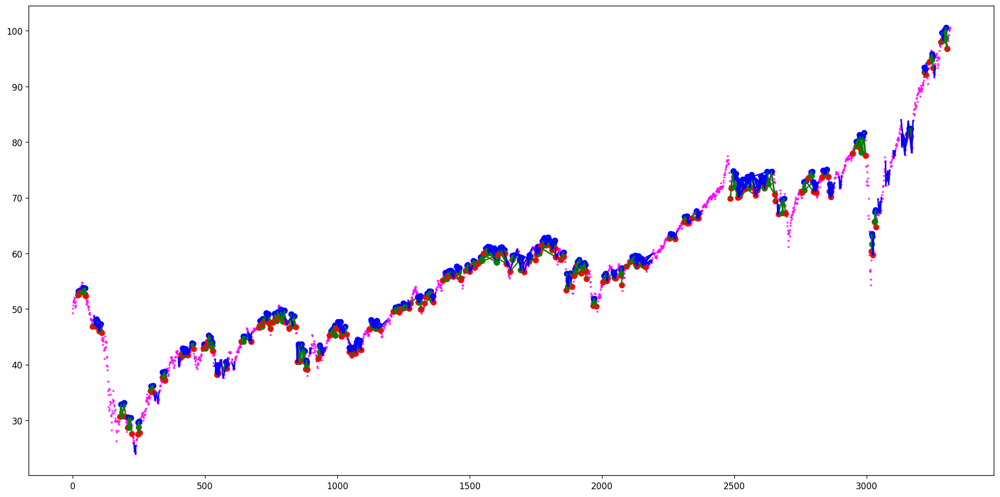

[(28, 32, 34, 35, 36), (28, 33, 34, 35, 36), (83, 90, 93, 98, 142), (83, 91, 93, 98, 142), (83, 92, 93, 98, 142), (93, 112, 117, 130, 142), (93, 112, 117, 132, 142), (93, 115, 117, 119, 142), (93, 115, 117, 123, 142), (93, 115, 117, 124, 142), (93, 115, 117, 125, 142), (78, 143, 144, 151, 154), (78, 143, 144, 153, 154), (192, 194, 197, 198, 268), (197, 198, 202, 207, 268), (220, 222, 223, 226, 264), (225, 226, 227, 233, 254), (225, 226, 227, 236, 254), (225, 226, 227, 238, 254), (227, 233, 234, 236, 247), (227, 242, 247, 250, 254), (364, 369, 370, 371, 403), (364, 369, 370, 376, 403), (370, 371, 372, 376, 401), (382, 387, 390, 392, 397), (406, 408, 411, 412, 417), (430, 439, 445, 447, 456), (427, 459, 460, 462, 464), (475, 479, 493, 497, 570), (475, 482, 493, 497, 570), (475, 485, 493, 497, 570), (475, 488, 493, 497, 570), (502, 508, 515, 521, 533), (502, 514, 515, 521, 533), (499, 530, 534, 535, 538), (498, 535, 544, 551, 566), (584, 591, 592, 593, 606), (592, 595, 601, 603, 605), (59

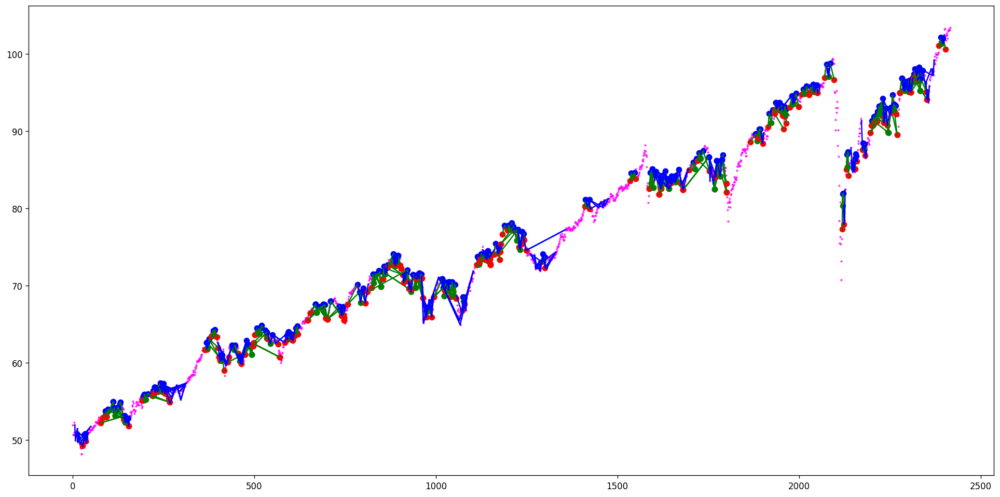

[(18, 19, 20, 21, 47), (18, 19, 20, 25, 47), (22, 25, 26, 29, 45), (22, 42, 45, 46, 47), (176, 181, 186, 192, 199), (206, 209, 212, 217, 222), (245, 246, 247, 249, 250), (292, 295, 299, 302, 304), (336, 338, 344, 346, 348), (336, 342, 344, 346, 348), (388, 390, 391, 392, 396), (406, 412, 416, 419, 420), (406, 412, 420, 423, 434), (406, 419, 420, 423, 434), (443, 452, 453, 454, 455), (530, 531, 532, 533, 535), (543, 544, 546, 547, 549), (633, 643, 644, 645, 664), (633, 643, 644, 648, 664), (679, 683, 688, 696, 701), (702, 706, 708, 710, 714), (702, 706, 708, 713, 714), (702, 706, 714, 716, 744), (702, 713, 714, 716, 744), (715, 721, 723, 729, 730), (715, 729, 730, 734, 742), (715, 729, 730, 737, 742), (732, 734, 735, 737, 742), (755, 763, 769, 772, 793), (748, 784, 793, 798, 809), (793, 805, 806, 808, 809), (816, 824, 831, 835, 842), (848, 851, 855, 863, 869), (848, 853, 855, 861, 869), (848, 853, 855, 863, 869), (880, 881, 882, 883, 884), (891, 894, 895, 896, 897), (925, 931, 932, 933,

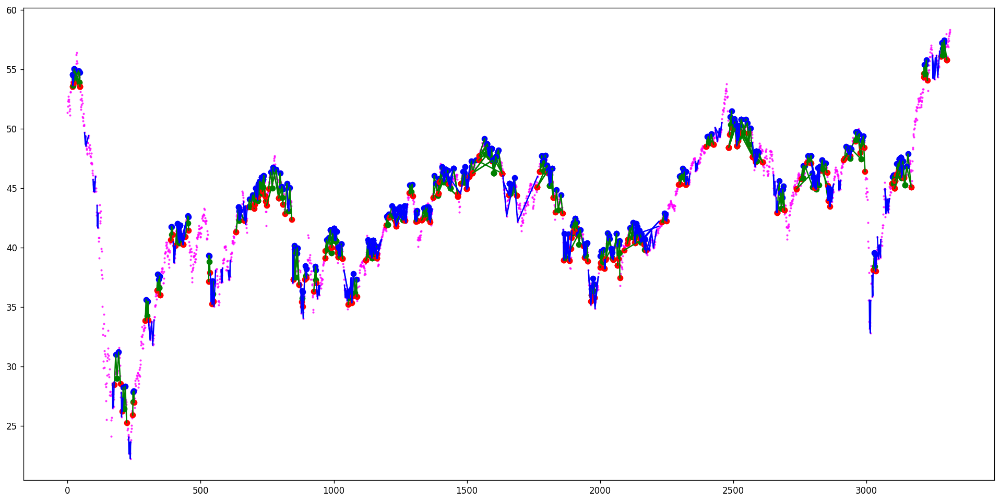

[(16, 17, 18, 20, 21), (31, 33, 34, 35, 38), (182, 183, 185, 186, 192), (203, 204, 209, 211, 212), (203, 207, 209, 211, 212), (198, 211, 212, 213, 214), (212, 213, 214, 215, 216), (277, 279, 285, 288, 289), (408, 410, 414, 418, 425), (466, 467, 468, 470, 471), (526, 527, 529, 531, 534), (526, 527, 529, 533, 534), (583, 585, 590, 594, 595), (583, 586, 590, 594, 595), (583, 588, 590, 594, 595), (706, 707, 714, 716, 718), (706, 708, 714, 716, 718), (759, 760, 762, 763, 765), (856, 862, 863, 864, 865), (930, 931, 934, 935, 936), (958, 963, 970, 979, 985), (1015, 1018, 1019, 1021, 1024), (1015, 1018, 1019, 1022, 1024), (1060, 1061, 1062, 1063, 1064), (1129, 1131, 1133, 1135, 1138), (1129, 1132, 1133, 1135, 1138), (1525, 1526, 1527, 1529, 1543), (1525, 1526, 1527, 1532, 1543), (1525, 1526, 1527, 1533, 1543), (1525, 1526, 1527, 1542, 1543), (2230, 2231, 2237, 2245, 2261), (2467, 2468, 2471, 2476, 2503), (2467, 2470, 2471, 2474, 2503), (2467, 2470, 2471, 2475, 2503), (2467, 2470, 2471, 2476, 2

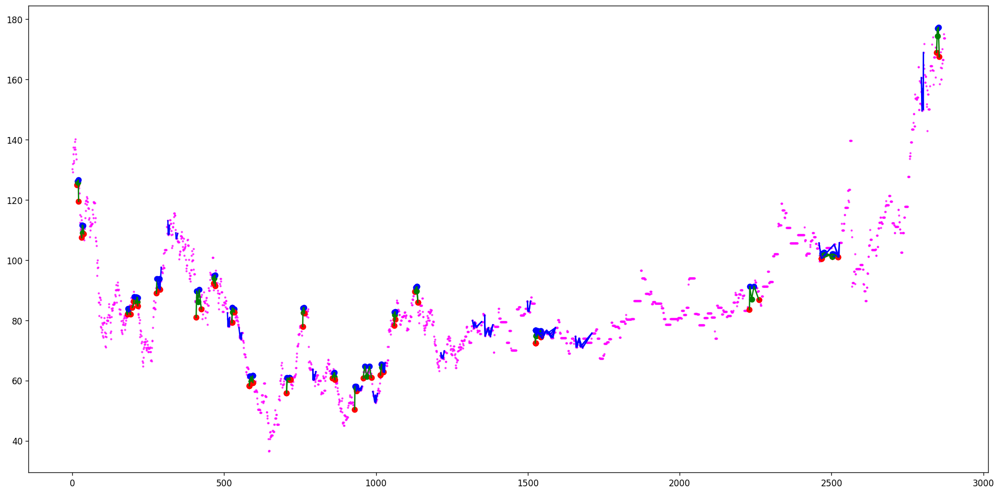

[(1823, 1825, 1826, 1827, 1832), (1920, 1922, 1928, 1929, 1936), (1920, 1922, 1928, 1931, 1936), (2025, 2031, 2034, 2036, 2038), (2074, 2078, 2080, 2081, 2083), (2263, 2265, 2267, 2270, 2272), (2284, 2285, 2287, 2288, 2289), (2581, 2584, 2586, 2596, 2599), (2709, 2711, 2712, 2713, 2719), (2709, 2711, 2712, 2716, 2719), (3189, 3198, 3205, 3210, 3226), (3189, 3201, 3205, 3210, 3226), (3273, 3275, 3277, 3280, 3305), (3277, 3285, 3290, 3291, 3300), (3277, 3285, 3290, 3292, 3300), (3277, 3285, 3290, 3296, 3300), (3331, 3332, 3334, 3338, 3343), (3421, 3422, 3424, 3425, 3463), (3421, 3422, 3424, 3447, 3463), (3424, 3425, 3431, 3439, 3458), (3424, 3425, 3431, 3447, 3458), (3424, 3430, 3431, 3432, 3458), (3424, 3430, 3431, 3439, 3458), (3436, 3447, 3448, 3449, 3451), (3528, 3530, 3532, 3534, 3540), (3575, 3578, 3579, 3580, 3584), (3623, 3629, 3632, 3636, 3642), (3623, 3629, 3632, 3639, 3642), (3644, 3645, 3648, 3654, 3670), (3644, 3645, 3648, 3657, 3670), (3682, 3686, 3687, 3690, 3695), (3711, 

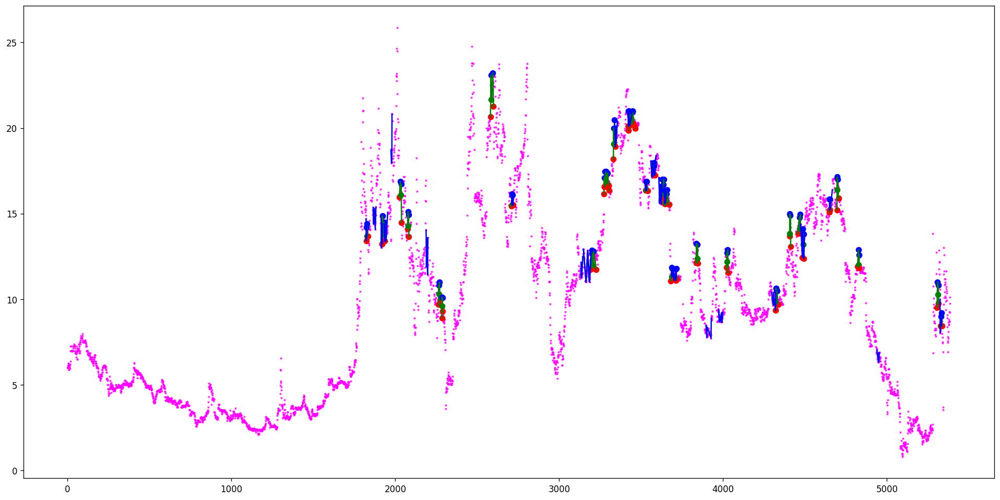

[(230, 232, 235, 238, 241), (601, 602, 604, 607, 614), (629, 632, 638, 655, 658)]
[(9, 11, 14, 18, 22), (75, 76, 80, 81, 90), (233, 235, 238, 241, 243), (596, 601, 602, 604, 607), (727, 729, 730, 735, 738), (1464, 1469, 1479, 1498, 1505)]
Ticker ADAP found 3 double top patterns, 6 double bottom patterns


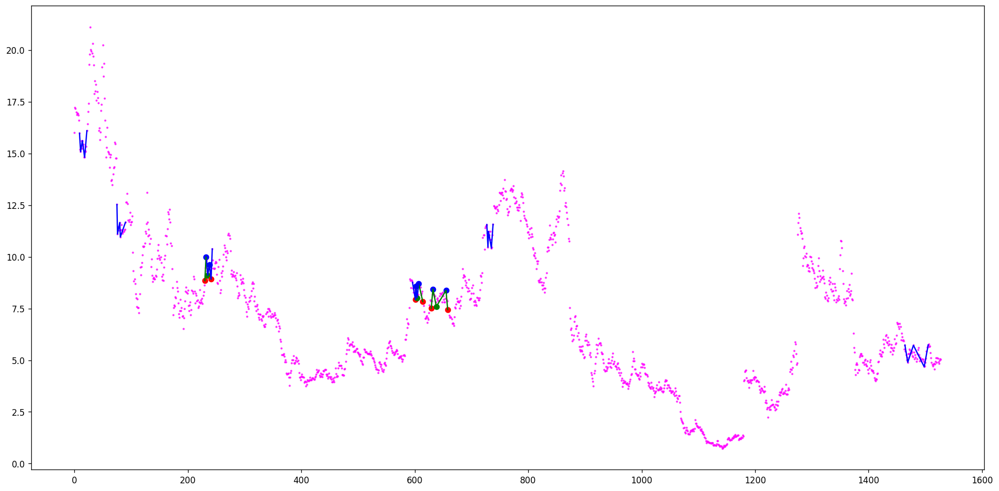

[(3, 5, 7, 9, 14), (56, 60, 61, 62, 63), (162, 169, 171, 172, 174), (211, 214, 216, 217, 218), (306, 307, 309, 310, 312), (386, 387, 388, 389, 392), (513, 515, 516, 517, 520), (540, 541, 544, 546, 547), (539, 541, 549, 560, 568), (540, 543, 544, 546, 547), (568, 571, 577, 582, 585), (724, 727, 728, 729, 731), (736, 742, 744, 746, 749), (833, 835, 839, 841, 845), (911, 912, 913, 917, 925), (929, 931, 933, 934, 939), (988, 991, 992, 998, 1009), (993, 995, 996, 998, 1008), (1012, 1016, 1017, 1019, 1021), (1097, 1111, 1119, 1127, 1139), (1239, 1243, 1246, 1252, 1257), (1277, 1279, 1282, 1284, 1290), (1277, 1279, 1282, 1286, 1290), (1277, 1281, 1282, 1284, 1290), (1307, 1308, 1314, 1315, 1325), (1307, 1308, 1314, 1321, 1325), (1314, 1315, 1318, 1321, 1325), (1330, 1332, 1335, 1337, 1338), (1352, 1365, 1366, 1370, 1372), (1408, 1411, 1412, 1413, 1415), (1507, 1519, 1521, 1525, 1538), (1507, 1519, 1521, 1528, 1538), (1524, 1525, 1526, 1528, 1530), (1538, 1539, 1540, 1543, 1552), (1544, 1545, 

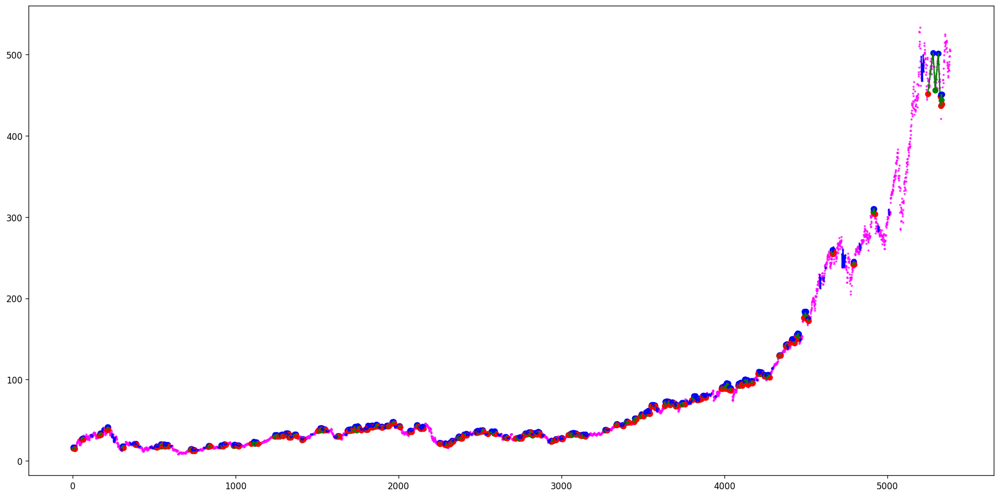

[]
[]
Ticker ADBRF found 0 double top patterns, 0 double bottom patterns


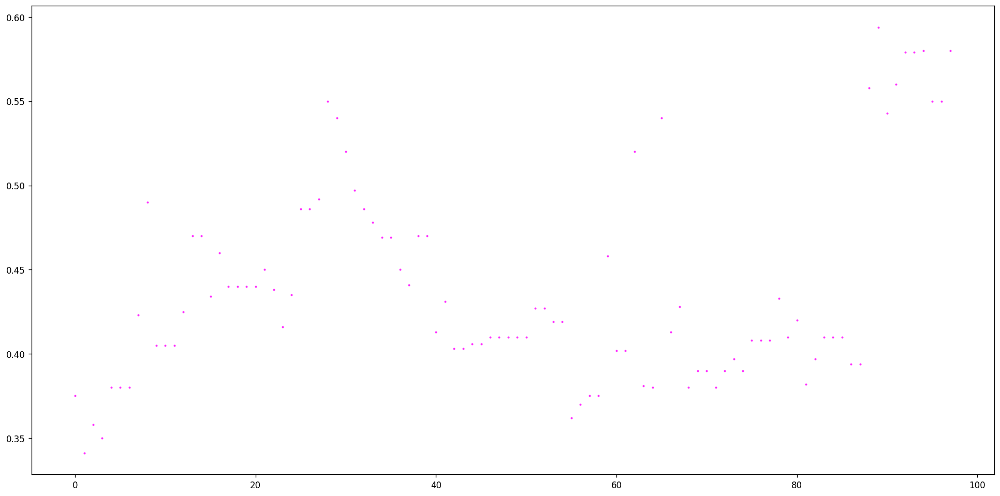

[(16, 27, 34, 37, 49), (16, 30, 34, 37, 49), (16, 37, 49, 58, 62), (16, 37, 49, 59, 62), (119, 122, 128, 133, 146), (128, 133, 137, 142, 146), (128, 134, 137, 142, 146), (128, 135, 137, 142, 146), (173, 175, 176, 180, 186), (173, 175, 176, 185, 186), (216, 223, 225, 238, 246), (216, 223, 225, 240, 246), (216, 223, 225, 242, 246), (216, 223, 225, 244, 246), (295, 305, 307, 310, 316), (308, 310, 311, 313, 316), (294, 313, 317, 323, 326), (356, 363, 364, 366, 381), (356, 363, 364, 368, 381), (439, 443, 451, 460, 482), (439, 443, 451, 464, 482), (605, 620, 621, 628, 631), (860, 862, 864, 869, 875), (860, 862, 864, 872, 875), (989, 991, 996, 1002, 1005), (1179, 1187, 1197, 1202, 1207), (1179, 1191, 1197, 1202, 1207), (1243, 1249, 1252, 1255, 1258), (1265, 1267, 1273, 1279, 1290), (1370, 1373, 1389, 1399, 1406), (1370, 1386, 1389, 1393, 1406), (1370, 1386, 1389, 1399, 1406), (1367, 1403, 1420, 1427, 1436), (1367, 1409, 1415, 1419, 1420), (1367, 1409, 1420, 1424, 1436), (1452, 1454, 1458, 146

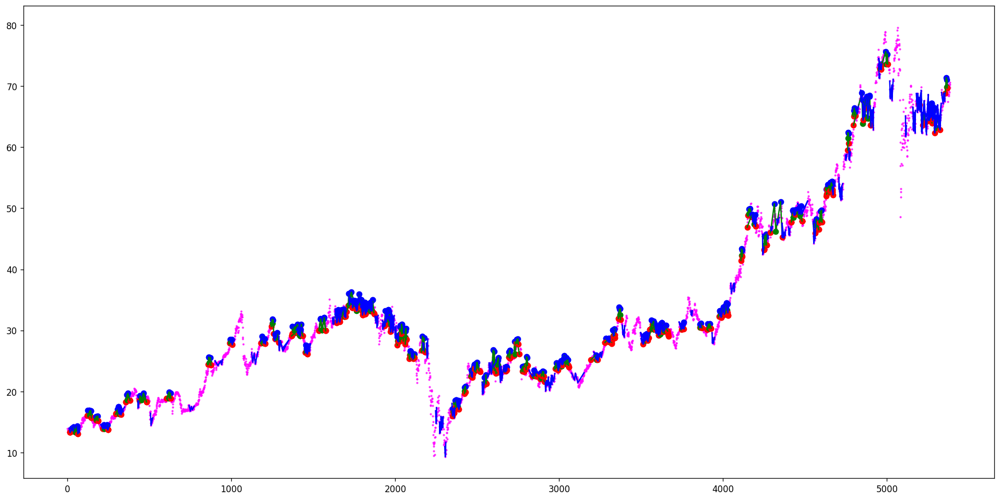

[]
[]
Ticker ADCOF found 0 double top patterns, 0 double bottom patterns


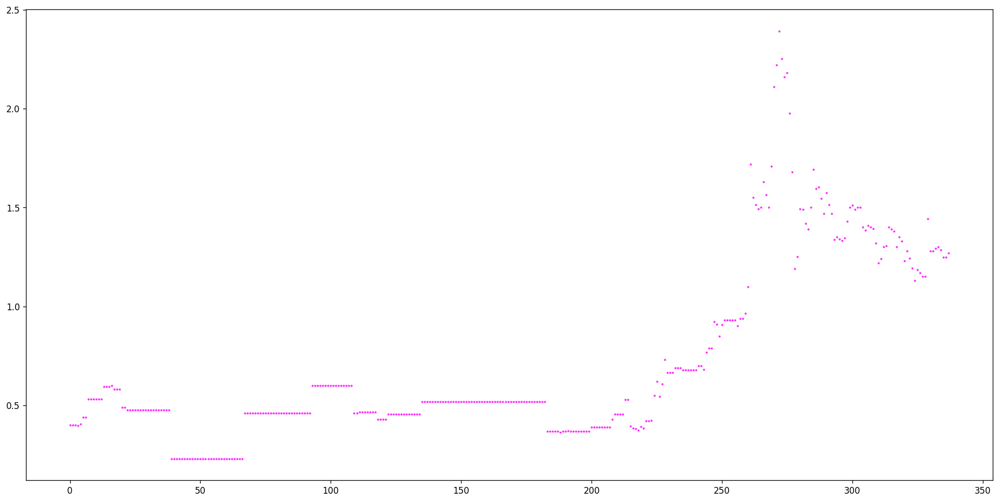

[(40, 42, 45, 46, 52), (67, 69, 71, 72, 74)]
[(42, 45, 46, 52, 54), (177, 178, 179, 180, 181)]
Ticker ADCT found 2 double top patterns, 2 double bottom patterns


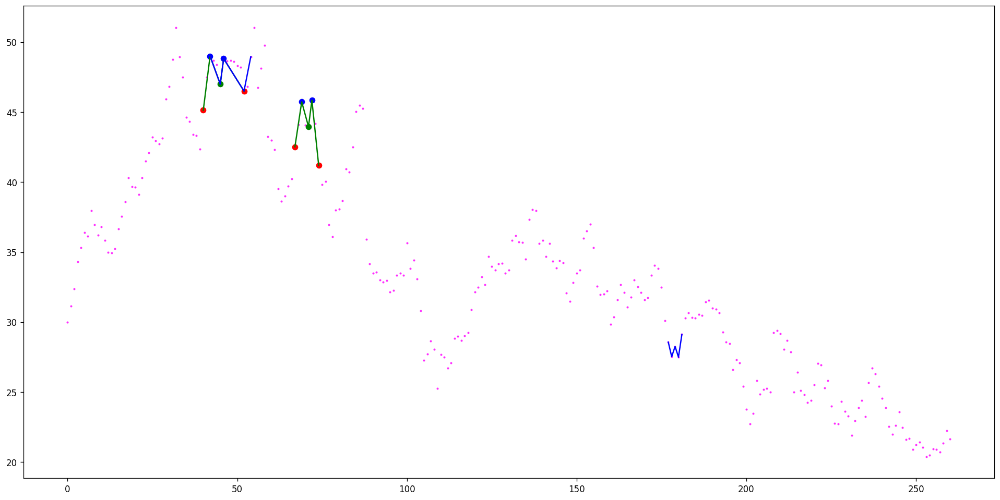

[(1670, 1672, 1673, 1674, 1704), (1670, 1672, 1673, 1703, 1704), (1918, 1925, 1970, 1992, 1993), (1918, 1926, 1970, 1992, 1993)]
[(1672, 1673, 1674, 1704, 1708), (1672, 1673, 1674, 1707, 1708)]
Ticker ADDC found 4 double top patterns, 2 double bottom patterns


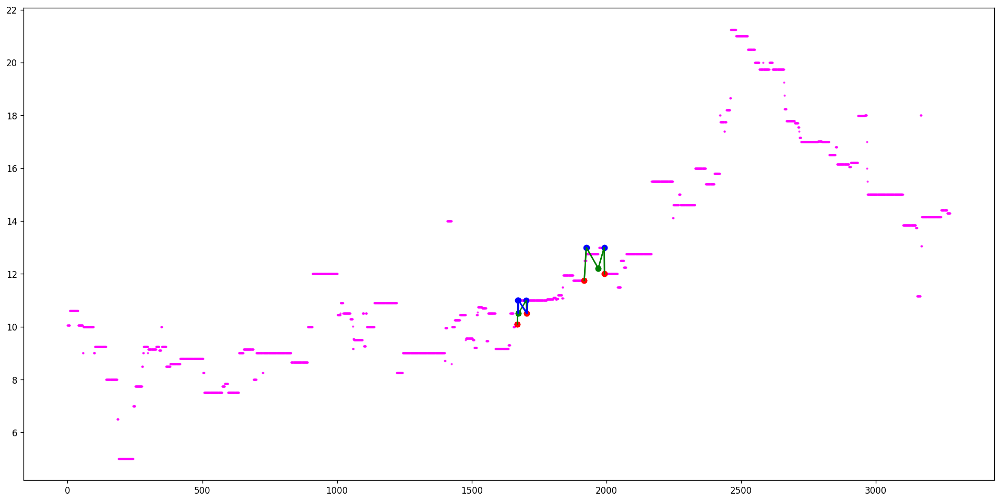

[(196, 199, 201, 204, 208), (196, 200, 201, 204, 208), (183, 204, 217, 226, 242), (183, 205, 217, 226, 242), (217, 220, 221, 222, 241), (223, 226, 230, 231, 237), (361, 366, 371, 374, 378), (361, 370, 371, 374, 378), (728, 735, 736, 739, 743), (728, 735, 736, 740, 743), (751, 763, 766, 775, 778), (751, 765, 766, 775, 778), (831, 843, 853, 858, 859), (831, 845, 853, 858, 859), (835, 848, 849, 851, 853), (835, 848, 849, 852, 853), (831, 848, 853, 854, 859), (831, 848, 853, 857, 859), (831, 851, 853, 854, 859), (831, 852, 853, 854, 859), (965, 968, 969, 971, 974), (986, 1002, 1004, 1006, 1009), (1049, 1061, 1069, 1085, 1111), (1049, 1061, 1069, 1088, 1111), (1049, 1062, 1069, 1085, 1111), (1049, 1066, 1069, 1081, 1111), (1049, 1066, 1069, 1085, 1111), (1074, 1077, 1078, 1079, 1092), (1080, 1081, 1082, 1085, 1089), (1148, 1149, 1150, 1153, 1155), (1144, 1149, 1169, 1173, 1184), (1144, 1153, 1169, 1173, 1184), (1277, 1281, 1286, 1289, 1296), (1277, 1281, 1286, 1295, 1296), (1323, 1325, 1326

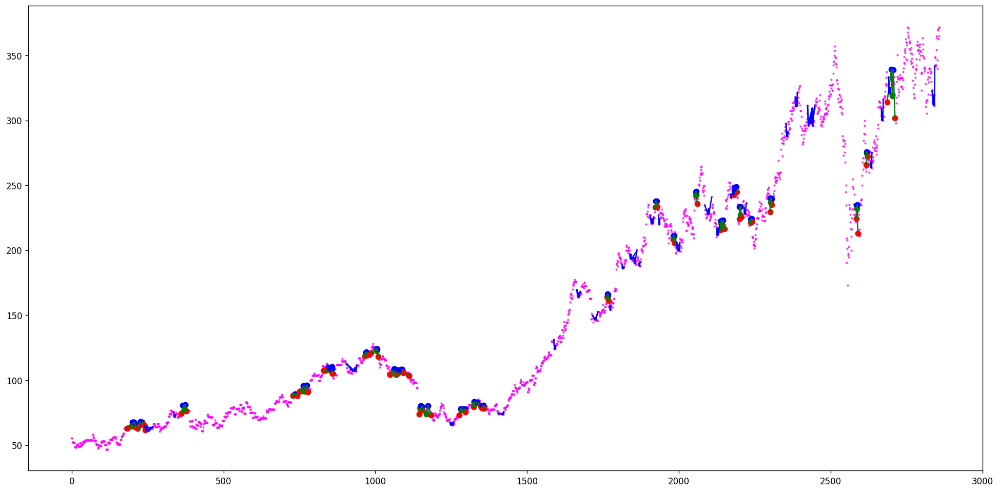

[]
[]
Ticker ADDXF found 0 double top patterns, 0 double bottom patterns


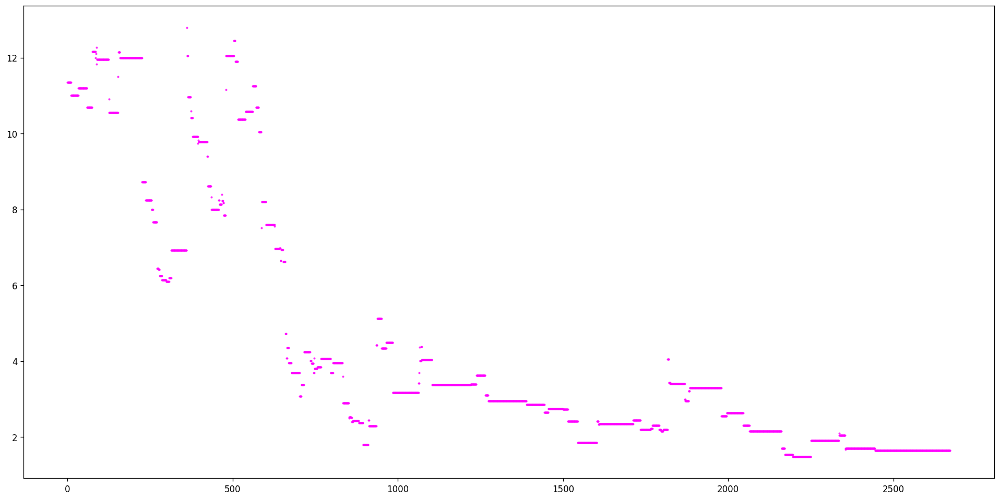

[(36, 37, 38, 39, 45), (132, 137, 140, 146, 151), (119, 146, 154, 160, 163), (119, 148, 154, 160, 163), (119, 149, 154, 160, 163), (119, 150, 154, 160, 163), (171, 174, 176, 178, 180), (168, 185, 186, 187, 189), (237, 240, 242, 243, 244), (237, 240, 247, 248, 259), (237, 243, 247, 248, 259), (271, 276, 278, 280, 283), (341, 343, 346, 349, 351), (418, 419, 420, 421, 423), (414, 419, 424, 437, 453), (431, 432, 434, 437, 440), (427, 442, 445, 448, 451), (455, 461, 469, 472, 484), (471, 472, 473, 475, 481), (639, 642, 647, 655, 659), (667, 670, 672, 678, 683), (760, 763, 770, 773, 780), (760, 763, 770, 774, 780), (760, 763, 770, 777, 780), (800, 803, 806, 813, 821), (829, 831, 846, 851, 858), (829, 832, 836, 840, 841), (829, 832, 846, 851, 858), (878, 883, 903, 906, 916), (878, 883, 903, 910, 916), (878, 887, 903, 906, 916), (978, 981, 984, 987, 988), (978, 982, 984, 987, 988), (1013, 1019, 1021, 1023, 1024), (1033, 1038, 1039, 1041, 1042), (1087, 1090, 1092, 1093, 1094), (1114, 1116, 1118

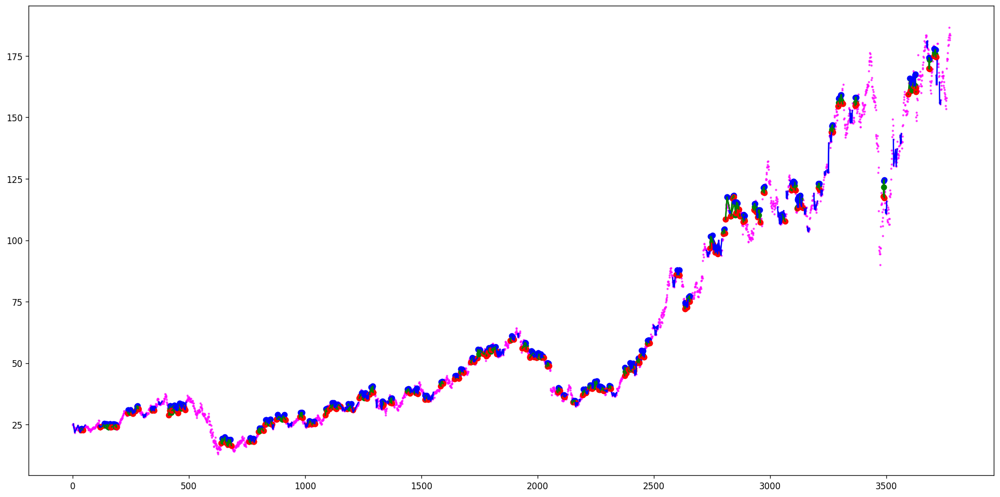

[(240, 242, 243, 246, 248), (416, 428, 439, 441, 445), (416, 428, 439, 442, 445), (546, 549, 554, 556, 557), (703, 705, 707, 711, 728), (813, 817, 820, 827, 831), (1489, 1490, 1494, 1504, 1513), (2147, 2153, 2156, 2172, 2198), (2157, 2159, 2165, 2172, 2194), (2215, 2217, 2219, 2227, 2231), (2426, 2429, 2437, 2439, 2441), (2426, 2434, 2437, 2439, 2441), (2478, 2483, 2486, 2487, 2488), (2491, 2502, 2503, 2504, 2506), (2543, 2544, 2546, 2548, 2551), (2668, 2672, 2676, 2677, 2685), (2687, 2690, 2694, 2696, 2698), (2711, 2721, 2724, 2730, 2733), (2736, 2737, 2738, 2739, 2742), (3717, 3725, 3734, 3740, 3756), (3883, 3889, 3897, 3901, 3909), (3934, 3938, 3944, 3948, 3949), (3982, 3987, 3988, 4000, 4010), (4091, 4094, 4098, 4102, 4103)]
[(260, 264, 271, 273, 280), (846, 849, 852, 863, 865), (2125, 2132, 2135, 2140, 2153), (2138, 2140, 2143, 2147, 2150), (2153, 2156, 2159, 2162, 2170), (2153, 2156, 2159, 2165, 2170), (2229, 2232, 2242, 2249, 2251), (2310, 2314, 2318, 2321, 2327), (2310, 2314, 2

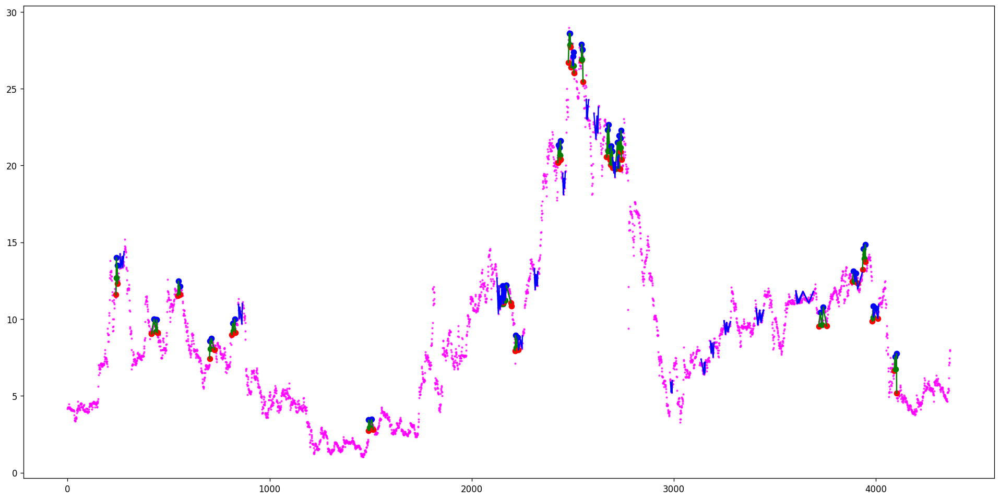

[]
[]
Ticker ADFI found 0 double top patterns, 0 double bottom patterns


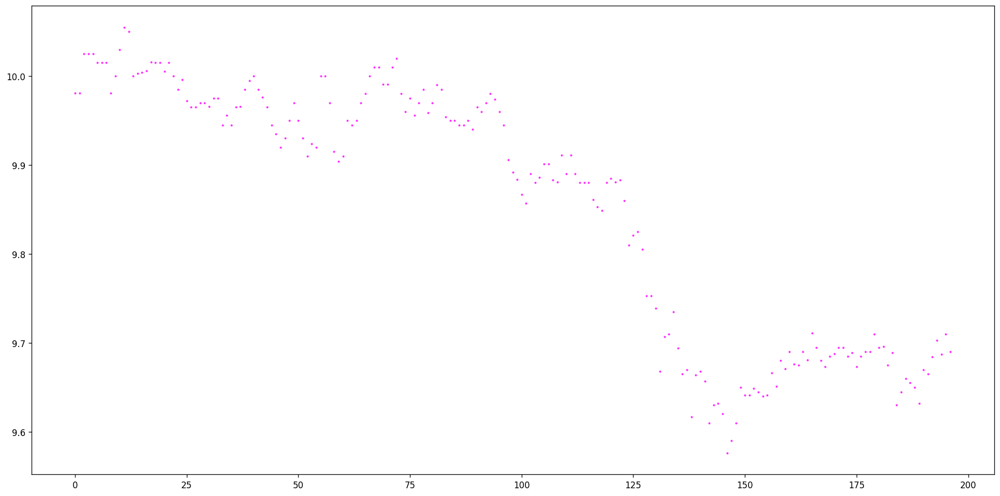

[]
[]
Ticker ADFS found 0 double top patterns, 0 double bottom patterns


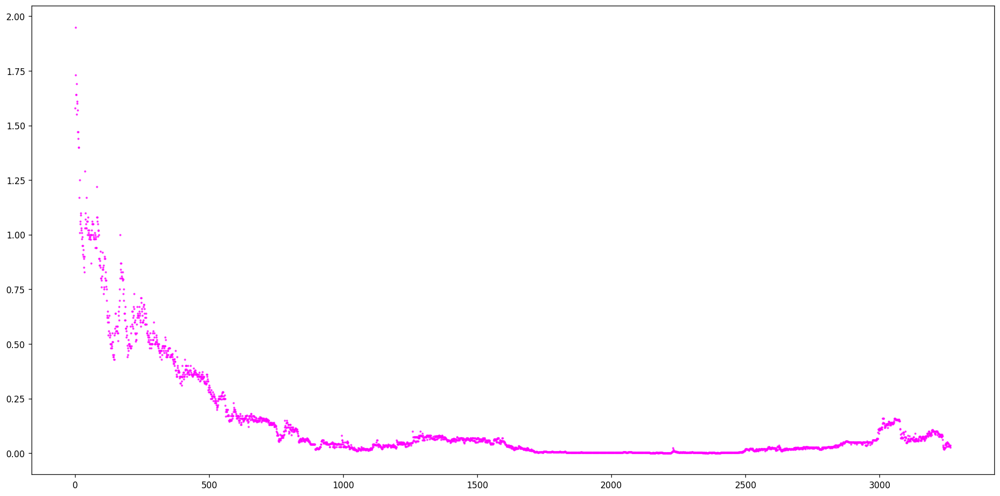

[]
[]
Ticker ADGCF found 0 double top patterns, 0 double bottom patterns


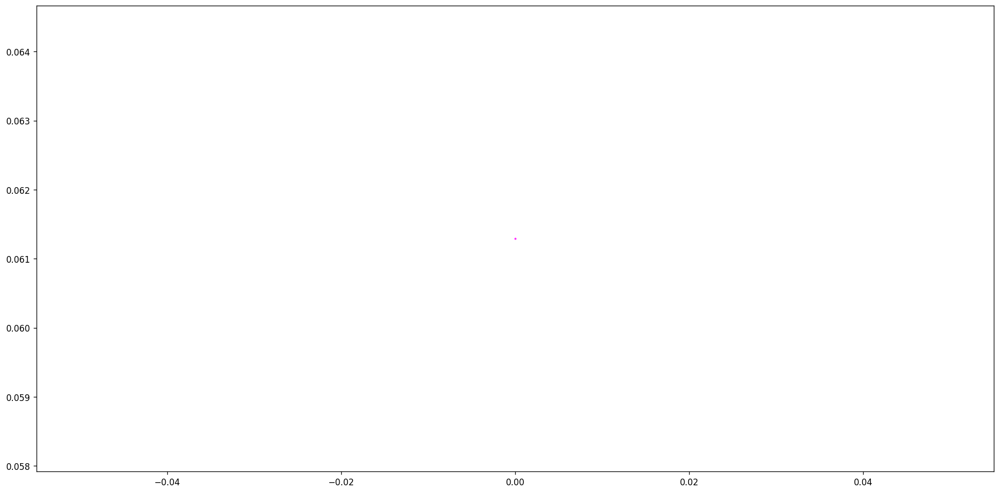

[]
[]
Ticker ADGO found 0 double top patterns, 0 double bottom patterns


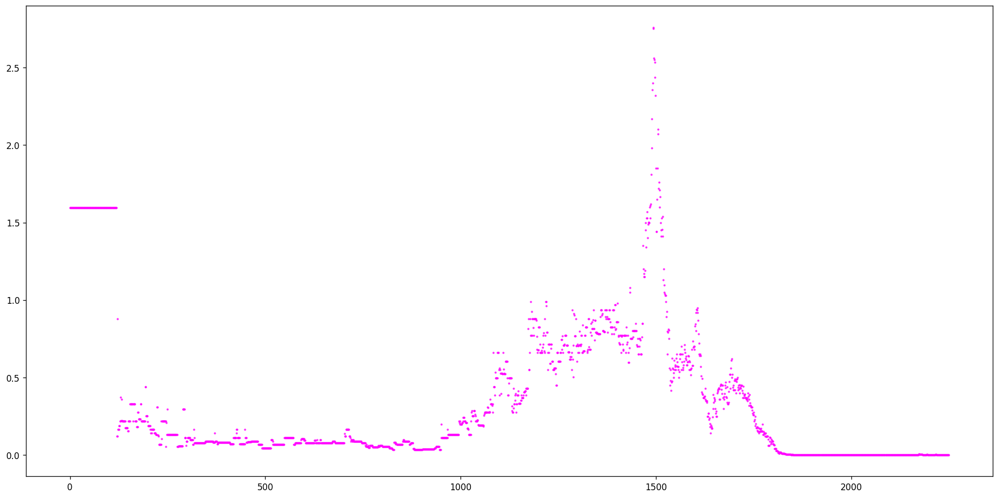

[(69, 70, 71, 72, 73), (142, 143, 147, 151, 152), (242, 244, 245, 248, 249), (449, 451, 453, 456, 457), (457, 458, 459, 461, 462), (521, 522, 523, 524, 525), (530, 531, 532, 537, 538), (543, 544, 548, 551, 552), (543, 544, 548, 553, 554), (549, 550, 552, 553, 554), (558, 559, 562, 569, 570), (586, 587, 588, 589, 590), (635, 636, 637, 639, 640)]
[(194, 195, 196, 197, 198), (206, 207, 209, 210, 211), (206, 207, 215, 217, 220), (308, 310, 312, 317, 318), (319, 320, 321, 323, 324), (456, 457, 458, 459, 461), (456, 457, 458, 460, 461), (529, 530, 531, 533, 534), (529, 530, 531, 538, 539), (531, 532, 534, 538, 539), (542, 543, 544, 574, 576), (547, 548, 550, 552, 553), (556, 557, 559, 563, 564), (556, 557, 559, 574, 575), (561, 562, 564, 574, 575), (633, 634, 636, 637, 638), (633, 634, 636, 641, 642), (636, 637, 638, 641, 642)]
Ticker ADHC found 13 double top patterns, 18 double bottom patterns


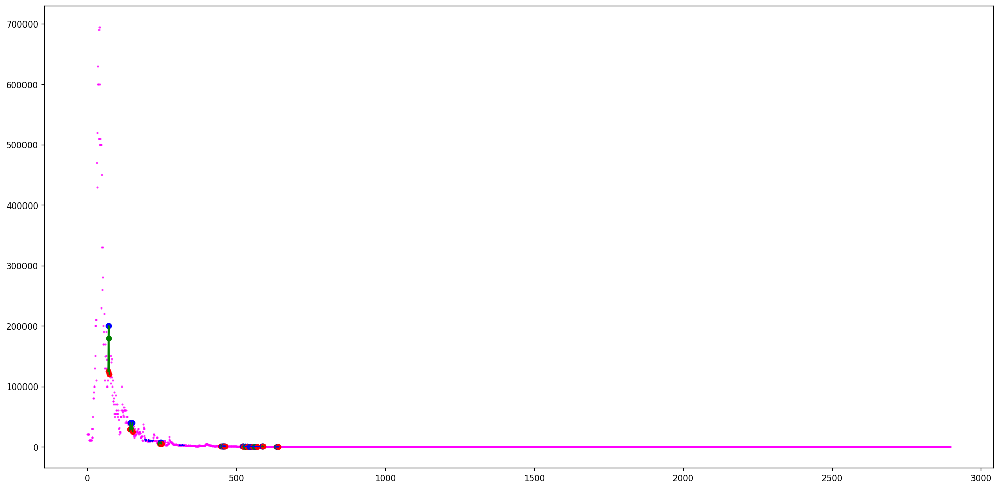

[(8, 9, 10, 11, 13), (108, 110, 111, 112, 113), (299, 300, 301, 302, 303), (299, 302, 303, 304, 305), (408, 409, 410, 411, 412), (480, 483, 493, 502, 510), (513, 517, 518, 520, 524), (526, 527, 530, 531, 532), (656, 658, 659, 661, 664), (682, 684, 687, 689, 691), (723, 725, 726, 727, 728), (723, 727, 728, 729, 733), (736, 737, 740, 741, 743), (831, 832, 833, 837, 839), (839, 841, 843, 844, 846), (928, 929, 930, 932, 933), (928, 932, 933, 934, 935), (962, 970, 974, 979, 993), (1029, 1035, 1038, 1043, 1049), (1092, 1093, 1095, 1096, 1097), (1205, 1206, 1207, 1210, 1220), (1205, 1206, 1207, 1213, 1220), (1222, 1223, 1224, 1226, 1227), (1278, 1281, 1283, 1284, 1288), (1291, 1293, 1294, 1295, 1305), (1294, 1295, 1301, 1302, 1305), (1314, 1315, 1319, 1321, 1324), (1363, 1365, 1368, 1370, 1377), (1363, 1365, 1368, 1375, 1377), (1369, 1370, 1373, 1375, 1377), (1385, 1389, 1391, 1393, 1398), (1383, 1397, 1401, 1402, 1403), (1522, 1537, 1538, 1539, 1540), (1521, 1539, 1541, 1547, 1551), (1508, 1

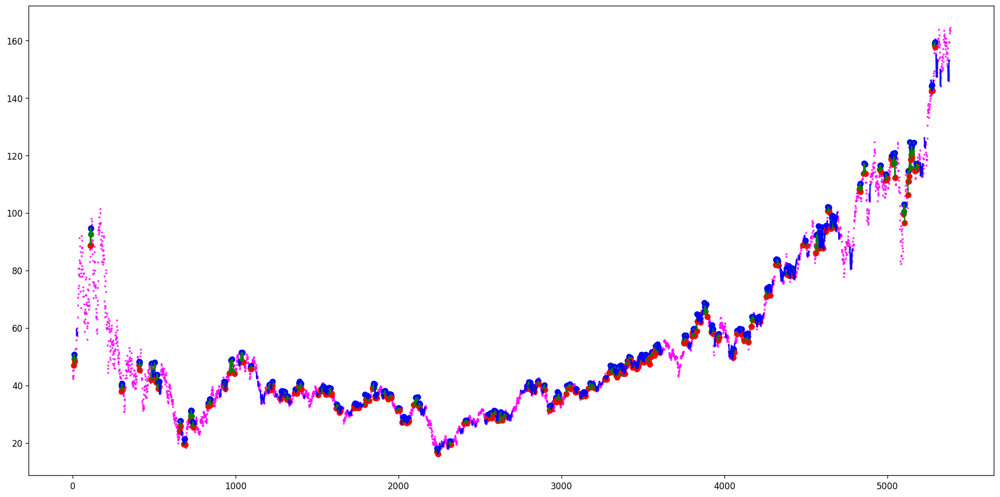

[]
[(97, 98, 100, 101, 102)]
Ticker ADIL found 0 double top patterns, 1 double bottom patterns


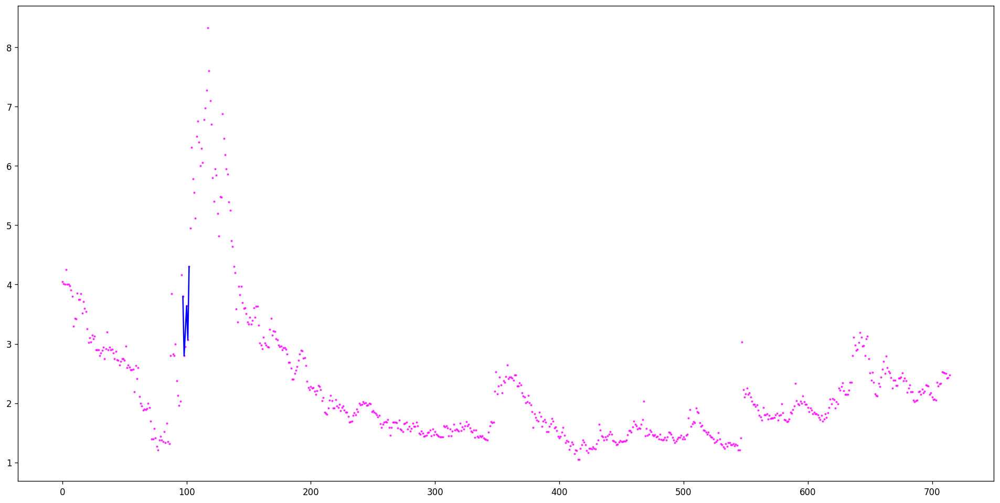

[(1367, 1368, 1419, 1472, 1482), (1367, 1368, 1419, 1479, 1482), (1367, 1368, 1482, 1603, 1608), (1367, 1405, 1419, 1472, 1482), (1367, 1405, 1419, 1479, 1482), (1367, 1405, 1482, 1603, 1608), (1367, 1472, 1482, 1603, 1608), (1367, 1479, 1482, 1603, 1608)]
[(2414, 2423, 2431, 2510, 2511), (2414, 2424, 2431, 2510, 2511)]
Ticker ADKT found 8 double top patterns, 2 double bottom patterns


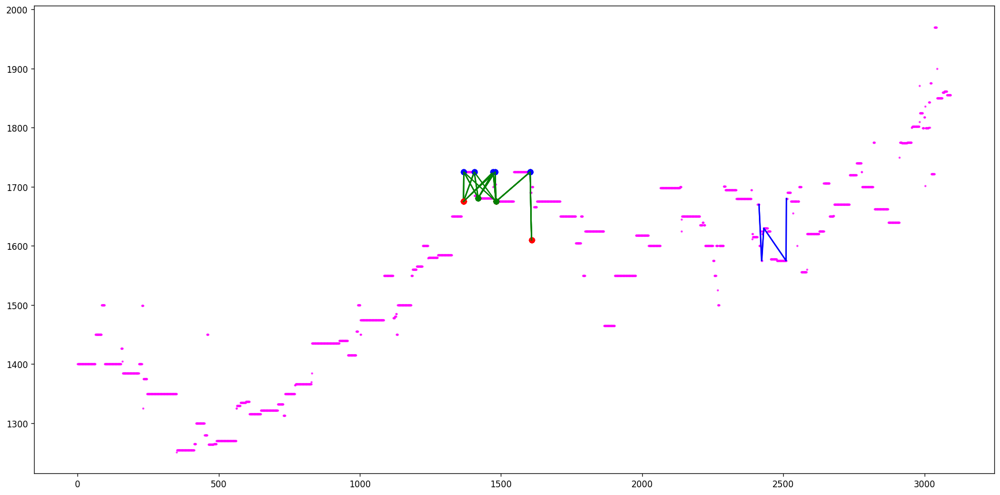

[(247, 251, 255, 262, 264), (273, 275, 276, 278, 283), (270, 280, 283, 285, 300), (270, 280, 283, 287, 300), (283, 287, 288, 289, 299), (353, 364, 376, 385, 394), (353, 375, 376, 379, 394), (353, 375, 376, 385, 394), (562, 567, 572, 576, 578), (1051, 1055, 1059, 1063, 1137), (1061, 1072, 1075, 1081, 1092), (1061, 1086, 1092, 1094, 1100), (1366, 1374, 1379, 1381, 1384), (1441, 1446, 1452, 1457, 1458), (1441, 1449, 1452, 1455, 1458), (1441, 1449, 1452, 1456, 1458), (1441, 1449, 1452, 1457, 1458), (1463, 1466, 1471, 1474, 1486), (1463, 1466, 1471, 1478, 1486), (1463, 1483, 1486, 1487, 1489), (1575, 1577, 1579, 1581, 1587), (1665, 1670, 1675, 1677, 1678), (1665, 1671, 1675, 1677, 1678), (1682, 1689, 1691, 1692, 1697), (1705, 1706, 1708, 1709, 1711), (1722, 1724, 1726, 1727, 1730), (1778, 1779, 1785, 1790, 1800), (1823, 1825, 1826, 1829, 1832), (1889, 1891, 1894, 1897, 1899), (1953, 1955, 1957, 1959, 1963), (1971, 1974, 1976, 1978, 1983), (1976, 1978, 1979, 1980, 1981), (2046, 2049, 2050, 2

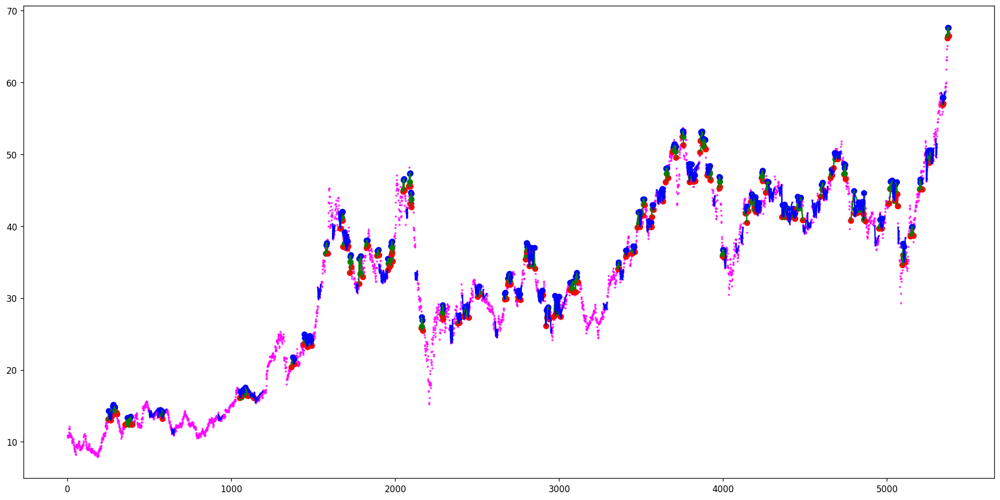

[(36, 37, 39, 41, 46), (73, 92, 97, 98, 108), (73, 92, 97, 101, 108), (73, 96, 97, 98, 108), (73, 96, 97, 101, 108), (286, 294, 296, 297, 330), (357, 359, 362, 364, 371), (425, 436, 446, 450, 472), (448, 450, 457, 461, 472), (772, 774, 782, 784, 786)]
[(451, 457, 461, 474, 479), (712, 720, 728, 731, 734)]
Ticker ADMA found 10 double top patterns, 2 double bottom patterns


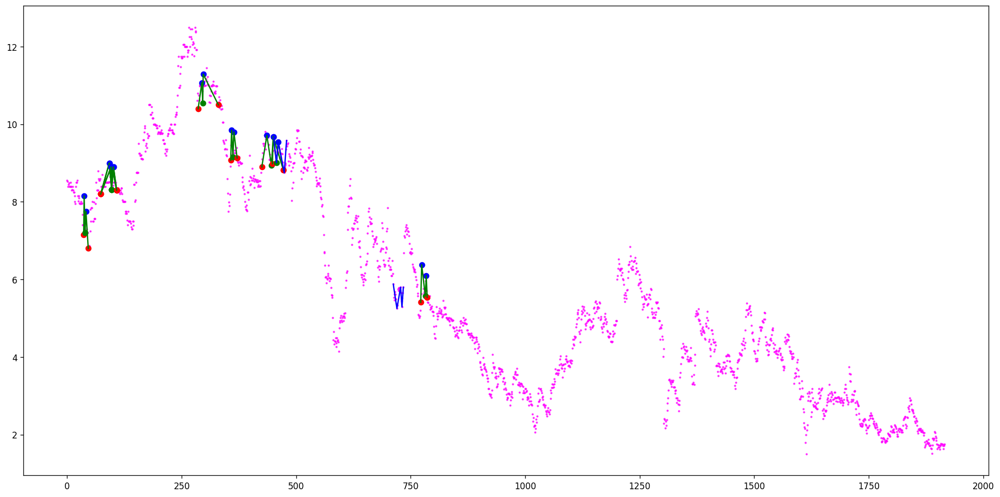

[(125, 126, 127, 128, 129), (125, 126, 127, 130, 131), (125, 126, 133, 135, 136), (127, 128, 129, 130, 131), (136, 140, 142, 143, 159), (136, 140, 142, 145, 159), (136, 140, 142, 146, 159), (142, 143, 144, 145, 147), (142, 143, 144, 146, 147), (151, 152, 153, 155, 159), (185, 187, 189, 190, 191), (185, 188, 189, 190, 191), (193, 194, 195, 196, 197), (288, 289, 290, 292, 294), (288, 289, 290, 293, 294), (405, 406, 408, 409, 410), (405, 407, 408, 409, 410), (934, 936, 937, 939, 940), (1186, 1187, 1188, 1190, 1193), (1186, 1187, 1188, 1192, 1193), (1189, 1190, 1191, 1192, 1193), (1300, 1307, 1308, 1313, 1314), (1389, 1390, 1391, 1392, 1393), (1425, 1432, 1435, 1436, 1441), (1572, 1573, 1574, 1576, 1577), (1621, 1622, 1623, 1624, 1625), (1698, 1699, 1702, 1703, 1704), (1719, 1720, 1721, 1726, 1727), (1760, 1761, 1763, 1765, 1766), (1766, 1767, 1768, 1774, 1775), (1811, 1812, 1813, 1819, 1820), (1811, 1812, 1813, 1822, 1823), (1818, 1819, 1820, 1822, 1823), (1837, 1838, 1839, 1842, 1843), (

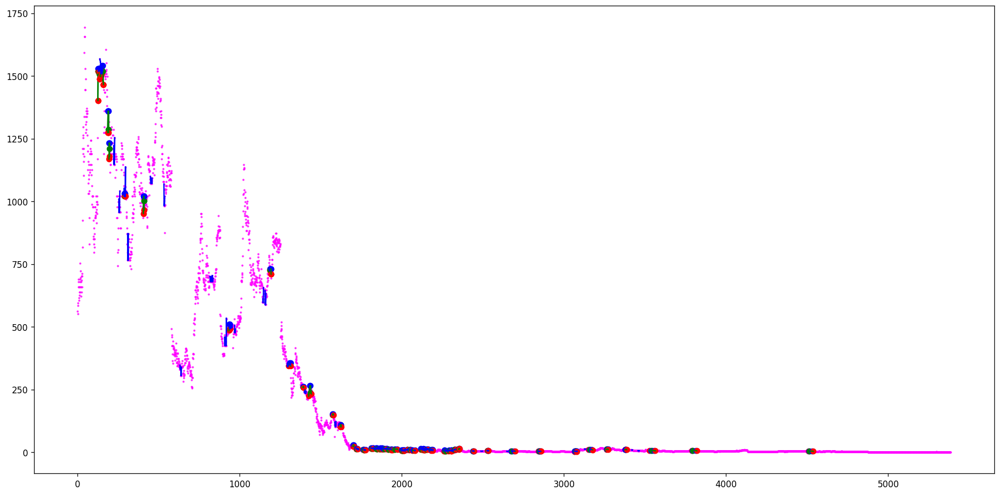

[(92, 93, 95, 97, 99)]
[]
Ticker ADN found 1 double top patterns, 0 double bottom patterns


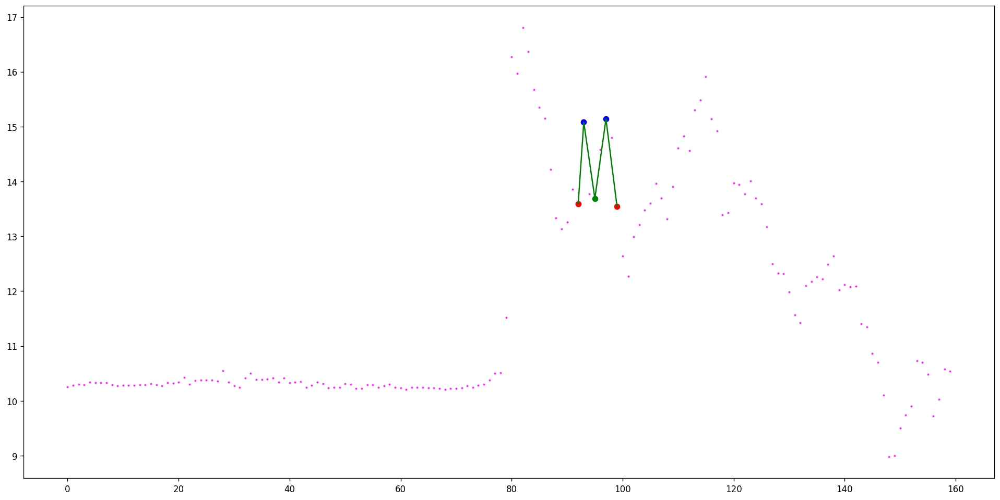

[(64, 69, 72, 74, 75), (110, 111, 112, 114, 115), (117, 121, 122, 124, 125), (184, 185, 186, 187, 191), (236, 237, 250, 253, 258), (236, 237, 250, 257, 258), (236, 242, 250, 253, 258), (236, 245, 246, 248, 250), (285, 286, 287, 288, 293), (293, 302, 303, 304, 305), (305, 307, 310, 311, 314), (331, 332, 333, 334, 336), (331, 332, 336, 341, 344), (331, 334, 336, 337, 344), (331, 334, 336, 341, 344), (346, 347, 348, 350, 351), (371, 373, 374, 375, 376), (419, 423, 430, 432, 436), (528, 531, 532, 536, 537), (587, 588, 589, 591, 593), (738, 739, 740, 742, 744), (781, 784, 785, 786, 787), (813, 817, 819, 820, 822), (834, 835, 837, 840, 841), (939, 941, 944, 949, 952), (974, 976, 979, 983, 987), (1039, 1044, 1060, 1066, 1075), (1061, 1064, 1065, 1066, 1067)]
[(5, 6, 9, 14, 16), (5, 14, 16, 17, 19), (116, 117, 121, 122, 126), (116, 117, 121, 125, 126), (121, 122, 124, 125, 126), (196, 198, 203, 205, 207), (196, 200, 203, 205, 207), (237, 240, 242, 244, 253), (237, 240, 242, 246, 253), (245, 24

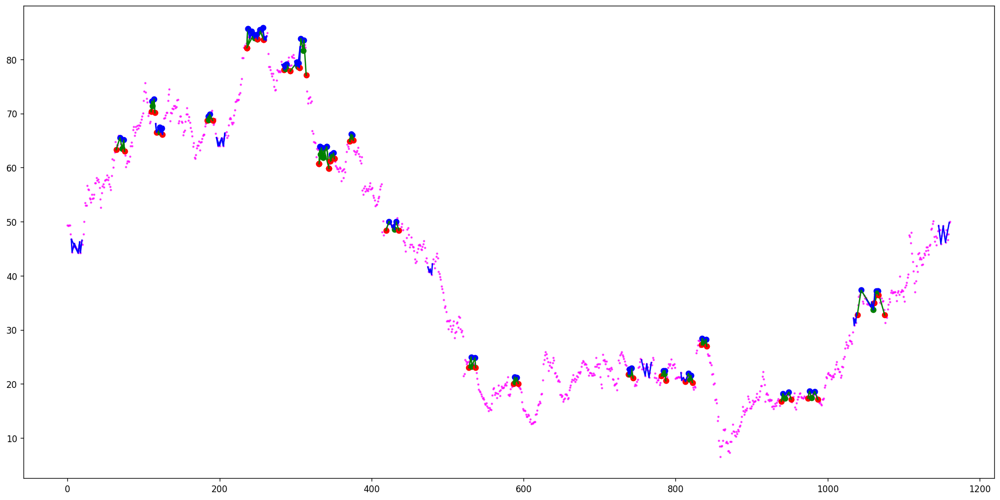

[(37, 38, 39, 40, 41), (76, 77, 79, 80, 83), (76, 78, 79, 80, 83), (194, 195, 196, 197, 198), (208, 209, 211, 212, 213), (265, 267, 269, 270, 274), (275, 278, 280, 281, 283), (308, 310, 312, 314, 315), (316, 317, 318, 319, 321), (344, 348, 355, 358, 364), (365, 368, 371, 373, 374), (365, 370, 371, 373, 374), (383, 384, 386, 387, 391), (383, 384, 386, 389, 391), (470, 471, 473, 475, 477), (482, 484, 485, 487, 488), (481, 484, 489, 494, 503), (481, 484, 489, 498, 503), (481, 487, 489, 490, 503), (481, 487, 489, 494, 503), (492, 494, 495, 498, 499), (518, 520, 522, 527, 532), (540, 545, 556, 559, 562), (540, 547, 549, 551, 556), (540, 547, 556, 559, 562), (649, 663, 668, 672, 679), (703, 704, 705, 706, 708), (701, 706, 708, 709, 736), (708, 712, 717, 721, 735), (708, 712, 717, 725, 735), (719, 721, 723, 725, 727), (717, 725, 728, 731, 735), (728, 731, 732, 733, 734), (751, 754, 756, 757, 759), (853, 855, 864, 867, 872), (853, 859, 864, 867, 872), (1029, 1031, 1033, 1034, 1036), (1016, 103

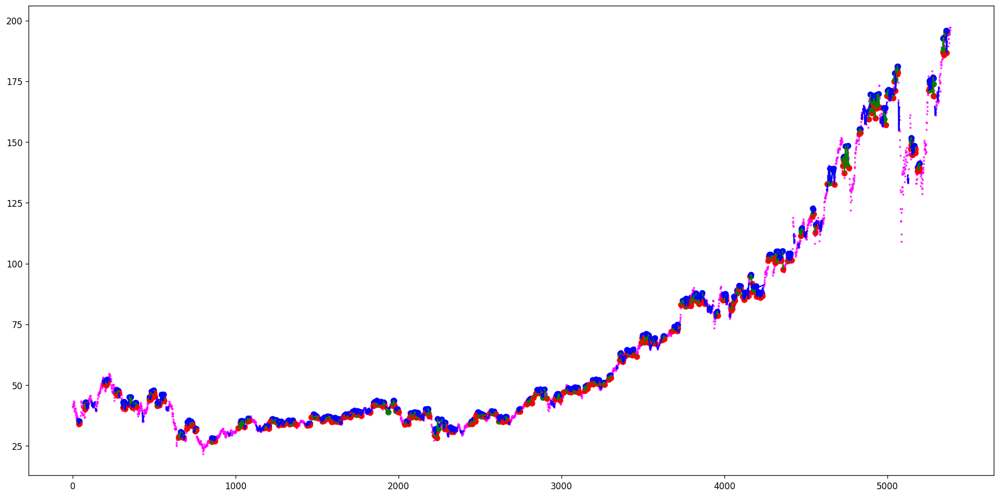

[(9, 10, 11, 12, 13), (98, 100, 103, 105, 107), (128, 129, 130, 135, 138), (189, 193, 194, 195, 196), (253, 254, 258, 259, 261), (443, 446, 447, 448, 449)]
[(10, 11, 12, 14, 16), (49, 50, 52, 53, 54), (63, 64, 65, 67, 68), (90, 93, 100, 110, 116), (125, 128, 129, 130, 134), (228, 232, 235, 237, 239), (228, 234, 235, 237, 239), (267, 271, 278, 283, 287), (268, 273, 274, 276, 277), (350, 352, 353, 354, 361), (353, 354, 355, 357, 359), (446, 447, 448, 450, 451)]
Ticker ADPT found 6 double top patterns, 12 double bottom patterns


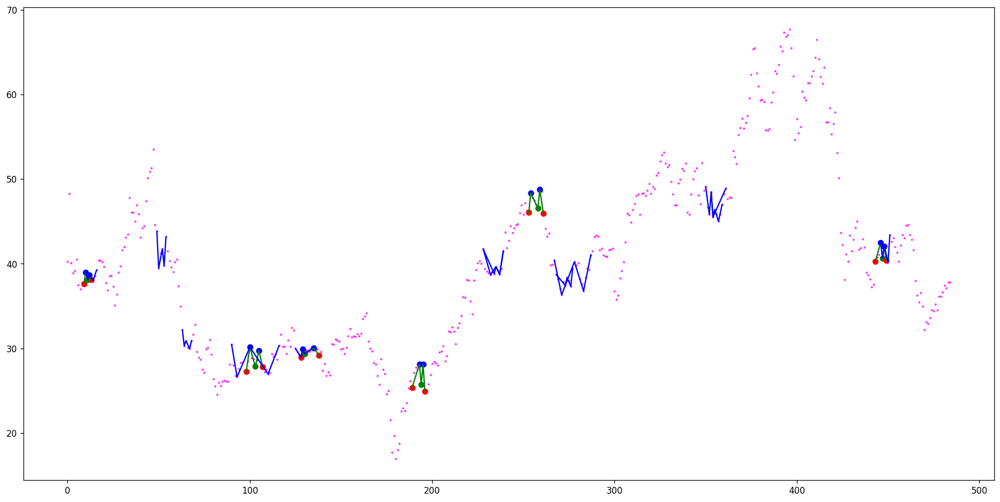

[(111, 113, 114, 116, 127), (184, 195, 201, 202, 203), (311, 315, 326, 333, 343), (311, 322, 326, 331, 343), (311, 322, 326, 333, 343), (326, 333, 336, 337, 339), (309, 333, 343, 348, 350), (309, 337, 343, 344, 350), (309, 337, 343, 348, 350), (309, 341, 343, 344, 350), (343, 344, 346, 348, 350), (359, 365, 370, 373, 395), (371, 373, 375, 377, 381), (371, 377, 382, 383, 386), (371, 377, 382, 384, 386), (438, 440, 442, 445, 446), (430, 440, 449, 478, 488), (470, 474, 476, 478, 485), (569, 574, 580, 581, 583), (656, 658, 659, 661, 665), (659, 661, 662, 664, 665), (683, 685, 687, 688, 691), (697, 698, 700, 702, 704), (728, 731, 732, 733, 734), (1030, 1036, 1041, 1047, 1051), (1581, 1595, 1606, 1612, 1616), (1865, 1866, 1869, 1873, 1882), (1869, 1873, 1882, 1891, 1906), (2080, 2083, 2089, 2117, 2122), (2080, 2086, 2089, 2117, 2122), (2092, 2096, 2098, 2104, 2112), (2092, 2097, 2098, 2104, 2112), (2090, 2104, 2112, 2117, 2121), (2090, 2107, 2112, 2117, 2121), (2136, 2140, 2144, 2146, 2149),

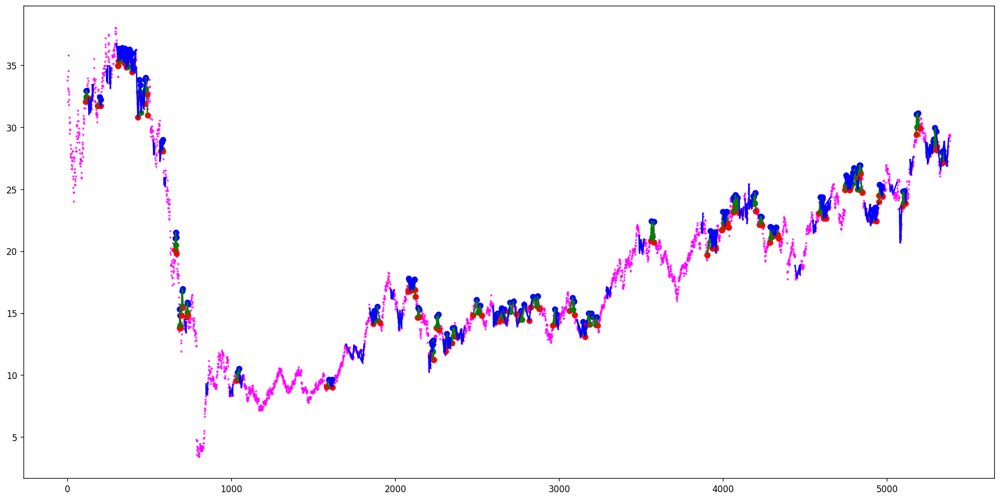

[(102, 105, 106, 109, 114), (147, 150, 152, 153, 154), (147, 151, 152, 153, 154), (176, 177, 178, 180, 182), (190, 194, 198, 200, 207), (190, 194, 198, 204, 207), (331, 332, 333, 334, 335), (416, 417, 419, 420, 422), (416, 420, 422, 424, 431), (439, 440, 444, 448, 452), (471, 474, 476, 479, 481), (490, 492, 494, 497, 507), (516, 521, 524, 527, 537), (524, 527, 531, 532, 535), (516, 527, 538, 546, 571), (524, 529, 531, 532, 535), (548, 552, 556, 558, 563), (727, 729, 731, 732, 733), (727, 730, 731, 732, 733), (835, 837, 838, 839, 840), (938, 939, 940, 941, 957), (1023, 1025, 1027, 1029, 1034), (1017, 1038, 1046, 1057, 1059), (1088, 1089, 1090, 1091, 1092), (1116, 1117, 1119, 1120, 1122), (1186, 1191, 1195, 1198, 1204), (1186, 1191, 1195, 1201, 1204), (1186, 1191, 1195, 1203, 1204), (1284, 1285, 1287, 1289, 1292), (1331, 1333, 1334, 1335, 1337), (1342, 1344, 1345, 1346, 1347), (1361, 1364, 1365, 1366, 1369), (1360, 1364, 1370, 1373, 1388), (1360, 1366, 1370, 1373, 1388), (1455, 1458, 146

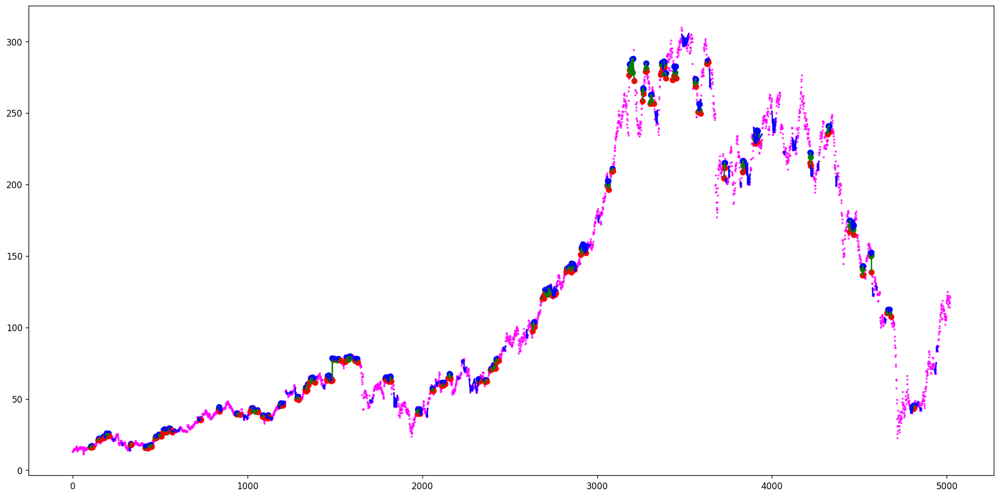

[(72, 75, 77, 78, 79), (72, 75, 79, 82, 84), (91, 93, 101, 105, 113), (324, 326, 328, 346, 347), (333, 340, 343, 346, 347), (537, 541, 543, 559, 562), (807, 817, 823, 842, 850), (1087, 1091, 1092, 1093, 1097), (1087, 1091, 1092, 1095, 1097), (1247, 1248, 1251, 1252, 1256), (1288, 1290, 1291, 1293, 1313), (1291, 1293, 1297, 1301, 1312), (1466, 1467, 1468, 1473, 1476), (1465, 1473, 1477, 1478, 1479), (1533, 1535, 1537, 1539, 1540), (1605, 1608, 1610, 1611, 1613), (1651, 1652, 1654, 1655, 1658), (1662, 1665, 1670, 1675, 1678), (1685, 1688, 1690, 1691, 1692), (1711, 1714, 1715, 1716, 1719), (1737, 1744, 1746, 1749, 1750), (1762, 1768, 1776, 1781, 1785), (1853, 1855, 1857, 1861, 1865), (1868, 1870, 1872, 1876, 1887), (1868, 1881, 1888, 1895, 1896), (1936, 1938, 1941, 1943, 1958), (1948, 1951, 1954, 1955, 1956), (1948, 1952, 1954, 1955, 1956), (1967, 1968, 1969, 1970, 1974), (2024, 2025, 2028, 2031, 2033), (2092, 2094, 2095, 2096, 2097), (2097, 2103, 2109, 2113, 2121), (2111, 2113, 2114, 211

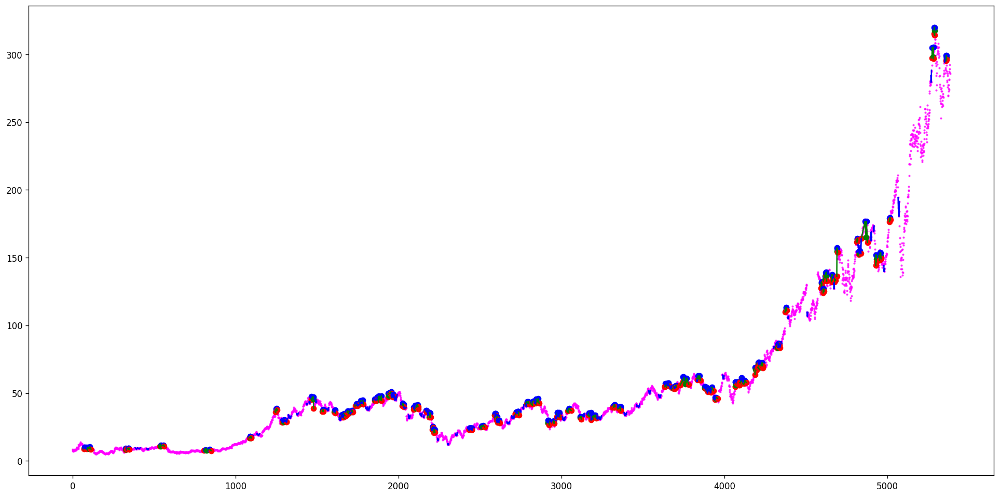

[(119, 124, 135, 139, 140), (119, 127, 135, 139, 140), (203, 204, 206, 210, 212), (465, 467, 471, 476, 478)]
[]
Ticker ADT found 4 double top patterns, 0 double bottom patterns


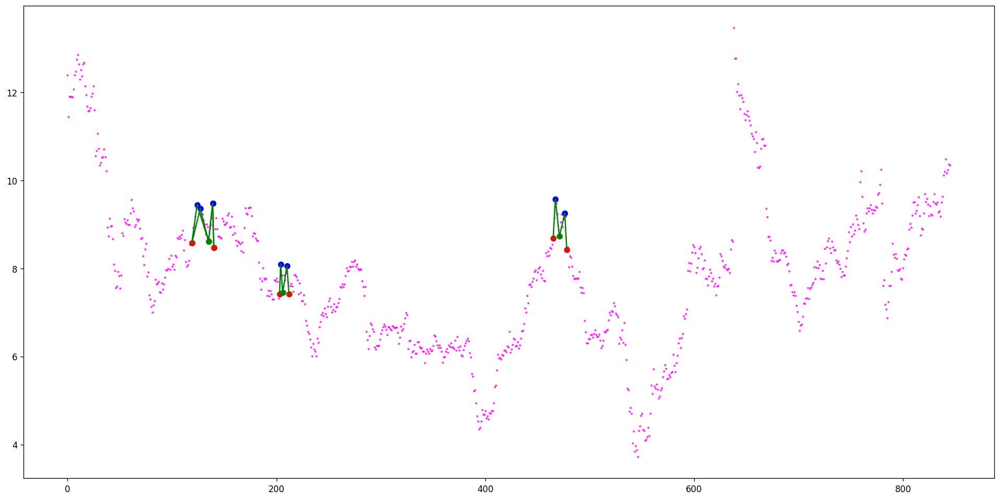

[(289, 290, 298, 339, 340), (347, 348, 351, 364, 365), (347, 348, 365, 378, 379), (347, 348, 379, 381, 382), (347, 348, 379, 385, 386), (379, 380, 382, 385, 386), (394, 395, 397, 402, 403), (497, 498, 500, 502, 503), (578, 579, 580, 582, 584), (653, 654, 660, 663, 665), (1009, 1010, 1013, 1014, 1017)]
[(288, 289, 290, 298, 299), (364, 365, 366, 379, 380), (378, 379, 380, 382, 383), (385, 386, 387, 394, 395), (412, 413, 414, 422, 423), (484, 485, 486, 489, 490), (488, 489, 490, 491, 492), (524, 525, 527, 528, 529)]
Ticker ADTM found 11 double top patterns, 8 double bottom patterns


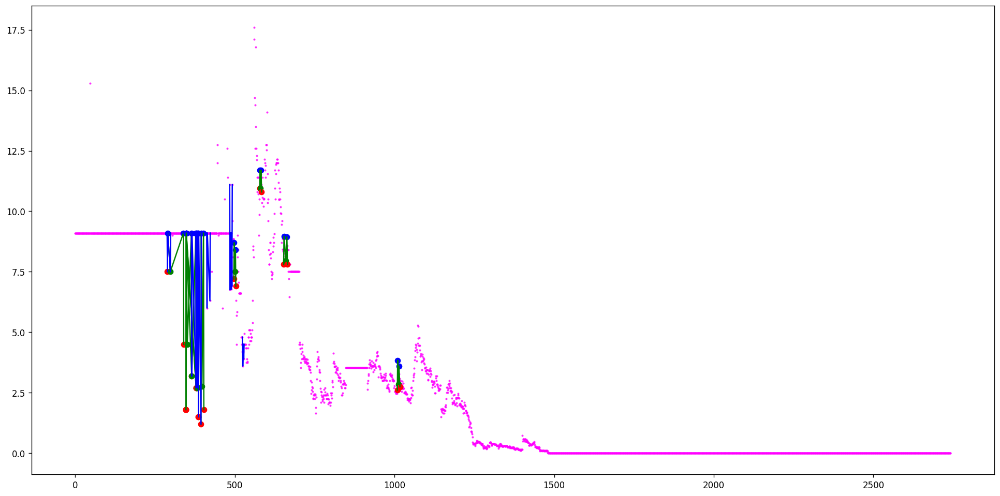

[(89, 90, 91, 92, 97), (104, 106, 107, 109, 110), (167, 169, 171, 172, 174), (202, 203, 206, 207, 208), (219, 221, 224, 227, 229), (262, 263, 266, 267, 268), (292, 295, 301, 304, 308), (292, 295, 301, 310, 312), (301, 304, 308, 310, 312), (321, 327, 329, 333, 342), (321, 327, 329, 335, 342), (329, 335, 336, 337, 341), (355, 358, 359, 360, 361), (448, 450, 452, 454, 457), (473, 475, 477, 478, 479), (467, 478, 480, 482, 499), (632, 634, 642, 643, 648), (861, 863, 865, 867, 869), (878, 880, 882, 884, 885), (920, 921, 922, 923, 924), (928, 929, 930, 932, 934), (941, 943, 945, 947, 949), (940, 943, 1000, 1014, 1037), (1051, 1052, 1053, 1055, 1058), (1062, 1064, 1065, 1067, 1069), (1109, 1111, 1115, 1116, 1117), (1109, 1114, 1115, 1116, 1117), (1123, 1124, 1125, 1127, 1130), (1167, 1172, 1173, 1177, 1181), (1221, 1225, 1233, 1235, 1239), (1283, 1285, 1291, 1293, 1300), (1283, 1285, 1291, 1296, 1300), (1329, 1331, 1332, 1334, 1336), (1456, 1461, 1463, 1475, 1476), (1463, 1467, 1471, 1475, 147

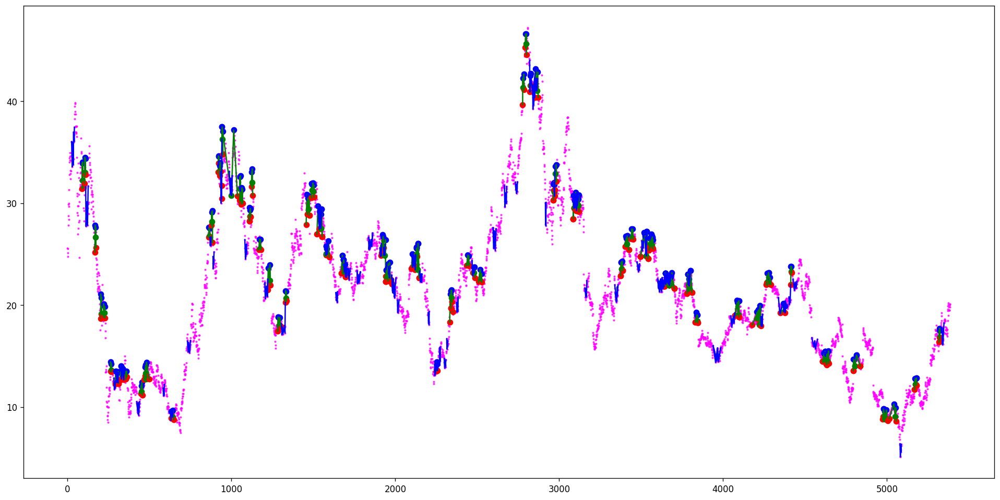

[]
[]
Ticker ADTX found 0 double top patterns, 0 double bottom patterns


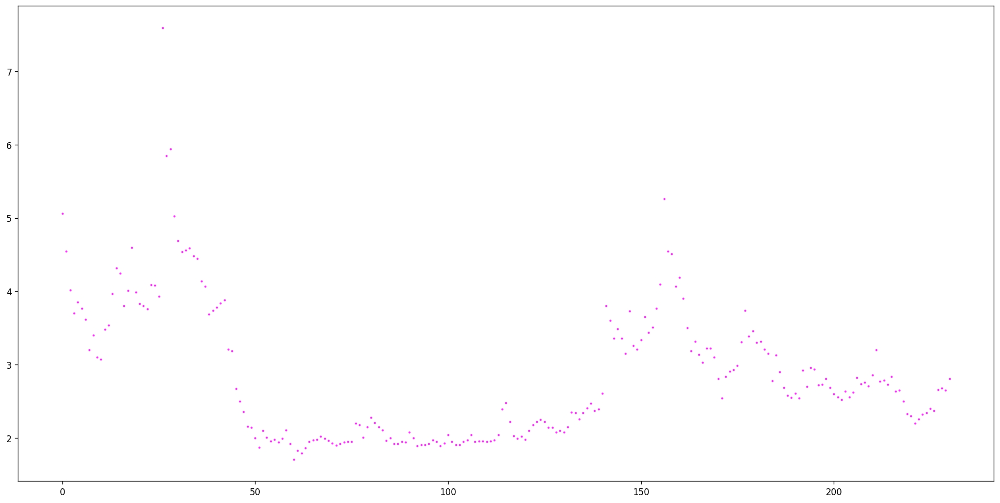

[]
[]
Ticker ADV found 0 double top patterns, 0 double bottom patterns


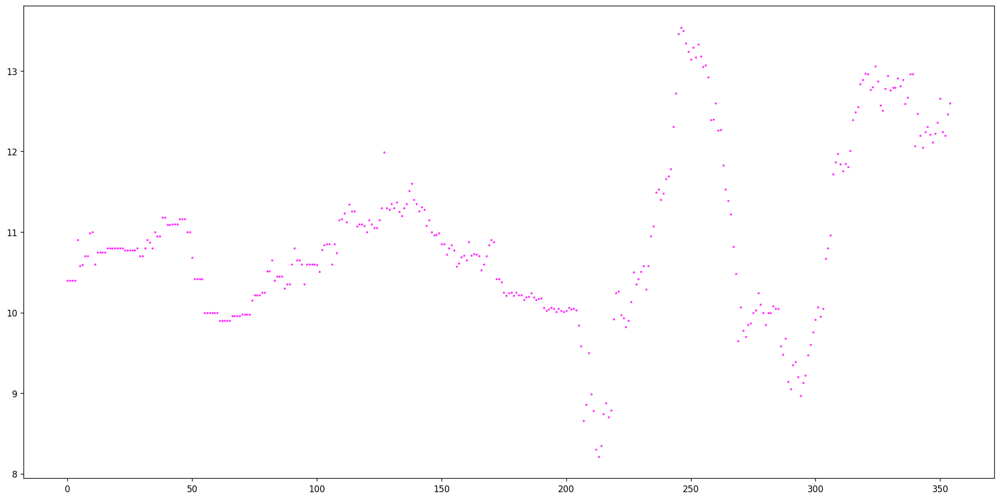

[(93, 95, 98, 100, 101), (171, 172, 173, 174, 175), (262, 264, 269, 285, 289), (902, 904, 908, 912, 914), (1242, 1243, 1245, 1247, 1249), (1359, 1361, 1362, 1365, 1367), (1461, 1465, 1466, 1468, 1471), (1561, 1565, 1566, 1570, 1573), (1576, 1578, 1580, 1584, 1586), (1590, 1592, 1595, 1598, 1600), (1617, 1618, 1620, 1621, 1625), (1617, 1618, 1620, 1623, 1625), (1651, 1652, 1654, 1656, 1657), (1673, 1674, 1676, 1680, 1684)]
[(14, 20, 25, 26, 29), (70, 72, 74, 76, 80), (75, 76, 77, 78, 79), (163, 164, 167, 169, 174), (226, 229, 233, 235, 238), (261, 262, 264, 269, 285), (265, 269, 272, 274, 279), (265, 269, 272, 276, 279), (972, 975, 983, 986, 991), (972, 977, 983, 986, 991), (1259, 1260, 1264, 1266, 1269), (1274, 1277, 1279, 1280, 1282), (1381, 1385, 1389, 1390, 1391), (1439, 1440, 1443, 1445, 1446), (1501, 1503, 1507, 1508, 1510), (1623, 1625, 1626, 1627, 1628), (1671, 1673, 1674, 1676, 1680)]
Ticker ADVM found 14 double top patterns, 17 double bottom patterns


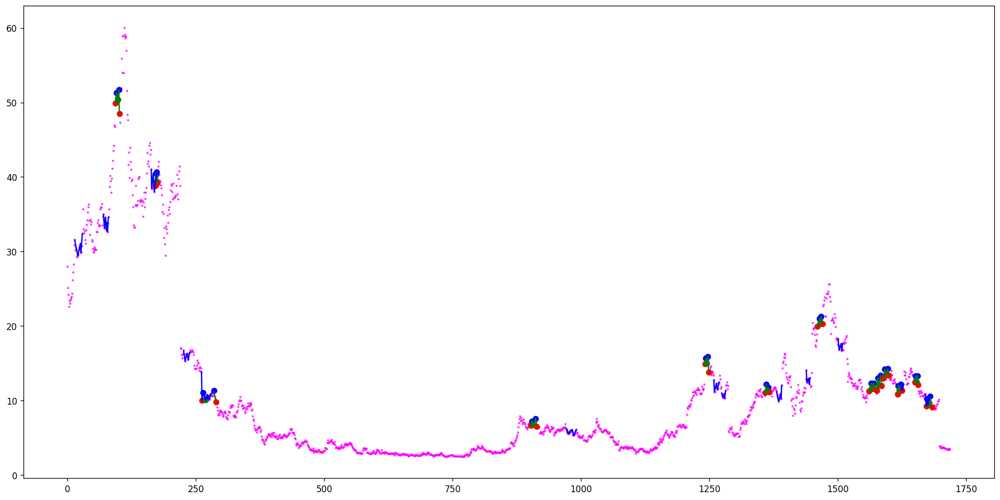

[]
[]
Ticker ADWPF found 0 double top patterns, 0 double bottom patterns


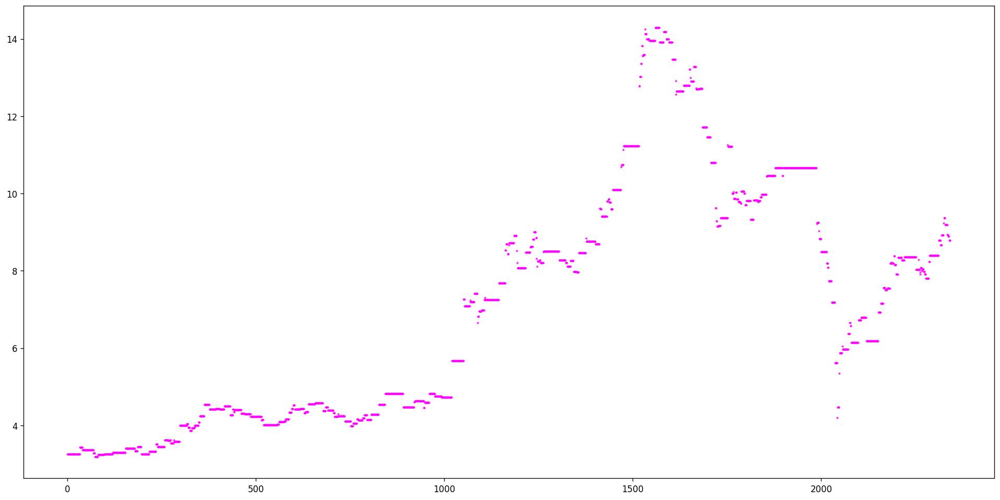

[(5, 11, 19, 25, 31), (5, 17, 19, 25, 31), (53, 62, 65, 68, 71), (73, 75, 77, 78, 97), (152, 154, 157, 165, 181), (148, 178, 182, 187, 196), (246, 249, 252, 263, 285), (252, 253, 256, 263, 285), (437, 445, 457, 468, 469), (1004, 1046, 1060, 1068, 1092), (1004, 1052, 1060, 1068, 1092), (1170, 1225, 1336, 1590, 1619), (1170, 1225, 1336, 1593, 1619), (1347, 1403, 1507, 1562, 1619), (1347, 1429, 1453, 1474, 1507), (1347, 1429, 1453, 1475, 1507), (1347, 1429, 1507, 1562, 1619), (1347, 1434, 1453, 1474, 1507), (1347, 1445, 1453, 1468, 1507), (1347, 1445, 1453, 1474, 1507), (1923, 1925, 1931, 1938, 1974), (1986, 1995, 2000, 2006, 2012), (1986, 1995, 2000, 2009, 2012), (2026, 2031, 2044, 2049, 2054), (2552, 2597, 2601, 2604, 2608), (2772, 2808, 2817, 2848, 2873), (2772, 2808, 2817, 2849, 2873), (2772, 2808, 2817, 2855, 2873), (2772, 2811, 2817, 2829, 2873), (2772, 2811, 2817, 2831, 2873), (2772, 2811, 2817, 2832, 2873), (2772, 2811, 2817, 2833, 2873), (2772, 2811, 2817, 2848, 2873), (3464, 349

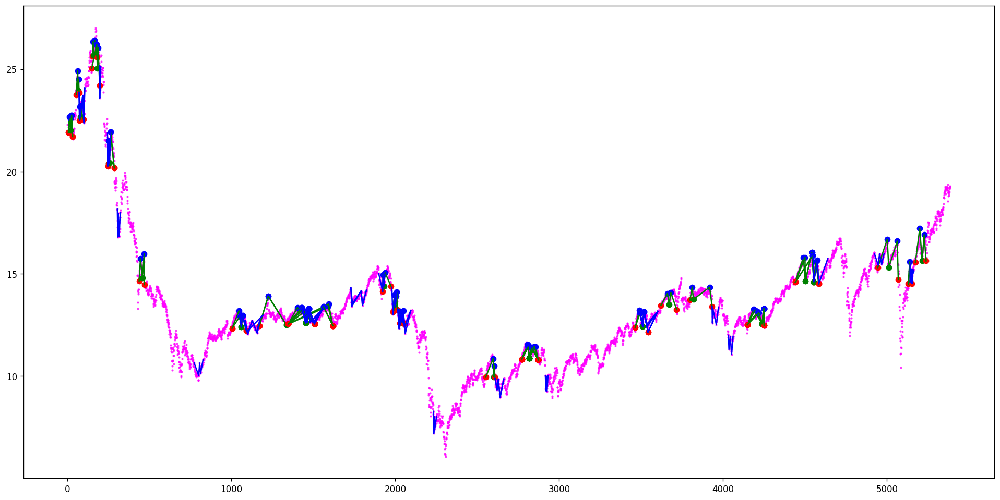

[(212, 214, 215, 217, 218), (266, 271, 276, 277, 279), (266, 273, 276, 277, 279), (279, 283, 291, 304, 305)]
[(214, 215, 217, 218, 219)]
Ticker ADXN found 4 double top patterns, 1 double bottom patterns


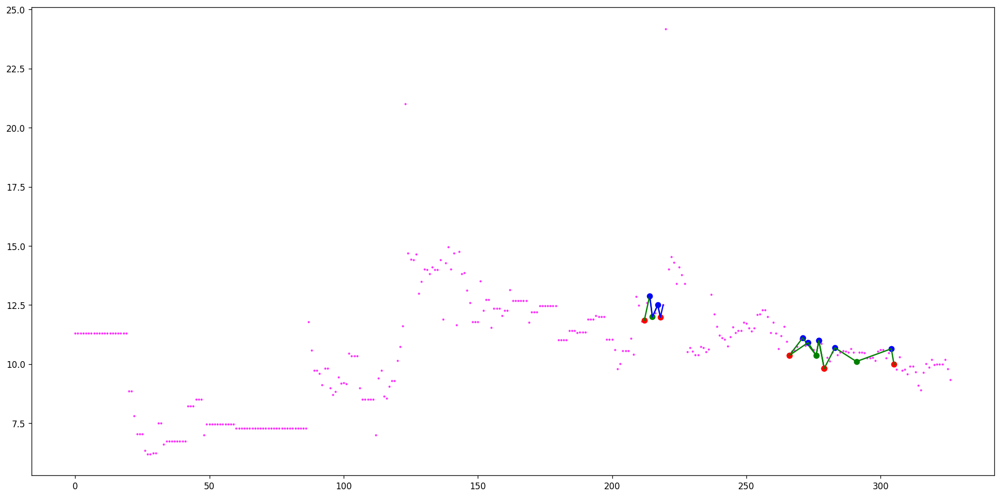

[(50, 51, 52, 53, 56), (50, 51, 52, 55, 56), (50, 51, 57, 59, 60), (65, 66, 67, 68, 73), (65, 66, 67, 70, 73), (73, 74, 75, 79, 84), (73, 74, 75, 83, 84), (87, 88, 89, 90, 91), (92, 93, 94, 100, 105), (92, 93, 94, 102, 105), (114, 115, 116, 117, 119), (114, 115, 116, 118, 119), (167, 168, 169, 170, 173), (167, 168, 169, 172, 173), (189, 190, 192, 196, 207), (189, 190, 192, 200, 207), (195, 196, 197, 200, 201), (317, 318, 319, 320, 321), (381, 382, 383, 384, 387), (381, 382, 383, 386, 387), (379, 382, 387, 392, 393), (379, 384, 387, 392, 393), (379, 386, 387, 392, 393), (389, 390, 391, 392, 393), (493, 494, 496, 497, 499), (550, 551, 553, 554, 555), (576, 577, 578, 585, 591), (576, 577, 578, 587, 591), (578, 579, 582, 585, 590), (578, 579, 582, 587, 590), (578, 581, 582, 585, 590), (578, 581, 582, 587, 590), (584, 585, 586, 587, 588), (617, 618, 619, 620, 622), (617, 618, 619, 621, 622), (635, 636, 637, 645, 646), (677, 680, 682, 684, 685), (677, 681, 682, 684, 685), (731, 732, 733, 735

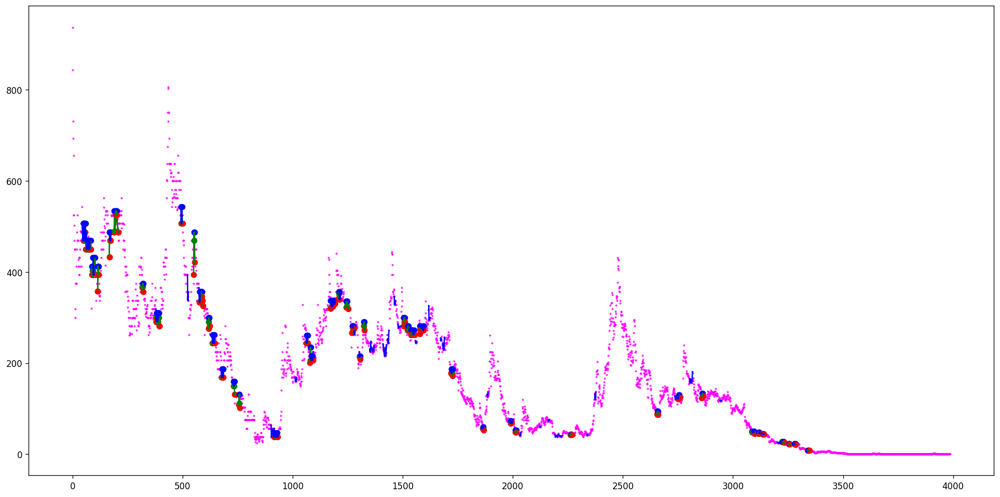

[(215, 217, 218, 220, 222), (279, 284, 285, 287, 289), (341, 343, 345, 347, 348), (341, 344, 345, 347, 348), (360, 361, 362, 364, 366), (376, 377, 378, 379, 382), (390, 392, 394, 395, 396)]
[(2, 3, 8, 14, 22), (113, 115, 116, 117, 118), (213, 215, 220, 223, 226), (312, 318, 328, 333, 340), (365, 366, 369, 371, 376), (369, 371, 372, 374, 376), (377, 378, 379, 382, 383)]
Ticker ADYEY found 7 double top patterns, 7 double bottom patterns


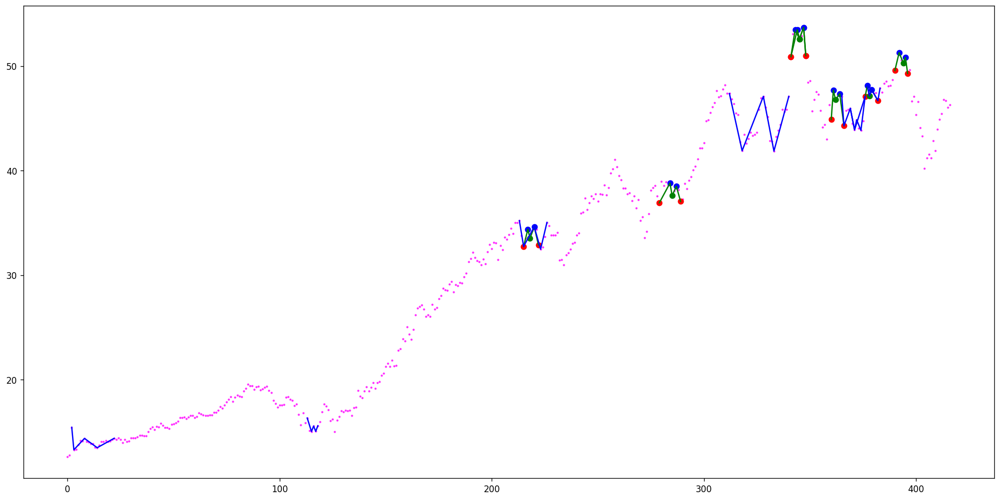

[(58, 59, 60, 63, 64), (693, 694, 697, 710, 711), (760, 761, 764, 766, 767), (868, 869, 873, 876, 879), (922, 923, 924, 925, 927), (922, 923, 924, 926, 927), (1468, 1470, 1471, 1475, 1477), (1513, 1514, 1515, 1516, 1517), (1518, 1519, 1520, 1521, 1522), (1749, 1750, 1751, 1756, 1757), (1882, 1884, 1885, 1888, 1890), (1885, 1886, 1887, 1888, 1889), (1964, 1965, 1966, 1967, 1969), (1964, 1965, 1966, 1968, 1969), (2014, 2016, 2018, 2020, 2022), (2033, 2034, 2037, 2049, 2061), (2039, 2040, 2041, 2047, 2052), (2039, 2040, 2041, 2049, 2052), (2039, 2040, 2041, 2050, 2052), (2041, 2042, 2043, 2045, 2052), (2041, 2042, 2043, 2046, 2052), (2046, 2047, 2048, 2049, 2051), (2046, 2047, 2048, 2050, 2051), (2053, 2054, 2055, 2056, 2057), (2053, 2054, 2055, 2058, 2059), (2053, 2054, 2055, 2060, 2061), (2055, 2056, 2057, 2058, 2059), (2055, 2056, 2057, 2060, 2061), (2057, 2058, 2059, 2060, 2061), (2093, 2094, 2095, 2096, 2097), (2113, 2114, 2115, 2116, 2119), (2113, 2114, 2115, 2118, 2119), (2167, 216

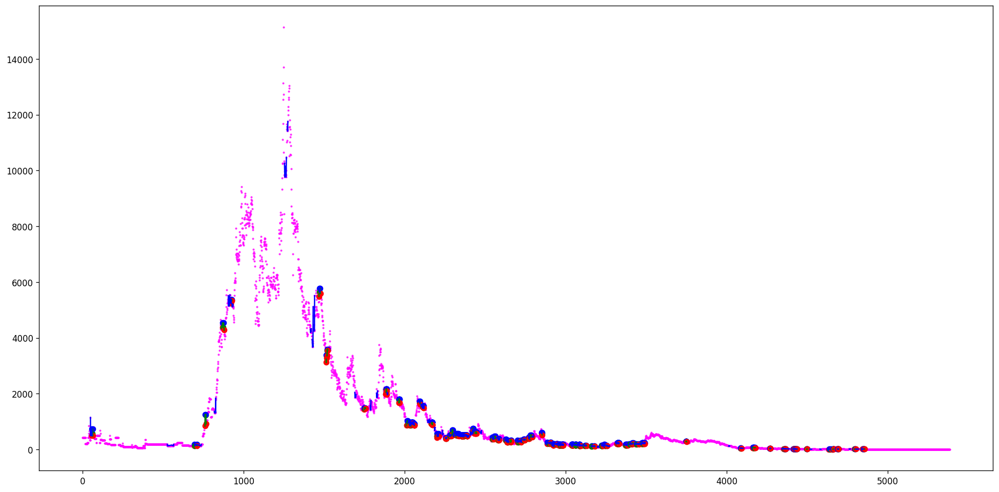

[(278, 279, 280, 281, 282), (687, 688, 689, 691, 693)]
[(352, 353, 354, 355, 356), (649, 650, 651, 652, 653)]
Ticker ADYYF found 2 double top patterns, 2 double bottom patterns


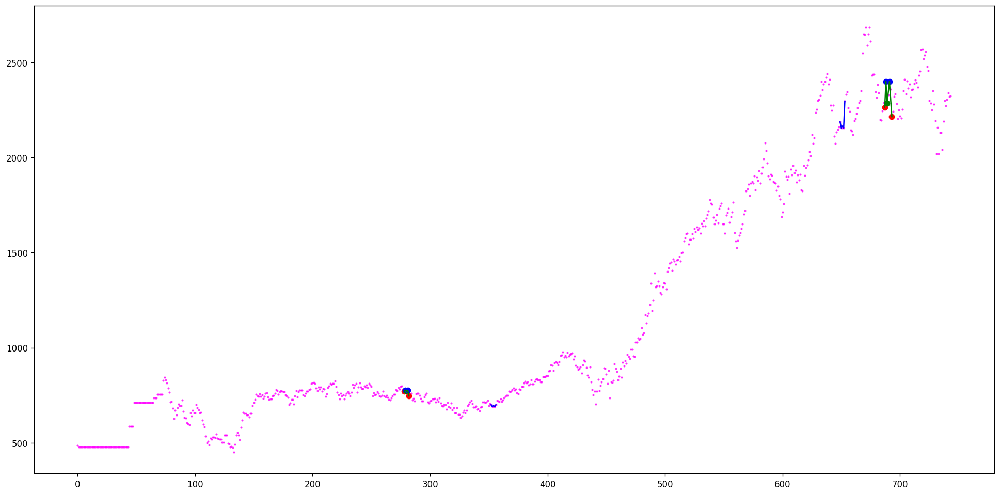

[(12, 14, 16, 18, 26), (12, 14, 16, 19, 26), (12, 14, 16, 24, 26), (35, 36, 37, 39, 42), (162, 163, 165, 172, 173), (1071, 1076, 1079, 1083, 1086), (1071, 1076, 1079, 1084, 1086), (1296, 1303, 1306, 1309, 1311), (1371, 1372, 1380, 1408, 1414), (1381, 1382, 1384, 1387, 1390), (1420, 1424, 1428, 1435, 1447), (1486, 1489, 1493, 1495, 1499), (1525, 1528, 1530, 1531, 1533), (1525, 1528, 1533, 1547, 1552), (1533, 1536, 1538, 1540, 1543), (1533, 1536, 1538, 1544, 1552), (1538, 1540, 1543, 1544, 1552), (1593, 1596, 1598, 1600, 1601), (1677, 1679, 1680, 1683, 1688), (1746, 1753, 1754, 1757, 1759), (1829, 1830, 1831, 1832, 1833), (1885, 1887, 1892, 1895, 1898), (1964, 1968, 1970, 1974, 1975), (2009, 2010, 2012, 2019, 2023), (2012, 2013, 2015, 2017, 2021), (2012, 2013, 2015, 2019, 2021), (2056, 2059, 2060, 2063, 2064), (2102, 2103, 2104, 2105, 2116), (2104, 2107, 2111, 2113, 2116), (2283, 2288, 2289, 2290, 2293), (2337, 2339, 2340, 2350, 2354), (2340, 2343, 2344, 2350, 2354), (2368, 2375, 2380, 2

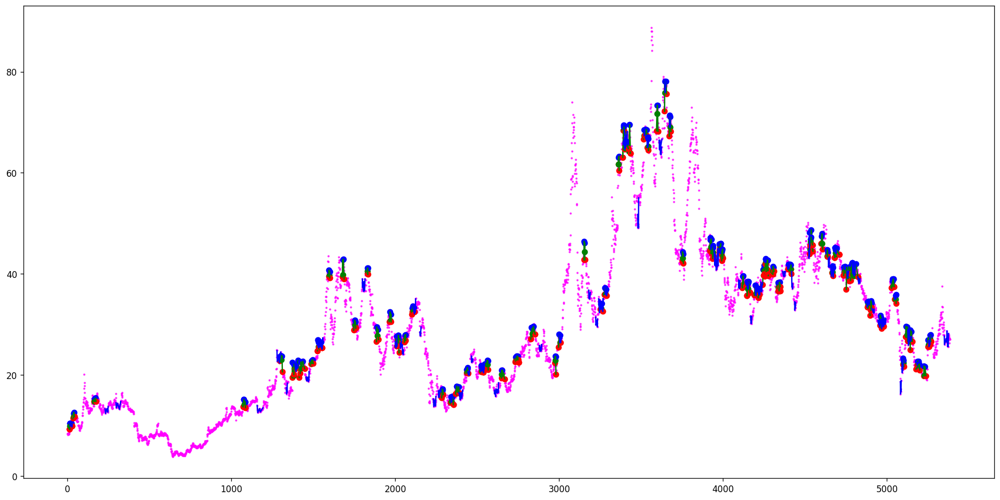

[]
[]
Ticker AEAC found 0 double top patterns, 0 double bottom patterns


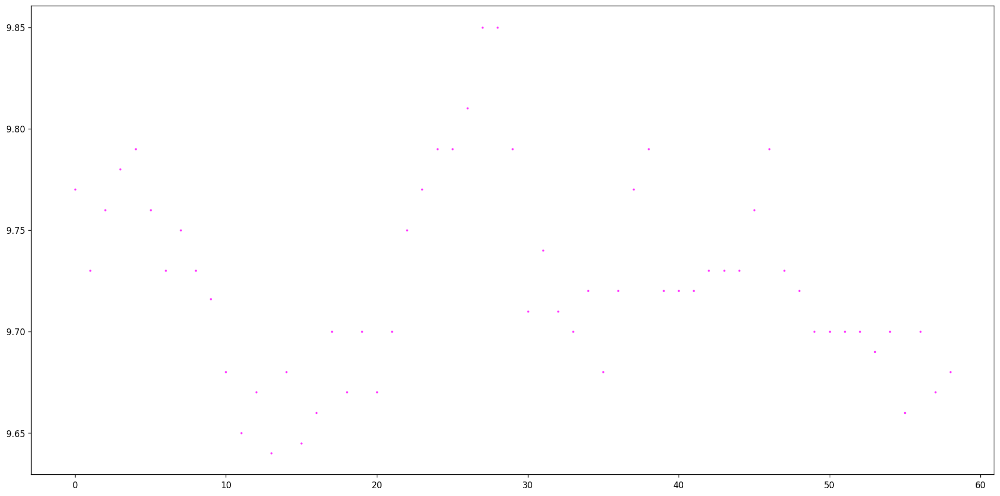

[(34, 62, 142, 248, 422), (34, 102, 142, 157, 422), (34, 102, 142, 184, 422), (34, 102, 142, 191, 422), (34, 102, 142, 243, 422), (34, 102, 142, 248, 422), (34, 123, 142, 157, 422), (145, 191, 206, 243, 378), (259, 273, 277, 288, 347), (964, 967, 971, 983, 993), (964, 967, 971, 987, 993), (1128, 1130, 1131, 1133, 1138), (1224, 1229, 1235, 1240, 1261), (1224, 1229, 1235, 1242, 1261), (1224, 1229, 1235, 1243, 1261), (1491, 1493, 1495, 1499, 1501), (1792, 1799, 1809, 1828, 1893), (1792, 1800, 1809, 1814, 1893), (1792, 1800, 1809, 1816, 1893), (1792, 1800, 1809, 1819, 1893), (1792, 1800, 1809, 1828, 1893), (1809, 1842, 1865, 1878, 1893), (1809, 1842, 1865, 1882, 1893), (1809, 1842, 1865, 1887, 1893), (1809, 1852, 1865, 1878, 1893), (1906, 1912, 1917, 1926, 1943), (1906, 1912, 1917, 1928, 1943), (1917, 1932, 1935, 1941, 1943), (1966, 1972, 1975, 1993, 2006), (1966, 1993, 2006, 2014, 2018), (2145, 2175, 2187, 2245, 2278), (2145, 2178, 2187, 2245, 2278), (2190, 2205, 2235, 2245, 2272), (2190,

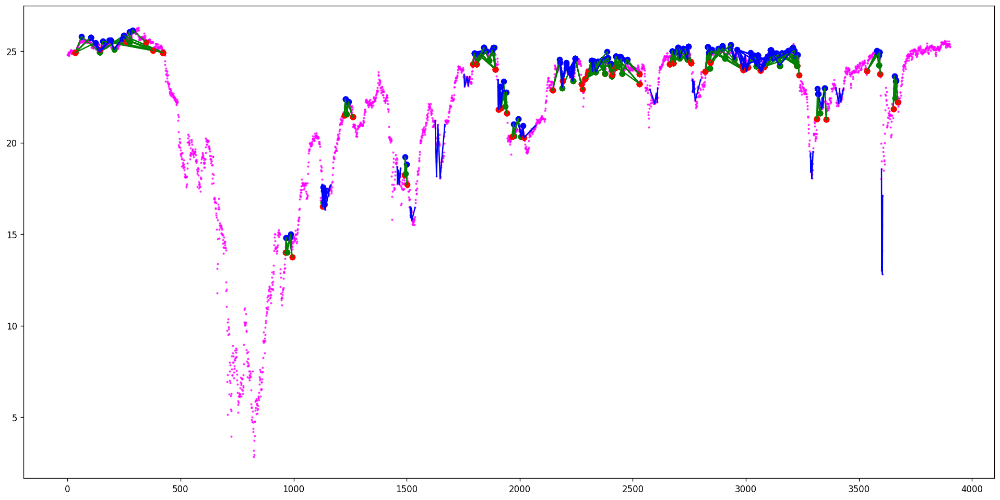

[]
[]
Ticker AEBZY found 0 double top patterns, 0 double bottom patterns


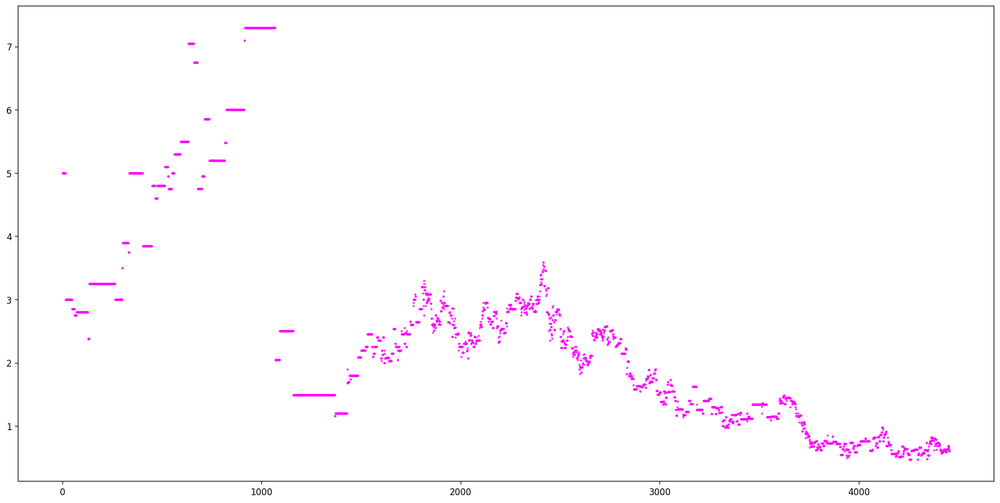

[(1, 8, 10, 14, 18), (10, 16, 18, 22, 23), (86, 90, 94, 99, 106), (86, 92, 94, 97, 106), (86, 92, 94, 99, 106), (109, 112, 113, 114, 119), (113, 114, 119, 121, 122), (109, 114, 122, 123, 124), (109, 121, 122, 123, 124), (263, 268, 276, 279, 300), (263, 268, 276, 282, 300), (263, 268, 276, 285, 300), (263, 270, 276, 279, 300), (283, 285, 288, 293, 295), (283, 287, 288, 293, 295), (318, 320, 322, 324, 336), (365, 369, 372, 375, 384), (365, 369, 372, 377, 384), (469, 472, 473, 475, 477), (460, 472, 477, 482, 485), (460, 475, 477, 482, 485), (491, 492, 494, 496, 533), (495, 500, 504, 506, 530), (504, 512, 518, 522, 525), (557, 559, 566, 567, 568), (557, 567, 570, 574, 580), (557, 567, 570, 576, 580), (643, 644, 647, 651, 668), (648, 653, 654, 655, 668), (648, 653, 654, 660, 668), (654, 655, 657, 660, 666), (675, 677, 678, 679, 683), (675, 679, 683, 685, 693), (683, 685, 687, 688, 691), (694, 698, 699, 700, 703), (694, 698, 699, 702, 703), (699, 700, 701, 702, 703), (694, 702, 705, 712, 715

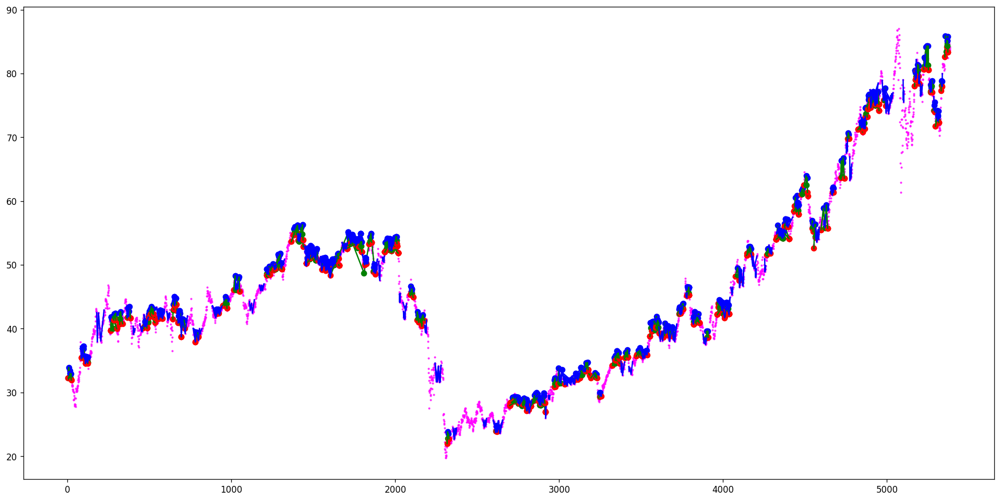

[]
[]
Ticker AEEX found 0 double top patterns, 0 double bottom patterns


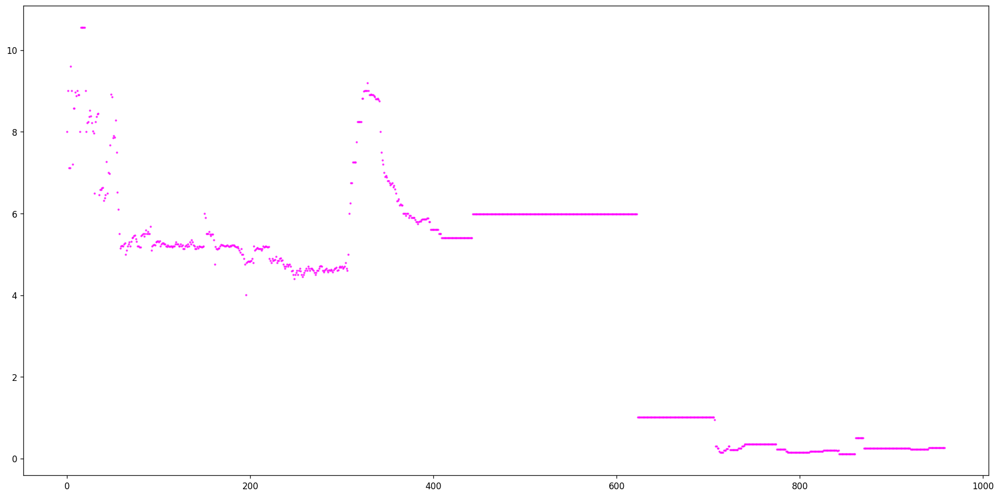

[(7, 11, 20, 25, 35), (7, 12, 20, 25, 35), (7, 14, 20, 25, 35), (90, 93, 101, 130, 144), (104, 106, 117, 130, 137), (1305, 1309, 1312, 1324, 1336), (1305, 1310, 1312, 1324, 1336), (1478, 1482, 1494, 1498, 1499), (1478, 1488, 1494, 1498, 1499), (1508, 1510, 1512, 1513, 1518), (1567, 1573, 1577, 1586, 1598), (1567, 1573, 1577, 1587, 1598), (1665, 1668, 1672, 1676, 1689), (1723, 1729, 1738, 1742, 1750), (1862, 1872, 1879, 1885, 1894), (1862, 1872, 1879, 1886, 1894), (1918, 1921, 1923, 1927, 1930), (1949, 1954, 1960, 1966, 1971), (1949, 1956, 1960, 1966, 1971), (1989, 1995, 2000, 2004, 2007), (2037, 2039, 2040, 2043, 2050), (2070, 2077, 2083, 2086, 2091), (2070, 2077, 2083, 2088, 2091), (2103, 2112, 2116, 2117, 2120), (2189, 2191, 2192, 2195, 2197), (2396, 2400, 2406, 2412, 2419), (2571, 2578, 2587, 2597, 2600), (2736, 2739, 2744, 2750, 2754), (2773, 2776, 2779, 2783, 2786), (2773, 2777, 2779, 2783, 2786), (2819, 2824, 2829, 2849, 2883), (2829, 2832, 2836, 2845, 2882), (2829, 2832, 2836, 2

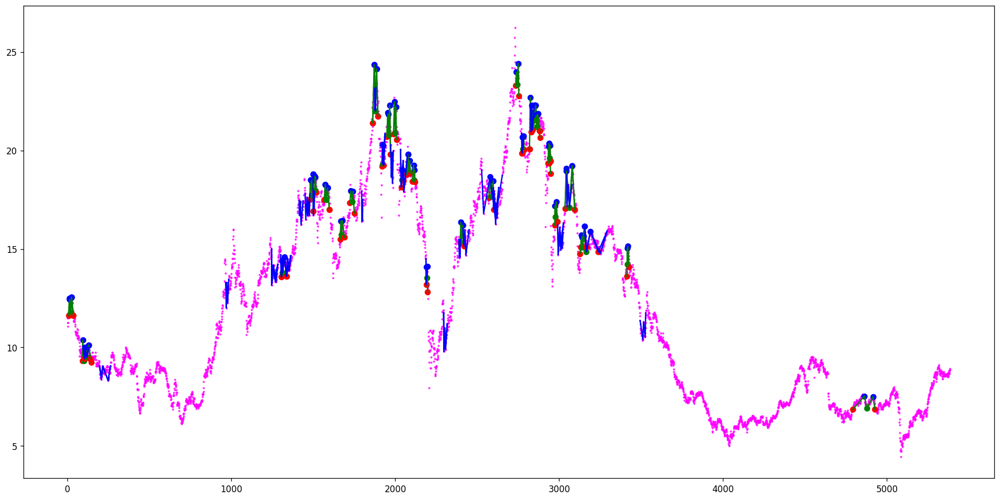

[(37, 47, 64, 74, 85), (114, 120, 122, 129, 139)]
[(302, 305, 307, 316, 362), (302, 305, 307, 329, 362)]
Ticker AEFC found 2 double top patterns, 2 double bottom patterns


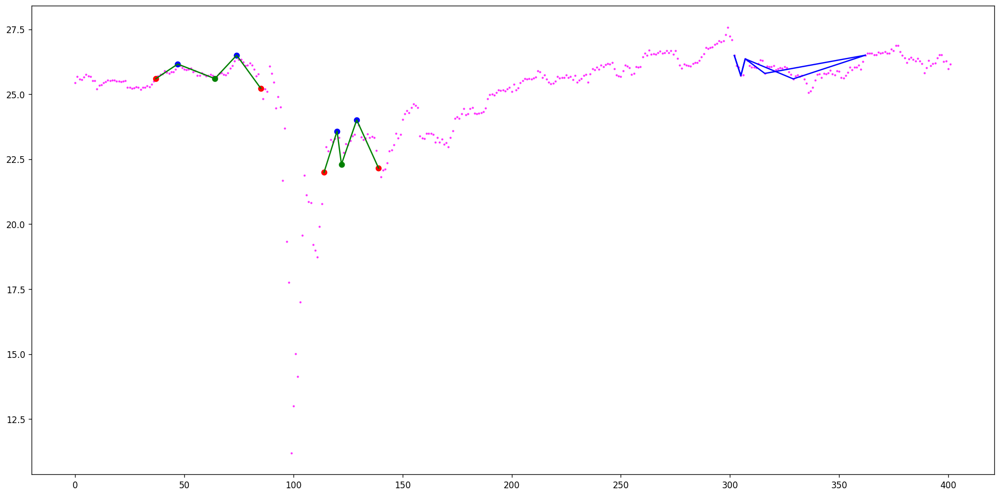

[(61, 63, 67, 69, 74), (87, 92, 94, 97, 100), (100, 102, 103, 108, 110), (154, 155, 156, 158, 159), (154, 158, 161, 163, 170), (188, 189, 190, 192, 197), (265, 269, 274, 276, 278), (265, 271, 274, 276, 278), (331, 333, 334, 335, 336), (357, 358, 366, 377, 386), (357, 360, 366, 377, 386), (366, 367, 369, 371, 375), (460, 463, 481, 483, 488), (488, 490, 493, 501, 503), (510, 511, 512, 515, 519), (550, 552, 556, 561, 565), (549, 552, 568, 572, 579), (621, 623, 626, 627, 630), (824, 827, 830, 836, 839), (862, 863, 864, 867, 868), (919, 923, 925, 931, 933), (1004, 1017, 1026, 1031, 1040), (1102, 1111, 1122, 1129, 1136), (1160, 1184, 1188, 1195, 1206), (1391, 1409, 1422, 1427, 1439), (1391, 1409, 1422, 1429, 1439), (1557, 1560, 1578, 1594, 1601), (1558, 1562, 1566, 1568, 1574), (1557, 1562, 1578, 1594, 1601), (1662, 1665, 1669, 1676, 1679), (1690, 1698, 1719, 1721, 1738), (1690, 1698, 1719, 1723, 1738), (1690, 1714, 1719, 1721, 1738), (1985, 1987, 1990, 1995, 1999), (2070, 2074, 2079, 2084, 

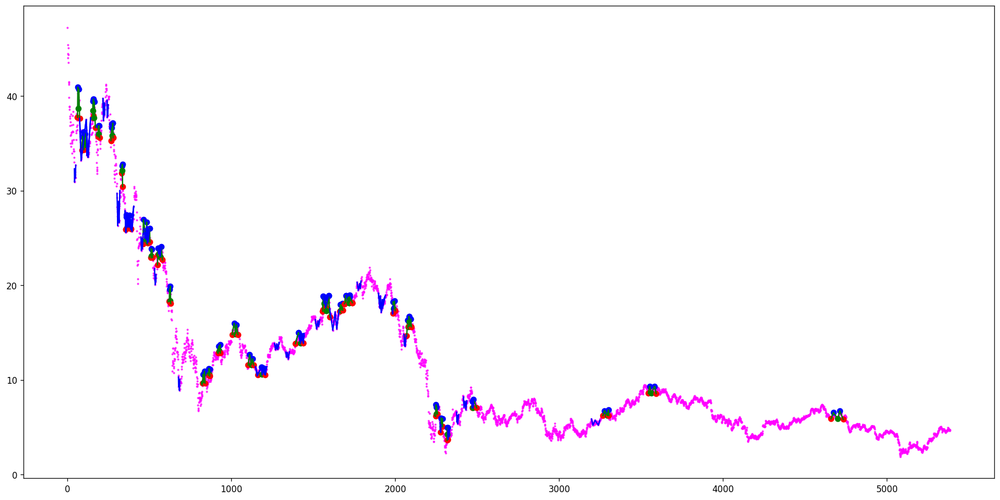

[(124, 125, 126, 130, 131)]
[(130, 131, 132, 144, 146), (183, 184, 185, 186, 187)]
Ticker AEGY found 1 double top patterns, 2 double bottom patterns


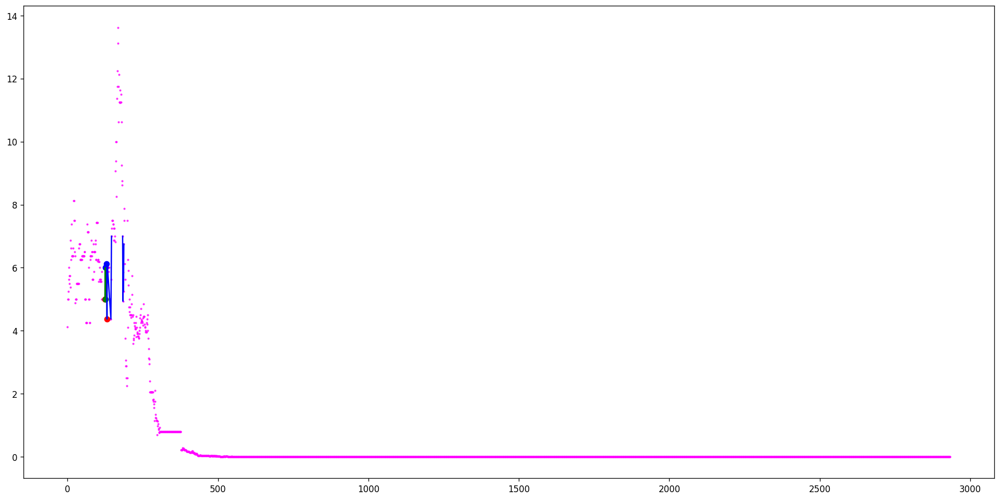

[]
[]
Ticker AEHDX found 0 double top patterns, 0 double bottom patterns


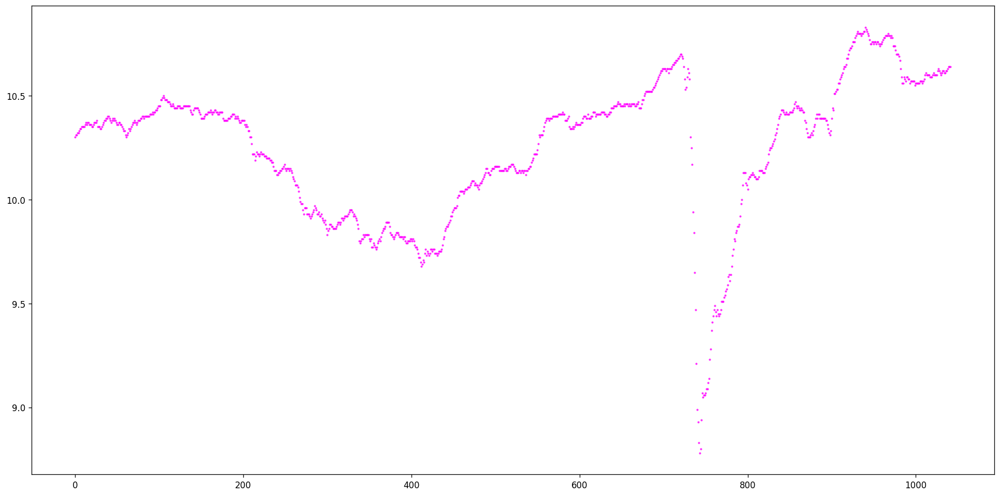

[(15, 22, 25, 35, 56), (15, 23, 25, 35, 56), (8, 37, 56, 63, 68), (8, 49, 56, 63, 68), (8, 52, 56, 60, 68), (8, 52, 56, 62, 68), (8, 52, 56, 63, 68), (8, 53, 56, 60, 68), (8, 53, 56, 62, 68), (8, 54, 56, 60, 68), (8, 54, 56, 62, 68), (69, 84, 93, 108, 199), (69, 84, 93, 114, 199), (69, 86, 93, 108, 199), (69, 86, 93, 114, 199), (107, 108, 110, 114, 195), (129, 133, 134, 138, 195), (129, 133, 134, 140, 195), (129, 133, 134, 141, 195), (129, 133, 134, 149, 195), (129, 133, 134, 155, 195), (136, 138, 139, 140, 144), (136, 140, 146, 149, 156), (136, 140, 146, 155, 156), (136, 141, 146, 149, 156), (136, 141, 146, 155, 156), (220, 222, 224, 236, 239), (220, 223, 224, 234, 239), (220, 223, 224, 236, 239), (226, 227, 228, 232, 239), (226, 227, 228, 233, 239), (233, 234, 235, 236, 237), (309, 310, 312, 313, 315), (309, 310, 312, 314, 315), (325, 326, 328, 332, 480), (325, 327, 328, 332, 480), (329, 332, 334, 341, 480), (329, 332, 334, 344, 480), (329, 332, 334, 345, 480), (391, 392, 402, 413, 4

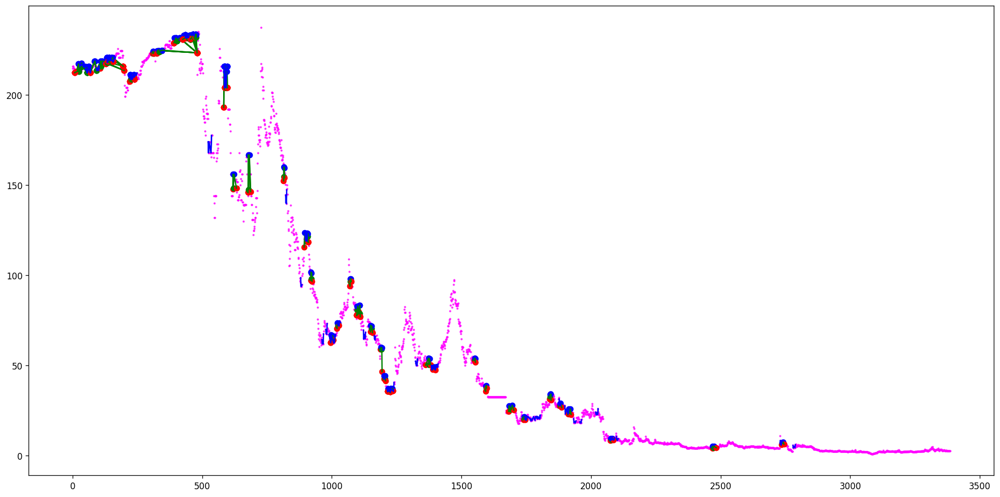

[(109, 113, 119, 124, 125), (123, 124, 125, 126, 127), (131, 134, 136, 138, 146), (131, 134, 136, 140, 146), (250, 251, 266, 267, 270), (1680, 1682, 1687, 1691, 1692), (1767, 1768, 1785, 1795, 1796), (2037, 2041, 2042, 2049, 2052)]
[(77, 80, 82, 84, 86), (77, 81, 82, 84, 86), (114, 122, 124, 130, 133), (114, 122, 124, 131, 133), (114, 123, 124, 130, 133), (114, 123, 124, 131, 133), (124, 125, 126, 130, 133), (124, 125, 126, 131, 133), (1980, 1983, 1998, 2013, 2014)]
Ticker AEHR found 8 double top patterns, 9 double bottom patterns


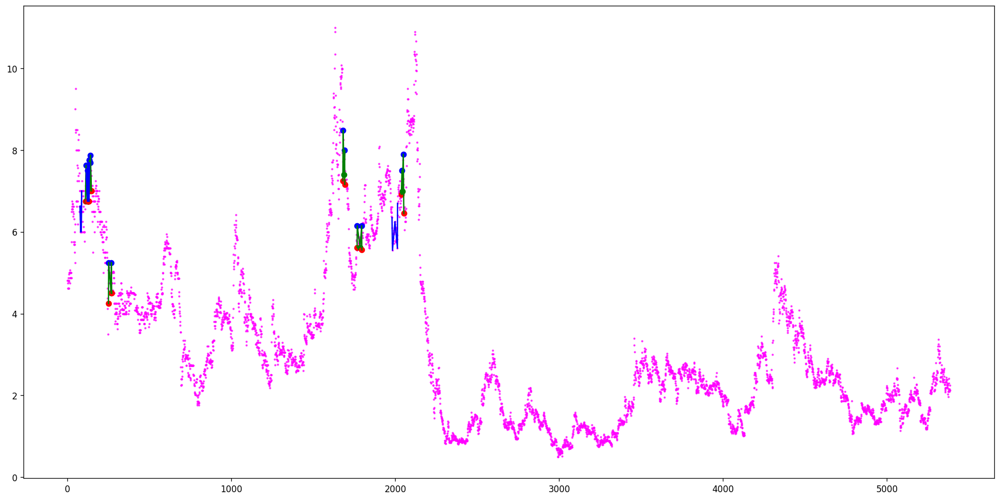

[]
[]
Ticker AEI found 0 double top patterns, 0 double bottom patterns


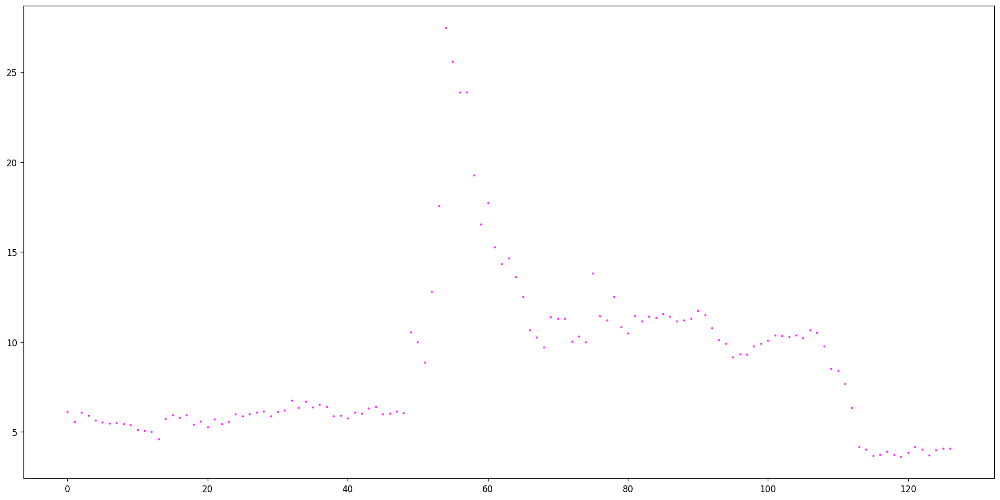

[(261, 263, 265, 266, 268), (359, 360, 362, 364, 365), (386, 387, 388, 390, 391), (501, 502, 503, 505, 507), (513, 516, 521, 524, 525), (513, 519, 521, 524, 525), (683, 685, 687, 688, 690), (781, 783, 787, 791, 793), (925, 926, 928, 930, 933), (943, 944, 945, 948, 952), (943, 944, 945, 951, 952), (1005, 1007, 1009, 1010, 1011), (1005, 1010, 1012, 1015, 1016), (1039, 1041, 1042, 1043, 1048), (1042, 1043, 1045, 1046, 1048), (1087, 1089, 1092, 1093, 1095), (1103, 1107, 1109, 1112, 1118), (1536, 1538, 1540, 1541, 1545), (1649, 1652, 1653, 1655, 1657), (1697, 1699, 1704, 1706, 1708), (1697, 1701, 1704, 1706, 1708), (1826, 1829, 1832, 1834, 1835), (1892, 1893, 1894, 1895, 1897), (2098, 2103, 2109, 2113, 2117), (2122, 2124, 2129, 2131, 2134), (2164, 2165, 2166, 2167, 2171), (2164, 2165, 2171, 2178, 2180), (2249, 2250, 2251, 2265, 2269), (2333, 2335, 2336, 2338, 2339), (2441, 2448, 2452, 2460, 2468), (2785, 2789, 2793, 2796, 2797), (2797, 2809, 2818, 2828, 2835), (3124, 3128, 3131, 3135, 3140)

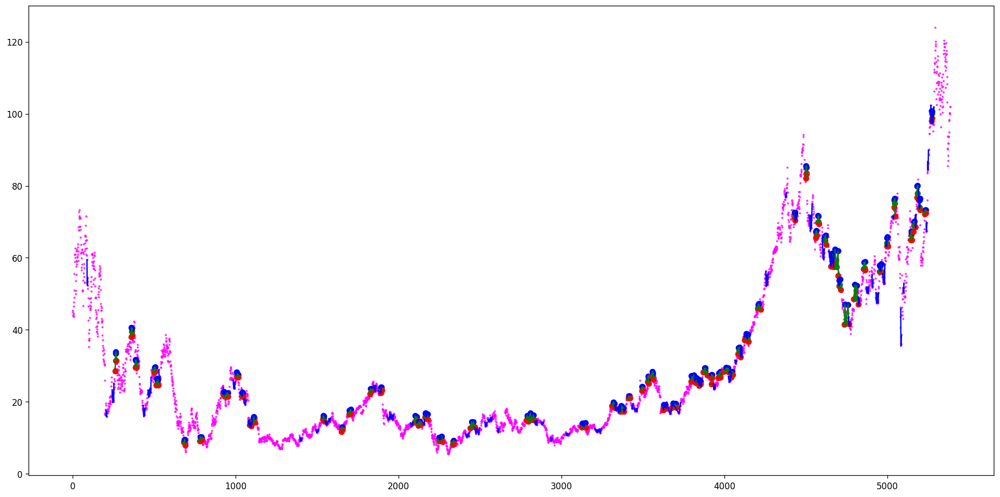

[(319, 323, 326, 331, 342), (317, 331, 343, 346, 353), (317, 336, 343, 346, 353), (466, 482, 490, 495, 502), (735, 746, 750, 756, 766), (722, 756, 768, 772, 778), (722, 756, 768, 775, 778), (722, 760, 768, 772, 778), (722, 763, 768, 772, 778), (881, 888, 903, 909, 915), (1289, 1290, 1291, 1295, 1304), (1767, 1819, 1832, 1844, 1852), (1767, 1819, 1832, 1848, 1852), (1898, 1914, 1917, 1920, 1923), (2053, 2067, 2077, 2088, 2109), (2078, 2096, 2109, 2114, 2119), (2530, 2535, 2537, 2539, 2541), (2606, 2613, 2615, 2617, 2618), (2648, 2651, 2658, 2662, 2664), (2632, 2651, 2682, 2703, 2730), (2750, 2752, 2754, 2762, 2766), (2813, 2818, 2829, 2861, 2869), (2834, 2842, 2846, 2847, 2860), (2834, 2842, 2846, 2851, 2860), (2834, 2851, 2860, 2861, 2866), (2834, 2853, 2860, 2861, 2866), (2900, 2906, 2910, 2912, 2914), (2938, 2940, 2941, 2943, 2946), (2950, 2952, 2955, 2956, 2958), (3001, 3002, 3006, 3008, 3009), (3001, 3004, 3006, 3008, 3009), (3138, 3144, 3145, 3146, 3150), (3137, 3146, 3153, 3159, 

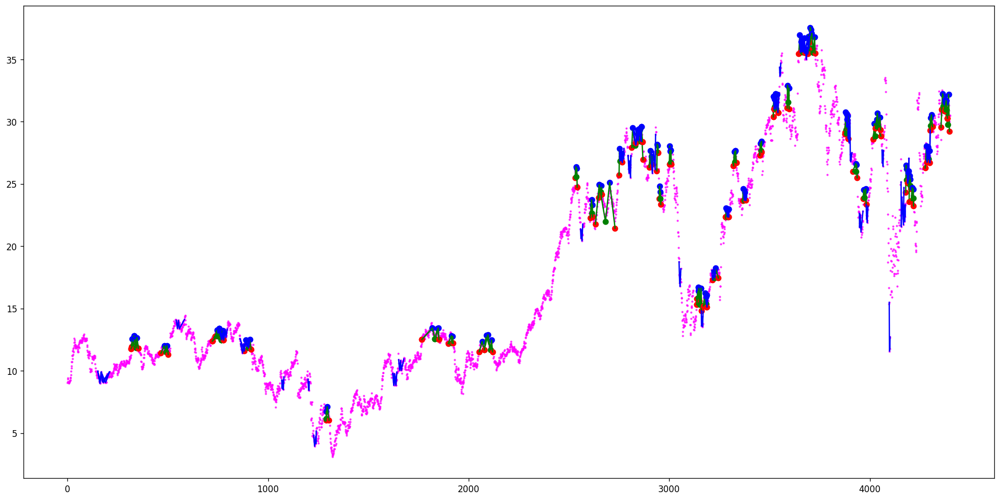

[]
[]
Ticker AELTF found 0 double top patterns, 0 double bottom patterns


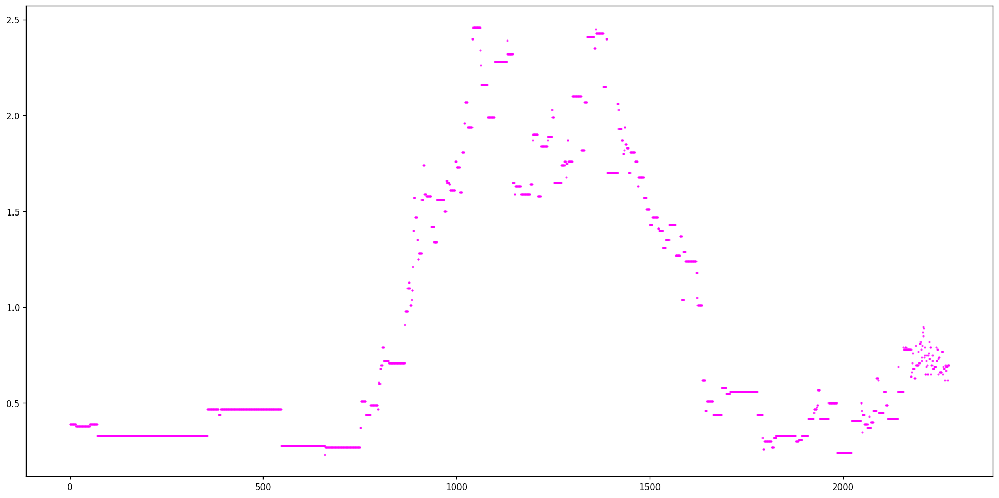

[(25, 27, 32, 35, 41), (253, 256, 264, 265, 269), (355, 358, 360, 365, 370), (524, 526, 527, 530, 541), (573, 577, 578, 579, 581), (584, 585, 586, 590, 591), (597, 600, 602, 604, 606), (669, 672, 673, 677, 688), (745, 748, 750, 753, 755), (764, 767, 770, 774, 776), (780, 781, 782, 785, 796), (915, 916, 920, 924, 931), (1046, 1049, 1050, 1052, 1060), (1046, 1049, 1050, 1056, 1060), (1045, 1056, 1060, 1064, 1073), (1161, 1163, 1169, 1170, 1173), (1215, 1217, 1218, 1222, 1234), (1368, 1371, 1382, 1394, 1400), (1432, 1434, 1436, 1437, 1447), (1432, 1434, 1436, 1443, 1447), (1507, 1508, 1510, 1513, 1518), (1637, 1638, 1640, 1641, 1642), (1632, 1638, 1642, 1644, 1646), (1632, 1641, 1642, 1644, 1646), (1652, 1654, 1656, 1657, 1661), (1652, 1654, 1656, 1659, 1661), (1772, 1773, 1774, 1775, 1776), (1777, 1779, 1780, 1782, 1791), (1777, 1779, 1780, 1784, 1791), (1780, 1784, 1786, 1787, 1790), (1800, 1801, 1803, 1805, 1816), (1871, 1874, 1875, 1876, 1877), (1889, 1896, 1901, 1911, 1914), (1901, 1

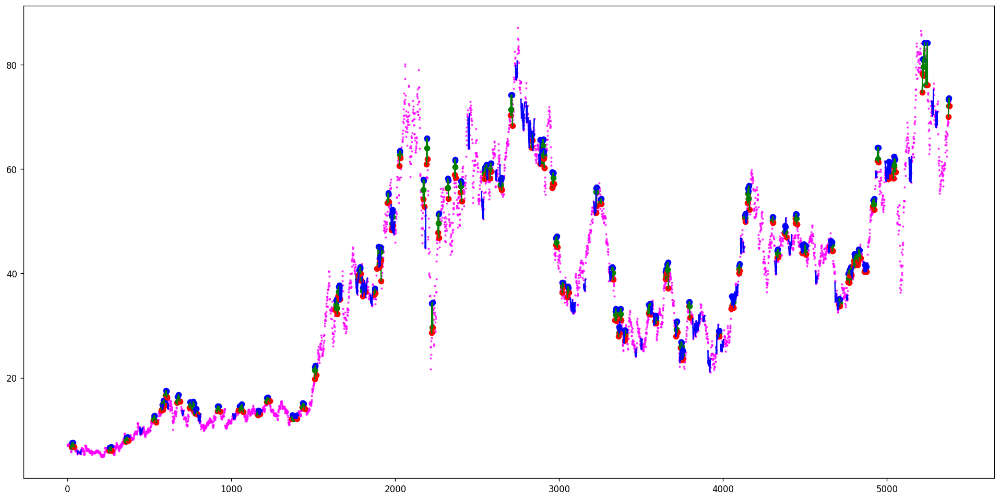

[(4, 5, 10, 25, 26), (4, 5, 10, 36, 37), (15, 16, 26, 36, 37), (133, 134, 136, 138, 139), (133, 134, 139, 146, 147), (267, 268, 270, 275, 276), (267, 268, 270, 278, 279), (271, 272, 276, 278, 279), (312, 313, 314, 320, 321), (332, 333, 334, 341, 342), (332, 333, 342, 346, 347), (451, 452, 453, 454, 455), (542, 544, 545, 546, 549), (542, 544, 545, 548, 549), (567, 569, 570, 571, 574), (637, 638, 670, 672, 673), (1020, 1021, 1022, 1028, 1029), (1171, 1172, 1175, 1176, 1178), (1171, 1172, 1175, 1177, 1178), (1171, 1173, 1175, 1176, 1178), (1171, 1173, 1175, 1177, 1178), (1209, 1210, 1211, 1215, 1219), (1209, 1210, 1211, 1216, 1219), (1211, 1212, 1214, 1215, 1219), (1211, 1212, 1214, 1216, 1219), (1211, 1213, 1214, 1215, 1219), (1211, 1213, 1214, 1216, 1219), (1261, 1262, 1263, 1265, 1266), (1377, 1378, 1382, 1383, 1385), (1377, 1378, 1382, 1384, 1385), (1377, 1381, 1382, 1383, 1385), (1377, 1381, 1382, 1384, 1385), (1386, 1387, 1388, 1390, 1391), (1386, 1387, 1404, 1408, 1412), (1431, 143

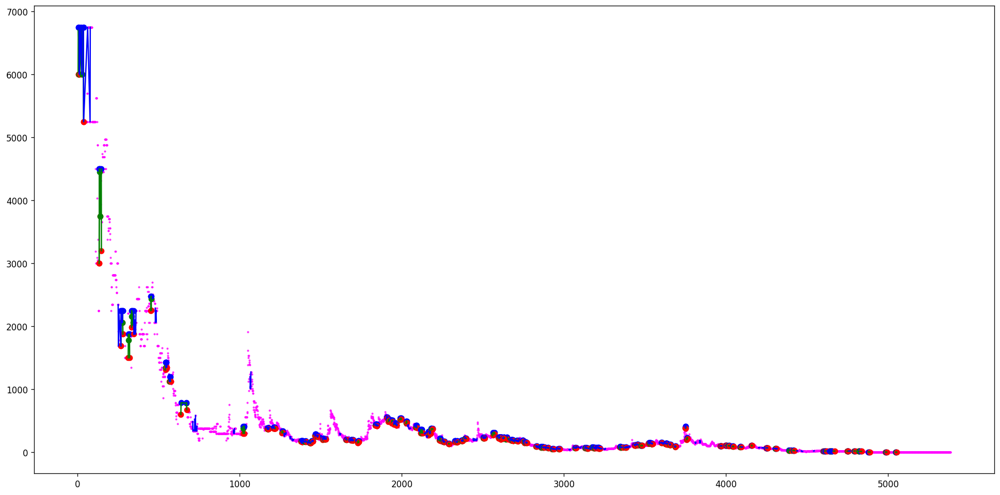

[]
[]
Ticker AENG found 0 double top patterns, 0 double bottom patterns


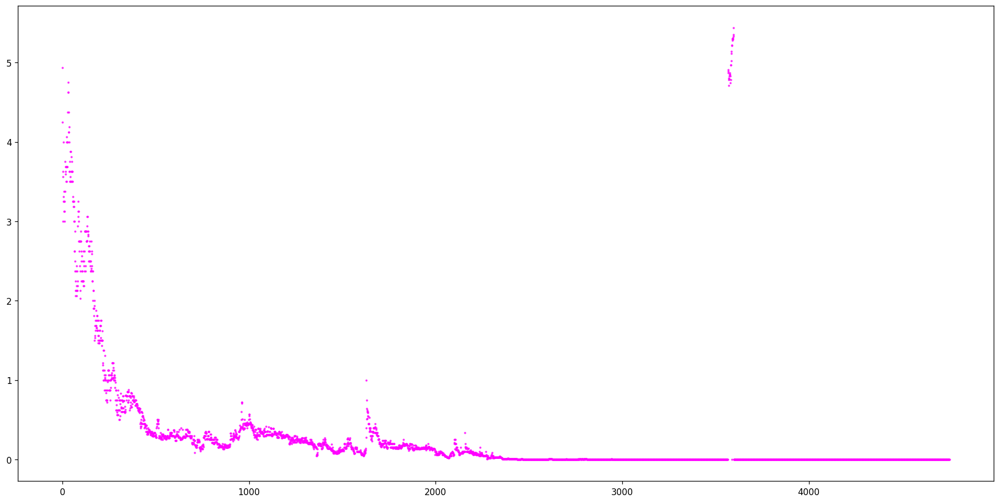

[(30, 33, 40, 41, 44), (100, 106, 109, 110, 127), (100, 106, 109, 113, 127), (100, 106, 109, 118, 127), (181, 188, 197, 200, 203), (437, 443, 446, 454, 461)]
[(133, 139, 142, 145, 155), (210, 211, 214, 218, 226), (696, 703, 713, 719, 722)]
Ticker AENZ found 6 double top patterns, 3 double bottom patterns


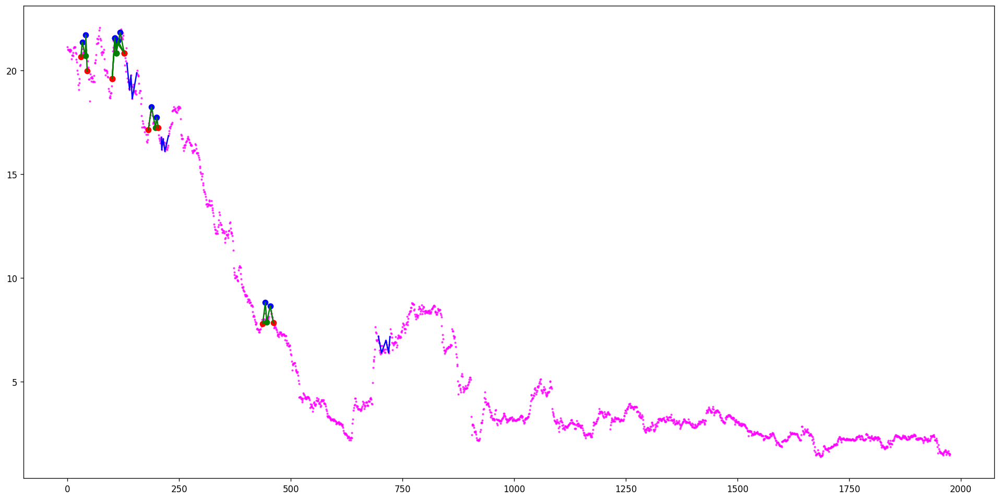

[(2, 7, 10, 13, 15), (2, 8, 10, 13, 15), (2, 9, 10, 13, 15), (1, 13, 15, 20, 26), (15, 16, 18, 20, 26), (84, 85, 86, 87, 105), (86, 92, 94, 97, 105), (109, 112, 113, 114, 116), (135, 138, 139, 140, 142), (229, 231, 232, 233, 236), (323, 325, 327, 328, 335), (323, 325, 327, 332, 335), (318, 332, 339, 348, 364), (318, 334, 339, 345, 364), (395, 402, 403, 405, 408), (420, 424, 426, 427, 430), (458, 470, 471, 472, 477), (480, 482, 483, 484, 487), (497, 500, 502, 503, 512), (497, 500, 502, 506, 512), (565, 567, 570, 573, 578), (565, 567, 570, 574, 578), (565, 567, 570, 576, 578), (919, 923, 924, 927, 935), (918, 931, 935, 938, 961), (1024, 1025, 1029, 1034, 1062), (1039, 1049, 1053, 1055, 1058), (1079, 1080, 1084, 1088, 1091), (1102, 1106, 1110, 1111, 1143), (1102, 1106, 1110, 1120, 1143), (1102, 1108, 1110, 1111, 1143), (1110, 1111, 1113, 1120, 1143), (1116, 1125, 1131, 1140, 1142), (1116, 1127, 1131, 1138, 1142), (1116, 1127, 1131, 1140, 1142), (1165, 1177, 1178, 1182, 1190), (1165, 1177,

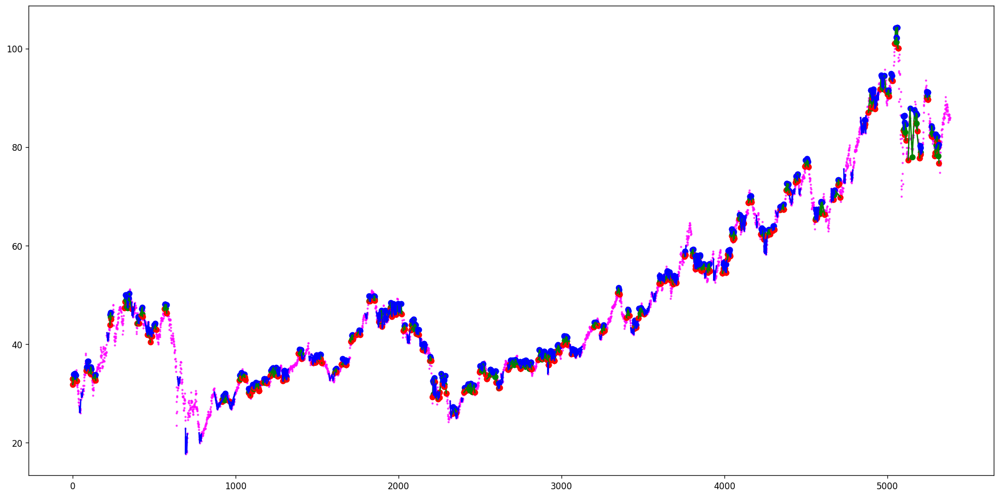

[(3, 7, 14, 20, 27), (3, 10, 14, 20, 27), (77, 86, 95, 103, 139), (77, 93, 95, 97, 139), (77, 93, 95, 98, 139), (95, 103, 105, 106, 127), (95, 103, 105, 111, 127), (95, 124, 127, 130, 138), (95, 124, 127, 133, 138), (75, 133, 148, 155, 163), (75, 135, 148, 152, 163), (75, 135, 148, 155, 163), (75, 144, 148, 152, 163), (171, 176, 181, 183, 189), (171, 176, 181, 184, 189), (171, 176, 181, 185, 189), (218, 223, 225, 229, 237), (269, 270, 271, 272, 276), (269, 270, 271, 275, 276), (271, 272, 273, 275, 276), (269, 275, 277, 282, 288), (277, 278, 279, 282, 285), (345, 348, 352, 353, 355), (370, 371, 374, 375, 376), (401, 403, 405, 408, 410), (401, 408, 411, 412, 417), (401, 412, 417, 419, 421), (395, 412, 421, 423, 424), (395, 419, 421, 423, 424), (525, 529, 534, 536, 544)]
[(7, 14, 20, 24, 29), (7, 14, 20, 27, 29), (7, 16, 20, 24, 29), (7, 18, 20, 24, 29), (136, 139, 144, 148, 151), (136, 143, 144, 148, 151), (133, 148, 155, 163, 213), (133, 153, 155, 158, 213), (133, 154, 155, 158, 213), (

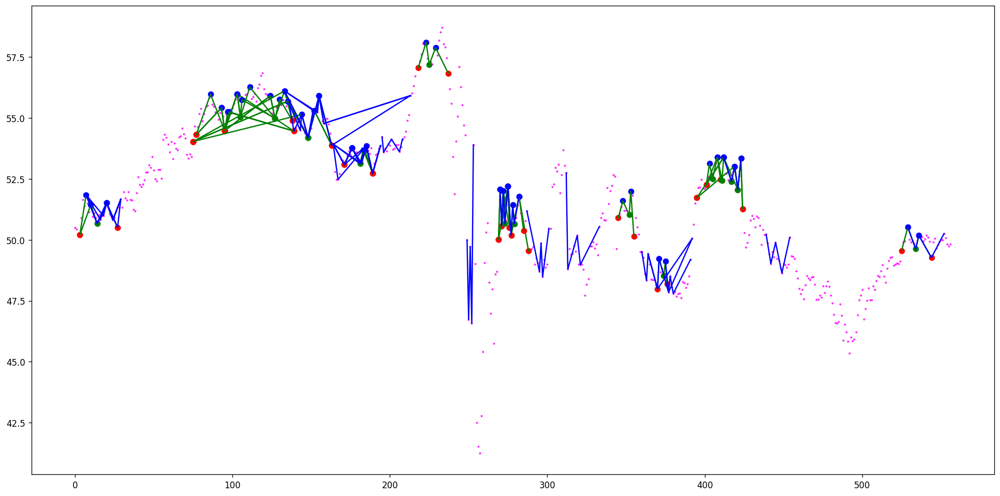

[(240, 242, 244, 246, 247), (240, 243, 244, 246, 247), (252, 253, 255, 258, 262), (303, 304, 305, 306, 307), (303, 304, 305, 308, 309), (305, 306, 307, 308, 309), (370, 371, 386, 441, 442), (396, 397, 398, 399, 400), (396, 397, 403, 441, 442), (403, 404, 407, 411, 412), (403, 404, 407, 416, 417), (403, 404, 407, 420, 421), (403, 404, 407, 427, 428), (408, 409, 412, 416, 417), (408, 409, 412, 420, 421), (408, 409, 412, 427, 428), (412, 413, 417, 420, 421), (412, 413, 417, 427, 428), (417, 418, 421, 427, 428), (431, 433, 438, 441, 442), (455, 456, 457, 461, 462), (455, 456, 457, 463, 464), (459, 460, 462, 463, 464), (465, 466, 470, 471, 472), (465, 466, 470, 473, 474), (465, 466, 470, 475, 476), (465, 466, 470, 479, 480), (470, 471, 472, 473, 474), (470, 471, 472, 475, 476), (470, 471, 472, 479, 480), (472, 473, 474, 475, 476), (472, 473, 474, 479, 480), (474, 475, 476, 479, 480), (483, 484, 485, 489, 490), (483, 484, 485, 495, 496), (483, 484, 485, 501, 502), (488, 489, 490, 495, 496), 

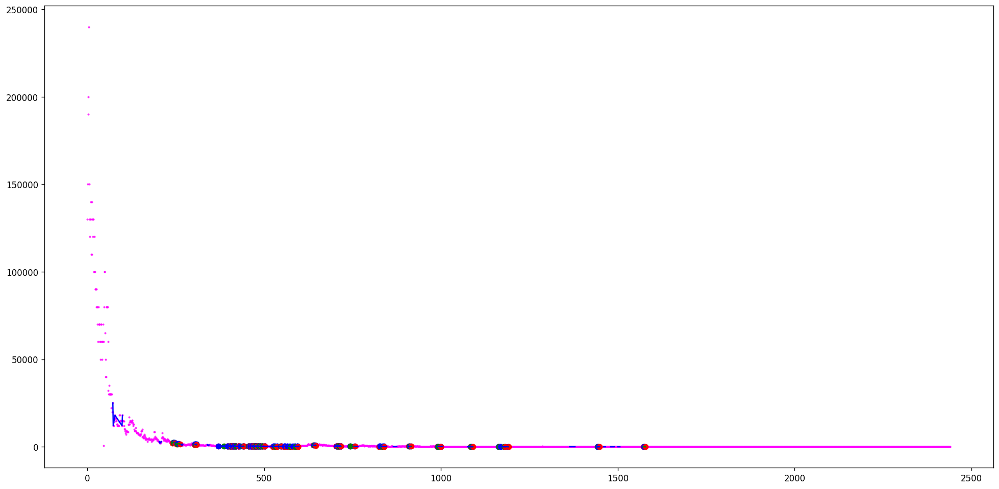

[(39, 41, 44, 49, 53), (137, 143, 148, 150, 162), (137, 143, 148, 153, 162), (137, 145, 148, 150, 162), (127, 158, 162, 163, 166), (271, 272, 275, 277, 280), (355, 357, 359, 361, 367), (355, 357, 359, 364, 367), (423, 425, 426, 427, 429), (429, 431, 433, 434, 438), (429, 431, 433, 436, 438), (632, 633, 635, 642, 644), (882, 884, 885, 887, 890), (1050, 1052, 1054, 1057, 1061), (1050, 1052, 1054, 1059, 1061), (1149, 1160, 1166, 1173, 1180), (1149, 1163, 1166, 1173, 1180), (1194, 1202, 1209, 1213, 1216), (1363, 1368, 1382, 1388, 1392), (1363, 1376, 1382, 1388, 1392), (1574, 1584, 1599, 1606, 1610), (1574, 1587, 1599, 1606, 1610), (1825, 1828, 1829, 1830, 1835), (1825, 1828, 1829, 1834, 1835), (1873, 1875, 1881, 1895, 1900), (1873, 1875, 1881, 1898, 1900), (1902, 1907, 1908, 1910, 1917), (1924, 1925, 1926, 1928, 1930), (1945, 1947, 1955, 1956, 1957), (2031, 2038, 2043, 2045, 2049), (2053, 2056, 2058, 2059, 2060), (2073, 2078, 2080, 2083, 2085), (2091, 2092, 2093, 2094, 2097), (2091, 2094, 

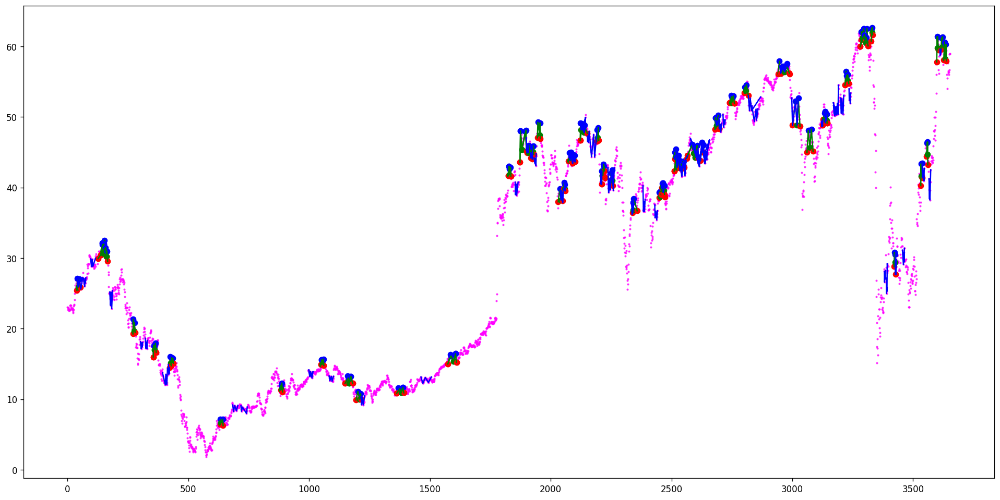

[(18, 20, 21, 22, 23), (59, 61, 64, 68, 72), (157, 159, 160, 162, 164), (271, 272, 273, 274, 275), (309, 310, 312, 313, 315), (374, 375, 376, 377, 378), (373, 377, 379, 382, 383), (469, 471, 473, 474, 476), (852, 858, 861, 865, 866), (1053, 1055, 1059, 1069, 1075), (1053, 1055, 1059, 1070, 1075), (1292, 1299, 1302, 1305, 1311), (1286, 1307, 1311, 1319, 1336), (1286, 1307, 1311, 1324, 1336), (1286, 1307, 1311, 1325, 1336), (1376, 1381, 1384, 1388, 1405), (1376, 1381, 1384, 1390, 1405), (1518, 1519, 1524, 1540, 1564), (1537, 1545, 1556, 1558, 1561), (1537, 1547, 1556, 1558, 1561), (1850, 1856, 1859, 1861, 1864), (1809, 1861, 1876, 1895, 1900), (1908, 1909, 1910, 1912, 1914), (1965, 1974, 1976, 1978, 1983), (1986, 1992, 1993, 1995, 2000), (1986, 1995, 2000, 2006, 2010), (1986, 1997, 2000, 2006, 2010), (1986, 2006, 2011, 2013, 2019), (2029, 2039, 2044, 2047, 2050), (2098, 2103, 2110, 2123, 2132), (2115, 2117, 2118, 2119, 2130), (2115, 2117, 2118, 2123, 2130), (2118, 2119, 2121, 2123, 2130)

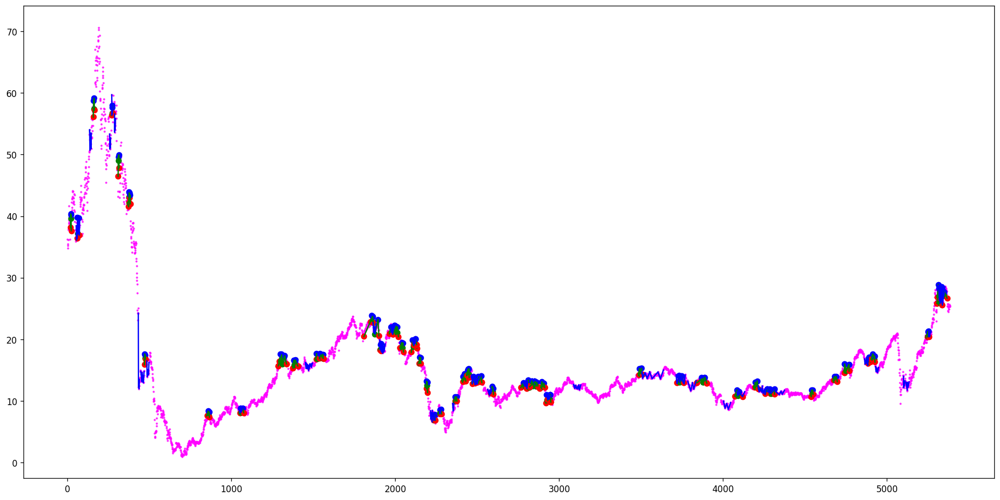

[(27, 29, 31, 34, 36)]
[]
Ticker AESC found 1 double top patterns, 0 double bottom patterns


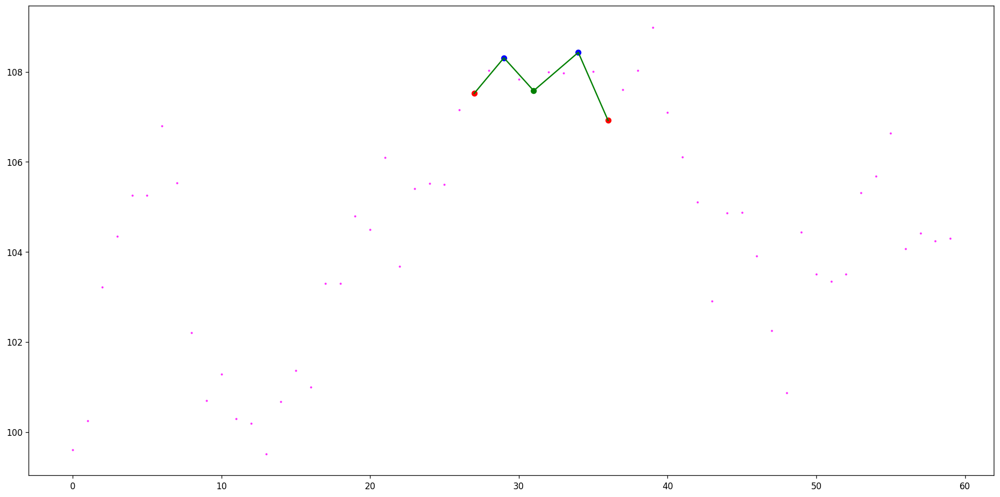

[]
[]
Ticker AESE found 0 double top patterns, 0 double bottom patterns


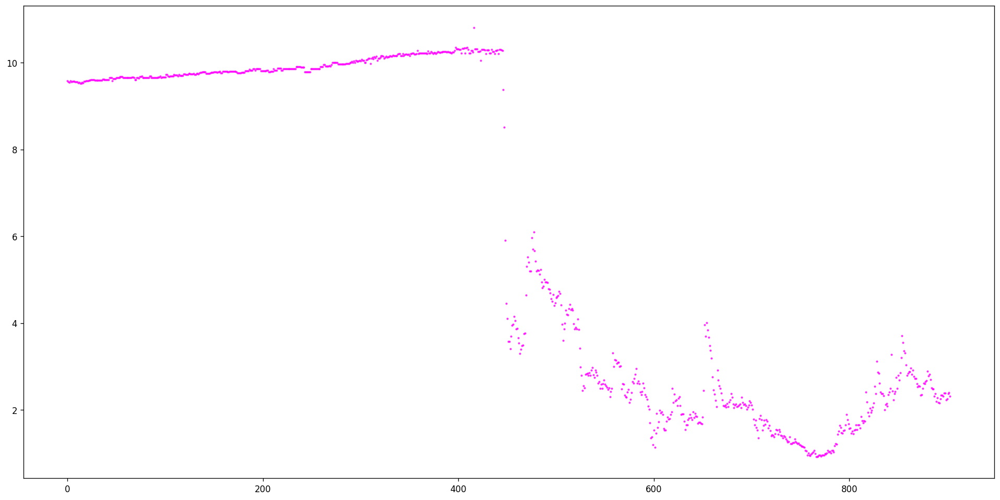

[]
[]
Ticker AESO found 0 double top patterns, 0 double bottom patterns


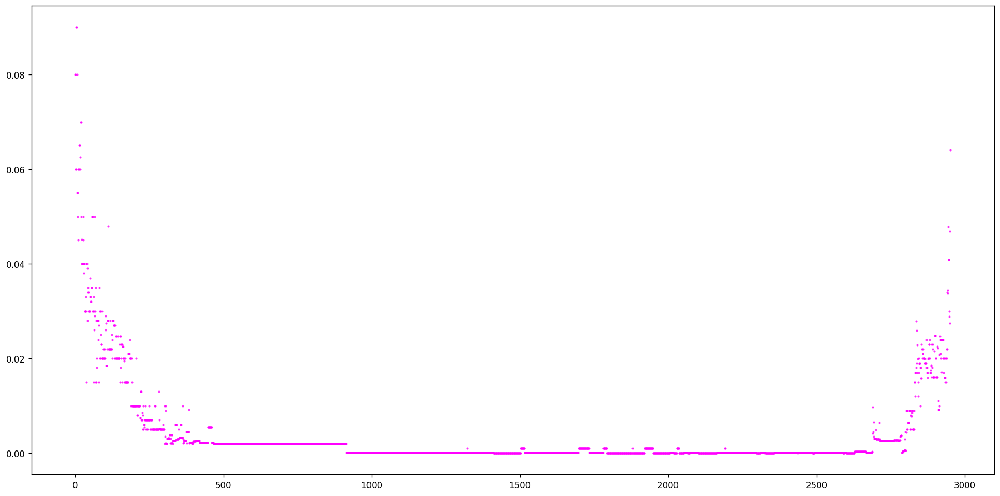

[(12, 13, 15, 18, 23), (42, 55, 62, 65, 76), (42, 57, 62, 65, 76), (111, 114, 118, 121, 123), (175, 183, 189, 195, 203), (260, 262, 264, 272, 281), (298, 305, 311, 313, 322), (376, 380, 383, 388, 390), (528, 534, 540, 542, 547), (528, 535, 540, 542, 547), (629, 630, 632, 633, 634), (675, 677, 678, 679, 680), (688, 689, 691, 692, 693), (688, 690, 691, 692, 693), (693, 695, 697, 699, 702), (707, 708, 709, 710, 711), (869, 872, 873, 874, 877), (887, 890, 891, 897, 901), (930, 934, 939, 940, 943), (999, 1009, 1011, 1014, 1015), (999, 1014, 1015, 1017, 1018), (1067, 1072, 1073, 1078, 1096), (1076, 1078, 1081, 1084, 1092), (1076, 1078, 1081, 1086, 1092), (1073, 1086, 1092, 1093, 1095), (1283, 1292, 1296, 1298, 1302), (1341, 1348, 1351, 1353, 1360), (1365, 1367, 1368, 1372, 1375), (1407, 1409, 1412, 1415, 1421), (1407, 1409, 1412, 1417, 1421), (1413, 1415, 1416, 1417, 1421), (1443, 1446, 1447, 1448, 1449), (1493, 1495, 1496, 1499, 1507), (1496, 1499, 1502, 1503, 1507), (1511, 1512, 1513, 1514

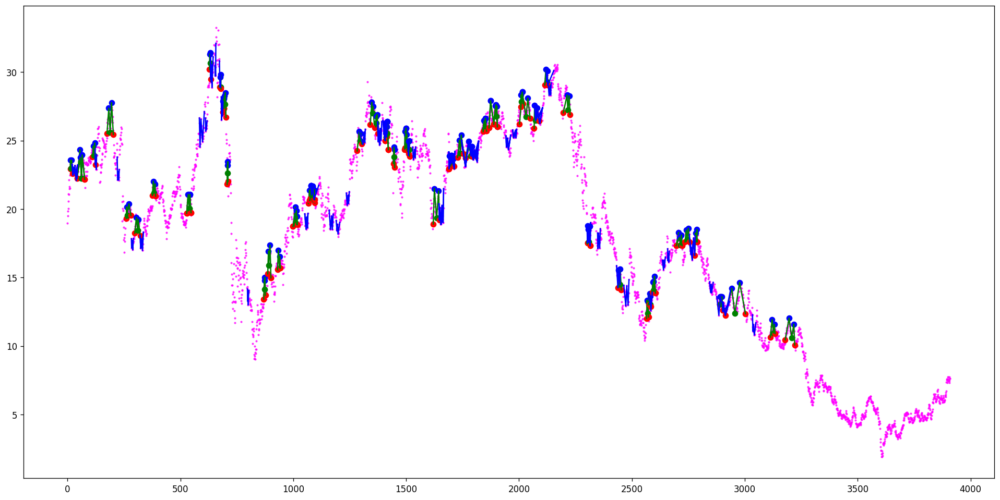

[]
[]
Ticker AEVA found 0 double top patterns, 0 double bottom patterns


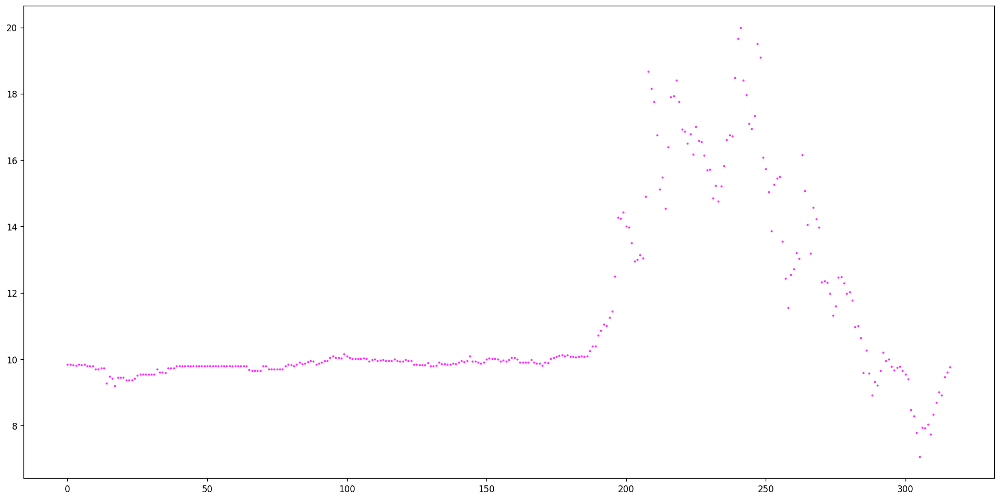

[(236, 244, 247, 249, 254), (365, 373, 376, 377, 384), (365, 373, 376, 379, 384), (480, 481, 483, 488, 489), (536, 542, 549, 563, 612), (561, 563, 566, 567, 610), (561, 563, 566, 569, 610), (561, 563, 566, 575, 610), (566, 575, 580, 585, 610), (580, 599, 600, 604, 608), (658, 661, 663, 665, 670), (692, 694, 695, 697, 701), (688, 694, 705, 717, 724), (688, 697, 705, 714, 724), (688, 697, 705, 717, 724), (705, 707, 710, 711, 724), (705, 707, 710, 714, 724), (759, 760, 764, 766, 767), (749, 760, 770, 782, 787), (944, 951, 957, 959, 965), (980, 981, 982, 983, 984), (986, 987, 988, 991, 992), (1055, 1058, 1066, 1068, 1074), (1092, 1094, 1096, 1097, 1102), (1274, 1277, 1283, 1287, 1296), (1273, 1294, 1296, 1300, 1306), (1417, 1432, 1434, 1437, 1444), (1417, 1432, 1434, 1439, 1444)]
[(34, 38, 50, 52, 69), (34, 38, 50, 54, 69), (264, 265, 269, 270, 277), (264, 265, 269, 272, 277), (360, 363, 373, 376, 379), (360, 363, 379, 384, 396), (481, 483, 488, 490, 497), (505, 506, 513, 519, 529), (505, 

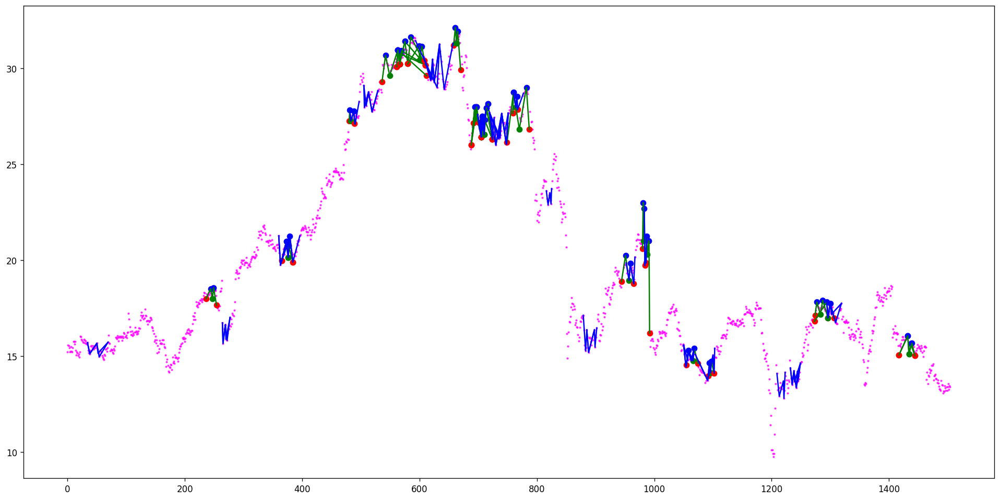

[]
[(375, 376, 378, 379, 380)]
Ticker AEXE found 0 double top patterns, 1 double bottom patterns


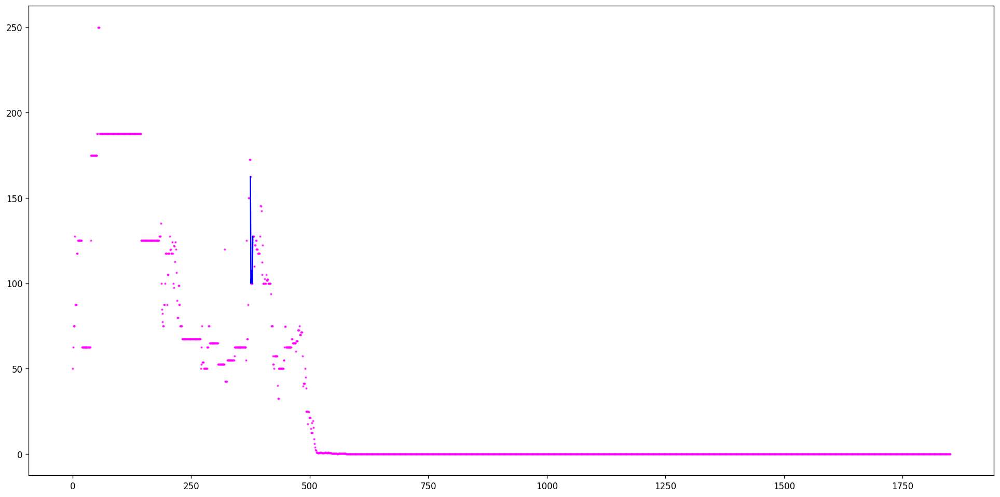

[(44, 46, 49, 51, 52), (44, 46, 49, 58, 59), (49, 50, 52, 58, 59), (951, 952, 953, 954, 957), (1003, 1005, 1007, 1019, 1022), (1110, 1119, 1139, 1145, 1150), (5065, 5066, 5067, 5068, 5069)]
[(1978, 1983, 1998, 2001, 2004), (1978, 1985, 1998, 2001, 2004)]
Ticker AEY found 7 double top patterns, 2 double bottom patterns


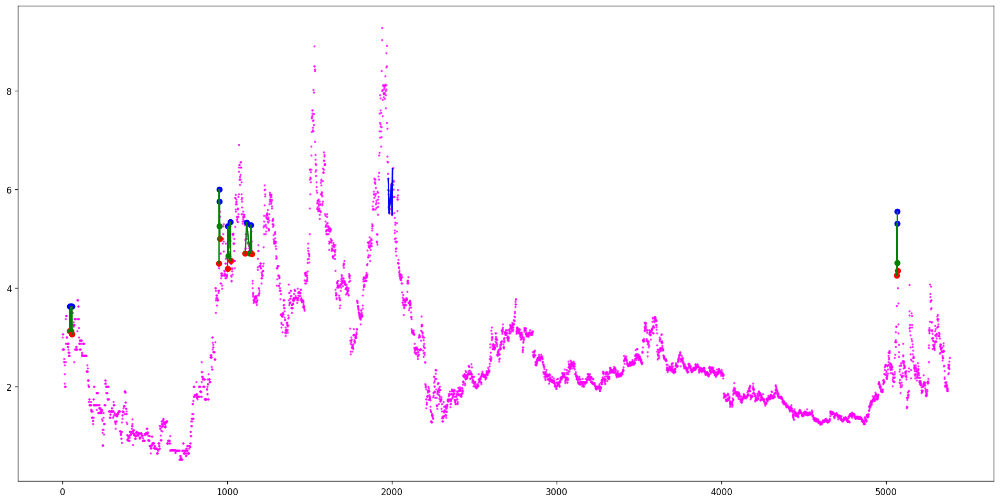

[(145, 147, 150, 151, 153), (187, 189, 191, 193, 196), (187, 190, 191, 193, 196), (310, 311, 312, 313, 315), (363, 364, 365, 366, 368), (398, 399, 402, 406, 408), (398, 399, 402, 407, 408), (398, 400, 402, 406, 408), (398, 400, 402, 407, 408), (719, 720, 728, 741, 746), (730, 731, 732, 736, 737), (730, 731, 737, 742, 744), (746, 747, 748, 759, 763), (868, 869, 872, 877, 878), (1028, 1029, 1030, 1038, 1043), (1059, 1061, 1067, 1071, 1073), (1059, 1061, 1067, 1084, 1085), (1059, 1061, 1067, 1087, 1089), (1059, 1061, 1067, 1093, 1094), (1067, 1068, 1073, 1084, 1085), (1067, 1068, 1073, 1087, 1089), (1067, 1068, 1073, 1093, 1094), (1073, 1076, 1085, 1087, 1089), (1073, 1076, 1085, 1093, 1094), (1086, 1087, 1089, 1093, 1094), (1114, 1115, 1116, 1134, 1136), (1195, 1196, 1199, 1200, 1202), (1195, 1196, 1199, 1201, 1202), (1229, 1230, 1232, 1234, 1237), (1273, 1274, 1276, 1282, 1285), (1313, 1314, 1316, 1318, 1320), (1313, 1314, 1316, 1319, 1320), (1312, 1314, 1320, 1322, 1324), (1324, 1325, 

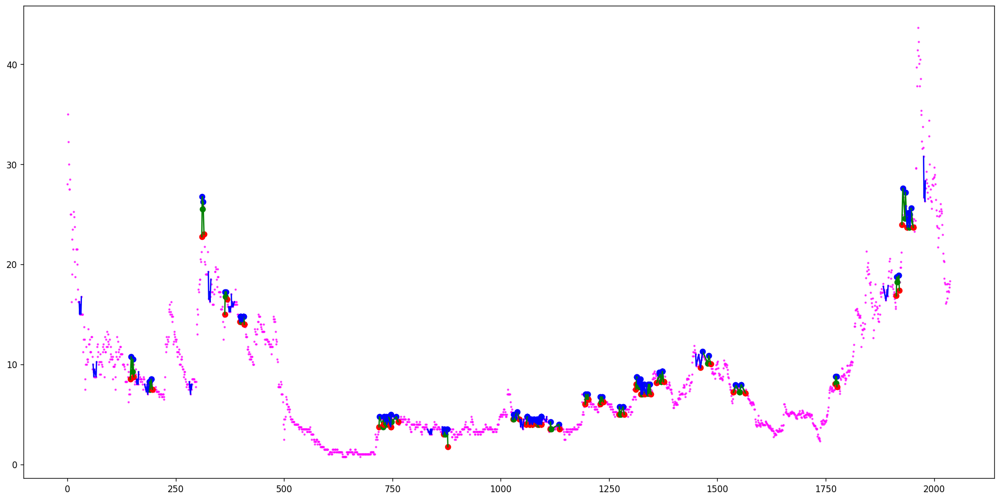

[(25, 26, 28, 29, 30), (77, 78, 83, 84, 85), (77, 79, 81, 82, 83), (134, 135, 137, 139, 140), (134, 136, 137, 139, 140), (175, 176, 178, 181, 184), (175, 176, 178, 182, 184), (220, 221, 227, 229, 242), (553, 554, 556, 557, 561), (553, 554, 556, 560, 561), (553, 555, 556, 557, 561), (553, 555, 556, 560, 561), (685, 687, 688, 689, 693), (1014, 1015, 1016, 1018, 1020), (1088, 1089, 1091, 1092, 1096), (1262, 1265, 1267, 1270, 1273), (1683, 1684, 1685, 1691, 1693), (1849, 1851, 1854, 1855, 1857), (1870, 1871, 1873, 1874, 1876), (2083, 2086, 2087, 2088, 2089), (2208, 2209, 2210, 2211, 2212), (2359, 2360, 2362, 2364, 2369), (2421, 2422, 2423, 2424, 2428), (2421, 2422, 2423, 2425, 2428), (2453, 2458, 2460, 2464, 2473), (2453, 2458, 2460, 2465, 2473), (2453, 2458, 2460, 2469, 2473), (2453, 2459, 2460, 2464, 2473), (2453, 2459, 2460, 2465, 2473), (2453, 2459, 2460, 2469, 2473), (2462, 2464, 2466, 2469, 2470), (2462, 2465, 2466, 2469, 2470), (2460, 2470, 2473, 2474, 2475), (2460, 2470, 2473, 2477

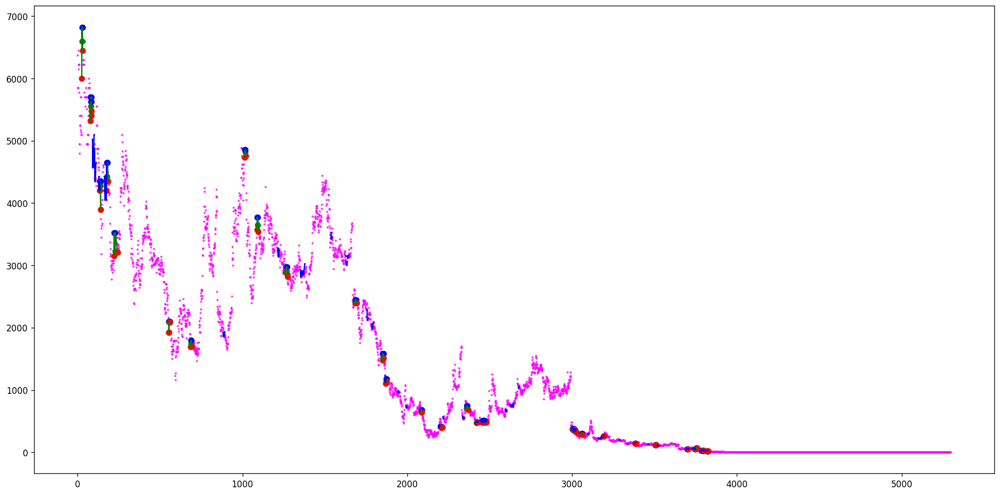

[(49, 53, 56, 59, 63), (82, 83, 84, 86, 87), (105, 132, 143, 180, 204), (105, 134, 143, 180, 204), (298, 300, 306, 310, 329), (298, 302, 304, 305, 306), (298, 302, 306, 310, 329), (298, 305, 306, 310, 329), (308, 315, 317, 320, 327), (318, 320, 322, 324, 325), (364, 367, 370, 373, 375), (376, 399, 403, 406, 410), (450, 456, 463, 468, 486), (463, 471, 473, 475, 484), (463, 471, 473, 477, 484), (530, 531, 533, 535, 536), (558, 560, 562, 565, 566), (568, 571, 573, 574, 575), (581, 582, 584, 585, 588), (592, 605, 608, 614, 620), (644, 647, 650, 652, 653), (686, 691, 697, 702, 724), (686, 695, 697, 698, 724), (701, 702, 703, 705, 708), (701, 707, 710, 717, 721), (701, 709, 710, 717, 721), (730, 740, 741, 742, 744), (756, 765, 769, 771, 785), (756, 765, 769, 777, 785), (756, 765, 769, 779, 785), (769, 771, 775, 777, 784), (769, 771, 775, 779, 784), (820, 833, 835, 836, 846), (820, 833, 835, 839, 846), (867, 870, 874, 880, 882), (1001, 1005, 1009, 1010, 1012), (996, 1005, 1013, 1016, 1019), (

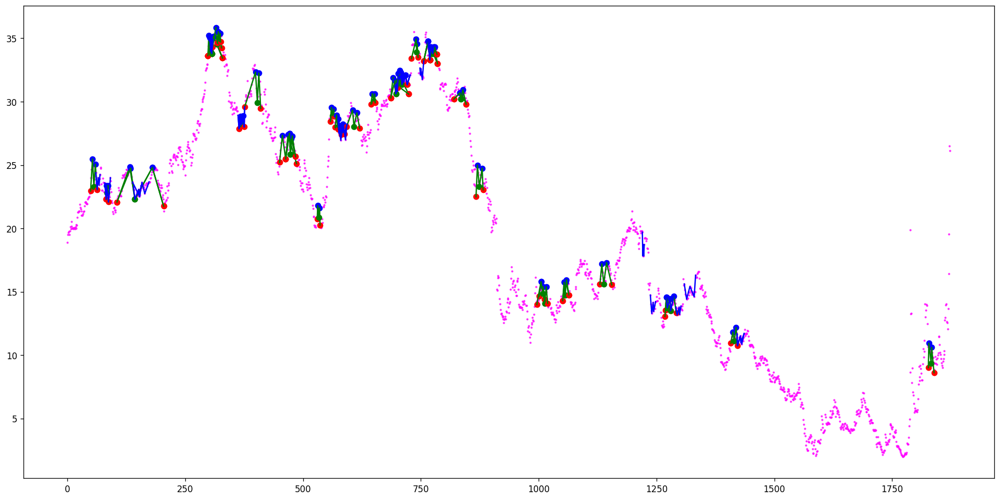

[(65, 67, 69, 70, 72), (65, 68, 69, 70, 72), (89, 90, 92, 93, 94), (147, 148, 149, 150, 151), (262, 263, 265, 267, 269), (307, 308, 309, 310, 311), (620, 623, 626, 634, 638), (920, 923, 925, 931, 937), (1098, 1114, 1120, 1127, 1136), (1276, 1285, 1291, 1293, 1303), (1276, 1285, 1291, 1295, 1303), (1362, 1365, 1369, 1374, 1377), (1412, 1413, 1417, 1420, 1422), (1523, 1528, 1536, 1539, 1546), (1682, 1683, 1685, 1686, 1690), (1720, 1722, 1724, 1729, 1739), (1726, 1729, 1732, 1736, 1739), (2115, 2117, 2121, 2125, 2129), (2612, 2615, 2617, 2619, 2620), (2795, 2799, 2802, 2804, 2813), (2973, 2975, 2977, 2985, 2992), (4313, 4314, 4315, 4316, 4317), (4328, 4329, 4335, 4339, 4342), (4392, 4395, 4402, 4418, 4429), (4405, 4408, 4412, 4418, 4423), (4704, 4705, 4710, 4711, 4715), (4781, 4783, 4785, 4786, 4789), (4781, 4783, 4785, 4788, 4789), (4846, 4849, 4850, 4851, 4861), (4935, 4937, 4938, 4940, 4941), (4944, 4945, 4947, 4949, 4950), (4944, 4946, 4947, 4949, 4950), (4953, 4957, 4960, 4961, 4962)

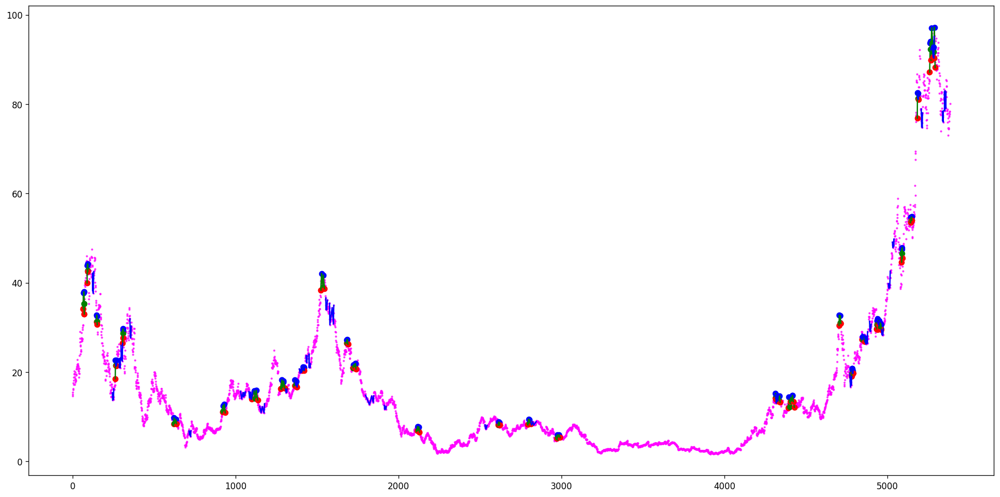

[(279, 280, 281, 283, 284), (293, 294, 297, 298, 299), (350, 353, 354, 356, 362), (444, 447, 450, 452, 453), (540, 541, 544, 546, 549), (540, 543, 544, 546, 549), (590, 592, 597, 599, 602), (696, 699, 700, 705, 707), (725, 727, 728, 729, 730), (724, 727, 730, 731, 734), (724, 729, 730, 731, 734), (736, 741, 744, 746, 748), (801, 806, 807, 810, 812), (891, 894, 896, 897, 898), (917, 919, 920, 921, 926), (920, 921, 922, 923, 925), (933, 936, 937, 938, 939), (956, 959, 962, 964, 967), (997, 1001, 1004, 1005, 1007), (1066, 1075, 1076, 1077, 1078), (1160, 1161, 1162, 1163, 1169), (1349, 1362, 1364, 1370, 1377), (1349, 1362, 1364, 1372, 1377), (1480, 1481, 1483, 1488, 1505), (1484, 1490, 1492, 1495, 1500), (1483, 1497, 1500, 1502, 1505), (1483, 1497, 1500, 1503, 1505), (1681, 1685, 1687, 1688, 1689), (1697, 1699, 1700, 1701, 1707), (1700, 1701, 1702, 1704, 1706), (1748, 1749, 1750, 1752, 1759), (1748, 1749, 1750, 1754, 1759), (1836, 1837, 1841, 1843, 1844), (1863, 1864, 1866, 1867, 1868), (1

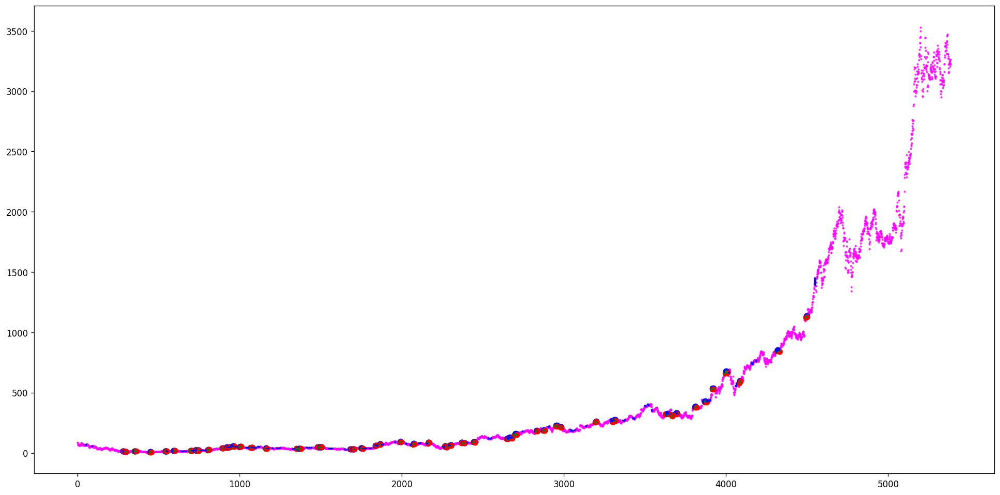

[(50, 52, 56, 59, 68), (75, 76, 77, 79, 84), (101, 104, 106, 107, 108), (139, 141, 142, 144, 152), (139, 147, 152, 154, 156), (209, 214, 216, 217, 218), (221, 230, 233, 237, 246), (324, 325, 326, 327, 328), (560, 561, 564, 567, 570), (560, 563, 564, 565, 570), (560, 563, 564, 567, 570), (579, 582, 586, 591, 600), (586, 588, 589, 591, 599), (590, 591, 592, 594, 596), (613, 614, 616, 617, 618), (621, 623, 626, 627, 629), (657, 658, 660, 661, 662), (668, 669, 670, 672, 676), (668, 672, 676, 677, 680), (668, 679, 680, 681, 682), (694, 696, 697, 698, 699), (713, 714, 715, 716, 717), (751, 753, 755, 757, 763), (751, 753, 755, 759, 763), (826, 828, 830, 832, 834), (969, 973, 974, 975, 979), (1006, 1008, 1011, 1012, 1018), (1000, 1014, 1021, 1027, 1050), (1026, 1027, 1030, 1031, 1038), (1066, 1068, 1071, 1072, 1078), (1081, 1084, 1086, 1087, 1092), (1081, 1084, 1086, 1090, 1092), (1121, 1124, 1125, 1127, 1128), (1171, 1172, 1173, 1175, 1186), (1173, 1175, 1176, 1178, 1186), (1190, 1192, 1194, 

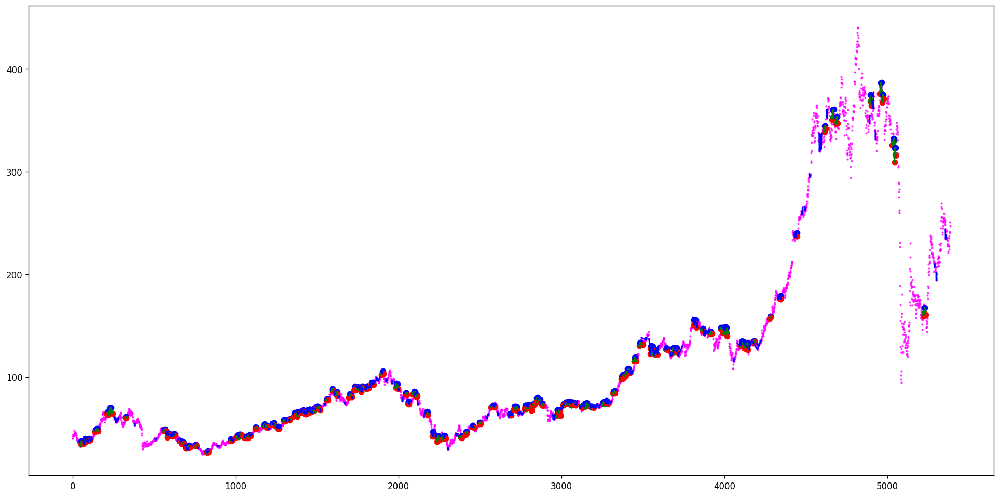

[(2, 3, 4, 5, 6), (9, 11, 12, 14, 15), (83, 85, 86, 87, 88), (112, 114, 120, 124, 135), (112, 114, 135, 138, 153), (112, 124, 135, 138, 153), (135, 141, 144, 151, 153), (300, 303, 304, 305, 310), (295, 305, 310, 317, 324), (312, 313, 315, 317, 320), (329, 330, 331, 332, 333), (375, 398, 408, 422, 423), (600, 601, 603, 604, 605), (609, 610, 611, 615, 618), (611, 613, 614, 615, 618), (692, 693, 694, 695, 697), (764, 774, 775, 776, 779), (799, 800, 801, 802, 803), (913, 914, 915, 916, 917), (930, 932, 935, 938, 945), (954, 956, 958, 962, 964), (1000, 1003, 1006, 1008, 1018), (1007, 1008, 1010, 1013, 1015), (1194, 1195, 1196, 1197, 1198), (1216, 1218, 1219, 1220, 1221), (1298, 1299, 1300, 1301, 1302), (1531, 1532, 1534, 1535, 1540), (1593, 1594, 1596, 1598, 1601)]
[(94, 96, 98, 99, 101), (108, 112, 114, 120, 138), (108, 112, 114, 135, 138), (114, 120, 124, 135, 138), (386, 387, 388, 390, 393), (398, 408, 422, 423, 426), (426, 427, 428, 429, 430), (591, 598, 601, 608, 610), (591, 600, 601, 

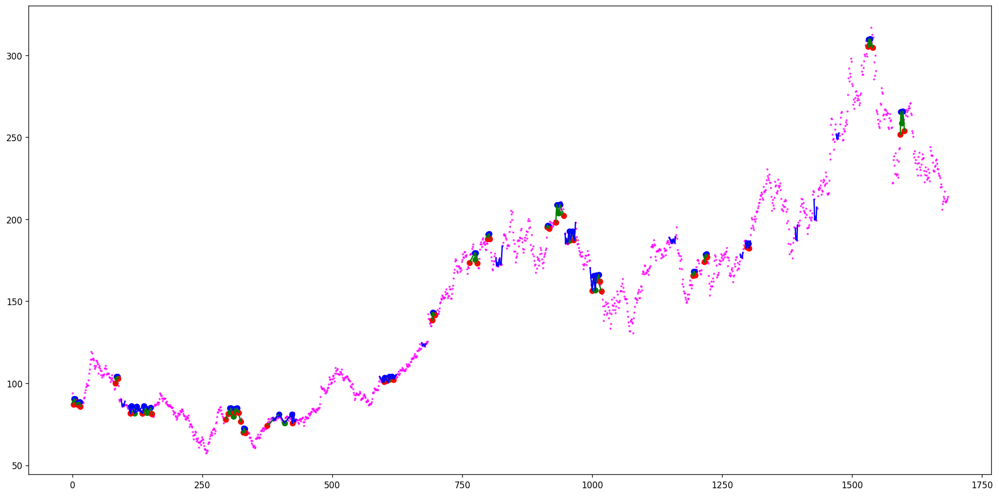

[(176, 178, 180, 182, 183), (201, 202, 203, 204, 206), (265, 267, 268, 270, 274), (956, 966, 974, 982, 988), (1014, 1015, 1017, 1019, 1024), (1067, 1069, 1071, 1072, 1073), (1234, 1235, 1238, 1239, 1240), (1275, 1279, 1283, 1286, 1289), (1388, 1389, 1391, 1393, 1394), (1423, 1424, 1426, 1429, 1433), (1472, 1476, 1477, 1480, 1486), (1579, 1581, 1583, 1585, 1589), (1700, 1701, 1704, 1705, 1706), (1713, 1714, 1715, 1716, 1720), (1747, 1750, 1751, 1752, 1754), (1800, 1803, 1804, 1805, 1806), (1830, 1831, 1835, 1836, 1839), (1917, 1918, 1920, 1921, 1923), (2003, 2004, 2005, 2006, 2007), (2075, 2076, 2077, 2078, 2079), (2149, 2150, 2151, 2152, 2153), (2380, 2382, 2383, 2384, 2389), (2380, 2382, 2383, 2386, 2389), (2383, 2384, 2385, 2386, 2389), (2453, 2463, 2465, 2466, 2468), (2535, 2536, 2537, 2538, 2540), (2542, 2543, 2544, 2546, 2548), (2557, 2561, 2567, 2573, 2576), (2557, 2563, 2567, 2573, 2576), (2567, 2569, 2571, 2573, 2576), (2645, 2646, 2647, 2648, 2649), (2649, 2651, 2652, 2654, 26

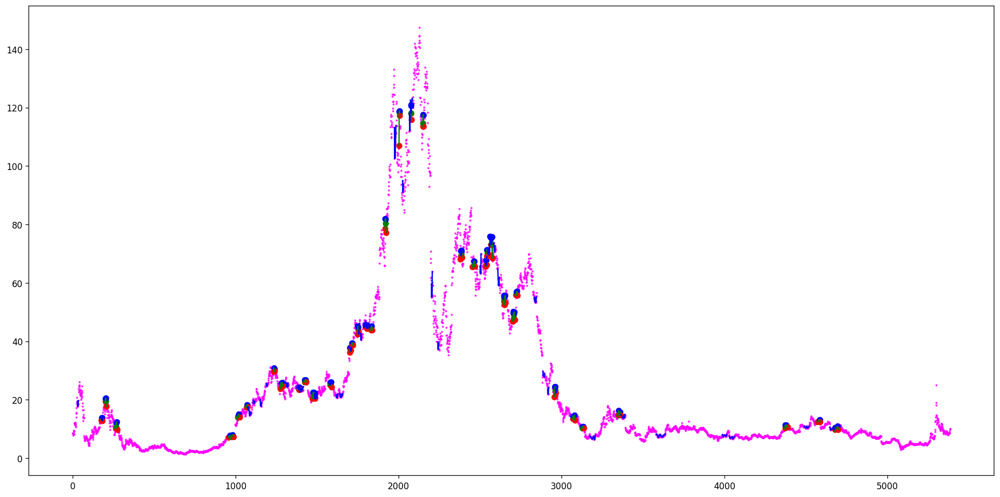

[(67, 68, 70, 72, 82), (257, 259, 260, 262, 263), (485, 486, 487, 488, 489)]
[(157, 158, 159, 162, 163), (167, 168, 169, 170, 171), (206, 209, 218, 221, 228), (237, 238, 240, 241, 247), (256, 257, 259, 263, 264), (306, 307, 308, 309, 310), (317, 318, 319, 320, 321), (422, 424, 426, 433, 435), (587, 588, 590, 593, 597), (1762, 1763, 1767, 1774, 1781)]
Ticker BTC-USD found 3 double top patterns, 10 double bottom patterns


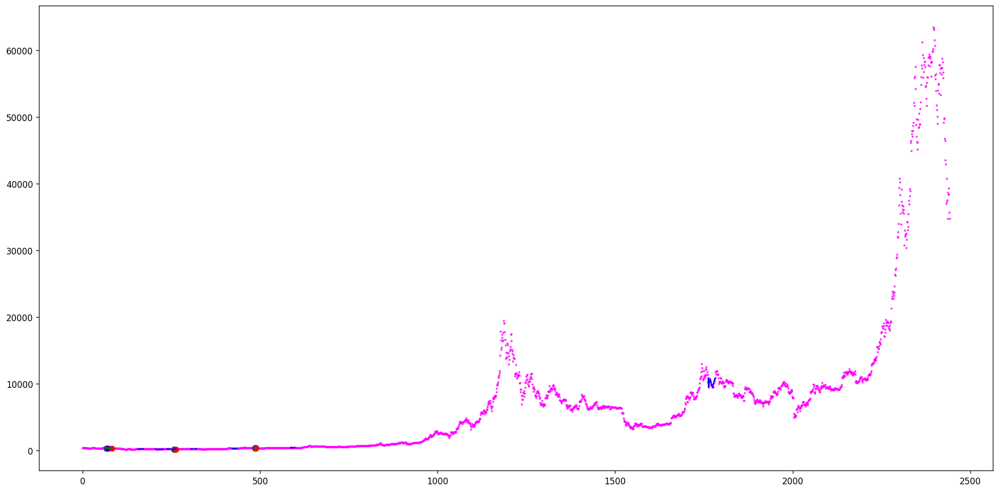

[(96, 97, 100, 101, 120), (96, 99, 100, 101, 120), (100, 107, 108, 111, 120), (96, 115, 120, 135, 146), (96, 115, 120, 139, 146), (96, 115, 120, 142, 146), (96, 117, 120, 135, 146), (96, 118, 120, 126, 146), (96, 118, 120, 135, 146), (120, 126, 132, 135, 146), (120, 131, 132, 135, 146), (134, 135, 138, 139, 146), (75, 144, 156, 165, 170), (156, 157, 162, 163, 170), (177, 182, 189, 199, 204), (177, 184, 189, 196, 204), (177, 184, 189, 199, 204), (177, 187, 189, 196, 204), (247, 258, 267, 271, 286), (247, 258, 267, 277, 286), (247, 261, 267, 271, 286), (239, 277, 287, 297, 300), (363, 382, 395, 408, 411), (340, 382, 412, 419, 420), (450, 456, 464, 471, 474), (450, 458, 464, 471, 474), (450, 461, 464, 471, 474), (448, 471, 478, 482, 512), (448, 477, 478, 482, 512), (478, 482, 487, 488, 497), (478, 482, 487, 491, 497), (635, 637, 641, 644, 679), (653, 656, 665, 667, 669), (653, 664, 665, 667, 669), (681, 685, 694, 697, 704), (681, 689, 694, 697, 704), (868, 876, 885, 886, 903), (868, 876, 

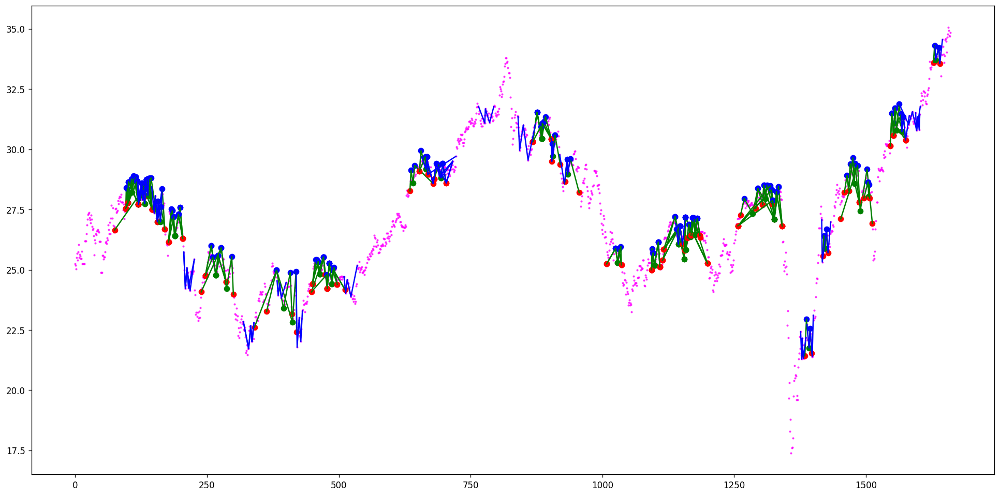

[(268, 269, 270, 272, 276), (285, 286, 287, 289, 290), (572, 574, 575, 577, 579), (594, 595, 598, 600, 604), (1690, 1691, 1692, 1693, 1694), (1758, 1759, 1760, 1768, 1769)]
[(269, 270, 272, 276, 278), (620, 621, 622, 623, 626), (810, 811, 812, 813, 814), (1077, 1078, 1079, 1081, 1082), (1216, 1217, 1218, 1219, 1220), (1283, 1284, 1285, 1287, 1289), (1368, 1369, 1370, 1371, 1372), (1594, 1597, 1598, 1599, 1605), (1750, 1751, 1752, 1753, 1754), (1797, 1799, 1800, 1801, 1809), (1904, 1907, 1909, 1910, 1912)]
Ticker ETH-USD found 6 double top patterns, 11 double bottom patterns


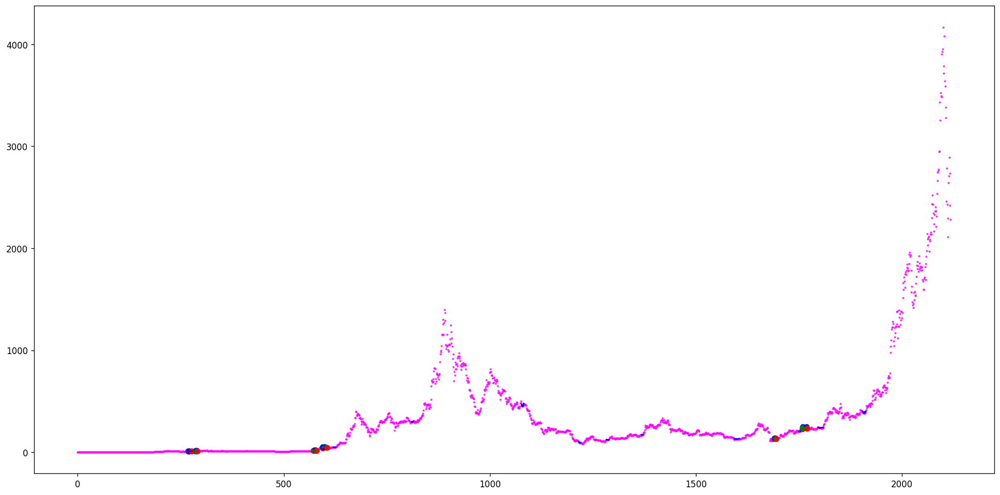

[(3, 4, 9, 10, 13), (89, 91, 92, 95, 97), (105, 106, 109, 111, 113), (158, 159, 160, 161, 165), (169, 170, 175, 179, 181), (168, 170, 185, 189, 196), (168, 170, 185, 191, 196), (169, 173, 175, 179, 181), (169, 174, 175, 177, 181), (169, 174, 175, 178, 181), (169, 174, 175, 179, 181), (187, 191, 193, 194, 195), (207, 209, 213, 214, 215), (207, 212, 213, 214, 215), (200, 214, 216, 221, 224), (224, 225, 226, 228, 231), (258, 259, 260, 261, 264), (294, 299, 303, 304, 306), (279, 299, 315, 325, 347), (308, 309, 311, 312, 315), (308, 309, 311, 314, 315), (321, 328, 330, 332, 334), (366, 370, 374, 385, 406), (366, 370, 374, 387, 406), (366, 370, 374, 390, 406), (374, 377, 380, 383, 406), (382, 385, 386, 387, 400), (436, 438, 439, 443, 448), (474, 475, 477, 479, 480), (860, 866, 876, 885, 889), (996, 997, 1002, 1005, 1018), (996, 997, 1002, 1008, 1018), (1668, 1683, 1687, 1729, 1742), (1899, 1902, 1906, 1909, 1914), (1953, 1955, 1961, 1968, 1973), (1953, 1955, 1961, 1970, 1973), (2023, 2031, 2

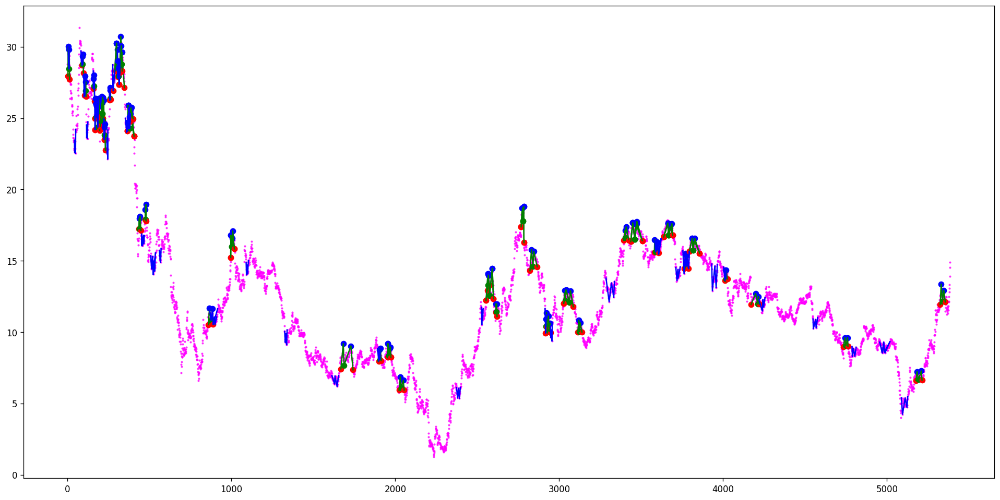

[(23, 24, 25, 26, 28), (40, 41, 45, 46, 47), (52, 54, 55, 58, 60), (132, 134, 135, 137, 138), (132, 134, 138, 141, 144), (132, 134, 138, 143, 144), (132, 137, 138, 141, 144), (338, 341, 345, 346, 348), (409, 411, 412, 413, 414), (408, 411, 414, 419, 422), (408, 413, 414, 415, 422), (448, 449, 451, 452, 455), (488, 489, 490, 491, 492), (576, 578, 579, 581, 583), (588, 590, 591, 594, 595), (584, 598, 599, 600, 601), (618, 619, 620, 622, 624), (633, 636, 639, 646, 648), (669, 673, 675, 677, 679), (710, 717, 721, 728, 731), (749, 752, 757, 758, 760), (749, 756, 757, 758, 760), (776, 780, 782, 785, 787), (871, 872, 874, 876, 878), (880, 881, 882, 883, 885), (879, 883, 888, 889, 897), (891, 892, 893, 894, 895), (897, 900, 902, 908, 911), (968, 969, 971, 972, 973), (957, 975, 978, 986, 989), (998, 999, 1000, 1001, 1003), (991, 1005, 1006, 1007, 1008), (1009, 1017, 1018, 1020, 1021), (1067, 1068, 1070, 1072, 1073), (1084, 1085, 1086, 1089, 1122), (1086, 1093, 1095, 1105, 1122), (1095, 1097, 10

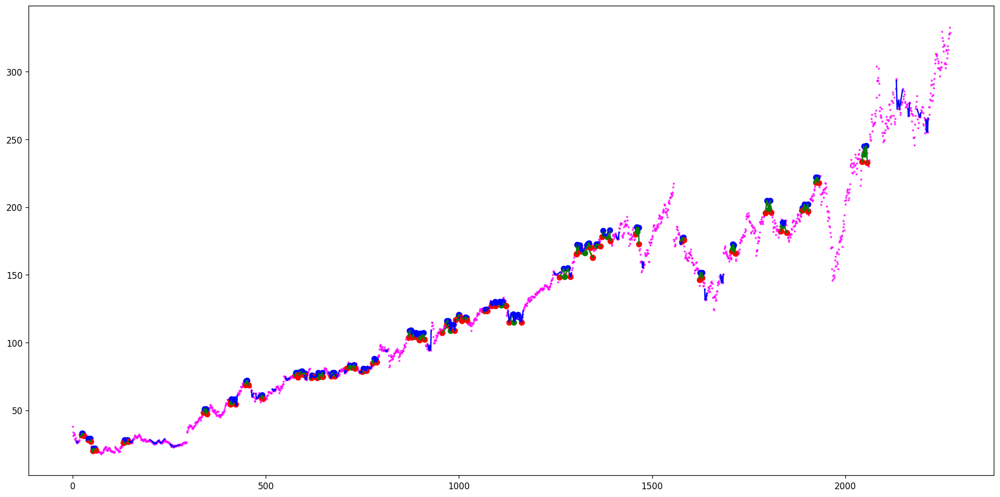

[(128, 131, 133, 137, 140), (141, 145, 154, 157, 161), (168, 173, 174, 176, 178), (687, 689, 692, 693, 698), (765, 770, 775, 776, 781), (854, 858, 868, 870, 875), (854, 864, 868, 870, 875), (935, 941, 948, 951, 955), (935, 943, 948, 951, 955), (1041, 1044, 1050, 1061, 1067), (1041, 1044, 1050, 1064, 1067), (1077, 1079, 1080, 1082, 1084), (1152, 1160, 1161, 1163, 1165), (1190, 1194, 1195, 1198, 1201), (1207, 1215, 1233, 1236, 1245), (1248, 1251, 1253, 1259, 1267), (1303, 1308, 1310, 1312, 1318), (1343, 1344, 1350, 1351, 1353), (1343, 1348, 1350, 1351, 1353), (1422, 1424, 1425, 1429, 1431), (1529, 1531, 1532, 1533, 1534), (1535, 1536, 1538, 1539, 1540), (1550, 1560, 1562, 1564, 1565), (1594, 1595, 1597, 1598, 1599), (1632, 1634, 1646, 1649, 1655), (1638, 1639, 1642, 1643, 1644), (1824, 1826, 1828, 1829, 1830), (1912, 1913, 1918, 1920, 1922), (1912, 1916, 1918, 1920, 1922), (2055, 2063, 2067, 2068, 2071), (2055, 2066, 2067, 2068, 2071), (2085, 2086, 2088, 2090, 2091), (2123, 2126, 2129, 2

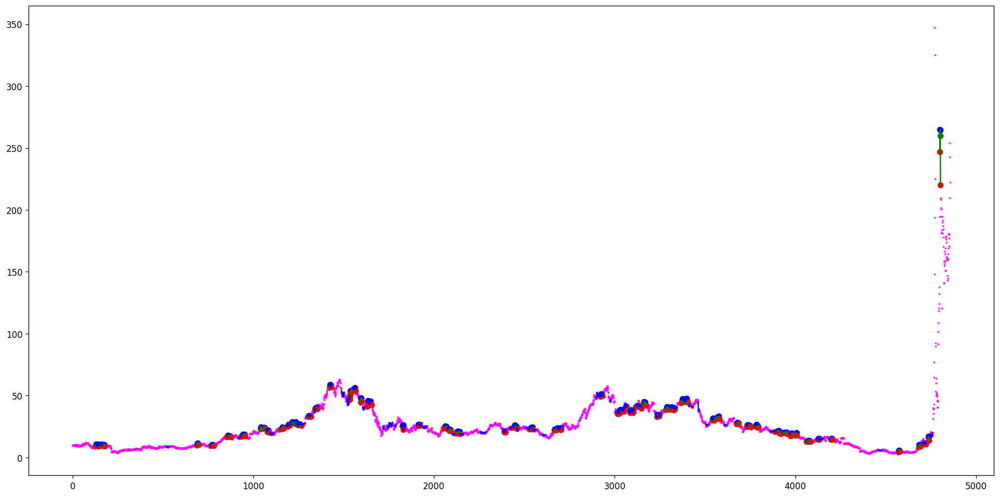

[(31, 32, 33, 34, 36), (158, 159, 160, 162, 164), (177, 178, 179, 180, 181), (267, 269, 272, 275, 291), (335, 336, 337, 338, 344), (470, 471, 472, 473, 474), (509, 510, 511, 512, 513), (526, 527, 528, 530, 531), (619, 620, 621, 622, 623), (852, 853, 855, 856, 857), (948, 951, 953, 955, 956), (1280, 1282, 1285, 1286, 1289), (1280, 1282, 1285, 1287, 1289), (1348, 1349, 1350, 1351, 1355), (1377, 1378, 1379, 1380, 1381), (1383, 1384, 1385, 1386, 1387), (1551, 1552, 1553, 1558, 1571), (1556, 1558, 1559, 1560, 1561), (1608, 1609, 1610, 1612, 1618), (1706, 1707, 1708, 1709, 1710), (1879, 1883, 1884, 1885, 1887), (1943, 1944, 1945, 1946, 1947), (1963, 1964, 1965, 1966, 1967), (2013, 2015, 2017, 2018, 2021), (2285, 2286, 2287, 2288, 2289), (2391, 2396, 2399, 2402, 2405), (2478, 2485, 2487, 2491, 2505), (2476, 2498, 2512, 2539, 2553), (2543, 2544, 2545, 2546, 2547), (2512, 2546, 2547, 2550, 2551), (2696, 2698, 2700, 2702, 2718), (2696, 2715, 2719, 2729, 2733), (2719, 2720, 2723, 2726, 2733), (27

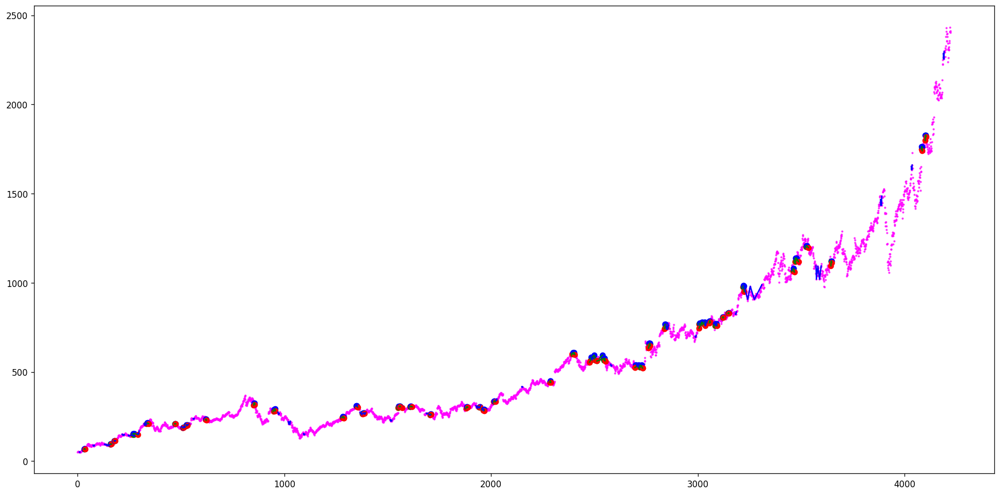

[(5, 7, 8, 9, 10), (4, 9, 10, 11, 17), (24, 25, 26, 27, 28), (28, 30, 31, 32, 33), (77, 78, 79, 82, 84), (92, 93, 95, 97, 104), (96, 97, 98, 99, 100), (167, 169, 170, 172, 173), (211, 212, 213, 215, 216), (218, 224, 231, 234, 236), (219, 227, 229, 230, 231), (274, 277, 279, 283, 285), (325, 327, 328, 330, 342), (357, 359, 361, 362, 365), (355, 368, 370, 375, 379), (384, 385, 386, 387, 388), (383, 385, 389, 399, 412), (383, 387, 389, 399, 412), (389, 391, 392, 394, 403), (392, 394, 395, 396, 403), (405, 407, 408, 409, 410), (465, 467, 473, 475, 476), (490, 492, 495, 497, 499), (518, 521, 525, 529, 531), (590, 591, 592, 594, 595), (657, 658, 660, 661, 662), (736, 738, 740, 741, 743), (781, 791, 793, 794, 797), (781, 791, 793, 796, 797), (793, 794, 795, 796, 797), (834, 835, 836, 837, 839), (840, 842, 843, 844, 846), (861, 869, 872, 877, 890), (872, 873, 875, 877, 889), (878, 880, 882, 886, 887), (859, 888, 892, 893, 896), (908, 913, 914, 915, 917), (926, 932, 939, 948, 956), (958, 959, 9

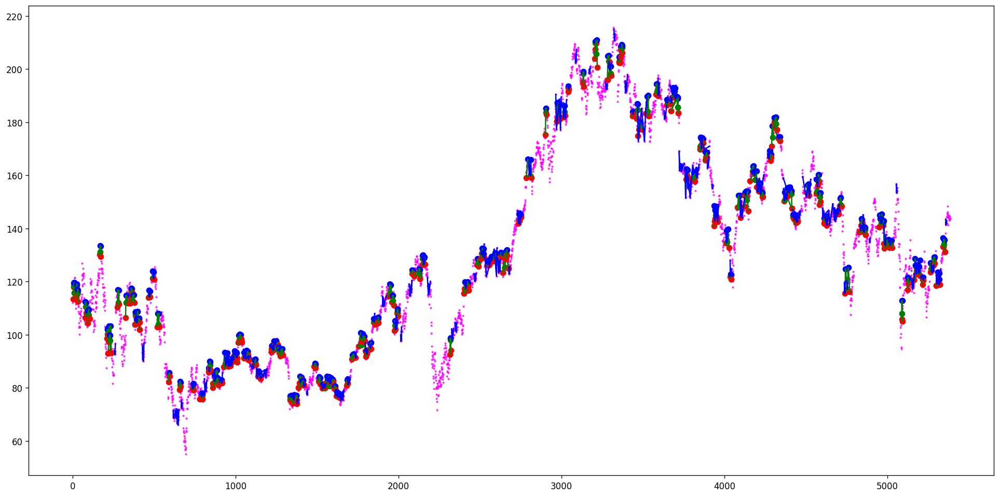

[(9, 13, 14, 15, 16), (143, 144, 145, 146, 151), (142, 146, 152, 155, 158), (142, 148, 152, 155, 158), (190, 192, 198, 199, 202), (190, 196, 198, 199, 202), (216, 217, 220, 222, 224), (229, 233, 235, 236, 237), (243, 250, 265, 280, 286), (324, 330, 333, 334, 340), (322, 330, 342, 345, 365), (322, 334, 342, 345, 365), (410, 414, 418, 422, 430), (449, 454, 458, 462, 477), (573, 583, 609, 628, 631), (580, 593, 596, 598, 600), (573, 593, 609, 628, 631), (616, 619, 620, 625, 630), (616, 619, 620, 628, 630), (642, 643, 644, 645, 649), (640, 663, 682, 697, 700), (670, 674, 675, 677, 678), (718, 723, 728, 729, 743), (718, 723, 728, 738, 743), (728, 729, 732, 738, 743), (801, 806, 813, 823, 824), (886, 907, 913, 921, 929), (886, 907, 913, 925, 929), (1062, 1077, 1099, 1111, 1141), (1102, 1122, 1124, 1136, 1140), (1270, 1299, 1328, 1343, 1495), (1328, 1360, 1380, 1399, 1451), (1328, 1360, 1380, 1403, 1451), (1391, 1403, 1412, 1415, 1436), (1391, 1403, 1412, 1427, 1436), (1413, 1415, 1422, 1427, 

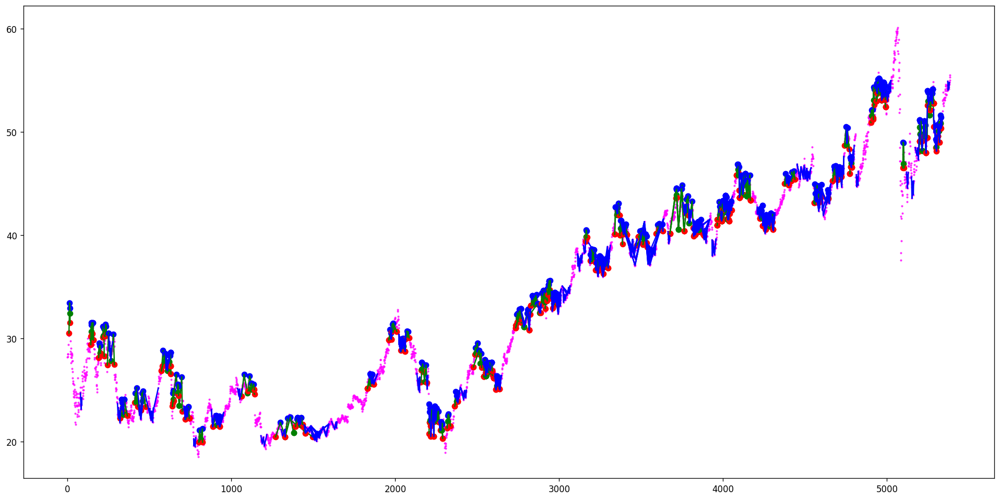

[(2121, 2123, 2126, 2133, 2137), (2149, 2150, 2152, 2154, 2155), (2160, 2161, 2164, 2165, 2167), (2270, 2271, 2272, 2274, 2275), (2364, 2368, 2370, 2373, 2374), (2717, 2719, 2727, 2728, 2732), (2858, 2860, 2861, 2862, 2863), (2909, 2910, 2912, 2915, 2923), (2947, 2950, 2951, 2952, 2955), (2957, 2959, 2963, 2964, 2968), (2957, 2961, 2963, 2964, 2968), (3027, 3030, 3031, 3033, 3034), (3046, 3047, 3048, 3049, 3050), (3053, 3055, 3058, 3060, 3061), (3083, 3085, 3092, 3094, 3099), (3083, 3085, 3092, 3096, 3099), (3083, 3089, 3092, 3094, 3099), (3083, 3091, 3092, 3094, 3099), (3104, 3106, 3107, 3110, 3111), (3112, 3114, 3115, 3116, 3118), (3126, 3128, 3129, 3130, 3131), (3132, 3139, 3142, 3143, 3146), (3132, 3141, 3142, 3143, 3146), (3166, 3167, 3169, 3170, 3176), (3210, 3212, 3213, 3214, 3215), (3386, 3387, 3388, 3389, 3390), (3443, 3444, 3445, 3446, 3447), (3579, 3581, 3583, 3584, 3608), (3583, 3584, 3587, 3588, 3589), (3596, 3597, 3598, 3599, 3600), (3589, 3599, 3602, 3605, 3608), (3589, 

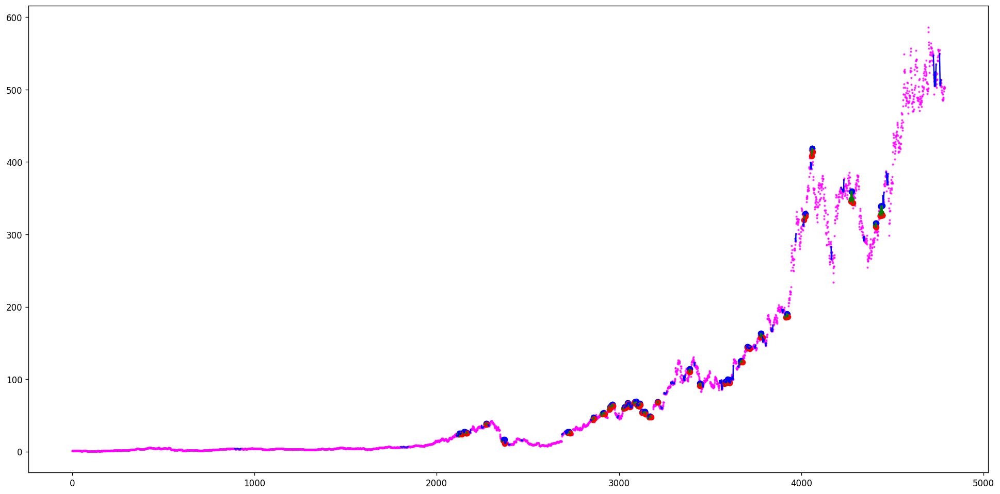

[(8, 9, 10, 13, 17), (12, 13, 14, 15, 17), (12, 13, 14, 16, 17), (219, 221, 222, 223, 224), (331, 334, 343, 348, 353), (357, 358, 359, 360, 361), (412, 413, 414, 415, 416), (467, 470, 472, 475, 477), (480, 482, 485, 486, 488), (508, 509, 510, 511, 513), (514, 517, 518, 521, 522), (586, 587, 589, 594, 597), (684, 685, 687, 688, 691), (777, 779, 781, 783, 788), (835, 837, 839, 841, 847), (833, 845, 848, 856, 875), (850, 860, 864, 867, 870), (850, 860, 864, 868, 870), (1030, 1031, 1033, 1034, 1039), (1218, 1226, 1233, 1235, 1239), (1346, 1354, 1366, 1374, 1380), (1688, 1706, 1709, 1716, 1720), (1731, 1734, 1739, 1760, 1761), (1861, 1863, 1866, 1868, 1869), (1904, 1905, 1906, 1909, 1910), (1937, 1946, 1952, 1954, 1957), (1976, 1977, 1979, 1982, 1983), (1986, 1987, 1989, 1990, 1991), (1986, 1990, 1992, 1995, 1998), (1993, 1995, 1996, 1997, 1998), (2070, 2075, 2081, 2082, 2083), (2150, 2152, 2157, 2160, 2161), (2150, 2154, 2157, 2160, 2161), (2217, 2220, 2221, 2223, 2225), (2247, 2253, 2260,

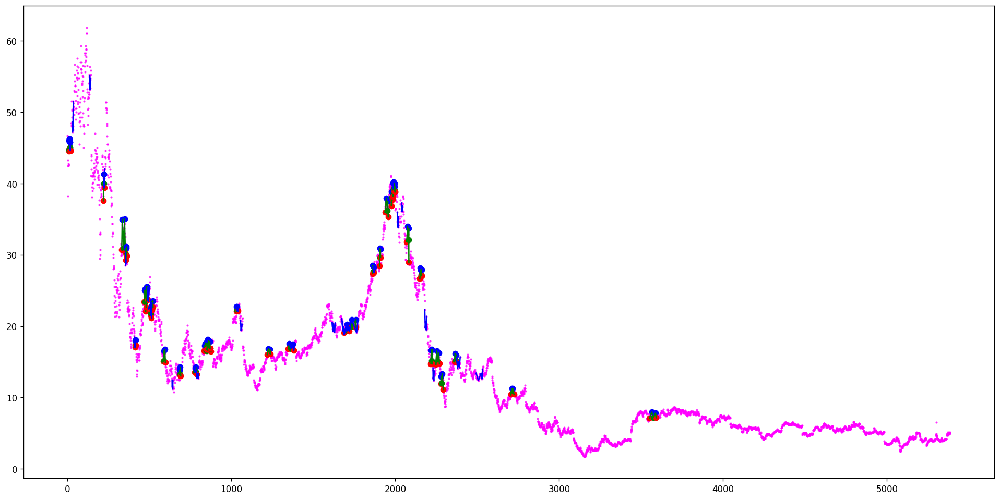

[(358, 360, 362, 363, 364), (397, 401, 405, 409, 410), (508, 509, 510, 511, 513), (540, 541, 544, 545, 547), (966, 967, 974, 982, 988), (1352, 1367, 1380, 1386, 1391), (1570, 1573, 1576, 1577, 1580), (1685, 1686, 1687, 1688, 1690), (1685, 1688, 1690, 1691, 1694), (1800, 1801, 1802, 1803, 1806), (1847, 1848, 1852, 1855, 1857), (1886, 1897, 1899, 1903, 1906), (1925, 1929, 1930, 1932, 1933), (1942, 1946, 1948, 1951, 1954), (1957, 1958, 1960, 1962, 1964), (1976, 1977, 1979, 1980, 1981), (1996, 1997, 1998, 1999, 2000), (2013, 2015, 2017, 2018, 2019), (2024, 2025, 2027, 2028, 2030), (2093, 2094, 2095, 2096, 2098), (2093, 2096, 2098, 2099, 2100), (2112, 2114, 2115, 2117, 2119), (2189, 2191, 2193, 2196, 2197), (2206, 2207, 2209, 2212, 2214), (2325, 2330, 2343, 2346, 2349), (2408, 2413, 2415, 2417, 2419), (2563, 2565, 2567, 2569, 2576), (2556, 2565, 2580, 2585, 2589), (2556, 2569, 2580, 2585, 2589), (2780, 2781, 2782, 2783, 2785), (2822, 2823, 2824, 2825, 2827), (2843, 2848, 2851, 2857, 2858), 

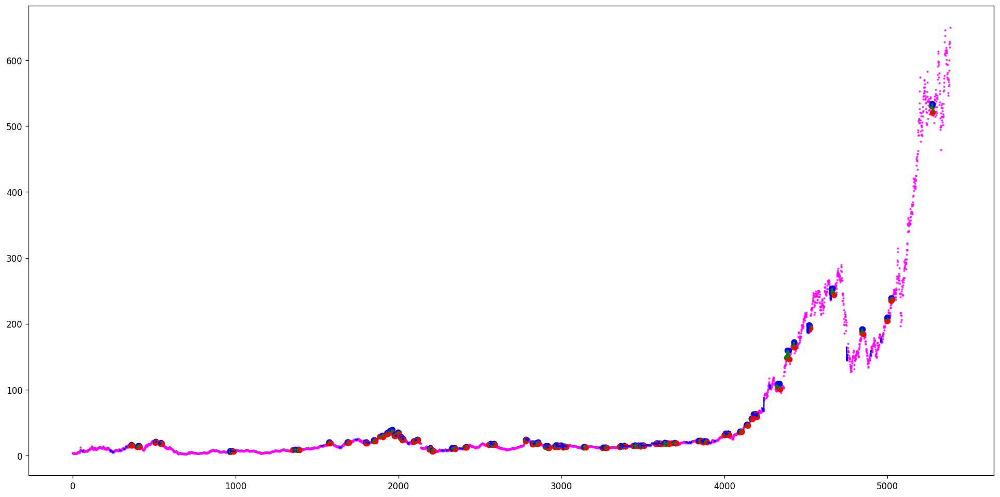

[(652, 655, 672, 676, 680), (654, 658, 660, 661, 664), (736, 737, 740, 741, 743), (753, 755, 756, 757, 758), (775, 776, 778, 780, 781), (813, 814, 816, 818, 826), (879, 880, 882, 883, 885), (919, 922, 923, 924, 925), (983, 984, 985, 986, 988), (1110, 1112, 1115, 1117, 1118), (1123, 1124, 1125, 1126, 1128), (1371, 1372, 1373, 1374, 1375), (1673, 1674, 1676, 1677, 1678), (1724, 1728, 1730, 1731, 1732), (1778, 1781, 1789, 1793, 1796), (1779, 1783, 1786, 1787, 1789), (1820, 1823, 1824, 1825, 1826), (1820, 1825, 1826, 1827, 1832), (1820, 1825, 1826, 1829, 1832), (1852, 1855, 1857, 1859, 1861), (1872, 1874, 1876, 1877, 1878), (1880, 1881, 1882, 1884, 1886), (1943, 1945, 1949, 1951, 1960), (1943, 1945, 1949, 1953, 1960), (1943, 1947, 1949, 1951, 1960), (1943, 1948, 1949, 1951, 1960), (1949, 1951, 1952, 1953, 1960), (1952, 1953, 1957, 1958, 1960), (1960, 1961, 1962, 1966, 1971), (1965, 1966, 1967, 1968, 1969), (1984, 1985, 1986, 1988, 1990), (2004, 2006, 2008, 2011, 2013), (2035, 2036, 2038, 2

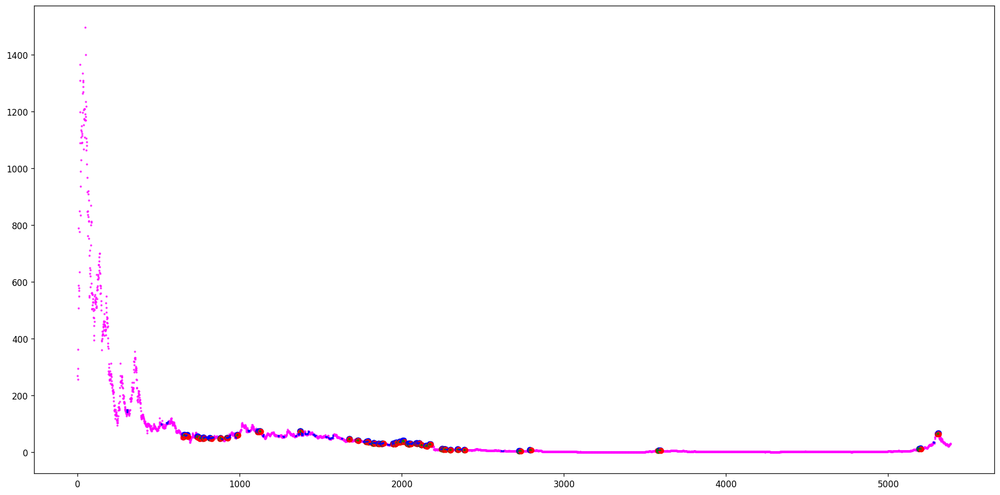

[(162, 163, 164, 166, 167), (198, 199, 200, 202, 204), (269, 270, 272, 274, 276), (305, 306, 307, 308, 309), (305, 308, 309, 310, 311), (333, 334, 336, 337, 341), (333, 334, 336, 339, 341), (336, 337, 338, 339, 340), (347, 348, 350, 351, 352), (383, 385, 388, 389, 391), (466, 471, 480, 482, 484), (495, 497, 499, 500, 502), (543, 545, 549, 551, 553), (591, 596, 599, 606, 607), (591, 606, 607, 611, 613), (699, 703, 705, 706, 707), (724, 727, 728, 729, 733), (724, 727, 728, 731, 733), (740, 742, 744, 746, 749), (756, 762, 765, 766, 768), (753, 762, 768, 770, 775), (958, 963, 965, 967, 969), (1039, 1041, 1045, 1047, 1059), (1045, 1047, 1051, 1056, 1059), (1045, 1049, 1051, 1052, 1059), (1086, 1089, 1091, 1093, 1097), (1120, 1127, 1141, 1142, 1153), (1120, 1129, 1141, 1142, 1153), (1141, 1142, 1148, 1149, 1153), (1202, 1203, 1204, 1206, 1207), (1233, 1235, 1238, 1239, 1253), (1238, 1244, 1247, 1250, 1253), (1233, 1252, 1257, 1260, 1264), (1233, 1252, 1257, 1262, 1264), (1291, 1293, 1297, 12

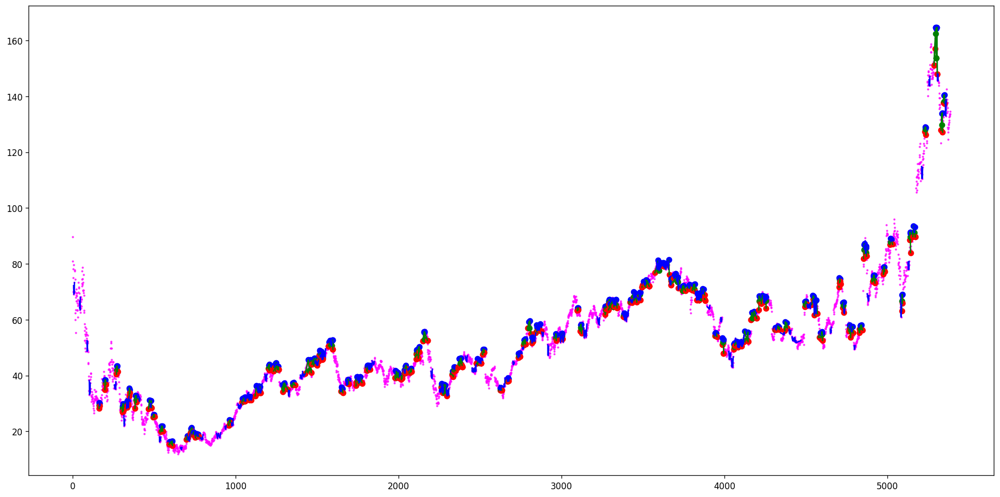

[(10, 11, 12, 13, 14), (24, 25, 26, 27, 33), (26, 27, 29, 32, 33), (104, 106, 107, 108, 111), (104, 106, 107, 110, 111), (120, 121, 122, 123, 124), (306, 307, 309, 310, 311), (306, 308, 309, 310, 311), (336, 337, 338, 339, 340), (383, 384, 386, 387, 388), (701, 704, 705, 706, 708), (724, 727, 728, 729, 733), (724, 727, 728, 731, 733), (740, 742, 744, 746, 749), (753, 755, 756, 758, 763), (781, 786, 789, 791, 797), (781, 788, 789, 791, 797), (834, 837, 839, 841, 846), (855, 858, 860, 863, 871), (860, 863, 864, 865, 870), (878, 880, 882, 885, 887), (878, 885, 889, 894, 900), (917, 923, 925, 929, 935), (917, 923, 925, 931, 935), (928, 931, 933, 934, 935), (945, 951, 952, 954, 955), (941, 951, 956, 959, 974), (941, 951, 956, 961, 974), (941, 951, 956, 963, 974), (941, 954, 956, 959, 974), (958, 966, 969, 970, 972), (1011, 1014, 1018, 1019, 1020), (1027, 1031, 1033, 1035, 1037), (1026, 1035, 1039, 1043, 1048), (1051, 1052, 1053, 1055, 1057), (1062, 1068, 1078, 1081, 1085), (1060, 1068, 1097

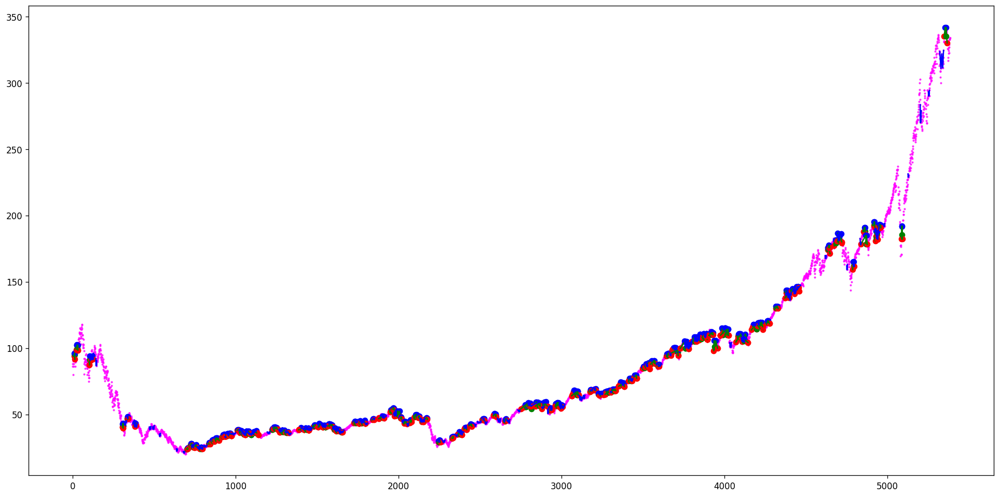

[(36, 66, 71, 75, 77), (102, 139, 159, 168, 197), (212, 235, 255, 257, 277), (212, 236, 255, 257, 277), (212, 237, 255, 257, 277), (212, 240, 255, 257, 277), (255, 264, 267, 269, 277), (212, 269, 282, 292, 311), (212, 269, 282, 293, 311), (212, 269, 282, 294, 311), (212, 269, 282, 299, 311), (212, 269, 282, 300, 311), (212, 269, 282, 304, 311), (326, 335, 337, 380, 387), (326, 336, 337, 339, 387), (326, 336, 337, 380, 387), (395, 401, 406, 413, 424), (959, 1041, 1043, 1044, 1046), (1147, 1160, 1164, 1171, 1215), (1290, 1355, 1361, 1364, 1370), (1290, 1360, 1361, 1364, 1370), (1419, 1425, 1426, 1429, 1433), (1419, 1425, 1433, 1442, 1460), (1419, 1425, 1433, 1445, 1460), (1419, 1425, 1433, 1446, 1460), (1419, 1425, 1433, 1448, 1460), (1419, 1425, 1433, 1449, 1460), (1419, 1425, 1433, 1451, 1460), (1419, 1429, 1433, 1442, 1460), (1505, 1534, 1539, 1545, 1558), (1505, 1534, 1539, 1547, 1558), (1562, 1563, 1564, 1565, 1567), (1666, 1692, 1695, 1700, 1703), (1646, 1700, 1706, 1712, 1731), (1

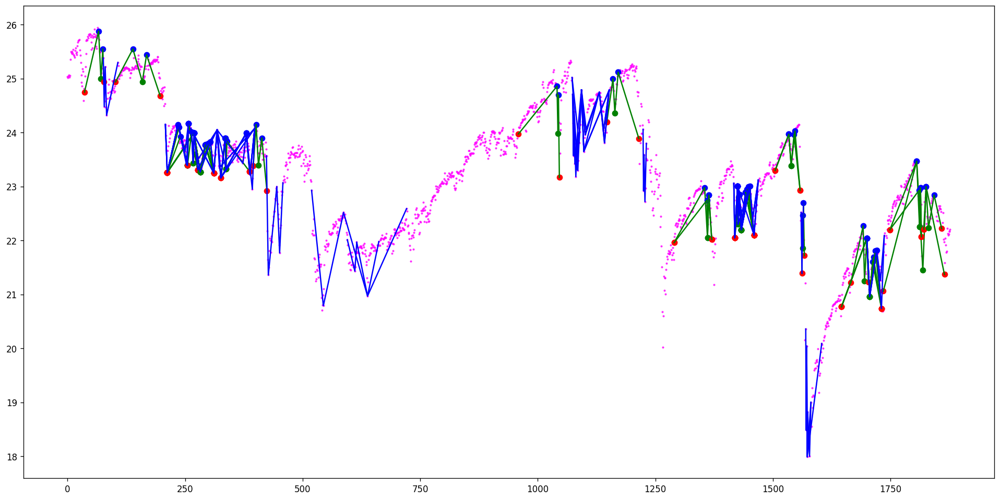

[(2, 4, 8, 11, 13), (74, 75, 77, 78, 83), (77, 78, 79, 80, 83), (148, 151, 156, 157, 162), (156, 157, 159, 160, 162), (385, 392, 398, 401, 404), (385, 394, 398, 401, 404), (434, 440, 442, 444, 453), (539, 541, 544, 545, 548), (539, 541, 548, 551, 562), (539, 541, 548, 559, 562), (539, 541, 562, 567, 576), (539, 545, 548, 551, 562), (548, 551, 556, 559, 561), (566, 569, 570, 571, 573), (648, 663, 668, 674, 682), (695, 698, 699, 700, 703), (695, 698, 703, 714, 728), (695, 700, 703, 714, 728), (703, 704, 710, 714, 727), (703, 706, 710, 711, 727), (703, 706, 710, 714, 727), (713, 714, 717, 721, 724), (728, 731, 732, 735, 741), (743, 759, 771, 783, 797), (743, 762, 771, 783, 797), (743, 766, 771, 783, 797), (774, 786, 787, 792, 797), (836, 845, 848, 855, 872), (925, 933, 937, 946, 972), (925, 933, 937, 949, 972), (943, 946, 947, 949, 955), (1010, 1011, 1012, 1013, 1021), (1007, 1018, 1027, 1029, 1039), (1007, 1020, 1027, 1029, 1039), (1007, 1022, 1027, 1029, 1039), (1027, 1029, 1030, 1031, 

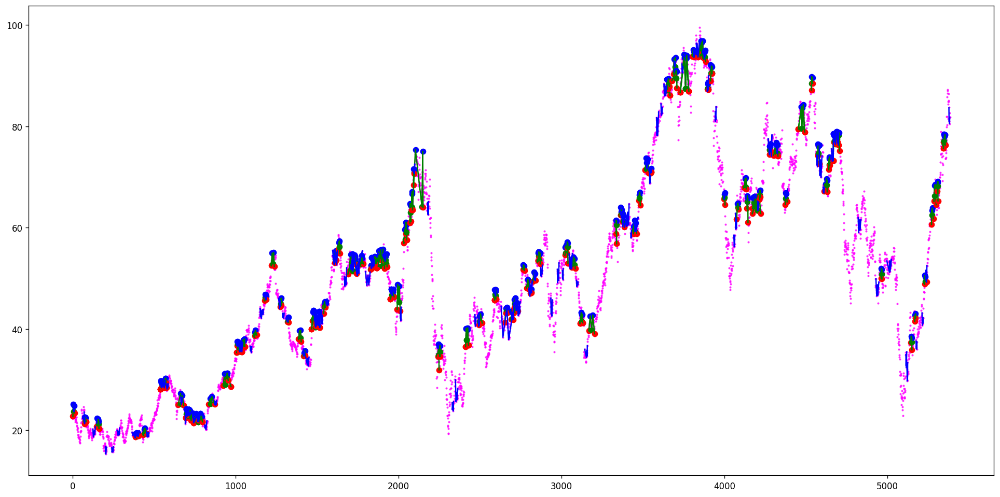

[]
[(394, 395, 396, 397, 398), (441, 442, 443, 445, 446), (485, 486, 487, 489, 496)]
Ticker RIDE found 0 double top patterns, 3 double bottom patterns


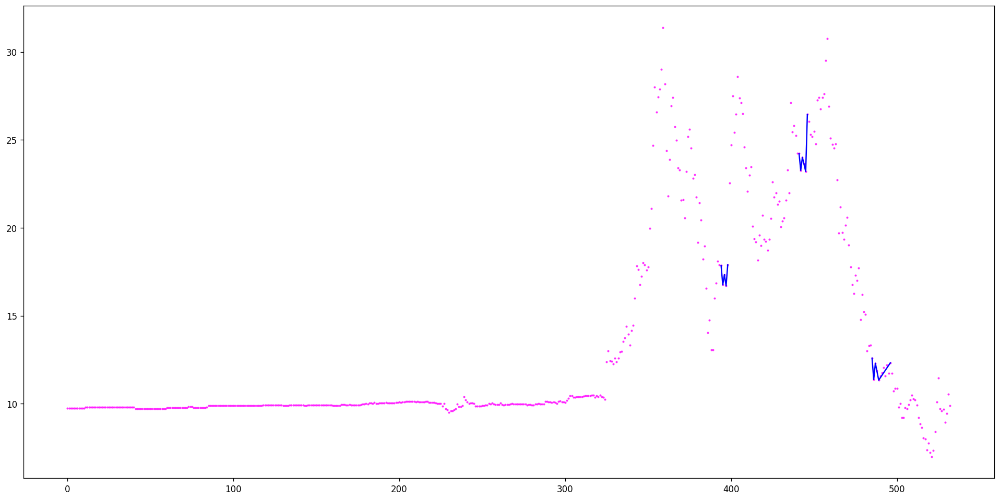

[(470, 471, 472, 474, 475), (1244, 1245, 1246, 1247, 1248), (1289, 1290, 1291, 1292, 1293)]
[]
Ticker RIOT found 3 double top patterns, 0 double bottom patterns


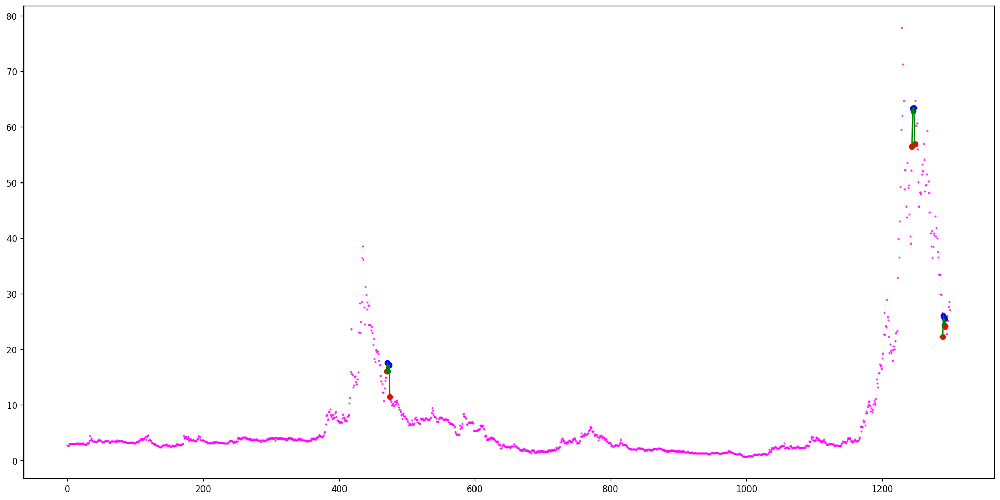

[(8, 13, 18, 21, 25), (83, 84, 86, 88, 91), (145, 150, 153, 156, 164), (145, 151, 153, 156, 164), (169, 171, 174, 177, 178), (229, 230, 232, 237, 246), (229, 230, 232, 239, 246), (452, 462, 465, 472, 476), (553, 558, 566, 576, 583), (583, 591, 595, 599, 603), (583, 591, 595, 601, 603), (679, 680, 681, 683, 690), (679, 680, 681, 685, 690), (716, 717, 719, 722, 723), (743, 747, 748, 750, 755), (841, 842, 843, 846, 849), (901, 906, 908, 910, 917), (909, 910, 912, 913, 914), (937, 939, 943, 944, 954), (943, 944, 945, 948, 954), (1018, 1022, 1023, 1024, 1026), (1018, 1022, 1026, 1032, 1037), (1013, 1036, 1040, 1043, 1057), (1013, 1036, 1040, 1047, 1057), (1013, 1036, 1040, 1049, 1057), (1013, 1036, 1040, 1051, 1057), (1040, 1043, 1044, 1047, 1056), (1129, 1133, 1135, 1137, 1147), (1129, 1133, 1135, 1140, 1147), (1135, 1137, 1138, 1140, 1146), (1247, 1250, 1253, 1254, 1257), (1371, 1372, 1373, 1374, 1375), (1429, 1432, 1433, 1434, 1435), (1429, 1434, 1435, 1437, 1438), (1480, 1482, 1483, 148

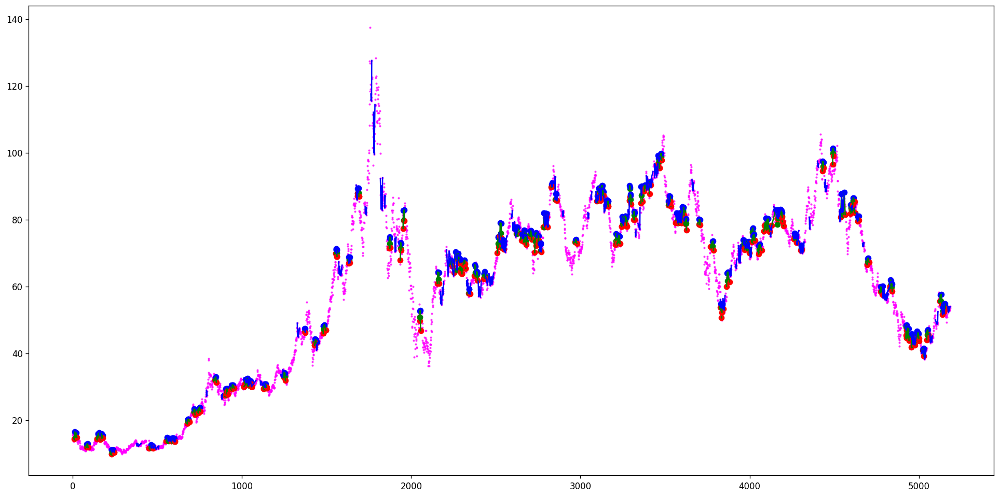

[(666, 667, 668, 670, 671), (738, 740, 742, 744, 748), (840, 841, 843, 845, 846), (878, 881, 882, 883, 884)]
[(581, 582, 584, 586, 588), (670, 671, 672, 674, 675), (774, 775, 776, 777, 779)]
Ticker SPCE found 4 double top patterns, 3 double bottom patterns


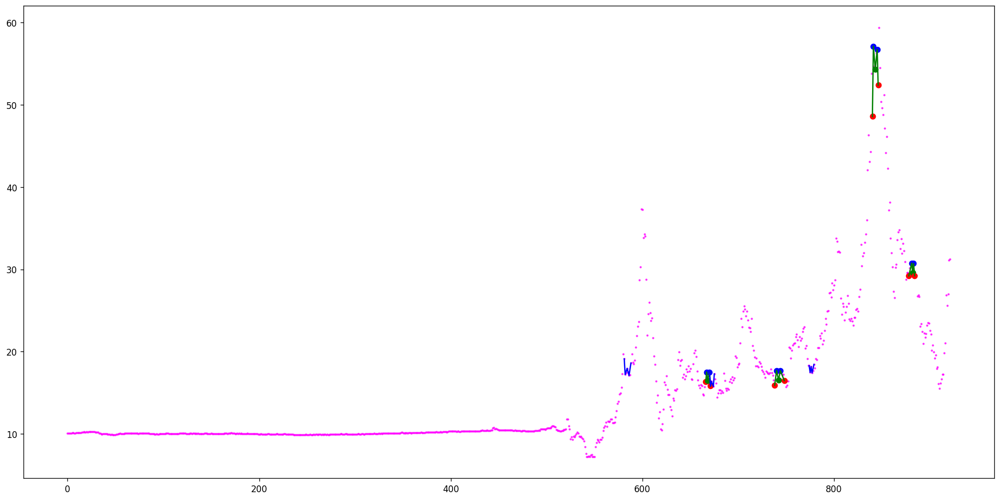

[(8, 9, 10, 11, 12), (18, 27, 28, 30, 32), (38, 42, 45, 46, 49), (53, 60, 61, 63, 70), (61, 63, 65, 67, 70), (72, 82, 89, 93, 98), (104, 105, 107, 108, 111), (103, 105, 111, 114, 120), (111, 114, 115, 116, 119), (103, 116, 124, 129, 144), (157, 158, 159, 160, 171), (185, 189, 190, 192, 193), (252, 253, 255, 263, 285), (270, 271, 272, 273, 274), (279, 280, 282, 283, 284), (331, 334, 336, 337, 342), (367, 370, 374, 377, 380), (383, 385, 386, 387, 391), (383, 385, 386, 389, 391), (386, 387, 388, 389, 391), (443, 444, 446, 447, 448), (466, 471, 473, 475, 477), (466, 482, 488, 502, 518), (490, 492, 493, 497, 499), (488, 511, 513, 515, 518), (488, 511, 513, 517, 518), (542, 546, 549, 552, 553), (701, 702, 703, 704, 705), (700, 704, 705, 706, 717), (723, 725, 728, 729, 734), (719, 735, 740, 741, 744), (753, 754, 756, 758, 763), (782, 783, 785, 786, 787), (781, 786, 789, 791, 793), (781, 788, 789, 791, 793), (793, 794, 795, 796, 797), (855, 871, 872, 873, 900), (878, 880, 882, 884, 887), (875,

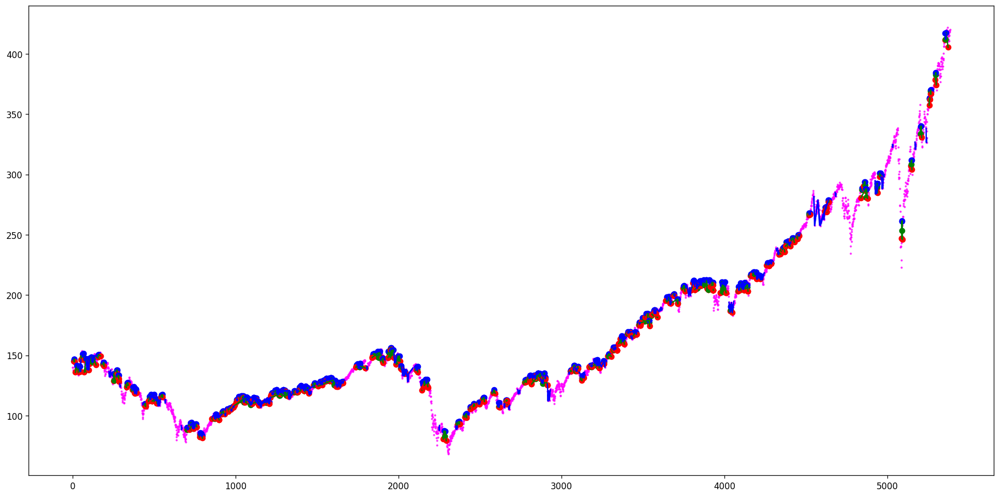

[(18, 19, 24, 26, 28), (50, 52, 53, 54, 55), (77, 78, 80, 82, 83), (88, 90, 91, 92, 95), (207, 209, 212, 217, 223), (207, 209, 212, 219, 223), (207, 209, 212, 222, 223), (207, 209, 212, 226, 228), (212, 213, 214, 217, 223), (215, 217, 218, 219, 223), (218, 219, 220, 222, 223), (212, 222, 223, 226, 228), (301, 302, 303, 304, 305), (311, 313, 315, 317, 320), (344, 345, 346, 347, 349), (431, 433, 434, 435, 438), (434, 435, 436, 437, 438), (430, 437, 440, 443, 445), (489, 490, 491, 493, 495), (489, 490, 495, 501, 505), (489, 493, 495, 497, 505), (489, 493, 495, 501, 505), (496, 497, 499, 501, 505), (528, 531, 532, 533, 534), (539, 541, 545, 552, 555), (539, 543, 545, 550, 555), (539, 543, 545, 552, 555), (610, 611, 613, 614, 616), (724, 727, 728, 729, 732), (801, 804, 807, 809, 810), (799, 804, 812, 814, 826), (853, 858, 864, 869, 882), (853, 858, 864, 871, 882), (853, 858, 864, 877, 882), (853, 863, 864, 869, 882), (864, 871, 874, 877, 882), (889, 891, 892, 894, 900), (957, 963, 967, 972,

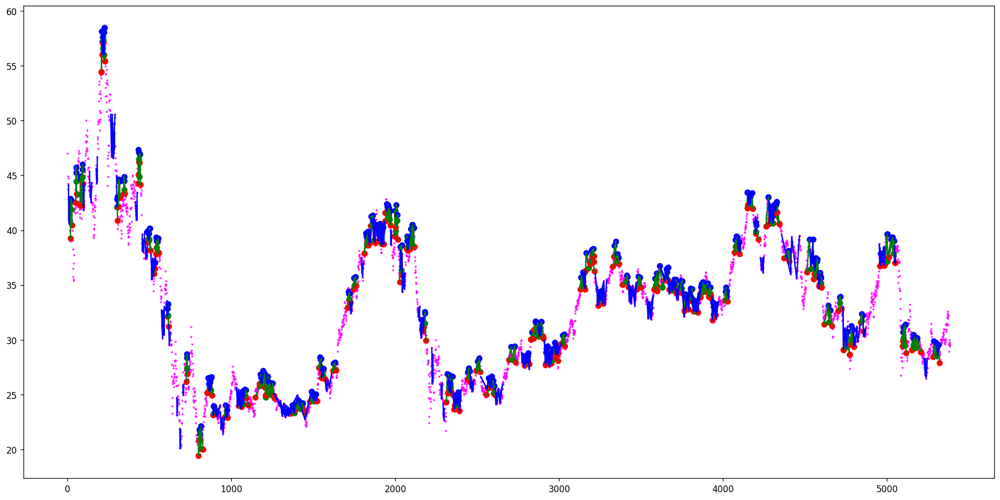

[(347, 351, 356, 364, 366), (980, 985, 989, 991, 993), (1001, 1002, 1003, 1004, 1009), (1050, 1051, 1052, 1053, 1054), (1085, 1086, 1087, 1088, 1090), (1090, 1091, 1092, 1095, 1097), (1103, 1104, 1105, 1106, 1107), (1153, 1161, 1164, 1169, 1175), (1186, 1187, 1188, 1191, 1192), (1253, 1254, 1255, 1256, 1258), (1249, 1261, 1264, 1272, 1277), (1340, 1341, 1342, 1343, 1345), (1456, 1457, 1458, 1459, 1461), (1517, 1518, 1522, 1523, 1552), (1522, 1525, 1526, 1528, 1552), (1535, 1536, 1538, 1539, 1540), (1588, 1589, 1590, 1592, 1597), (1588, 1589, 1590, 1595, 1597), (1769, 1771, 1772, 1773, 1774), (1778, 1779, 1780, 1781, 1782), (1789, 1790, 1792, 1794, 1797), (1828, 1832, 1833, 1834, 1843), (1828, 1832, 1833, 1836, 1843), (1857, 1858, 1859, 1862, 1869), (1857, 1858, 1859, 1864, 1869), (1863, 1864, 1865, 1868, 1869), (1877, 1878, 1880, 1881, 1883), (1899, 1905, 1907, 1911, 1914), (1954, 1955, 1957, 1958, 1963), (1953, 1955, 1969, 1979, 1986), (1969, 1974, 1975, 1977, 1983), (2019, 2021, 2025

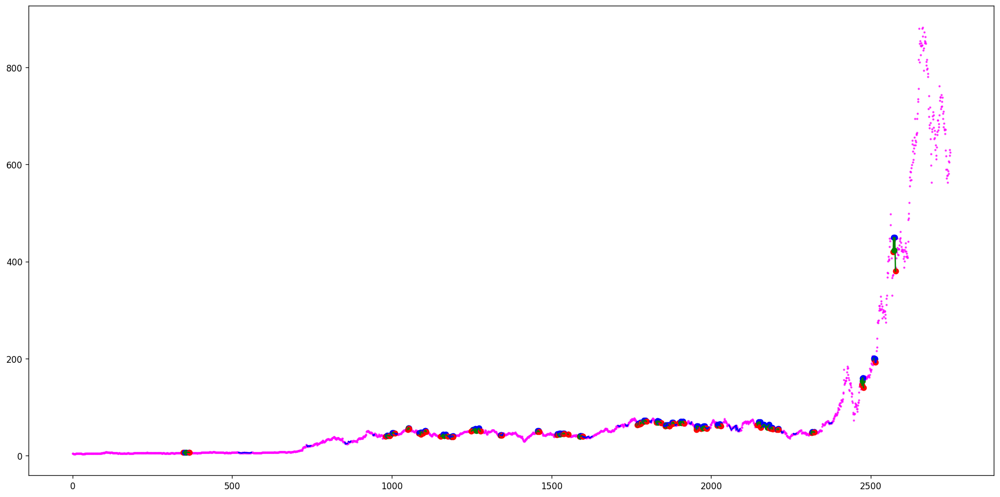

[(81, 83, 85, 86, 88), (101, 104, 110, 114, 116), (162, 165, 166, 167, 171), (181, 183, 186, 190, 198), (181, 183, 198, 202, 208), (226, 228, 230, 235, 239), (226, 228, 230, 238, 239), (262, 263, 265, 268, 273), (282, 283, 286, 287, 289), (280, 287, 290, 305, 311), (587, 593, 600, 603, 611), (647, 656, 659, 664, 671), (726, 736, 743, 745, 750), (778, 797, 801, 806, 812), (900, 902, 903, 904, 905), (898, 902, 905, 908, 914), (898, 904, 905, 908, 914), (905, 908, 909, 912, 914), (898, 912, 914, 919, 930), (898, 912, 914, 922, 930), (1011, 1013, 1017, 1019, 1023), (1024, 1026, 1032, 1036, 1040), (1024, 1028, 1032, 1036, 1040), (1074, 1075, 1076, 1078, 1087), (1074, 1075, 1076, 1081, 1087), (1098, 1100, 1102, 1105, 1118), (1164, 1165, 1167, 1168, 1174), (1205, 1213, 1225, 1230, 1235), (1205, 1222, 1225, 1227, 1235), (1205, 1222, 1225, 1230, 1235), (1262, 1267, 1268, 1274, 1276), (1304, 1305, 1307, 1308, 1309), (1307, 1308, 1309, 1311, 1312), (1312, 1315, 1317, 1318, 1323), (1312, 1315, 131

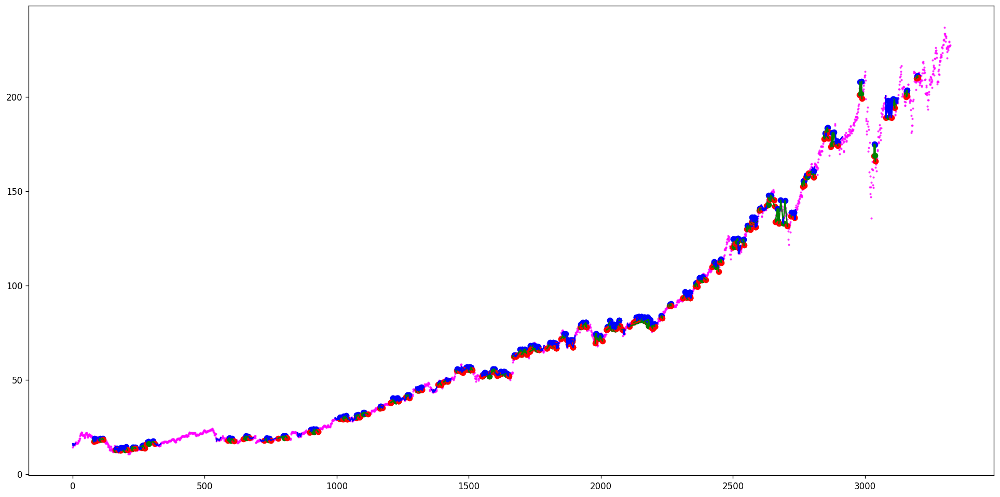

[(32, 33, 34, 37, 38), (101, 106, 109, 111, 113), (137, 150, 157, 163, 167), (178, 183, 190, 193, 217), (178, 187, 190, 193, 217), (251, 260, 286, 295, 307), (251, 261, 286, 295, 307), (253, 263, 272, 277, 285), (251, 263, 286, 295, 307), (253, 270, 272, 277, 285), (251, 277, 286, 295, 307), (251, 283, 286, 290, 307), (251, 283, 286, 295, 307), (289, 295, 297, 299, 307), (364, 374, 377, 385, 388), (393, 397, 400, 403, 411), (436, 438, 439, 440, 442), (447, 451, 453, 456, 458), (497, 500, 502, 503, 507), (537, 543, 545, 550, 559), (572, 576, 580, 582, 590), (992, 995, 999, 1001, 1003), (1010, 1015, 1016, 1023, 1028), (1098, 1102, 1104, 1106, 1110), (1098, 1102, 1104, 1108, 1110), (1112, 1115, 1117, 1118, 1121), (1124, 1126, 1128, 1130, 1131), (1216, 1221, 1232, 1238, 1240), (1216, 1224, 1232, 1238, 1240), (1314, 1316, 1317, 1319, 1327), (1361, 1362, 1364, 1366, 1368), (1480, 1482, 1483, 1485, 1488), (1480, 1485, 1490, 1493, 1494), (1480, 1485, 1490, 1496, 1502), (1480, 1487, 1490, 1493,

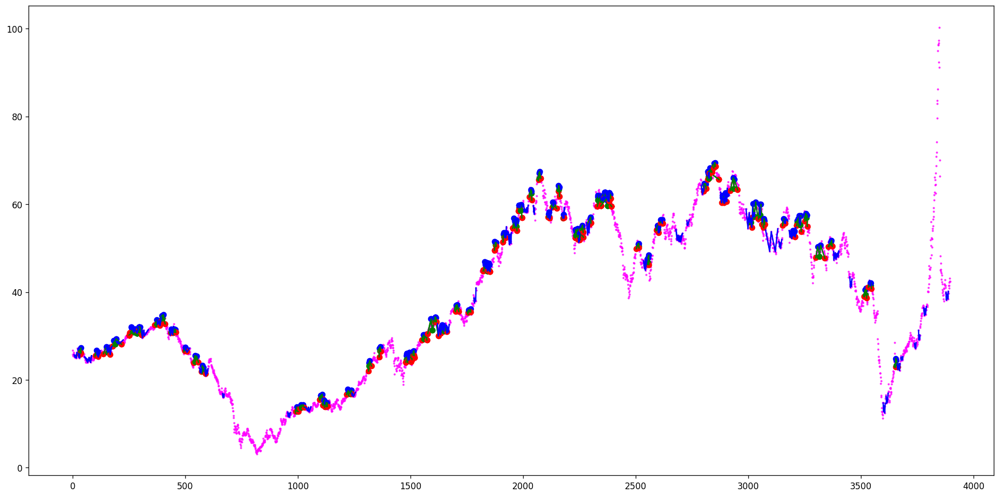

[(109, 119, 123, 130, 143), (175, 179, 185, 187, 192), (175, 189, 192, 194, 196), (204, 206, 212, 215, 221), (199, 215, 221, 228, 236), (326, 335, 339, 344, 356), (326, 335, 339, 350, 356), (326, 335, 356, 365, 371), (326, 335, 356, 368, 371), (326, 350, 356, 358, 371), (326, 350, 356, 365, 371), (304, 368, 372, 377, 389), (528, 533, 535, 537, 539), (607, 610, 614, 618, 625), (652, 660, 664, 668, 670), (652, 662, 664, 668, 670), (652, 663, 664, 668, 670), (687, 689, 691, 694, 704), (687, 694, 704, 708, 710), (687, 697, 704, 708, 710), (687, 702, 704, 708, 710), (722, 725, 733, 744, 753), (722, 725, 733, 746, 753), (722, 730, 733, 736, 753), (722, 730, 733, 744, 753), (722, 730, 733, 746, 753), (735, 736, 743, 744, 753), (795, 796, 797, 798, 799), (788, 798, 805, 806, 807), (788, 804, 805, 806, 807)]
[(189, 192, 194, 196, 201), (335, 339, 350, 356, 365), (335, 342, 350, 356, 365), (660, 664, 668, 670, 671), (682, 686, 694, 711, 716), (730, 735, 736, 741, 744), (730, 735, 736, 743, 744),

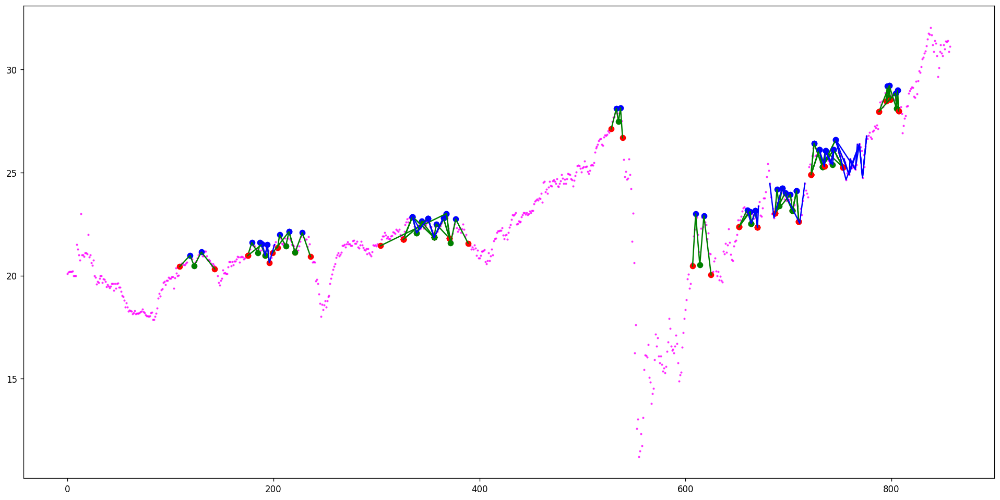

[(20, 21, 22, 23, 26), (20, 21, 22, 24, 26), (40, 41, 42, 43, 44), (50, 51, 53, 56, 58), (176, 177, 178, 179, 180), (277, 279, 281, 284, 285), (277, 280, 281, 284, 285), (289, 290, 292, 296, 299), (959, 960, 962, 966, 968), (1069, 1070, 1073, 1077, 1086), (1175, 1178, 1182, 1184, 1185), (1453, 1454, 1456, 1458, 1459), (1453, 1455, 1456, 1458, 1459), (1781, 1782, 1784, 1785, 1786), (1835, 1836, 1837, 1838, 1839), (1999, 2006, 2009, 2018, 2025), (2026, 2029, 2030, 2031, 2032), (2158, 2160, 2161, 2162, 2164), (2454, 2457, 2459, 2460, 2462), (2581, 2582, 2583, 2585, 2587), (2641, 2643, 2645, 2646, 2648), (2658, 2660, 2661, 2662, 2663), (2704, 2705, 2707, 2709, 2710), (2750, 2752, 2754, 2759, 2775), (2761, 2764, 2766, 2767, 2768), (2927, 2932, 2940, 2944, 2949), (2966, 2967, 2968, 2969, 2970), (2976, 2981, 2983, 2985, 2987), (3015, 3016, 3017, 3019, 3020), (3063, 3064, 3066, 3067, 3070), (3063, 3064, 3066, 3069, 3070), (3063, 3065, 3066, 3067, 3070), (3063, 3065, 3066, 3069, 3070), (3073, 3

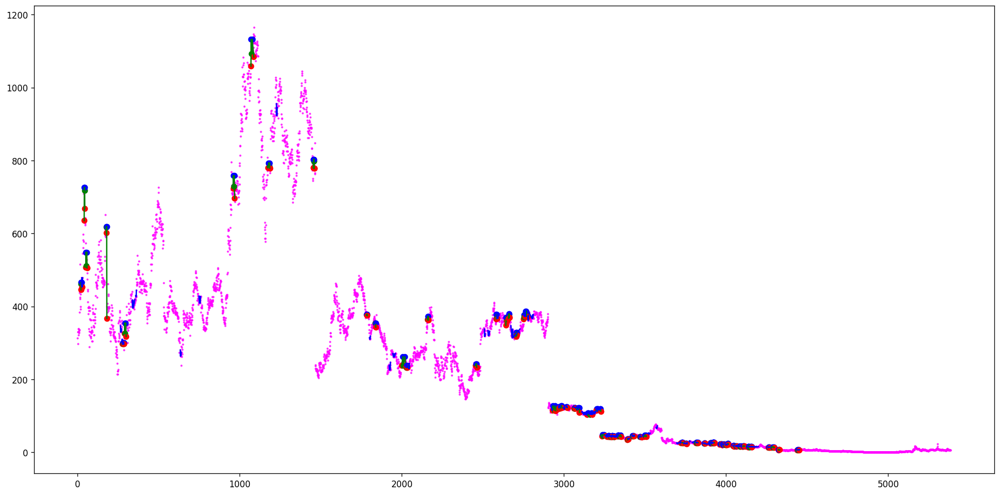

[(111, 113, 115, 117, 122), (125, 126, 128, 129, 131), (145, 148, 149, 150, 151), (152, 153, 154, 155, 158), (152, 155, 158, 160, 162), (163, 165, 166, 167, 171), (209, 210, 211, 212, 214), (253, 258, 262, 263, 265), (274, 276, 279, 281, 282), (333, 335, 336, 338, 339), (321, 335, 372, 389, 416), (321, 338, 372, 387, 416), (321, 338, 372, 389, 416), (342, 345, 346, 348, 350), (342, 345, 350, 355, 360), (342, 348, 350, 353, 360), (342, 348, 350, 355, 360), (392, 394, 397, 398, 400), (479, 483, 489, 490, 494), (479, 483, 489, 492, 494), (479, 485, 489, 490, 494), (500, 502, 505, 508, 513), (505, 508, 510, 511, 512), (539, 540, 542, 543, 545), (535, 540, 545, 553, 555), (535, 543, 545, 548, 555), (535, 543, 545, 553, 555), (580, 582, 586, 587, 589), (592, 593, 595, 598, 604), (597, 598, 599, 600, 603), (724, 725, 726, 727, 728), (740, 741, 744, 745, 751), (801, 806, 812, 814, 818), (832, 835, 836, 837, 839), (830, 837, 839, 841, 845), (856, 858, 860, 862, 881), (864, 871, 875, 877, 881), 

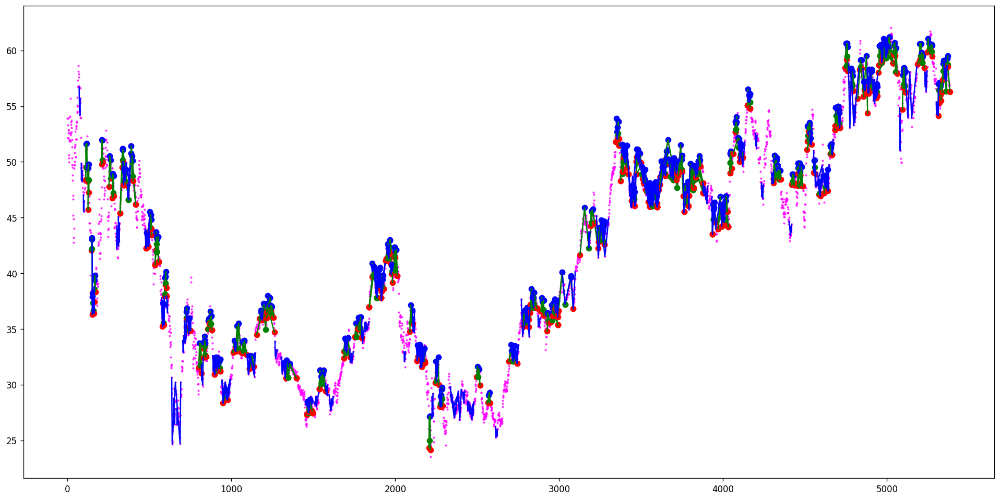

[(113, 115, 119, 122, 125), (197, 199, 201, 203, 204), (192, 199, 209, 211, 213), (192, 203, 209, 211, 213), (261, 264, 268, 278, 279), (305, 309, 310, 312, 314), (327, 330, 331, 333, 334), (354, 356, 360, 362, 363), (383, 384, 385, 386, 387), (382, 386, 387, 389, 390), (449, 450, 451, 452, 453), (550, 551, 552, 554, 557), (550, 556, 557, 558, 560), (582, 584, 586, 590, 596), (662, 665, 666, 667, 669), (682, 686, 690, 691, 696), (801, 802, 803, 804, 805), (813, 814, 817, 818, 819), (880, 882, 883, 885, 889), (992, 993, 994, 995, 996), (1016, 1017, 1020, 1021, 1022), (1094, 1095, 1096, 1097, 1102), (1114, 1116, 1118, 1123, 1124), (1219, 1220, 1222, 1223, 1224), (1243, 1244, 1245, 1247, 1248), (1282, 1285, 1286, 1287, 1289), (1453, 1454, 1455, 1456, 1457), (1563, 1564, 1565, 1567, 1568)]
[(49, 50, 51, 52, 53), (152, 154, 155, 156, 159), (160, 163, 164, 165, 167), (203, 204, 205, 207, 210), (317, 318, 319, 320, 321), (435, 437, 438, 440, 442), (450, 451, 452, 453, 456), (470, 475, 479, 48

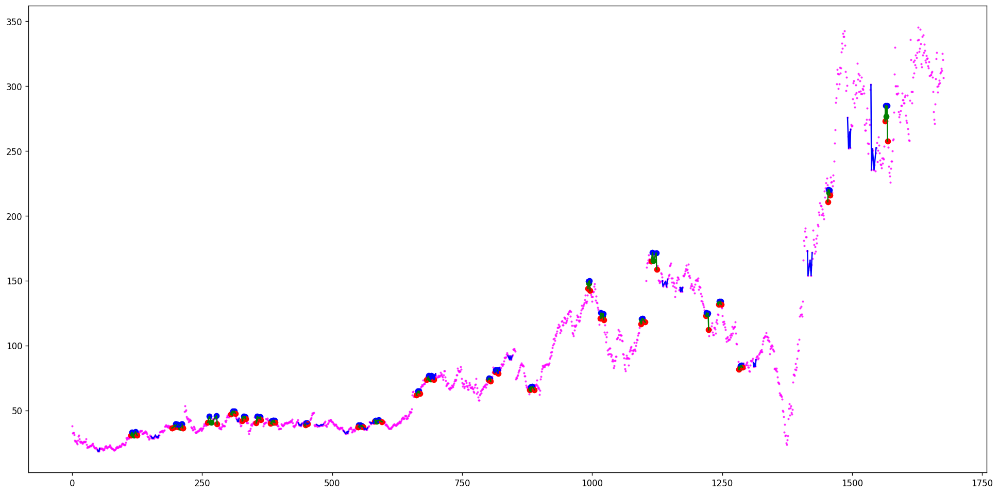

[(37, 38, 39, 40, 44), (127, 134, 136, 138, 140), (149, 155, 157, 161, 165), (171, 176, 179, 180, 182), (171, 176, 182, 190, 196), (171, 178, 179, 180, 182), (267, 271, 274, 275, 281), (307, 314, 344, 358, 364), (324, 329, 331, 332, 340), (348, 350, 354, 358, 361), (383, 387, 395, 413, 423), (383, 389, 395, 399, 423), (383, 389, 395, 408, 423), (383, 389, 395, 413, 423), (395, 399, 404, 408, 423), (405, 408, 410, 413, 418), (576, 583, 589, 594, 607), (576, 587, 589, 594, 607), (568, 603, 612, 615, 626), (650, 652, 654, 656, 675), (650, 652, 654, 658, 675), (657, 658, 660, 664, 668), (717, 721, 723, 725, 728), (716, 721, 728, 752, 775), (716, 725, 728, 752, 775), (749, 760, 771, 773, 775), (749, 766, 771, 773, 775), (826, 835, 839, 845, 849), (826, 837, 839, 841, 849), (826, 837, 839, 845, 849), (881, 884, 887, 893, 897), (969, 971, 974, 980, 992), (969, 982, 992, 996, 1073), (969, 987, 992, 996, 1073), (992, 1002, 1011, 1048, 1073), (992, 1005, 1011, 1016, 1073), (992, 1005, 1011, 1019

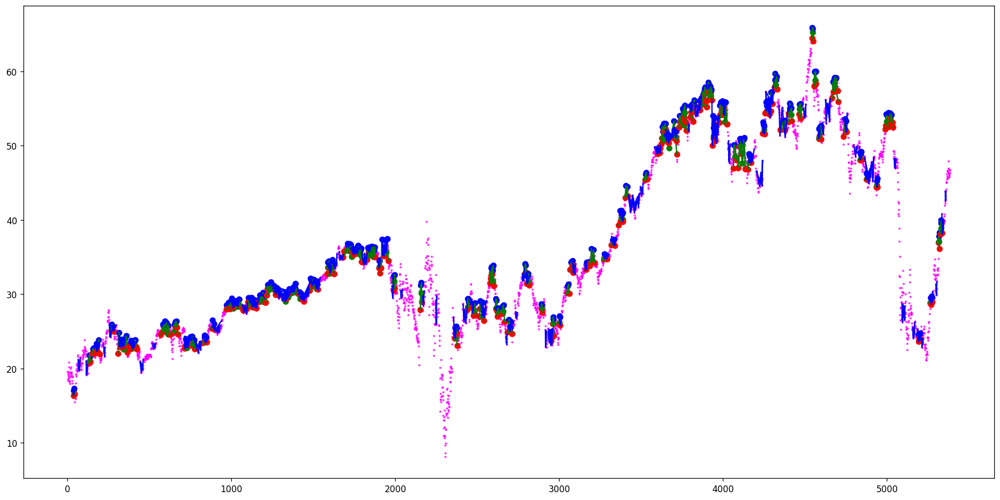

[(90, 93, 94, 95, 100), (198, 199, 200, 202, 206), (309, 310, 311, 312, 315), (316, 318, 319, 320, 321), (366, 373, 374, 375, 380), (374, 375, 376, 377, 379), (392, 397, 398, 399, 401), (436, 438, 439, 440, 441), (442, 443, 445, 446, 448), (441, 446, 449, 451, 456), (441, 446, 449, 455, 456), (449, 451, 453, 455, 456), (463, 466, 467, 469, 486), (467, 469, 470, 471, 476), (467, 469, 470, 474, 476), (470, 471, 473, 474, 476), (495, 497, 499, 500, 503), (536, 541, 542, 546, 560), (610, 611, 612, 615, 617), (655, 656, 657, 658, 659), (671, 673, 675, 677, 682), (675, 677, 680, 681, 682), (675, 679, 680, 681, 682), (687, 688, 690, 691, 692), (697, 699, 700, 702, 709), (697, 699, 700, 704, 709), (703, 704, 705, 706, 707), (723, 724, 728, 729, 734), (728, 729, 730, 733, 734), (749, 752, 756, 757, 763), (768, 769, 771, 773, 774), (781, 782, 785, 786, 787), (781, 786, 787, 788, 793), (777, 790, 793, 794, 798), (777, 790, 793, 796, 798), (813, 816, 819, 820, 821), (813, 818, 819, 820, 821), (822

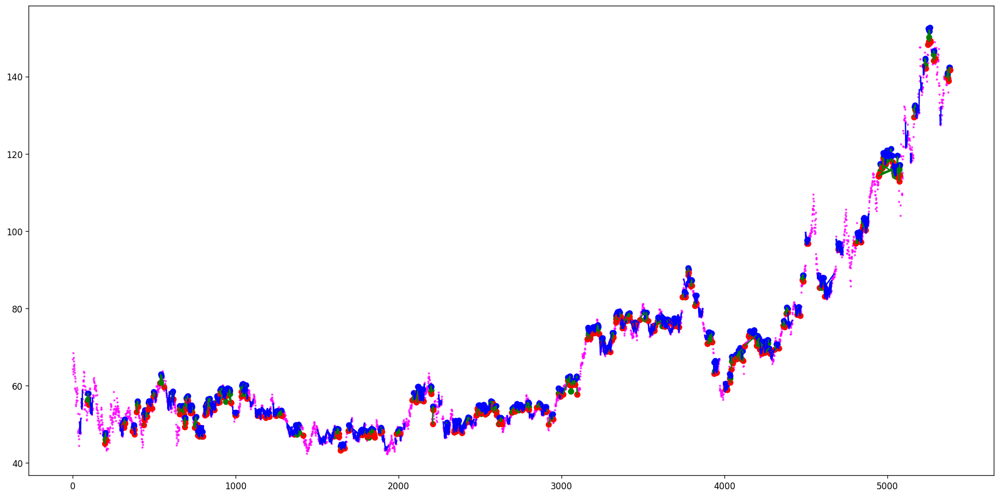

[(49, 51, 52, 54, 57), (60, 63, 67, 70, 72), (78, 82, 83, 84, 85), (125, 126, 129, 131, 142), (249, 251, 252, 254, 255), (404, 407, 408, 409, 423), (404, 407, 408, 415, 423), (408, 409, 411, 415, 422), (433, 439, 441, 444, 449), (500, 504, 510, 511, 513), (562, 564, 566, 568, 570), (562, 568, 570, 573, 575), (683, 685, 687, 688, 692), (683, 685, 687, 690, 692), (885, 888, 889, 890, 892), (926, 929, 930, 935, 936), (930, 932, 933, 935, 936), (948, 949, 952, 954, 956), (999, 1001, 1003, 1005, 1010), (996, 1005, 1014, 1017, 1021), (1125, 1127, 1130, 1131, 1132), (1247, 1248, 1251, 1252, 1254), (1276, 1278, 1279, 1280, 1282), (1302, 1303, 1304, 1305, 1306), (1302, 1305, 1306, 1309, 1311), (1328, 1329, 1330, 1331, 1332), (1328, 1331, 1332, 1333, 1334), (1339, 1340, 1341, 1343, 1344), (1349, 1350, 1352, 1353, 1354), (1348, 1353, 1355, 1357, 1363), (1396, 1397, 1398, 1399, 1400), (1396, 1399, 1400, 1402, 1404), (1428, 1429, 1432, 1435, 1436), (1459, 1460, 1461, 1462, 1463), (1579, 1581, 1582,

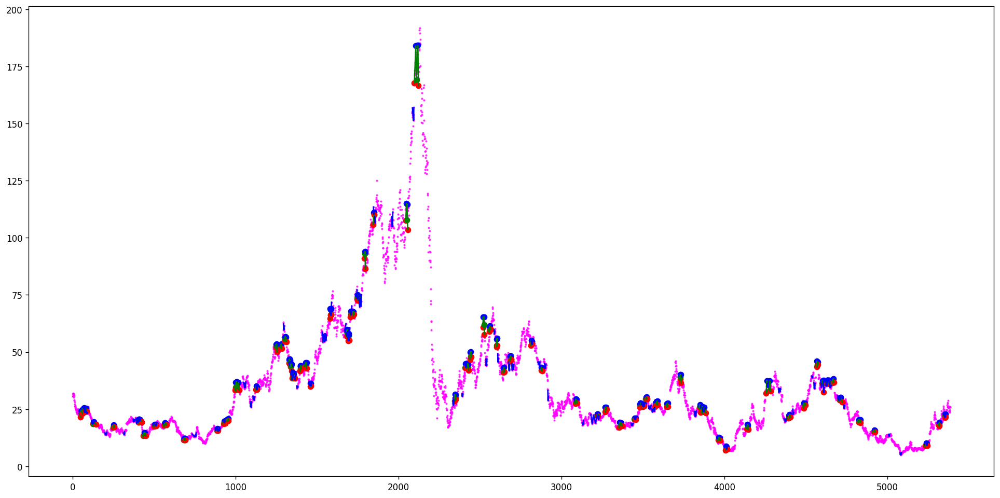

[(2, 3, 7, 8, 16), (7, 8, 9, 11, 12), (7, 11, 12, 13, 16), (62, 64, 65, 66, 67), (88, 92, 94, 97, 105), (88, 92, 94, 102, 105), (84, 92, 105, 115, 125), (94, 97, 100, 102, 105), (84, 102, 105, 113, 125), (84, 102, 105, 115, 125), (105, 107, 110, 113, 125), (184, 197, 202, 227, 235), (247, 248, 250, 252, 253), (271, 272, 274, 275, 283), (270, 279, 291, 298, 305), (270, 287, 291, 294, 305), (270, 289, 291, 294, 305), (309, 310, 312, 313, 315), (327, 330, 336, 340, 382), (327, 332, 336, 340, 382), (327, 334, 336, 340, 382), (337, 340, 342, 345, 350), (337, 340, 342, 347, 350), (336, 349, 350, 354, 374), (350, 366, 369, 371, 374), (438, 451, 453, 455, 457), (471, 474, 477, 482, 486), (494, 506, 507, 509, 510), (491, 509, 513, 514, 518), (491, 509, 513, 516, 518), (518, 520, 523, 524, 525), (545, 547, 548, 552, 556), (542, 547, 556, 558, 564), (542, 547, 556, 561, 564), (542, 552, 556, 558, 564), (542, 553, 556, 558, 564), (542, 554, 556, 558, 564), (589, 591, 592, 593, 595), (589, 591, 595

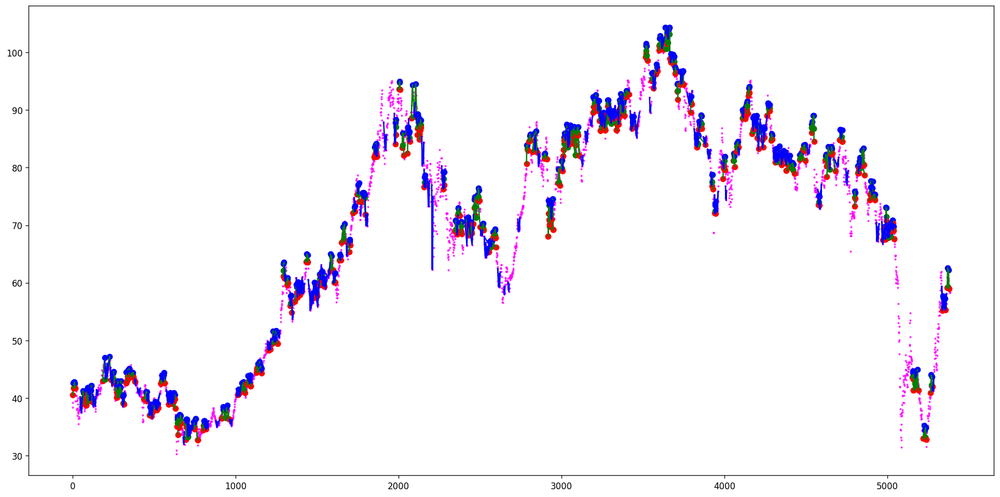

[(147, 149, 150, 151, 152)]
[(39, 43, 44, 45, 46), (54, 55, 56, 58, 59), (107, 108, 110, 111, 113), (151, 152, 153, 155, 156)]
Ticker XPEV found 1 double top patterns, 4 double bottom patterns


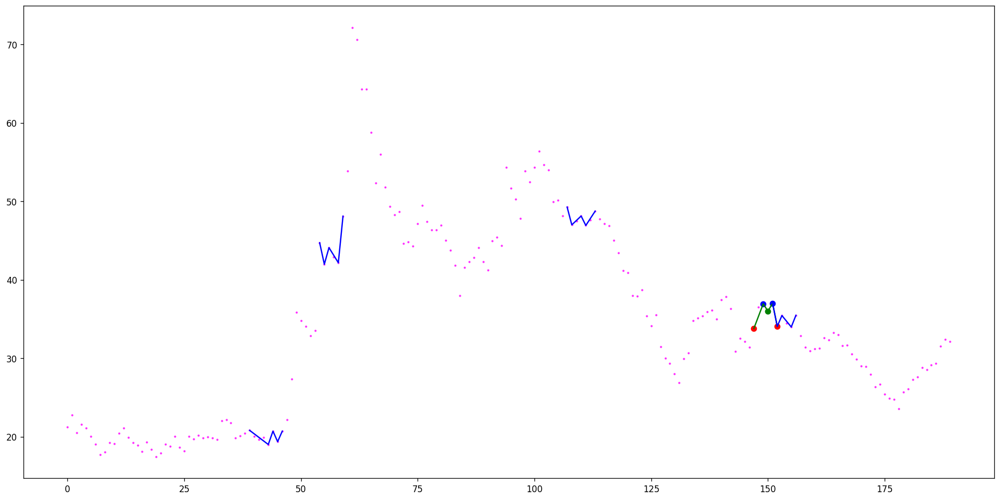

[(9, 12, 14, 32, 34), (14, 15, 16, 18, 19), (14, 18, 19, 22, 34), (14, 18, 19, 23, 34), (106, 107, 109, 111, 112), (141, 145, 156, 158, 165), (141, 147, 151, 152, 156), (141, 147, 151, 154, 156), (141, 149, 151, 152, 156), (151, 152, 153, 154, 155), (212, 213, 214, 215, 229), (216, 222, 224, 227, 228), (235, 236, 238, 239, 240), (249, 253, 255, 266, 276), (262, 266, 269, 271, 273), (279, 281, 283, 286, 287), (294, 304, 316, 325, 328), (294, 304, 316, 326, 328), (294, 310, 311, 312, 316), (294, 313, 316, 322, 328), (294, 315, 316, 322, 328), (336, 337, 343, 345, 346), (433, 434, 436, 438, 444), (460, 461, 462, 463, 464), (473, 474, 476, 477, 478), (473, 477, 478, 480, 481), (473, 477, 481, 484, 489), (473, 477, 481, 486, 489), (473, 480, 481, 484, 489), (483, 484, 485, 486, 488), (473, 486, 489, 494, 511), (553, 555, 556, 557, 568), (529, 567, 569, 572, 587), (529, 567, 569, 573, 587), (573, 577, 580, 584, 586), (529, 577, 589, 592, 608), (529, 577, 589, 593, 608), (529, 584, 589, 592, 

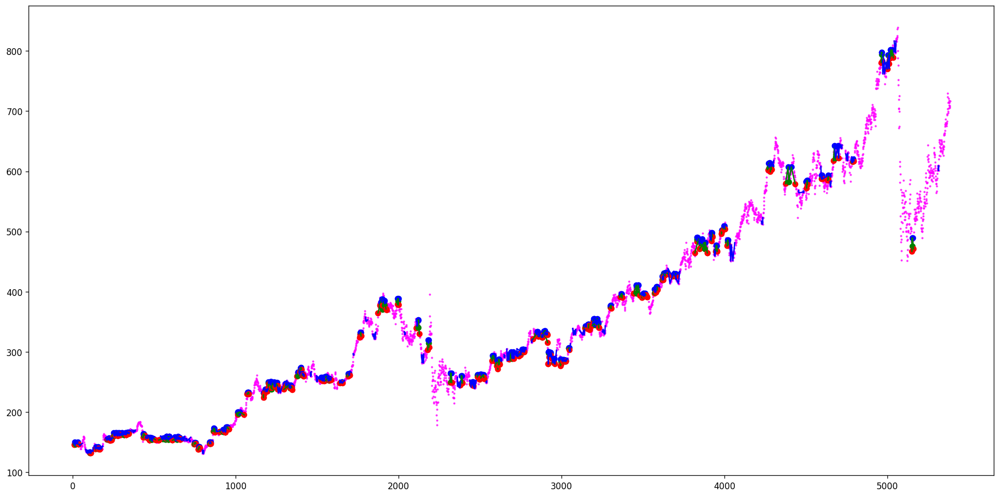

[(29, 33, 35, 38, 41), (74, 78, 84, 88, 90), (118, 119, 123, 124, 125), (118, 121, 123, 124, 125), (158, 160, 161, 164, 168), (262, 266, 268, 271, 273), (286, 288, 290, 292, 294), (339, 341, 344, 347, 364), (345, 354, 357, 358, 360), (386, 387, 389, 392, 394), (442, 443, 445, 450, 451), (530, 532, 533, 536, 542), (546, 557, 563, 564, 568), (546, 560, 563, 564, 568), (546, 562, 563, 564, 568), (569, 571, 572, 573, 575), (694, 695, 696, 697, 699), (767, 769, 772, 777, 780), (807, 809, 811, 815, 816), (838, 841, 842, 843, 847), (865, 867, 868, 872, 873), (965, 967, 971, 977, 980), (971, 972, 973, 975, 978), (973, 975, 976, 977, 978), (998, 999, 1004, 1005, 1008), (997, 1005, 1008, 1010, 1011), (1215, 1217, 1219, 1220, 1223), (1250, 1251, 1252, 1254, 1255), (1270, 1271, 1272, 1274, 1275)]
[(14, 15, 18, 21, 22), (69, 73, 78, 92, 95), (154, 155, 156, 157, 160), (153, 157, 160, 161, 164), (261, 262, 266, 273, 287), (267, 268, 271, 273, 275), (266, 273, 277, 279, 287), (297, 303, 310, 313, 317

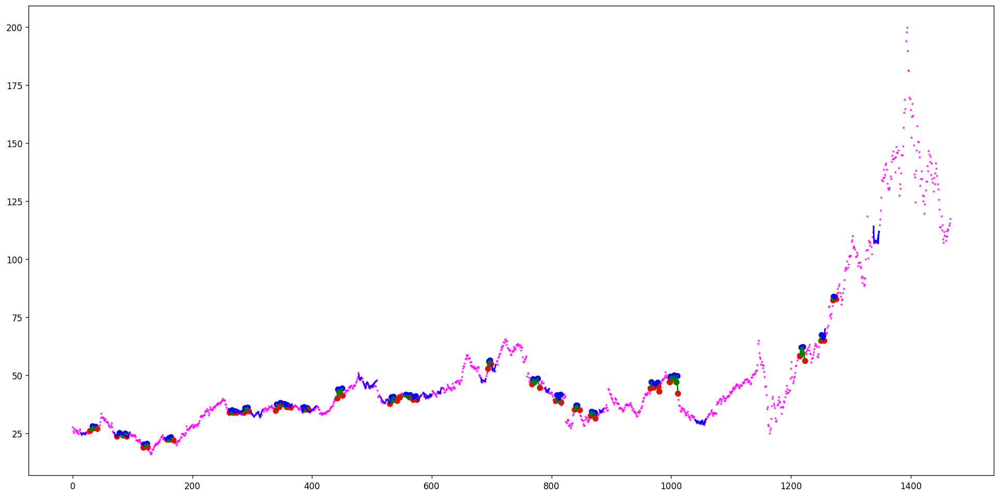

[(8, 10, 12, 15, 16), (58, 59, 60, 61, 62), (75, 77, 79, 80, 82), (186, 187, 189, 190, 191)]
[(24, 25, 26, 27, 28), (44, 46, 48, 51, 52), (97, 98, 101, 102, 104), (160, 161, 162, 165, 167), (170, 172, 174, 175, 177), (309, 314, 315, 319, 327), (369, 370, 371, 372, 373), (426, 430, 432, 436, 438)]
Ticker ZM found 4 double top patterns, 8 double bottom patterns


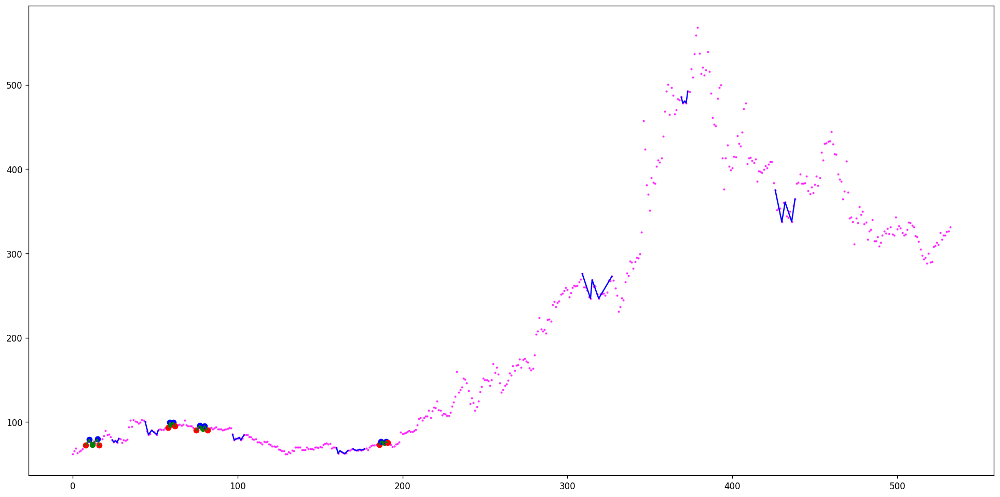

In [12]:
for ticker in ticker_dfs.keys():
    ticker_df = ticker_dfs[ticker]
    if ticker_df is None:
        continue

    # discrete dataset
    x_data = ticker_df.index.to_numpy()      # the index will be our x axis, not date
    y_data = ticker_df[price_name].to_numpy()
    # print(x_data)
    # print(y_data)

    suspected_double_tops = find_double_top(x_data, y_data)
    suspected_double_bottoms = find_double_bottom(x_data, y_data)
    print(suspected_double_tops)
    print(suspected_double_bottoms)
    print('Ticker {} found {} double top patterns, {} double bottom patterns'.format(ticker, len(suspected_double_tops), len(suspected_double_bottoms)))
    save_data_price_patterns(x_data, y_data, suspected_double_tops,
                             "{}_{}_{}_{}_double_top_data_patterns.csv"
                             .format(ticker, start_time, end_time, pre_time_steps))
    save_data_price_patterns(x_data, y_data, suspected_double_bottoms,
                             "{}_{}_{}_{}_double_bot_data_patterns.csv"
                             .format(ticker, start_time, end_time, pre_time_steps))

    visualize_res(x_data, y_data, suspected_double_tops, suspected_double_bottoms)

In [13]:
!zip -r /content/data_price_patterns.zip /content/*.csv

  adding: content/AA_2000-01-01 00:00:00_2021-05-30_30_double_bot_data_patterns.csv (deflated 75%)
  adding: content/AA_2000-01-01 00:00:00_2021-05-30_30_double_top_data_patterns.csv (deflated 75%)
  adding: content/AAAU_2000-01-01 00:00:00_2021-05-30_30_double_bot_data_patterns.csv (deflated 73%)
  adding: content/AAAU_2000-01-01 00:00:00_2021-05-30_30_double_top_data_patterns.csv (deflated 73%)
  adding: content/AACG_2000-01-01 00:00:00_2021-05-30_30_double_bot_data_patterns.csv (deflated 74%)
  adding: content/AACG_2000-01-01 00:00:00_2021-05-30_30_double_top_data_patterns.csv (deflated 77%)
  adding: content/AADAX_2000-01-01 00:00:00_2021-05-30_30_double_bot_data_patterns.csv (deflated 80%)
  adding: content/AADAX_2000-01-01 00:00:00_2021-05-30_30_double_top_data_patterns.csv (deflated 82%)
  adding: content/AADEX_2000-01-01 00:00:00_2021-05-30_30_double_bot_data_patterns.csv (deflated 88%)
  adding: content/AADEX_2000-01-01 00:00:00_2021-05-30_30_double_top_data_patterns.csv (defl